In [10]:
import torch
import random
from torch import nn
import os

import torch
from torch import nn
from torch.autograd import Variable
from torch.nn import functional as F
import torch.utils.data

from torchvision.models.inception import inception_v3

import numpy as np
from scipy.stats import entropy

def inception_score(imgs, cuda=True, batch_size=32, resize=False, splits=1):
    """Computes the inception score of the generated images imgs
    imgs -- Torch dataset of (3xHxW) numpy images normalized in the range [-1, 1]
    cuda -- whether or not to run on GPU
    batch_size -- batch size for feeding into Inception v3
    splits -- number of splits
    """
    N = len(imgs)

    assert batch_size > 0
    assert N > batch_size

    # Set up dtype
    if cuda:
        dtype = torch.cuda.FloatTensor
    else:
        if torch.cuda.is_available():
            print("WARNING: You have a CUDA device, so you should probably set cuda=True")
        dtype = torch.FloatTensor

    # Set up dataloader
    dataloader = torch.utils.data.DataLoader(imgs, batch_size=batch_size)

    # Load inception model
    inception_model = inception_v3(pretrained=True, transform_input=False).type(dtype)
    inception_model.eval();
    up = nn.Upsample(size=(299, 299), mode='bilinear').type(dtype)
    def get_pred(x):
        if resize:
            x = up(x)
        x = inception_model(x)
        return F.softmax(x).data.cpu().numpy()

    # Get predictions
    preds = np.zeros((N, 1000))

    for i, batch in enumerate(dataloader, 0):
        batch = batch.type(dtype)
        batchv = Variable(batch)
        batch_size_i = batch.size()[0]

        preds[i*batch_size:i*batch_size + batch_size_i] = get_pred(batchv)

    # Now compute the mean kl-div
    split_scores = []

    for k in range(splits):
        part = preds[k * (N // splits): (k+1) * (N // splits), :]
        py = np.mean(part, axis=0)
        scores = []
        for i in range(part.shape[0]):
            pyx = part[i, :]
            scores.append(entropy(pyx, py))
        split_scores.append(np.exp(np.mean(scores)))

    return np.mean(split_scores),np.std(split_scores)


if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

class Flatten(torch.nn.Module):
    def forward(self, x):
        return x.view(x.size()[0], -1)

classifier = torch.nn.Sequential(
          torch.nn.Conv2d(3, 8, 3, padding=1),
          torch.nn.ReLU(),
          torch.nn.MaxPool2d(2),
          torch.nn.Conv2d(8, 16, 3, padding=1),
          torch.nn.ReLU(),
          torch.nn.MaxPool2d(2),
          Flatten(),
          torch.nn.Linear(16*16*16, 1)
        ).to(device)
classifier.load_state_dict(torch.load('./toTransfer/classifier.pt'))

class Generator(nn.Module):
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()

        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2,
                                   padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU())

        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU())
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh())

    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)
        y = self.l2_5(y)
        return y

z_dim = 100
generator = Generator(z_dim).to(device)
generator.load_state_dict(torch.load('toTransfer/generator.pt')['G'])

classifier = classifier.eval()
generator = generator.eval()

In [9]:
import matplotlib.pyplot as plt
from PIL import Image
from scipy.misc import imshow
import numpy as np
from skimage import io
import torch
import os
import numpy as np
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

def tv_loss(img, tv_weight):
    # Your implementation should be vectorized and not require any loops!
    fshift_w=img[:,:,:,1:]
    bshift_w=img[:,:,:,:-1]
    fshift_h=img[:,:,1:,:]
    bshift_h=img[:,:,:-1,:]
    return tv_weight*(torch.sum((fshift_w - bshift_w)**2)+torch.sum((fshift_h - bshift_h)**2))

class FaceDataset(Dataset):
    """Face dataset."""

    def __init__(self, malePath, femalePath):
        self.male = [malePath+'/'+x for x in os.listdir(malePath)]
        self.female = [femalePath+'/'+x for x in os.listdir(femalePath)]

    def __len__(self):
        return len(self.male) + len(self.female)

    def __getitem__(self, idx):
        if idx < len(self.male):
            sample = {'image': io.imread(self.male[idx]),
                      'label': np.array([0.0])}
        else:
            sample = {'image': io.imread(self.female[idx-len(self.male)]),
                      'label': np.array([1.0])}
        return sample['image'], sample['label']



def view_tensor(image,save_im,path):
    image2=image.view(3,64,64).permute(1,2,0)
    image2=image2.cpu().detach().numpy()
    image2=(image2-np.min(image2))/(np.max(image2)-np.min(image2))
    plt.imshow(image2)
    if save_im == True:
        plt.savefig(path)
    plt.show()

def to_numpyHxWx3(image):
    transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.ToPILImage(),
     transforms.ToTensor(),
     transforms.Normalize(mean=[0] * 3, std=[1] * 3)])
    

In [67]:
transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.ToPILImage(),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3)])


listim=[]
for i in range(30000):
    image=generator(torch.randn(1,100,device=device))
    #image = invTrans(image)
    image2=image.view(3,64,64)
    image2=image2.cpu().detach().numpy()
    listim.append(image2)

scores=inception_score(listim, cuda=True, batch_size=32, resize=True,splits=10)
print(scores)

/home/shared/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1749: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/home/shared/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


(2.906115588504977, 0.04304554662317942)


In [3]:
import torchvision.datasets as dset
import torchvision.transforms as transforms
class IgnoreLabelDataset(torch.utils.data.Dataset):
    def __init__(self, orig):
        self.orig = orig

    def __getitem__(self, index):
        return self.orig[index][0]

    def __len__(self):
        return len(self.orig)
transform=transforms.Compose([transforms.ToTensor(),transforms.ToPILImage(),transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = FaceDataset('./toTransfer/data_resized/Celeb_gender/trainA', './toTransfer/data_resized/Celeb_gender/trainB')
lst=IgnoreLabelDataset(transform(trainset))
print ("Calculating Inception Score...")
print (inception_score(lst, cuda=True, batch_size=32, resize=True, splits=10))

TypeError: pic should be PIL Image or ndarray. Got <class '__main__.FaceDataset'>

In [11]:
def solve_exemplar_tv(model,image,learning_rate,iters,is_female,tv_weight):
    save_dir = './Experiments/solve_exemplar_tv/sample(%d)tv_pen(%d)'%(random.randint(1,50),tv_weight)
    #Send image to gpu
    image=image.type('torch.FloatTensor').to(device)
    
    #Create optimizer
    image.requires_grad = True
    optimizer = torch.optim.Adam([image], lr=learning_rate)
    
    #Parameter set
    for t in range(iters):
        optimizer.zero_grad()
        
        #Put image in model
        scores = model(image)
        
        # Compute loss
        t_loss = tv_loss(image, tv_weight)
        loss = t_loss- scores*is_female
        
        loss.backward()
        optimizer.step()

        if t % (iters//8) == 0:
            print('Iteration {}'.format(t))
            print('Decision {}'.format(float(model(image))))
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            file_path='%s/Iteration(%dof%d).jpg' % (save_dir, t, iters)
            view_tensor(image,True,file_path)
    return image

def solve_exemplar_gan(model,generator,image,learning_rate,iters,is_female):
    save_dir = './Experiments/solve_exemplar_gan/sample%d'%(random.randint(1,50))
    image=image.type('torch.FloatTensor').to(device)
    image.requires_grad = True
    optimizer = torch.optim.Adam([image], lr=learning_rate)
    for t in range(iters):
        optimizer.zero_grad()
        
        #Put image in model and gan
        sensible_image = generator(image)
        scores = model(sensible_image)
        
        # Compute loss
        
        loss = - scores*is_female
        
        loss.backward()
        optimizer.step()

        if t % (iters//8) == 0:
            print('Iteration {}'.format(t))
            print('Decision {}'.format(float(model(sensible_image))))
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            file_path='%s/Iteration(%dof%d).jpg' % (save_dir, t, iters)
            view_tensor(sensible_image,True,file_path)
    return image

def solve_boundary_gan(model,generator,image,learning_rate,iters):
    save_dir = './Experiments/solve_boundary_gan/sample%d'%(random.randint(1,50))
    image=image.type('torch.FloatTensor').to(device)
    image.requires_grad = True
    optimizer = torch.optim.Adam([image], lr=learning_rate)
    for t in range(iters):
        optimizer.zero_grad()
        
        #Put image in model and gan
        sensible_image = generator(image)
        scores = model(sensible_image)
        
        # Compute loss
        
        loss = torch.pow(scores, 2)
        
        loss.backward()
        optimizer.step()

        if t % (iters//8) == 0:
            print('Iteration {}'.format(t))
            print('Decision {}'.format(float(model(sensible_image))))
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            file_path='%s/Iteration(%dof%d).jpg' % (save_dir, t, iters)
            view_tensor(sensible_image,True,file_path)
    return image

def solve_boundary_tv(model,image,learning_rate,iters,tv_weight):
    save_dir = './Experiments/solve_boundary_tv/sample(%d)tv_pen(%d)'%(random.randint(1,50),tv_weight)
    image=image.type('torch.FloatTensor').to(device)
    image.requires_grad = True
    optimizer = torch.optim.Adam([image], lr=learning_rate)
    for t in range(iters):
        optimizer.zero_grad()
        
        #Put image in model and gan
        scores = model(image)
        
        # Compute loss
        t_loss = tv_loss(image, tv_weight)
        loss = torch.pow(scores, 2)+t_loss
        
        loss.backward()
        optimizer.step()

        if t % (iters//8) == 0:
            print('Iteration {}'.format(t))
            print('Decision {}'.format(float(model(image))))
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            file_path='%s/Iteration(%dof%d).jpg' % (save_dir, t, iters)
            view_tensor(image,True,file_path)
    return image

def find_closest_gan(generator, random_image, true_image, learning_rate, iters):
    save_dir = './Experiments/find_closest_gan/sample%d'%(random.randint(1,100))
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    file_path='%s/true_img.jpg' % (save_dir)
    view_tensor(true_image,True,file_path)
    random_image=random_image.type('torch.FloatTensor').to(device)
    random_image.requires_grad = True
    true_image=true_image.type('torch.FloatTensor').to(device)
    true_image.requires_grad = False
    
    optimizer = torch.optim.Adam([random_image], lr=learning_rate)
    for t in range(iters):
        optimizer.zero_grad()
        
        #Put image in model and gan
        projection = generator(random_image)
    
        # Compute loss    
        loss = torch.sum(torch.pow(true_image-projection, 2))
        
        loss.backward()
        optimizer.step()

        if t % (iters//8) == 0:
            print('Iteration {}'.format(t))
            print('Difference {}'.format(loss))
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            file_path='%s/Iteration(%dof%d).jpg' % (save_dir, t, iters)
            view_tensor(projection,True,file_path)
    return loss

Iteration 0
Decision 405.0061950683594


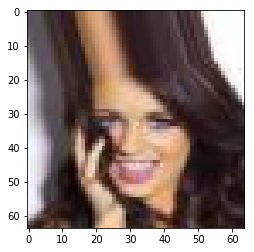

Iteration 125
Decision -1786.0574951171875


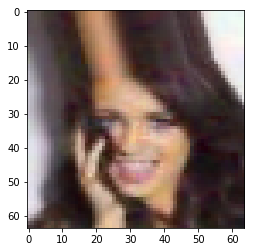

Iteration 250
Decision -3152.31103515625


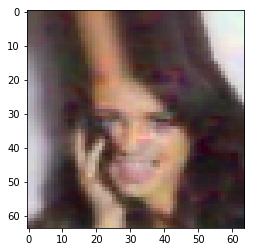

Iteration 375
Decision -4346.83642578125


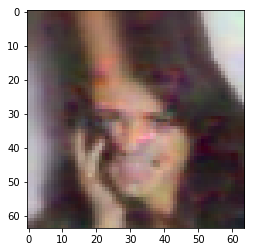

Iteration 500
Decision -5580.77783203125


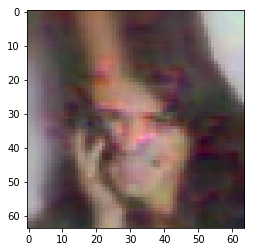

Iteration 625
Decision -6930.66552734375


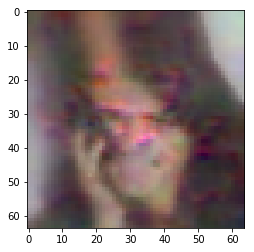

Iteration 750
Decision -8060.49462890625


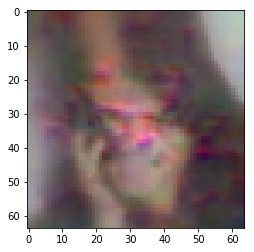

Iteration 875
Decision -9047.1982421875


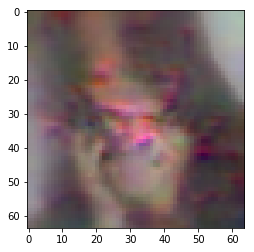

Iteration 0
Decision 923.5628662109375


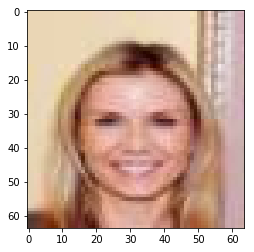

Iteration 125
Decision -2146.159912109375


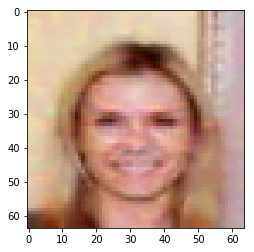

Iteration 250
Decision -4075.369140625


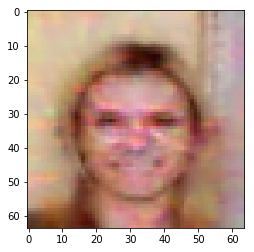

Iteration 375
Decision -5734.37744140625


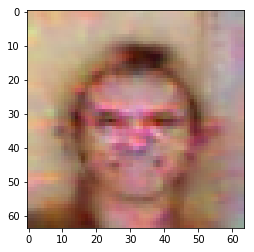

Iteration 500
Decision -7173.72705078125


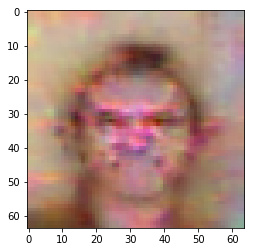

Iteration 625
Decision -8202.4013671875


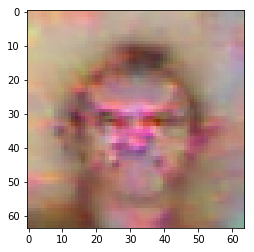

Iteration 750
Decision -9014.53125


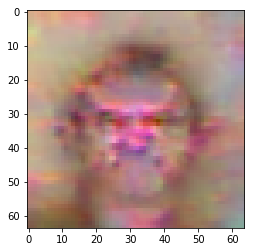

Iteration 875
Decision -9737.0009765625


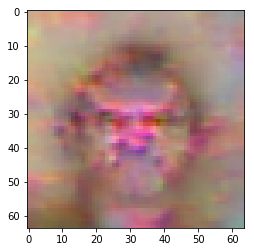

Iteration 0
Decision -790.5514526367188


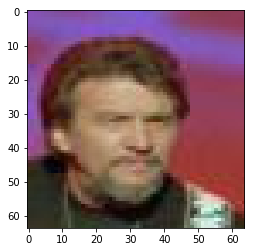

Iteration 125
Decision 2225.986083984375


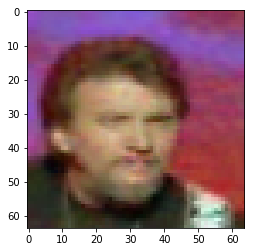

Iteration 250
Decision 3811.666015625


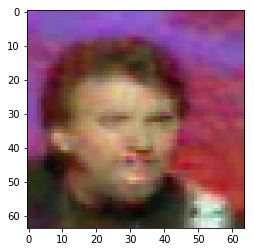

Iteration 375
Decision 5046.240234375


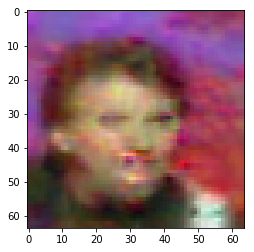

Iteration 500
Decision 6031.48681640625


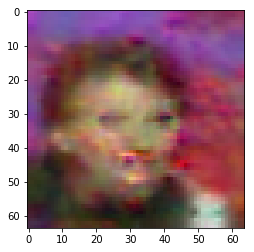

Iteration 625
Decision 6897.67333984375


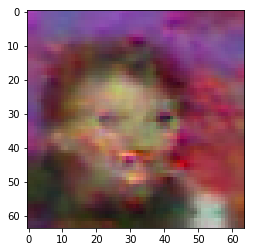

Iteration 750
Decision 7810.18798828125


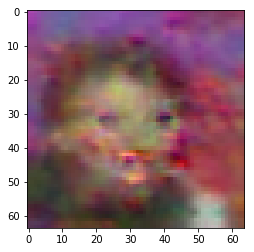

Iteration 875
Decision 8752.2265625


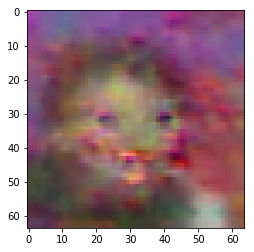

Iteration 0
Decision 728.574951171875


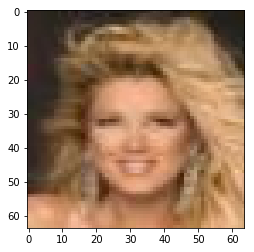

Iteration 125
Decision -2365.947265625


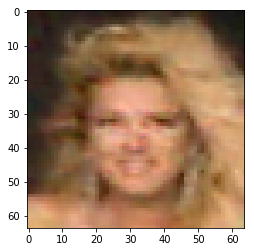

Iteration 250
Decision -4131.1103515625


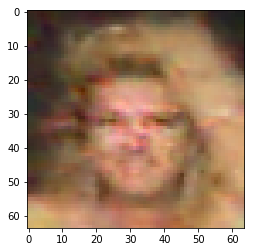

Iteration 375
Decision -5742.03662109375


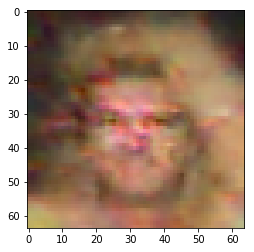

Iteration 500
Decision -7130.4482421875


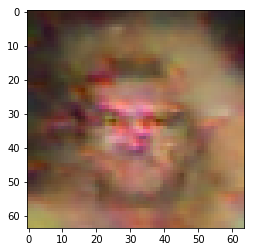

Iteration 625
Decision -8182.1865234375


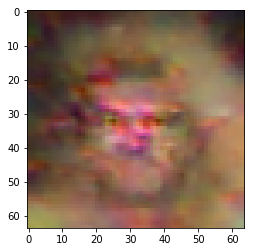

Iteration 750
Decision -9095.8232421875


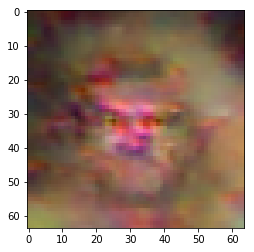

Iteration 875
Decision -9962.11328125


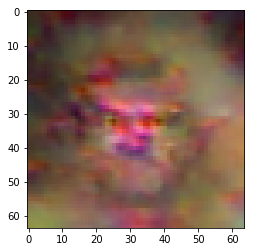

Iteration 0
Decision 985.15771484375


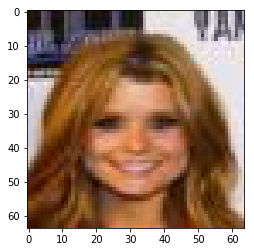

Iteration 125
Decision -2216.26904296875


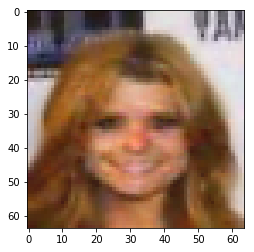

Iteration 250
Decision -3968.3974609375


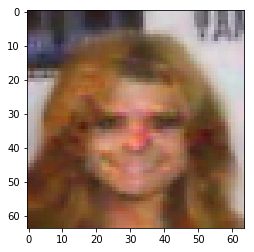

Iteration 375
Decision -5169.62353515625


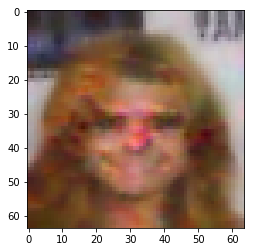

Iteration 500
Decision -6421.849609375


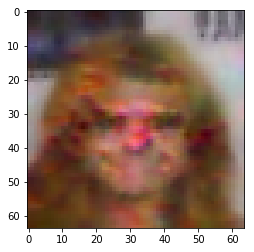

Iteration 625
Decision -7522.1162109375


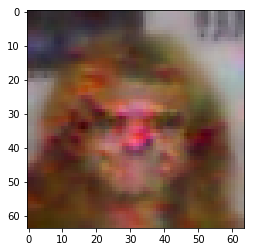

Iteration 750
Decision -8477.8955078125


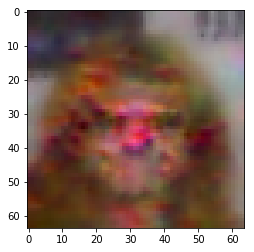

Iteration 875
Decision -9409.80078125


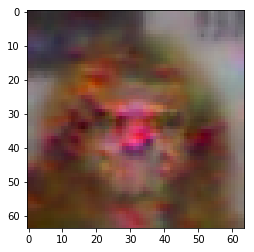

Iteration 0
Decision -903.1441650390625


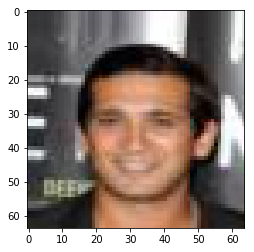

Iteration 125
Decision 1845.431640625


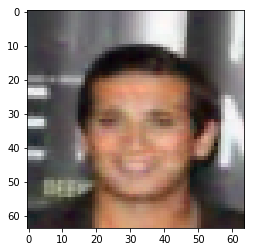

Iteration 250
Decision 3349.841064453125


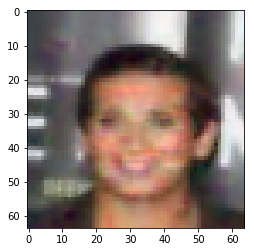

Iteration 375
Decision 4653.68701171875


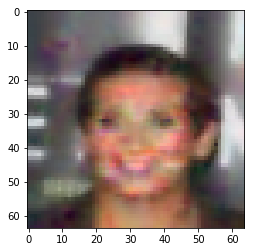

Iteration 500
Decision 5729.83642578125


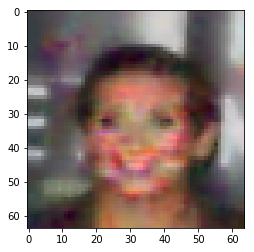

Iteration 625
Decision 6740.82177734375


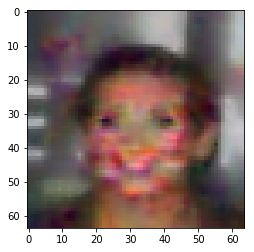

Iteration 750
Decision 7758.48046875


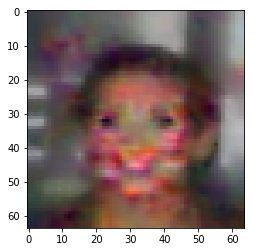

Iteration 875
Decision 8636.37109375


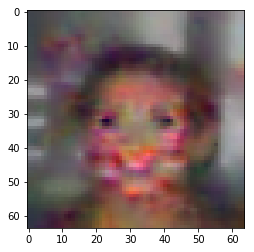

Iteration 0
Decision -844.4740600585938


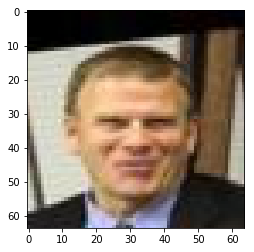

Iteration 125
Decision 2273.0810546875


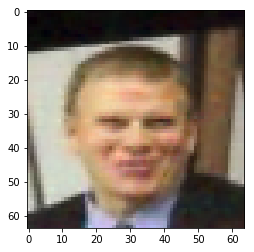

Iteration 250
Decision 3930.740478515625


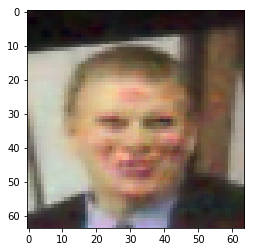

Iteration 375
Decision 5098.265625


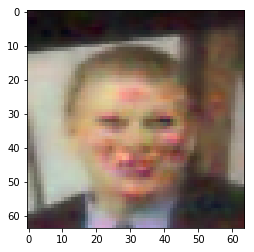

Iteration 500
Decision 5970.01953125


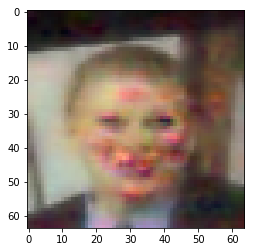

Iteration 625
Decision 6791.51123046875


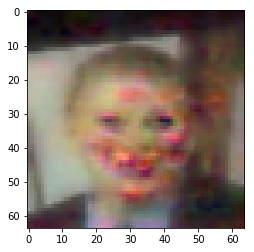

Iteration 750
Decision 7523.22607421875


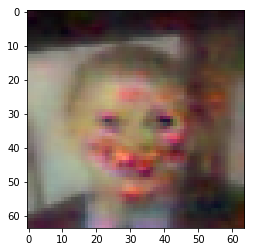

Iteration 875
Decision 8292.458984375


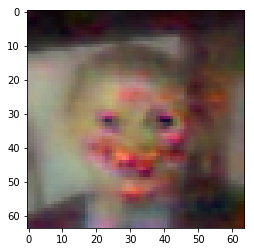

Iteration 0
Decision 2.73055100440979


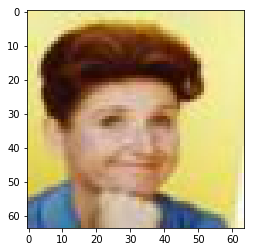

Iteration 125
Decision -2248.036865234375


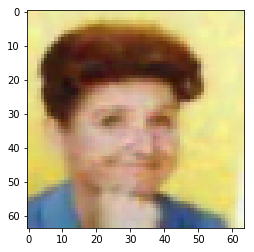

Iteration 250
Decision -3698.28173828125


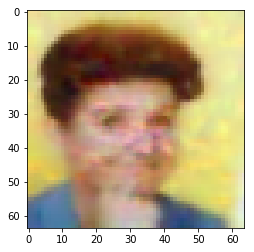

Iteration 375
Decision -4961.43408203125


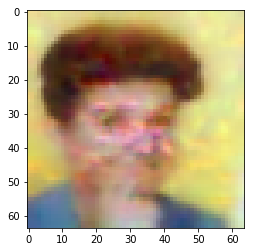

Iteration 500
Decision -6249.37890625


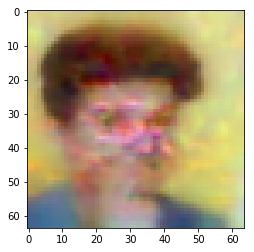

Iteration 625
Decision -7517.404296875


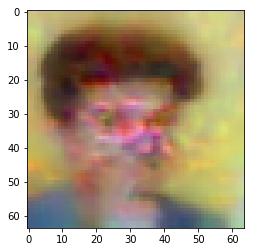

Iteration 750
Decision -8409.4326171875


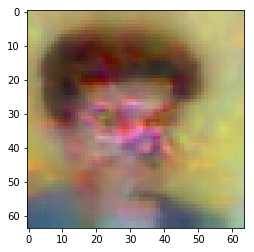

Iteration 875
Decision -9162.853515625


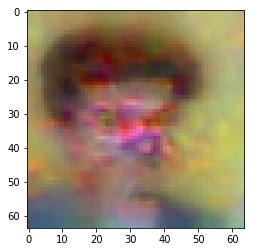

Iteration 0
Decision 377.2822265625


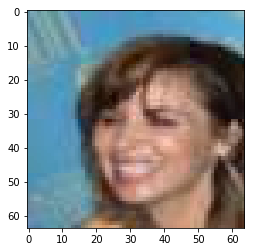

Iteration 125
Decision -2095.209716796875


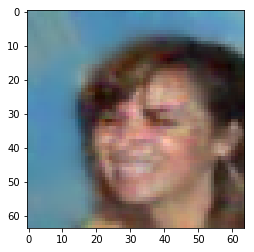

Iteration 250
Decision -3475.59716796875


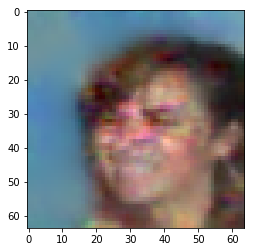

Iteration 375
Decision -4601.90185546875


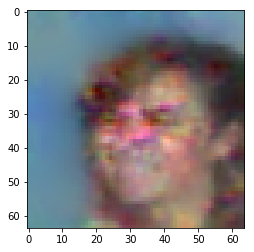

Iteration 500
Decision -5708.9443359375


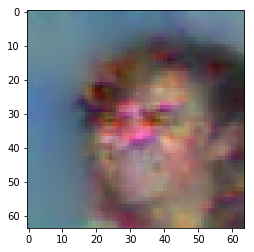

Iteration 625
Decision -6743.03662109375


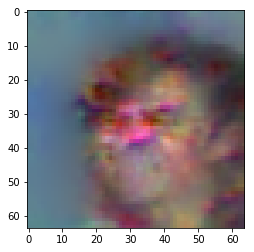

Iteration 750
Decision -7595.02001953125


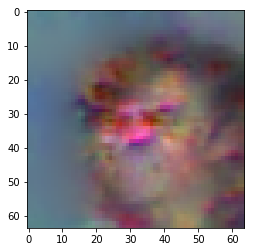

Iteration 875
Decision -8570.9921875


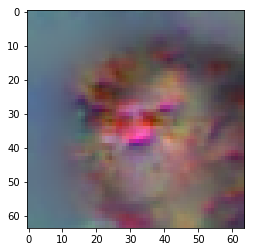

Iteration 0
Decision 531.4092407226562


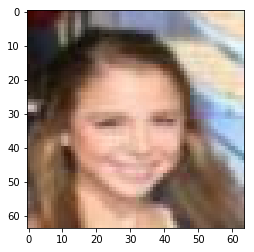

Iteration 125
Decision -2208.196044921875


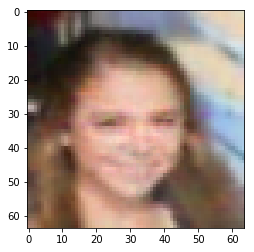

Iteration 250
Decision -3729.34814453125


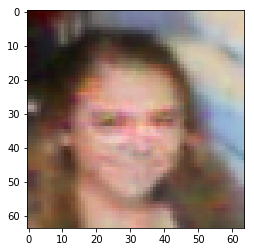

Iteration 375
Decision -5142.70654296875


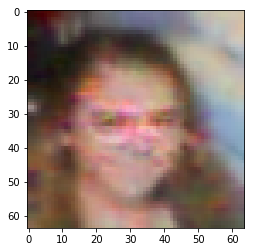

Iteration 500
Decision -6467.38232421875


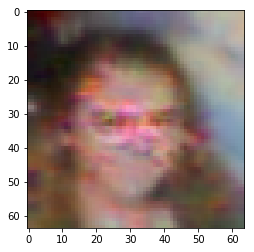

Iteration 625
Decision -7616.64208984375


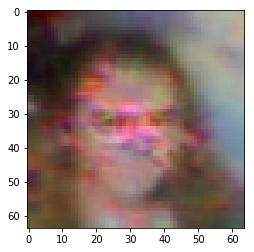

Iteration 750
Decision -8676.0986328125


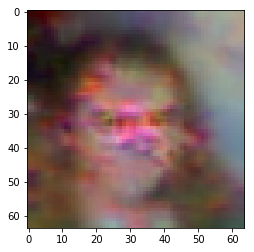

Iteration 875
Decision -9560.265625


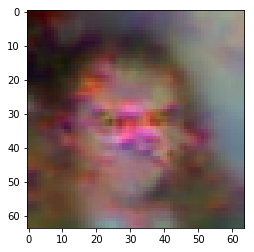

Iteration 0
Decision 20.95049476623535


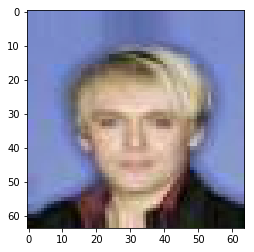

Iteration 125
Decision 1826.74169921875


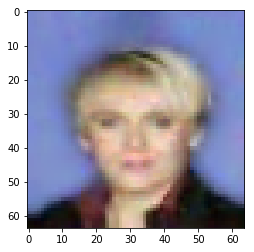

Iteration 250
Decision 2660.39404296875


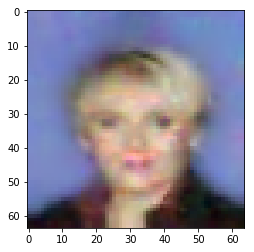

Iteration 375
Decision 3187.218994140625


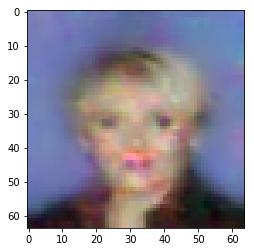

Iteration 500
Decision 3790.926025390625


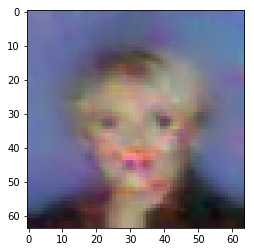

Iteration 625
Decision 4226.74267578125


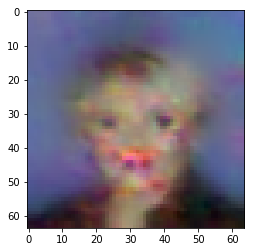

Iteration 750
Decision 4929.908203125


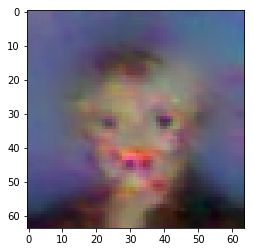

Iteration 875
Decision 5988.6533203125


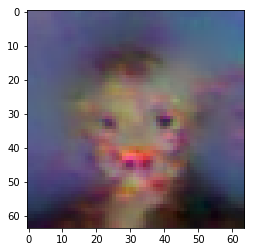

Iteration 0
Decision -224.8199462890625


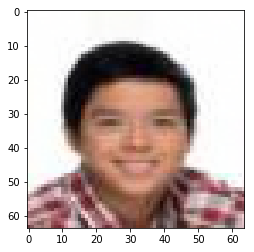

Iteration 125
Decision 2413.72216796875


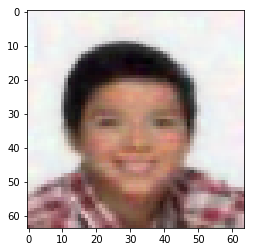

Iteration 250
Decision 3815.1357421875


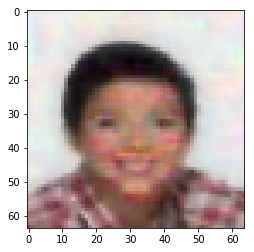

Iteration 375
Decision 4871.86865234375


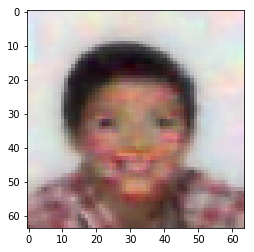

Iteration 500
Decision 5800.0908203125


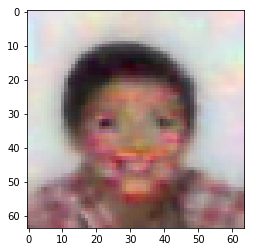

Iteration 625
Decision 6564.99462890625


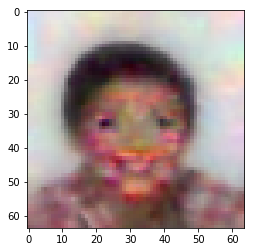

Iteration 750
Decision 7195.38134765625


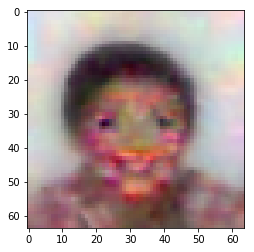

Iteration 875
Decision 7839.93359375


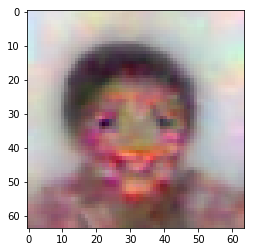

Iteration 0
Decision -517.7297973632812


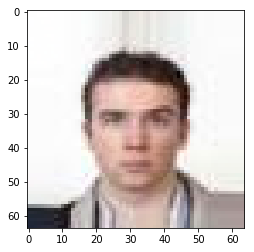

Iteration 125
Decision 1607.7755126953125


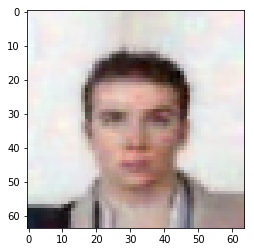

Iteration 250
Decision 2649.0537109375


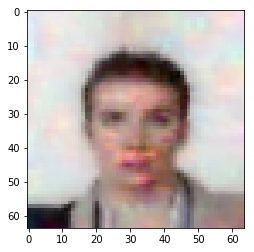

Iteration 375
Decision 3295.611572265625


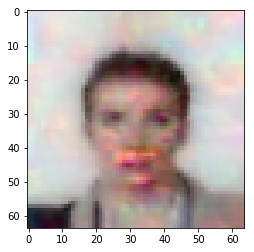

Iteration 500
Decision 3997.5029296875


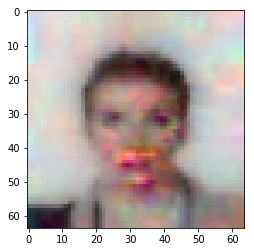

Iteration 625
Decision 4471.94091796875


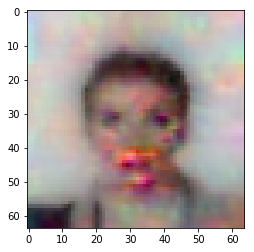

Iteration 750
Decision 4849.27880859375


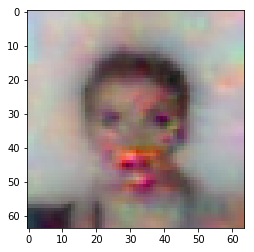

Iteration 875
Decision 5205.37646484375


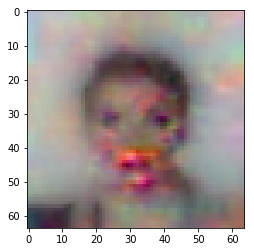

Iteration 0
Decision 471.7796630859375


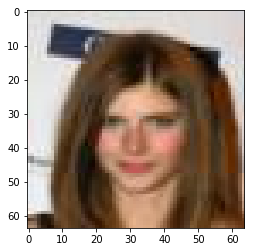

Iteration 125
Decision -1984.623291015625


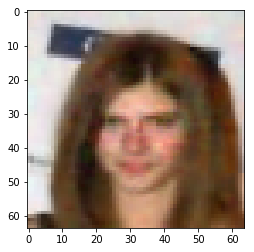

Iteration 250
Decision -3516.709228515625


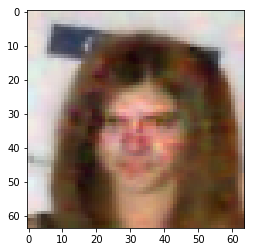

Iteration 375
Decision -4843.58154296875


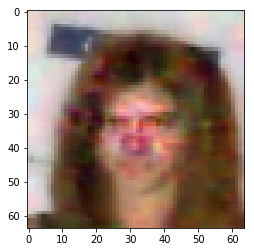

Iteration 500
Decision -6170.904296875


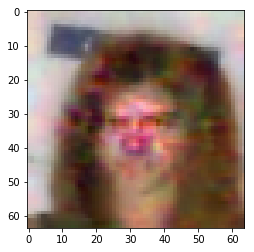

Iteration 625
Decision -7268.66357421875


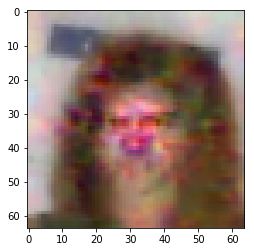

Iteration 750
Decision -8255.5205078125


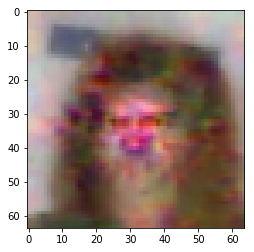

Iteration 875
Decision -9186.2734375


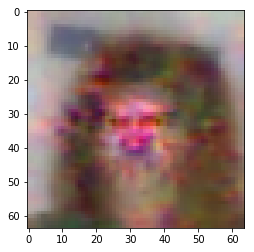

Iteration 0
Decision 685.1277465820312


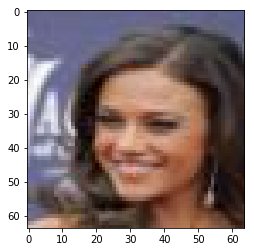

Iteration 125
Decision -1947.957763671875


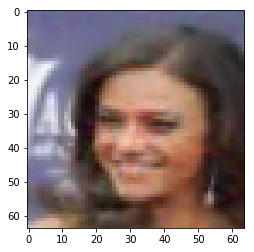

Iteration 250
Decision -3406.05224609375


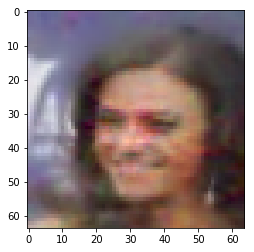

Iteration 375
Decision -4569.9443359375


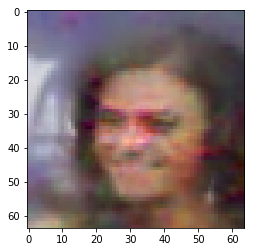

Iteration 500
Decision -5627.2890625


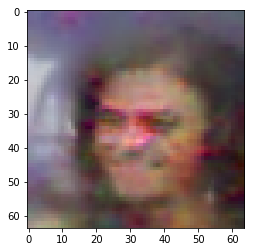

Iteration 625
Decision -6646.4609375


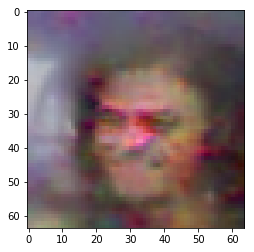

Iteration 750
Decision -7526.18115234375


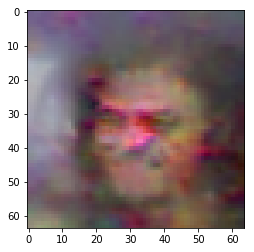

Iteration 875
Decision -8346.0087890625


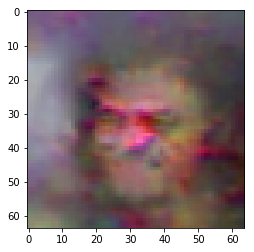

Iteration 0
Decision 1254.9139404296875


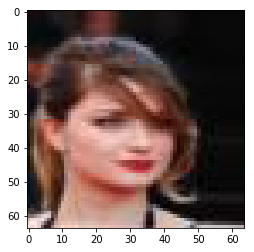

Iteration 125
Decision -2096.202392578125


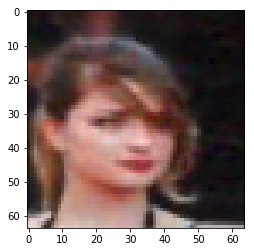

Iteration 250
Decision -3979.292236328125


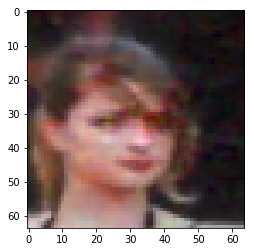

Iteration 375
Decision -5537.4716796875


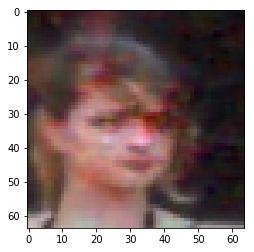

Iteration 500
Decision -6878.41357421875


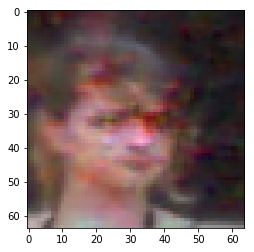

Iteration 625
Decision -8096.61474609375


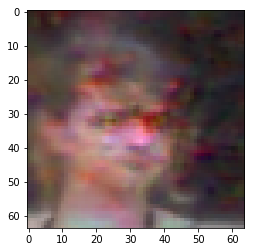

Iteration 750
Decision -9181.6513671875


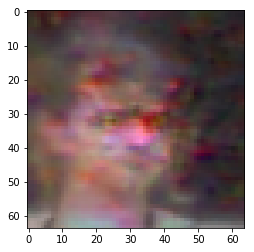

Iteration 875
Decision -10128.1796875


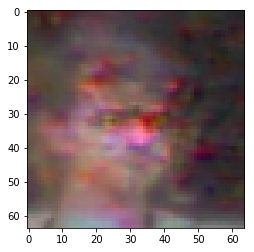

Iteration 0
Decision -832.1904296875


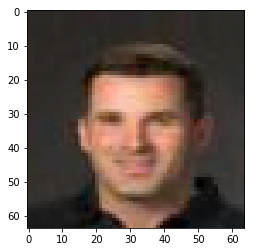

Iteration 125
Decision 2096.61279296875


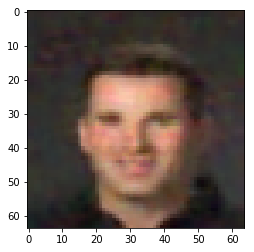

Iteration 250
Decision 3764.7822265625


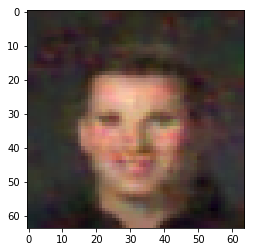

Iteration 375
Decision 4955.7421875


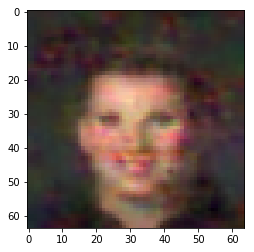

Iteration 500
Decision 5915.19384765625


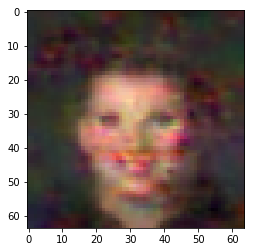

Iteration 625
Decision 6663.158203125


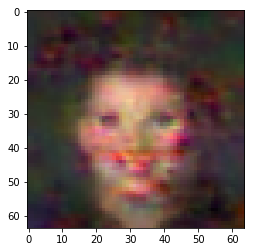

Iteration 750
Decision 7647.5947265625


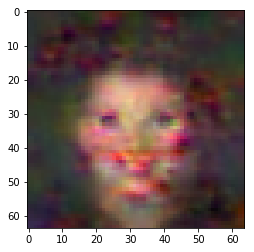

Iteration 875
Decision 8466.8974609375


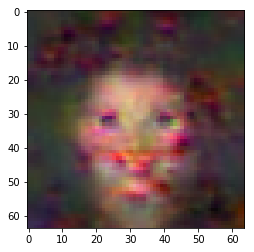

Iteration 0
Decision -505.9576416015625


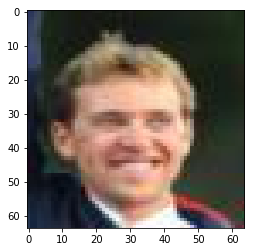

Iteration 125
Decision 2204.282470703125


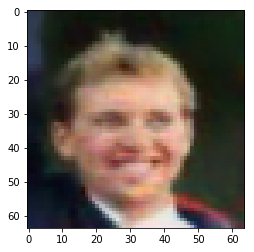

Iteration 250
Decision 3671.548583984375


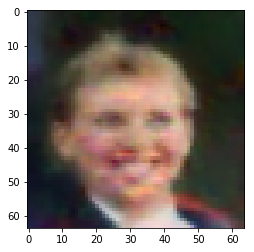

Iteration 375
Decision 4603.52685546875


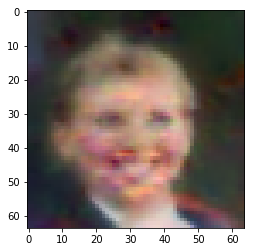

Iteration 500
Decision 5419.8857421875


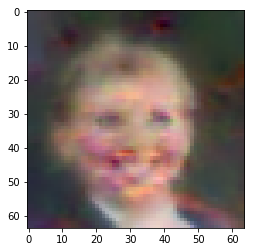

Iteration 625
Decision 6305.65673828125


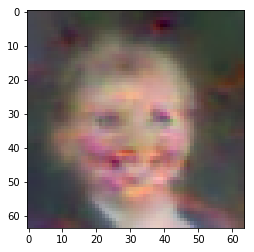

Iteration 750
Decision 7279.21728515625


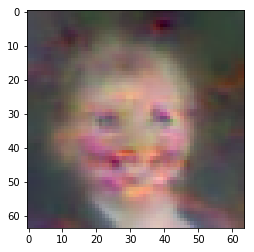

Iteration 875
Decision 8092.619140625


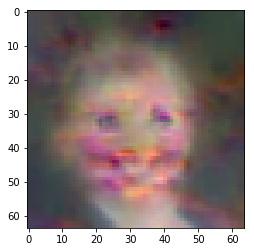

Iteration 0
Decision 425.4728088378906


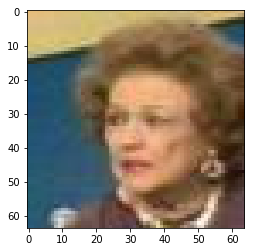

Iteration 125
Decision -1902.5726318359375


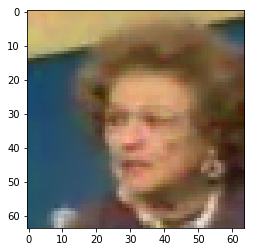

Iteration 250
Decision -3385.028564453125


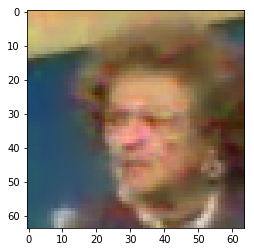

Iteration 375
Decision -4759.08447265625


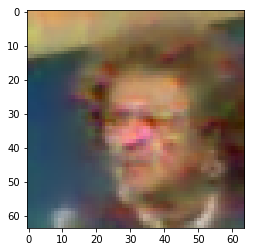

Iteration 500
Decision -6048.7216796875


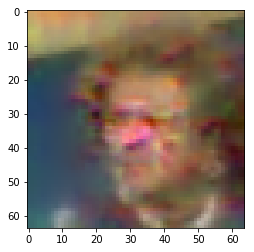

Iteration 625
Decision -7241.6748046875


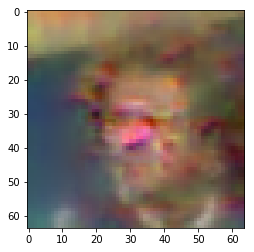

Iteration 750
Decision -8298.17578125


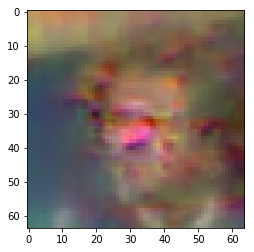

Iteration 875
Decision -9189.1435546875


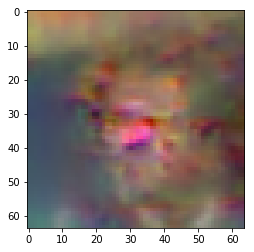

Iteration 0
Decision -156.4749298095703


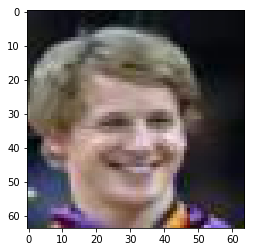

Iteration 125
Decision 2177.600830078125


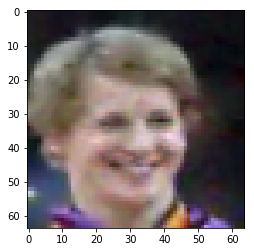

Iteration 250
Decision 3749.949951171875


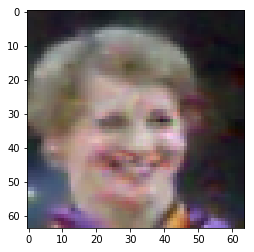

Iteration 375
Decision 5118.1650390625


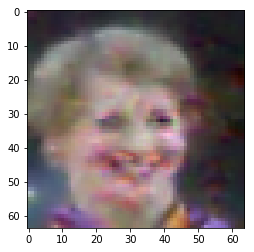

Iteration 500
Decision 6152.08447265625


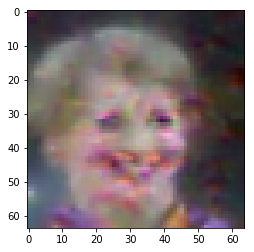

Iteration 625
Decision 7077.90625


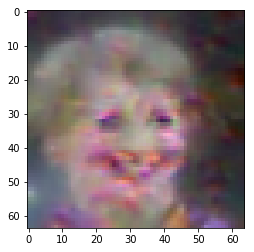

Iteration 750
Decision 7877.537109375


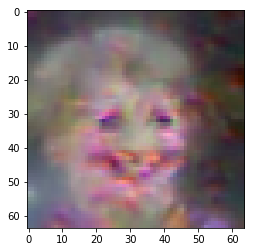

Iteration 875
Decision 8554.71484375


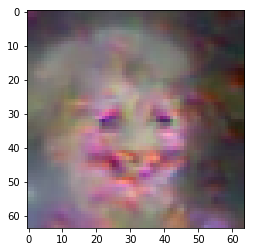

In [25]:
#TV for a selected image
for i in range(0,20):
    tv_weight = 0.002
    trainset = FaceDataset('./toTransfer/data_resized/Celeb_gender/trainA', './toTransfer/data_resized/Celeb_gender/trainB')
    a,b=trainset[random.randint(0, 200000)]
    image=torch.tensor(a,device=device).view(1,64,64,3).permute(0,3,1,2)
    image=image.type('torch.FloatTensor').to(device)
    fl=classifier(image)
    opp_gen=int(-1*np.sign(float(fl[0,0])))
    fooling_image = solve_exemplar_tv(classifier,image,0.1,1000,opp_gen,tv_weight)

Iteration 0
Decision -1.9474058151245117


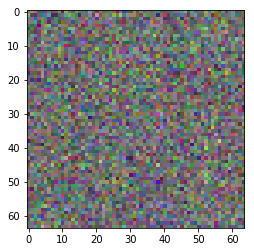

Iteration 62
Decision 72.70375061035156


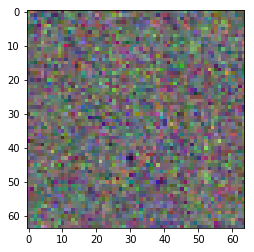

Iteration 124
Decision 168.48890686035156


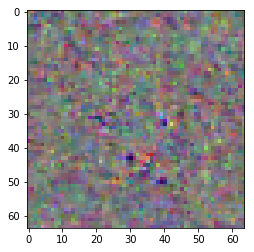

Iteration 186
Decision 268.0040588378906


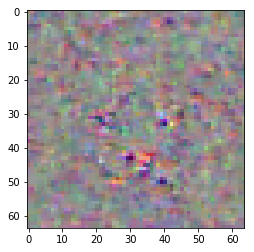

Iteration 248
Decision 357.09503173828125


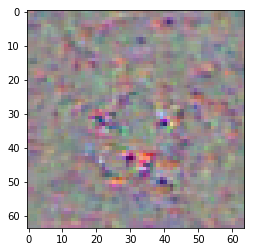

Iteration 310
Decision 437.836181640625


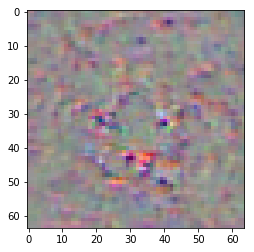

Iteration 372
Decision 505.8603820800781


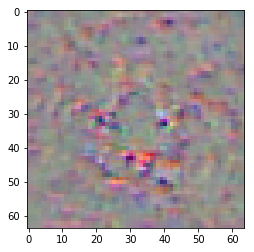

Iteration 434
Decision 568.1968994140625


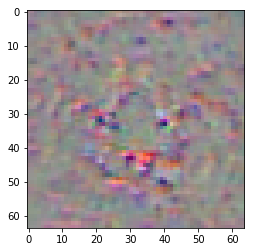

Iteration 496
Decision 623.3201293945312


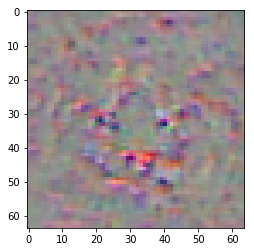

In [16]:
#TV for a random image
tv_weight = 2e-2
image=torch.randn(1,3,64,64,device=device)
fooling_image = solve_exemplar_tv(classifier,image,0.01,500,1,tv_weight)

Iteration 0
Decision -0.6137648224830627


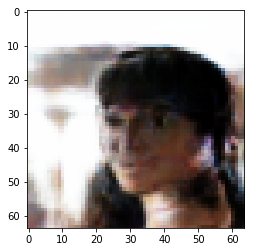

Iteration 18
Decision 5.034262657165527


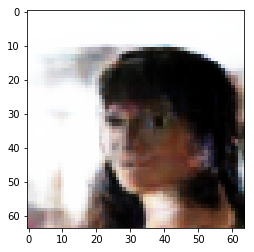

Iteration 36
Decision 7.888888359069824


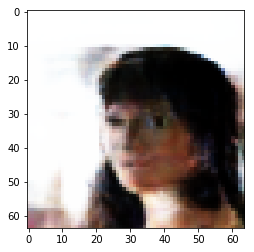

Iteration 54
Decision 9.756301879882812


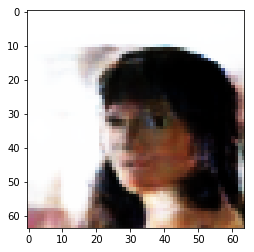

Iteration 72
Decision 11.973505973815918


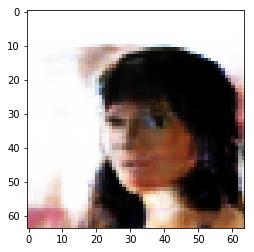

Iteration 90
Decision 13.489773750305176


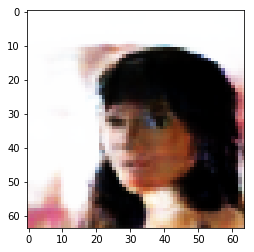

Iteration 108
Decision 14.737224578857422


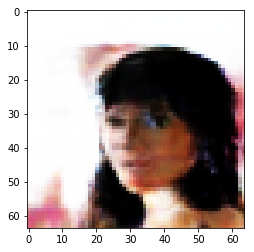

Iteration 126
Decision 15.6614408493042


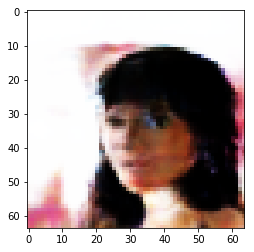

Iteration 144
Decision 16.577442169189453


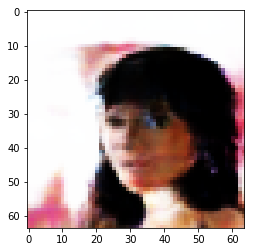

In [7]:
#Exemplar transition for random image
image=torch.randn(1,z_dim,device=device)
fl=classifier(generator(image))
opp_gen=int(-1*np.sign(float(fl[0,0])))
fooling_image = solve_exemplar_gan(classifier,generator,image,0.01,150,opp_gen)

In [26]:
#Boundary transition for image with tv
tv_weight = 5e-3
trainset = FaceDataset('./toTransfer/data_resized/Celeb_gender/trainA', './toTransfer/data_resized/Celeb_gender/trainB')
a,b=trainset[random.randint(0, 1000)]
image=torch.tensor(a,device=device).view(1,64,64,3).permute(0,3,1,2)
image=image.type('torch.FloatTensor').to(device)
fooling_image = solve_boundary_tv(classifier,image,0.1,1000,tv_weight)

NameError: name 'solve_boundary_tv' is not defined

Iteration 0
Decision 0.18443042039871216


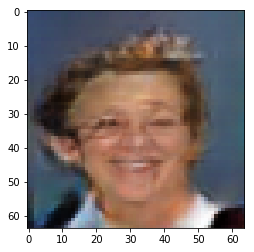

Iteration 250
Decision -4.800967872142792e-06


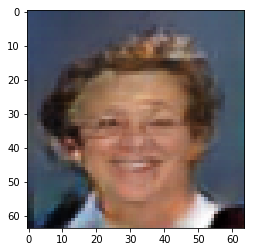

Iteration 500
Decision 8.617527782917023e-06


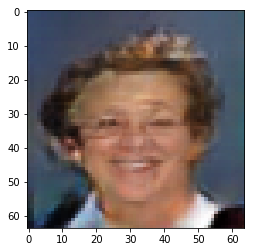

Iteration 750
Decision 4.026014357805252e-05


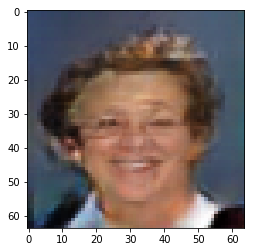

Iteration 1000
Decision 1.3143755495548248e-05


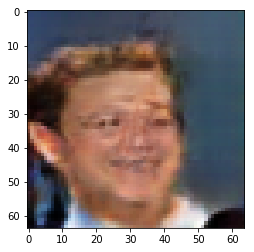

Iteration 1250
Decision -4.9388036131858826e-06


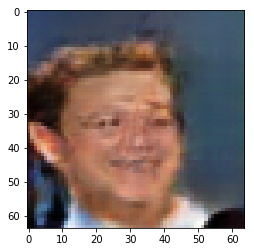

Iteration 1500
Decision -7.606111466884613e-06


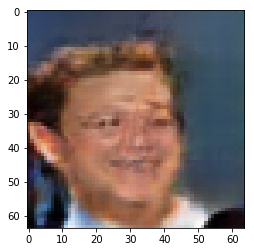

Iteration 1750
Decision 2.757180482149124e-05


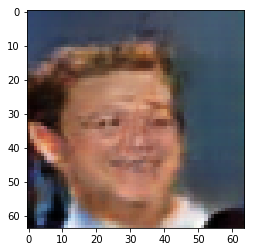

Iteration 2000
Decision 1.7163343727588654e-05


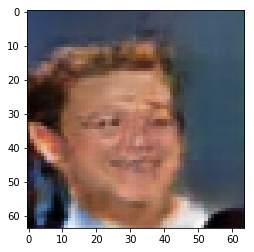

Iteration 0
Decision 13.35326099395752


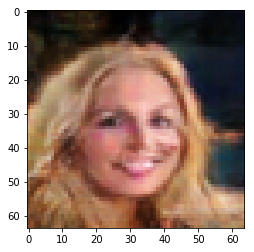

Iteration 250
Decision -9.04155895113945e-05


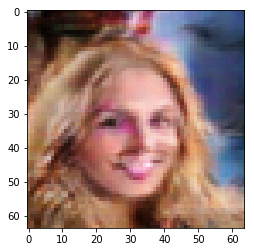

Iteration 500
Decision 2.5797635316848755e-07


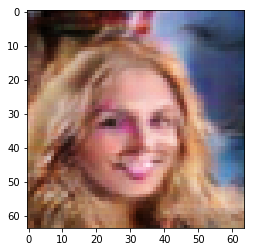

Iteration 750
Decision 2.5797635316848755e-07


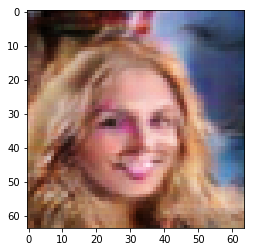

Iteration 1000
Decision 1.955777406692505e-08


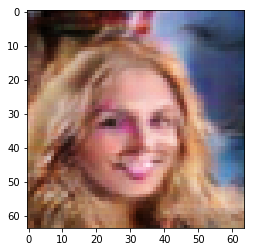

Iteration 1250
Decision 1.955777406692505e-08


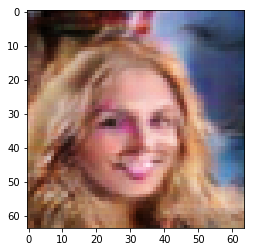

Iteration 1500
Decision 1.955777406692505e-08


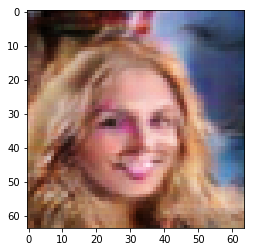

Iteration 1750
Decision 1.955777406692505e-08


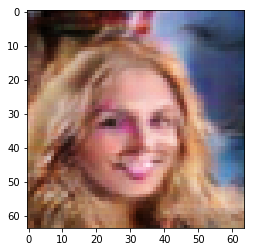

Iteration 2000
Decision 1.955777406692505e-08


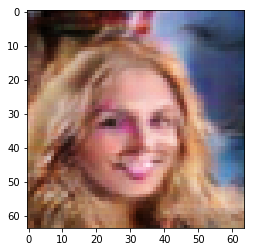

Iteration 0
Decision 7.180205345153809


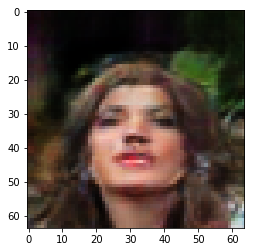

Iteration 250
Decision -3.273598849773407e-06


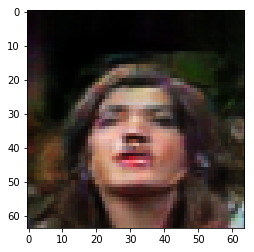

Iteration 500
Decision 6.379559636116028e-07


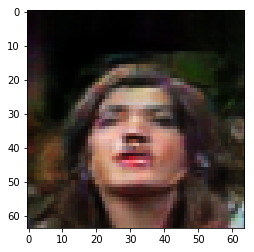

Iteration 750
Decision -1.0682269930839539e-06


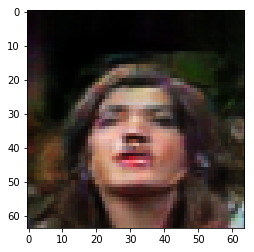

Iteration 1000
Decision 6.565824151039124e-07


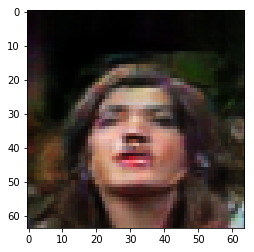

Iteration 1250
Decision -3.939494490623474e-07


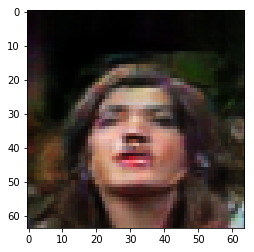

Iteration 1500
Decision 1.2116506695747375e-06


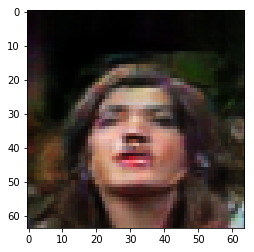

Iteration 1750
Decision 4.2188912630081177e-07


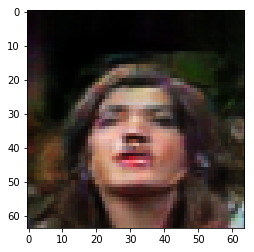

Iteration 2000
Decision -5.615875124931335e-07


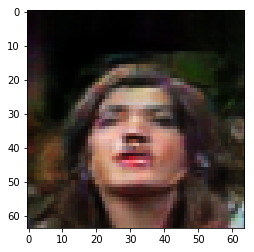

Iteration 0
Decision 14.738715171813965


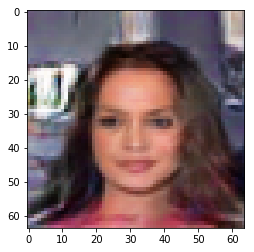

Iteration 250
Decision 3.0742958188056946e-06


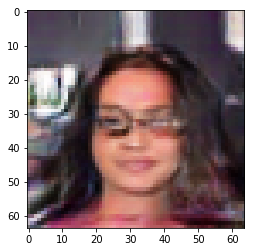

Iteration 500
Decision -6.509944796562195e-07


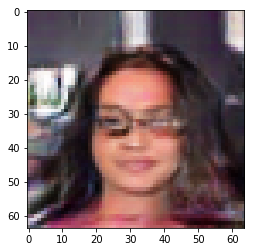

Iteration 750
Decision 3.026798367500305e-07


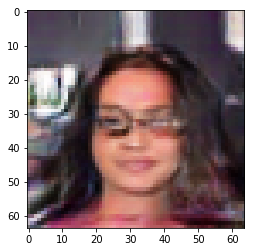

Iteration 1000
Decision 1.7033889889717102e-06


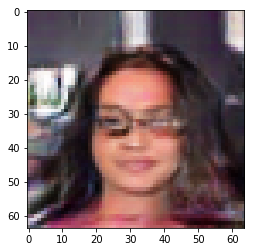

Iteration 1250
Decision -1.0682269930839539e-06


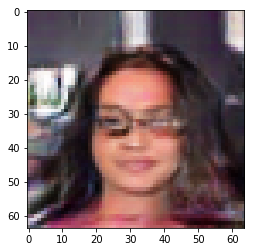

Iteration 1500
Decision -5.019828677177429e-07


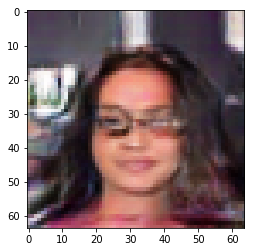

Iteration 1750
Decision -5.494803190231323e-08


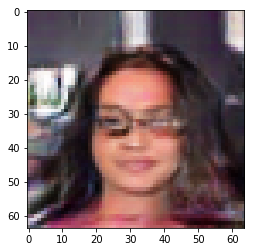

Iteration 2000
Decision -1.7415732145309448e-07


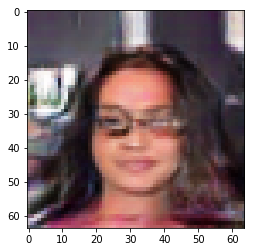

Iteration 0
Decision 5.814013481140137


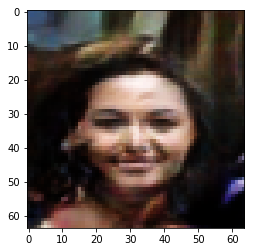

Iteration 250
Decision 3.0742958188056946e-06


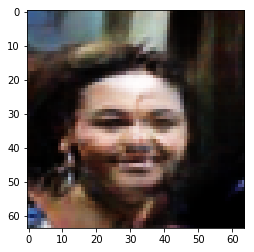

Iteration 500
Decision -5.913898348808289e-07


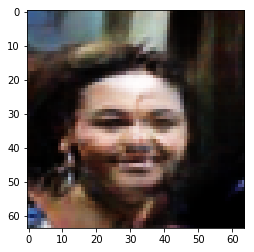

Iteration 750
Decision -4.721805453300476e-07


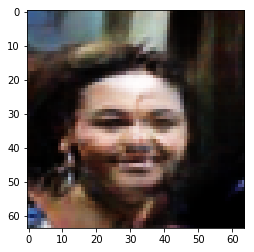

Iteration 1000
Decision 3.026798367500305e-07


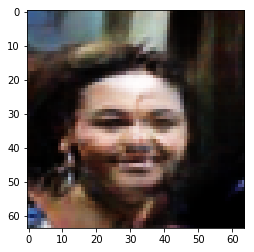

Iteration 1250
Decision -8.00006091594696e-07


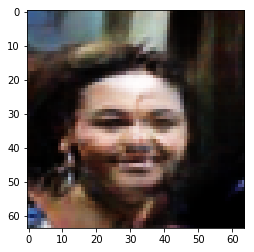

Iteration 1500
Decision -1.3960525393486023e-06


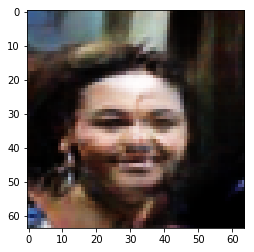

Iteration 1750
Decision -4.346482455730438e-06


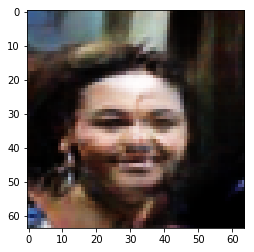

Iteration 2000
Decision 2.728775143623352e-07


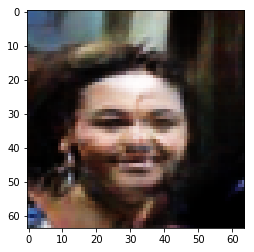

Iteration 0
Decision 2.592217206954956


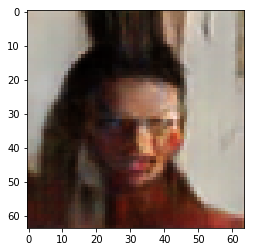

Iteration 250
Decision 5.51808625459671e-06


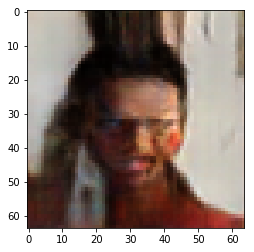

Iteration 500
Decision 7.348135113716125e-07


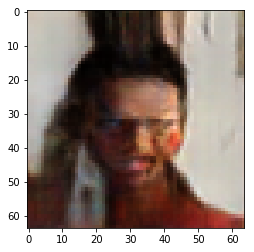

Iteration 750
Decision -8.745118975639343e-07


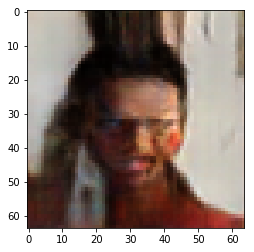

Iteration 1000
Decision -7.404014468193054e-07


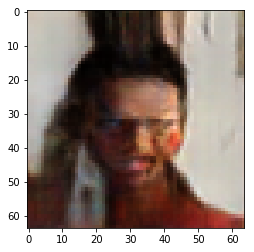

Iteration 1250
Decision 2.746470272541046e-06


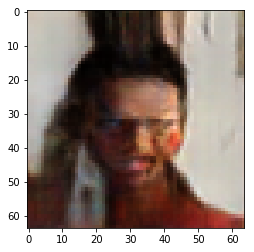

Iteration 1500
Decision 3.4766271710395813e-06


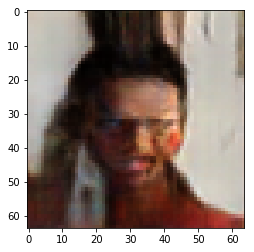

Iteration 1750
Decision -2.3944303393363953e-06


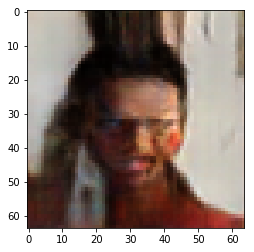

Iteration 2000
Decision 1.5245750546455383e-06


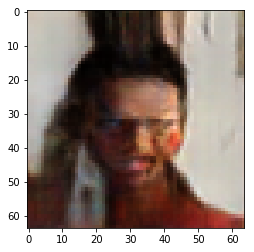

Iteration 0
Decision 4.655041217803955


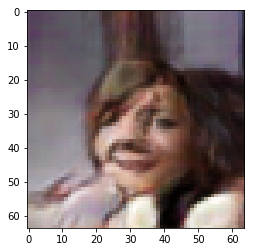

Iteration 250
Decision -2.5546178221702576e-06


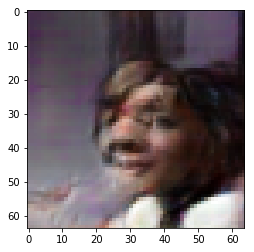

Iteration 500
Decision -1.932494342327118e-06


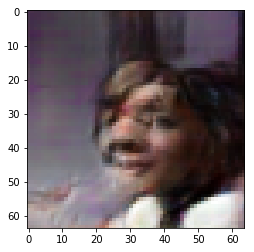

Iteration 750
Decision 2.65706330537796e-06


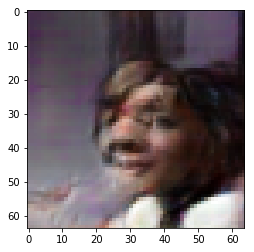

Iteration 1000
Decision 9.844079613685608e-07


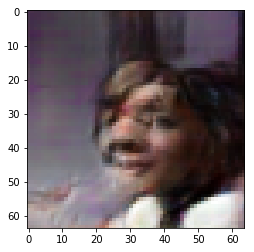

Iteration 1250
Decision 1.494772732257843e-06


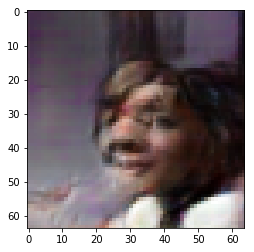

Iteration 1500
Decision 7.720664143562317e-07


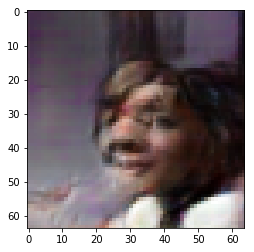

Iteration 1750
Decision -1.3029202818870544e-06


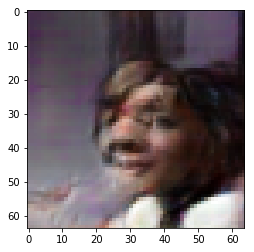

Iteration 2000
Decision 2.195127308368683e-06


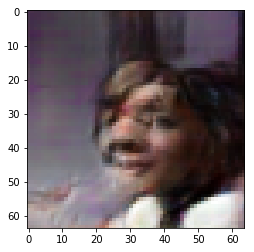

Iteration 0
Decision 12.208453178405762


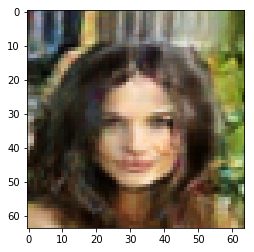

Iteration 250
Decision 1.0670162737369537e-05


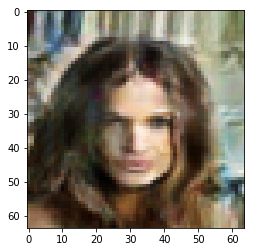

Iteration 500
Decision -1.0831281542778015e-06


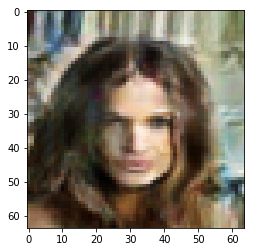

Iteration 750
Decision 5.559995770454407e-07


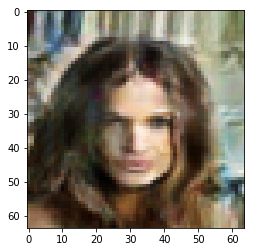

Iteration 1000
Decision 2.3283064365386963e-08


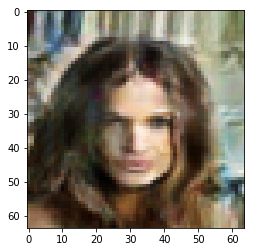

Iteration 1250
Decision 2.3283064365386963e-08


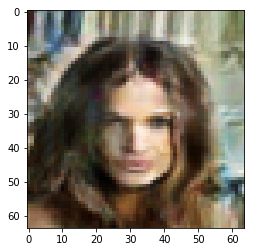

Iteration 1500
Decision 2.3283064365386963e-08


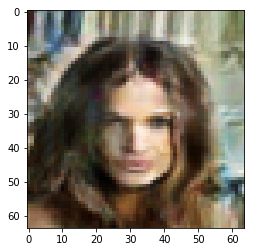

Iteration 1750
Decision 2.3283064365386963e-08


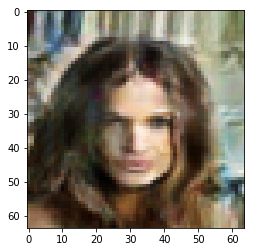

Iteration 2000
Decision 2.3283064365386963e-08


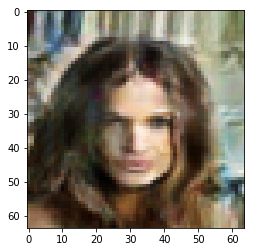

Iteration 0
Decision 8.336832046508789


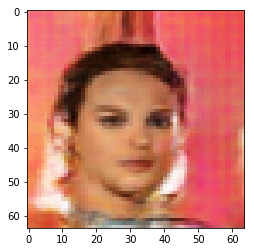

Iteration 250
Decision -9.025447070598602e-06


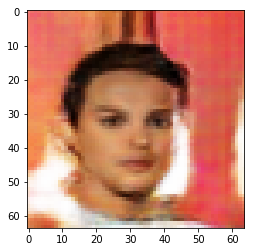

Iteration 500
Decision 1.5366822481155396e-07


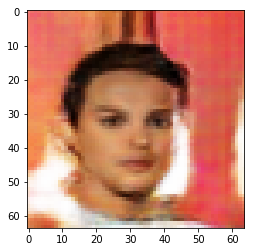

Iteration 750
Decision -6.211921572685242e-07


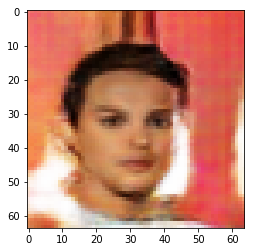

Iteration 1000
Decision 1.4649704098701477e-06


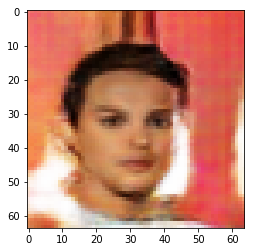

Iteration 1250
Decision 9.881332516670227e-07


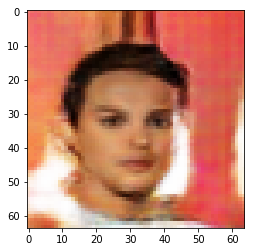

Iteration 1500
Decision 3.4458935260772705e-08


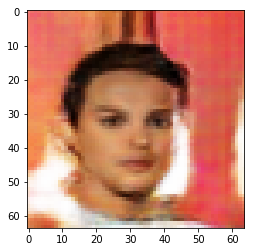

Iteration 1750
Decision 9.406358003616333e-08


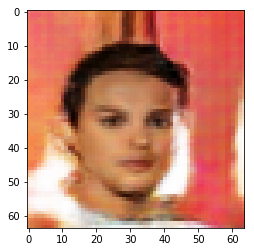

Iteration 2000
Decision -3.363005816936493e-06


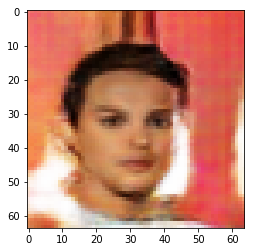

Iteration 0
Decision 16.850311279296875


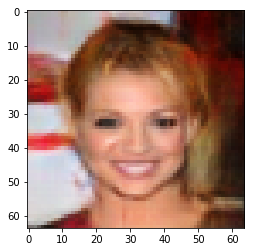

Iteration 250
Decision -2.634059637784958e-05


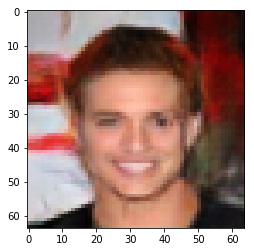

Iteration 500
Decision 1.2386590242385864e-07


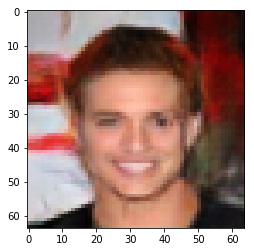

Iteration 750
Decision 1.2386590242385864e-07


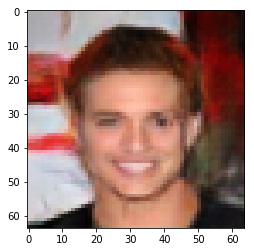

Iteration 1000
Decision 2.728775143623352e-07


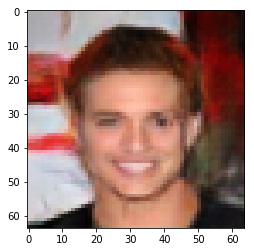

Iteration 1250
Decision 1.5366822481155396e-07


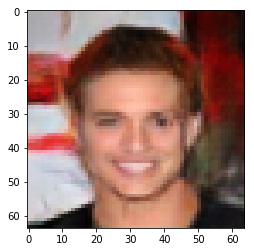

Iteration 1500
Decision -2.039596438407898e-07


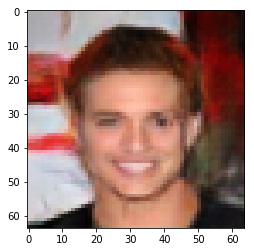

Iteration 1750
Decision -5.913898348808289e-07


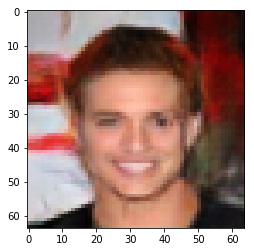

Iteration 2000
Decision -5.019828677177429e-07


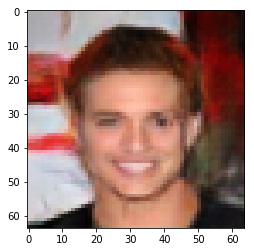

Iteration 0
Decision 13.29570198059082


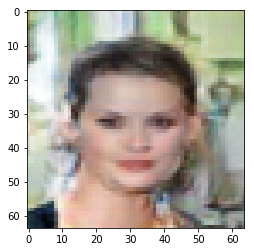

Iteration 250
Decision -4.498288035392761e-07


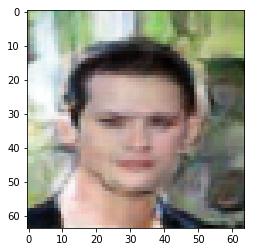

Iteration 500
Decision -2.514570951461792e-08


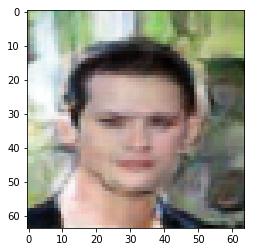

Iteration 750
Decision -2.514570951461792e-08


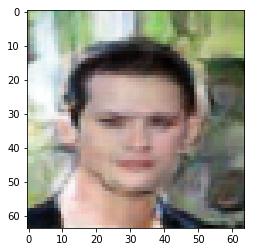

Iteration 1000
Decision -3.2316893339157104e-07


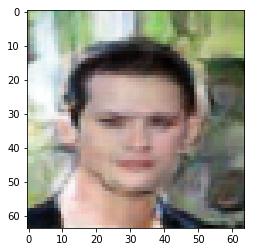

Iteration 1250
Decision 4.069879651069641e-07


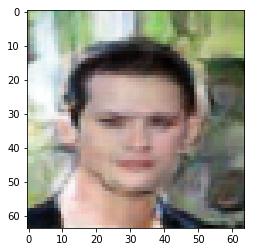

Iteration 1500
Decision 5.681067705154419e-08


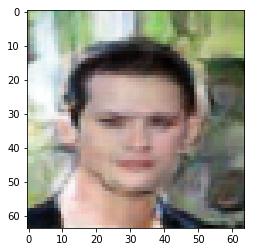

Iteration 1750
Decision -1.4184042811393738e-06


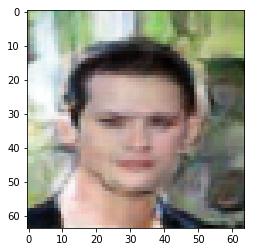

Iteration 2000
Decision 2.1355226635932922e-06


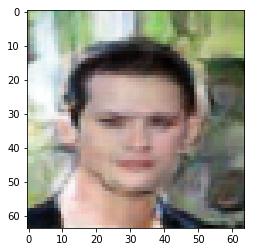

Iteration 0
Decision -9.097469329833984


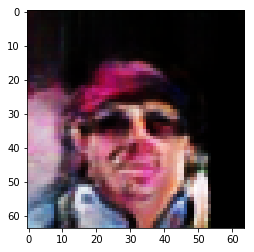

Iteration 250
Decision -1.2172386050224304e-06


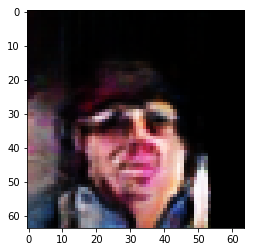

Iteration 500
Decision -3.3034011721611023e-06


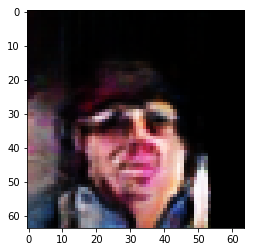

Iteration 750
Decision 9.881332516670227e-07


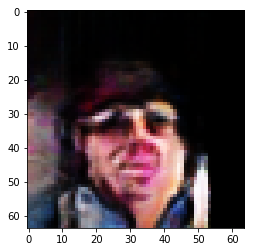

Iteration 1000
Decision -2.0815059542655945e-06


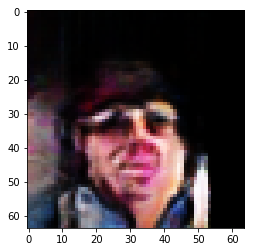

Iteration 1250
Decision -1.6940757632255554e-06


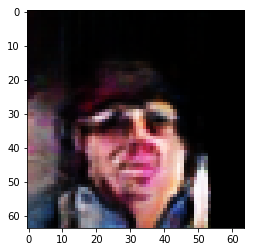

Iteration 1500
Decision -1.6940757632255554e-06


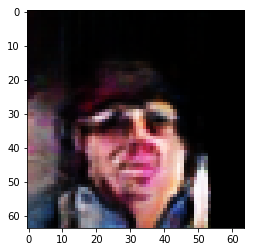

Iteration 1750
Decision 9.881332516670227e-07


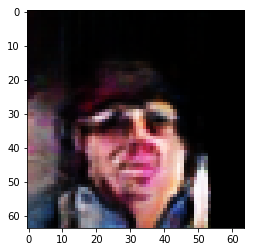

Iteration 2000
Decision 1.3457611203193665e-06


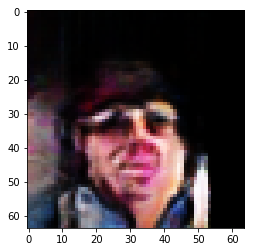

Iteration 0
Decision 13.742425918579102


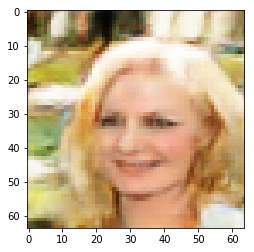

Iteration 250
Decision 3.5958364605903625e-06


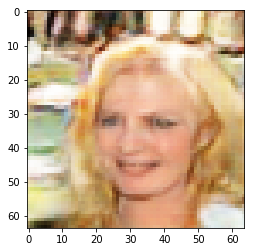

Iteration 500
Decision 6.426125764846802e-08


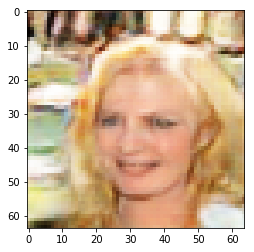

Iteration 750
Decision 6.426125764846802e-08


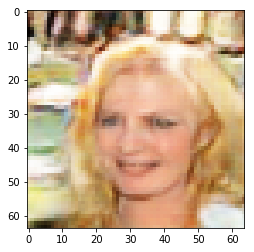

Iteration 1000
Decision 6.426125764846802e-08


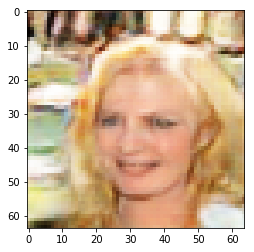

Iteration 1250
Decision -7.404014468193054e-07


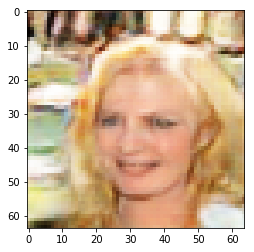

Iteration 1500
Decision -7.404014468193054e-07


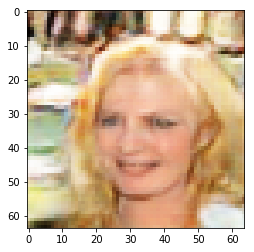

Iteration 1750
Decision 2.1327286958694458e-07


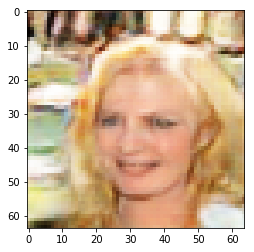

Iteration 2000
Decision 2.8777867555618286e-07


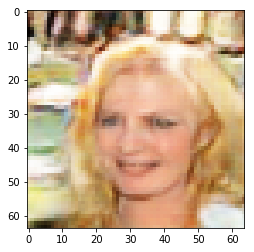

Iteration 0
Decision -0.07326412945985794


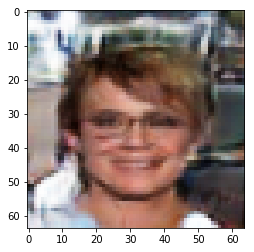

Iteration 250
Decision -1.3513490557670593e-06


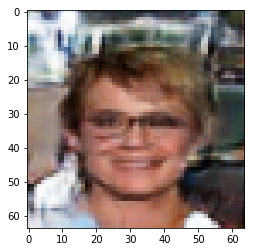

Iteration 500
Decision -1.7015263438224792e-06


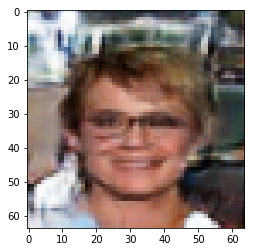

Iteration 750
Decision 2.9997900128364563e-06


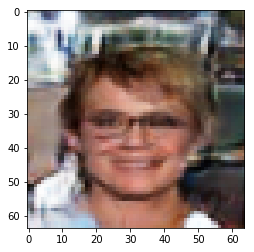

Iteration 1000
Decision 2.146698534488678e-06


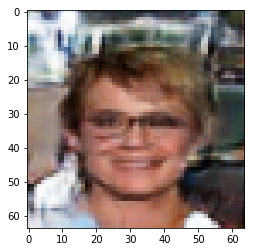

Iteration 1250
Decision 6.826594471931458e-07


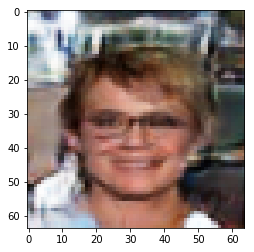

Iteration 1500
Decision 1.0775402188301086e-06


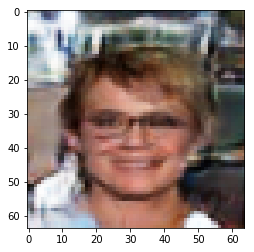

Iteration 1750
Decision -8.842907845973969e-06


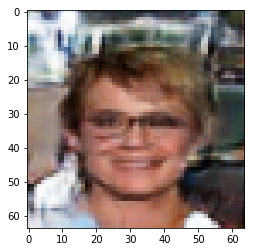

Iteration 2000
Decision -8.466653525829315e-06


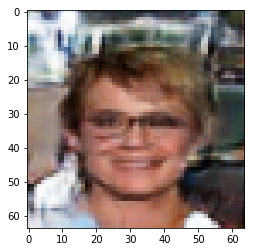

Iteration 0
Decision -17.710969924926758


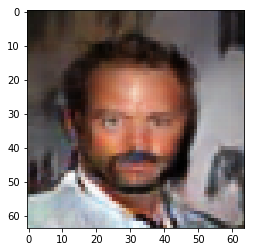

Iteration 250
Decision -0.0016988767310976982


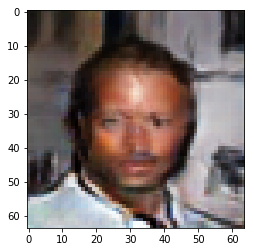

Iteration 500
Decision 4.2188912630081177e-07


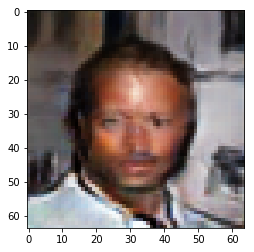

Iteration 750
Decision 4.2188912630081177e-07


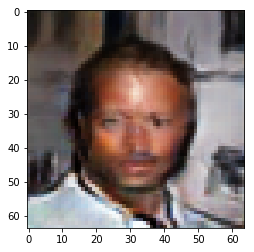

Iteration 1000
Decision 4.2188912630081177e-07


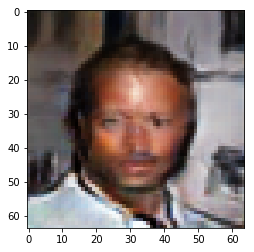

Iteration 1250
Decision -1.1874362826347351e-06


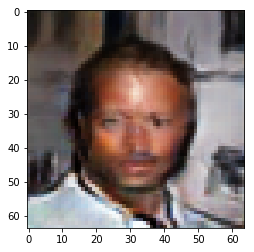

Iteration 1500
Decision -1.1874362826347351e-06


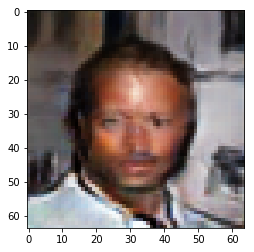

Iteration 1750
Decision 1.5366822481155396e-07


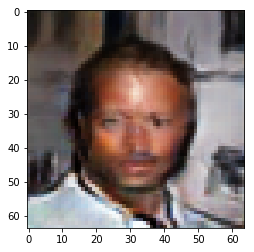

Iteration 2000
Decision -3.2316893339157104e-07


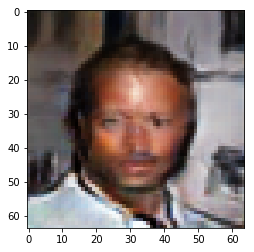

Iteration 0
Decision 14.680956840515137


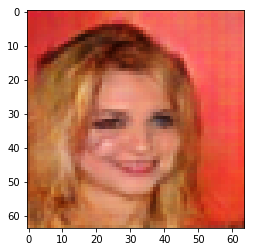

Iteration 250
Decision 0.00011697877198457718


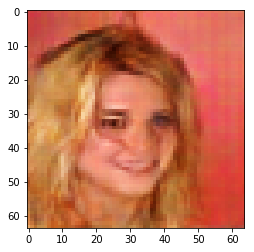

Iteration 500
Decision -3.8277357816696167e-07


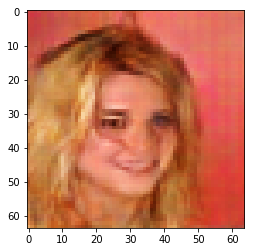

Iteration 750
Decision -3.8277357816696167e-07


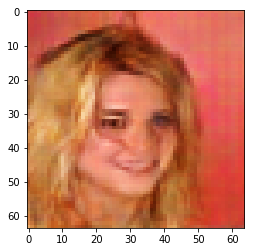

Iteration 1000
Decision -3.8277357816696167e-07


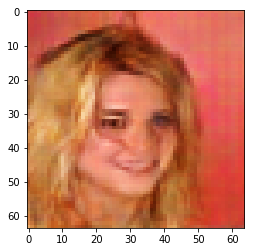

Iteration 1250
Decision -3.8277357816696167e-07


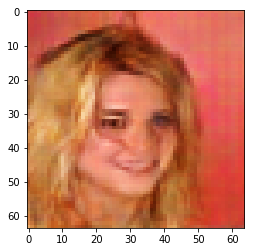

Iteration 1500
Decision -3.8277357816696167e-07


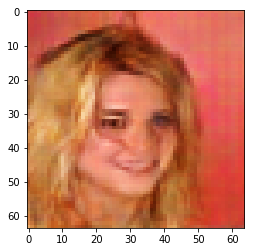

Iteration 1750
Decision -3.8277357816696167e-07


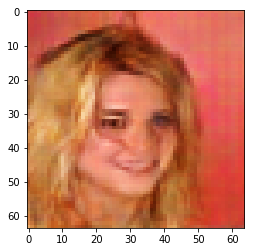

Iteration 2000
Decision -3.8277357816696167e-07


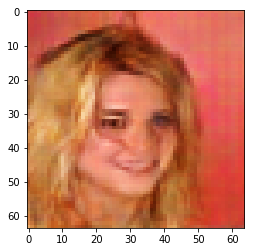

Iteration 0
Decision 7.427610874176025


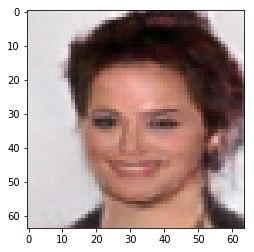

Iteration 250
Decision 6.901100277900696e-07


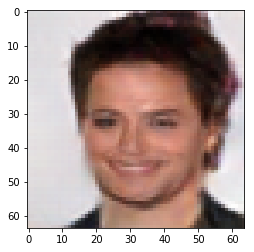

Iteration 500
Decision -6.956979632377625e-07


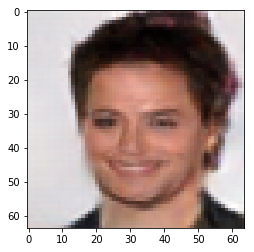

Iteration 750
Decision -2.635642886161804e-07


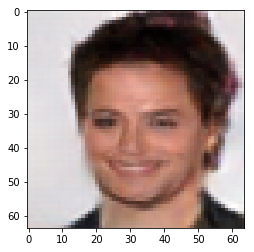

Iteration 1000
Decision -1.8132850527763367e-06


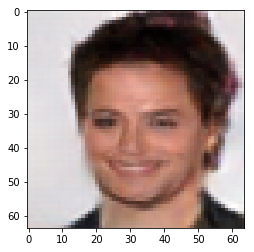

Iteration 1250
Decision -2.1709129214286804e-06


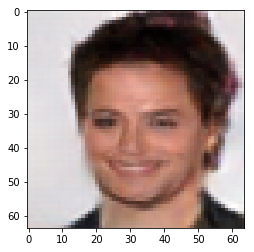

Iteration 1500
Decision 6.156042218208313e-07


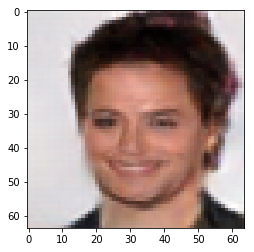

Iteration 1750
Decision -7.255002856254578e-07


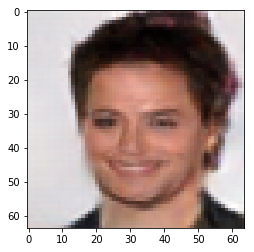

Iteration 2000
Decision 1.4426186680793762e-06


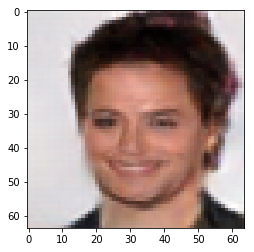

Iteration 0
Decision 8.081416130065918


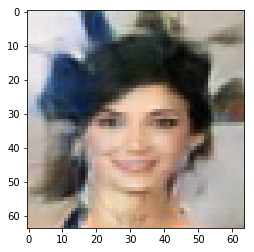

Iteration 250
Decision -3.2689422369003296e-07


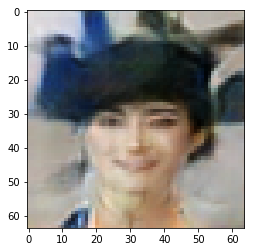

Iteration 500
Decision 1.0812655091285706e-06


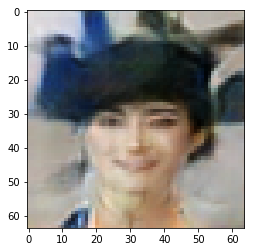

Iteration 750
Decision 3.213062882423401e-07


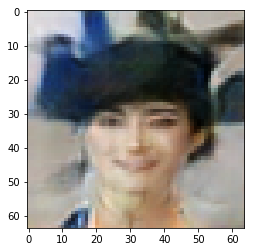

Iteration 1000
Decision 4.10713255405426e-07


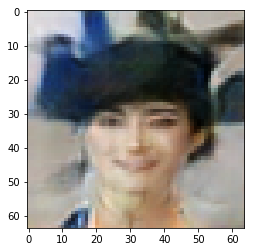

Iteration 1250
Decision -2.010725438594818e-06


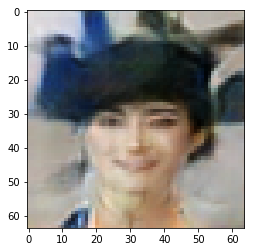

Iteration 1500
Decision -3.0081719160079956e-07


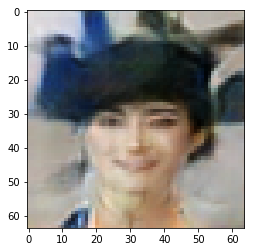

Iteration 1750
Decision -3.082677721977234e-07


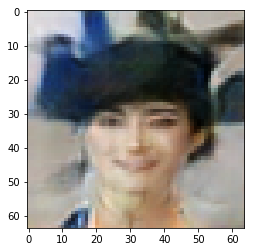

Iteration 2000
Decision -6.984919309616089e-08


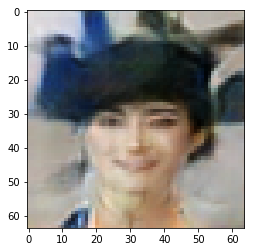

Iteration 0
Decision 10.819091796875


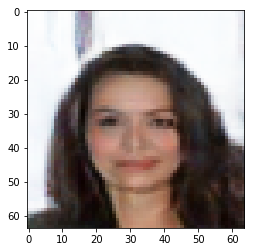

Iteration 250
Decision -1.1066906154155731e-05


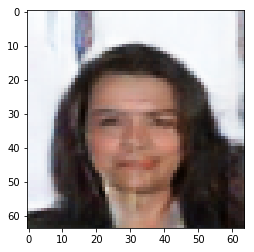

Iteration 500
Decision 5.038455128669739e-07


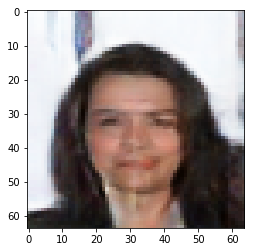

Iteration 750
Decision -8.149072527885437e-07


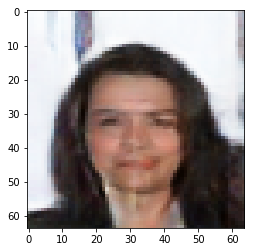

Iteration 1000
Decision 1.2386590242385864e-07


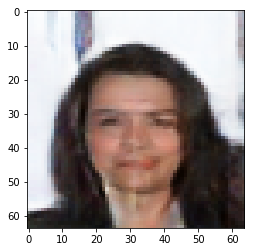

Iteration 1250
Decision 5.634501576423645e-07


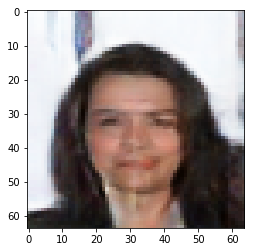

Iteration 1500
Decision 1.6586855053901672e-06


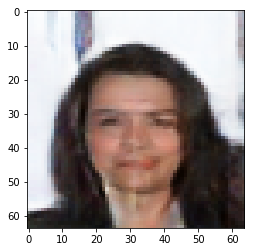

Iteration 1750
Decision 8.763745427131653e-07


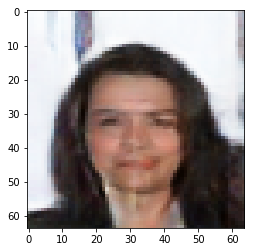

Iteration 2000
Decision -1.3886019587516785e-06


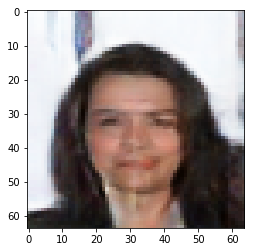

Iteration 0
Decision 1.1098196506500244


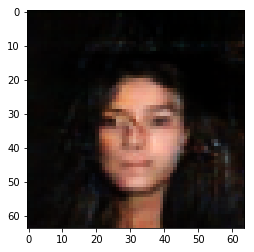

Iteration 250
Decision -3.3704563975334167e-06


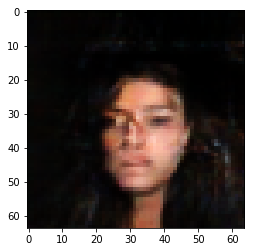

Iteration 500
Decision 6.695277988910675e-06


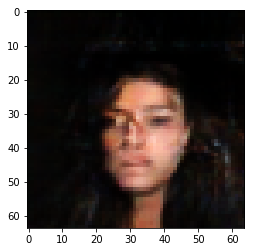

Iteration 750
Decision -1.114141196012497e-05


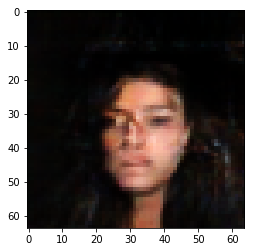

Iteration 1000
Decision 0.008353550918400288


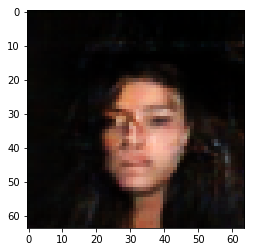

Iteration 1250
Decision 8.230097591876984e-06


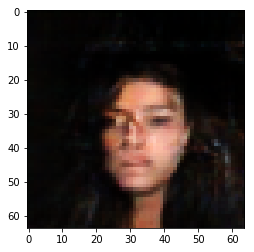

Iteration 1500
Decision 1.5486963093280792e-05


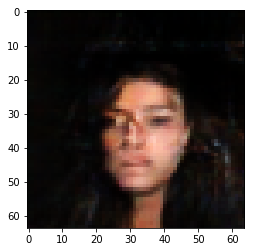

Iteration 1750
Decision 5.478132516145706e-05


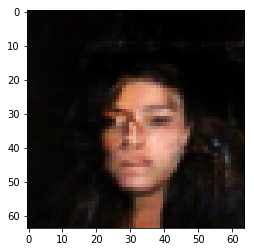

Iteration 2000
Decision -7.798802107572556e-05


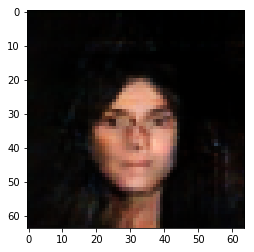

Iteration 0
Decision -7.9363484382629395


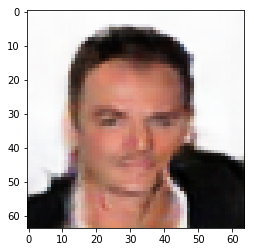

Iteration 250
Decision 8.118338882923126e-06


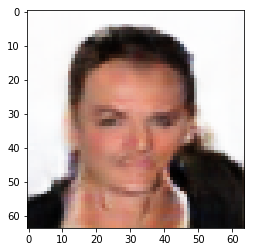

Iteration 500
Decision -2.7939677238464355e-09


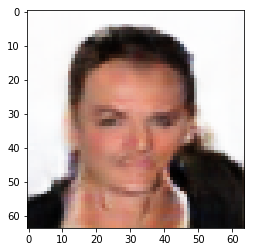

Iteration 750
Decision 3.3993273973464966e-07


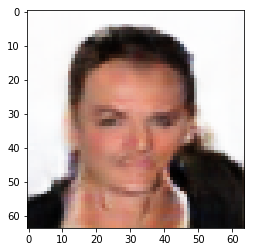

Iteration 1000
Decision 8.838251233100891e-07


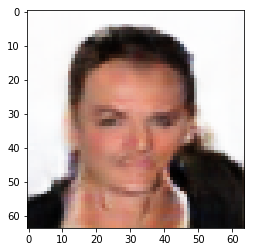

Iteration 1250
Decision 1.0924413800239563e-06


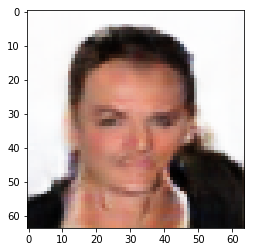

Iteration 1500
Decision 1.3308599591255188e-06


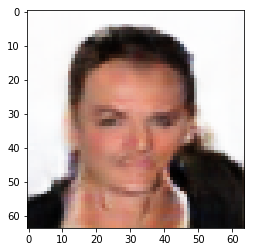

Iteration 1750
Decision -5.094334483146667e-07


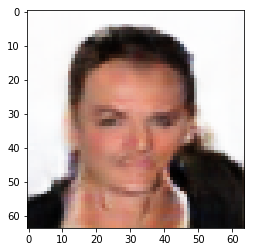

Iteration 2000
Decision 1.9120052456855774e-06


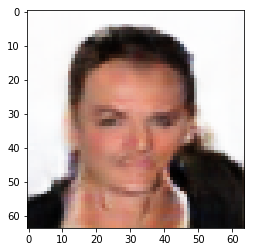

Iteration 0
Decision 4.1519575119018555


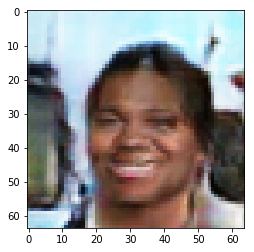

Iteration 250
Decision 1.2265518307685852e-06


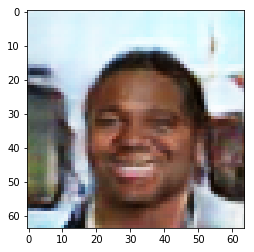

Iteration 500
Decision -3.2316893339157104e-07


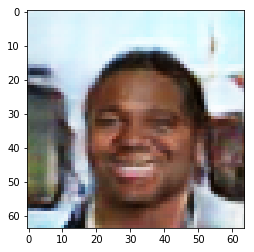

Iteration 750
Decision 9.406358003616333e-08


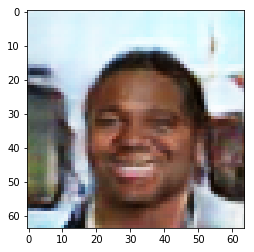

Iteration 1000
Decision -8.475035429000854e-08


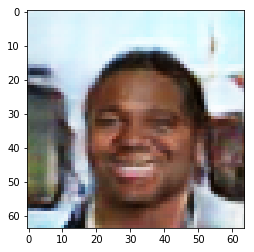

Iteration 1250
Decision -8.475035429000854e-08


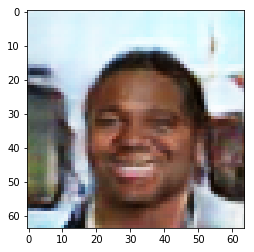

Iteration 1500
Decision -8.475035429000854e-08


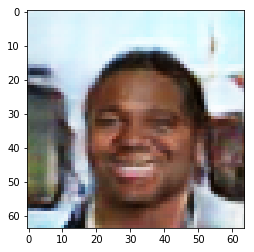

Iteration 1750
Decision -8.475035429000854e-08


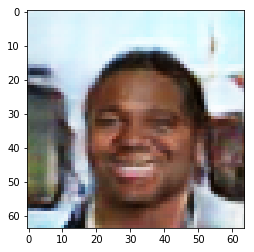

Iteration 2000
Decision 9.406358003616333e-08


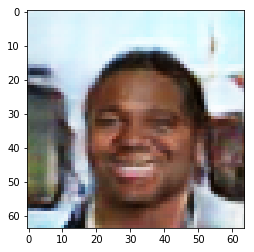

Iteration 0
Decision -6.017160892486572


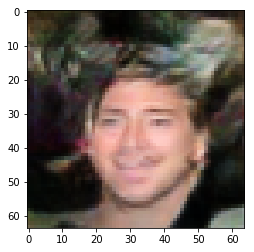

Iteration 250
Decision -1.5599653124809265e-06


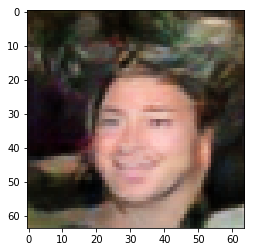

Iteration 500
Decision -2.6961788535118103e-06


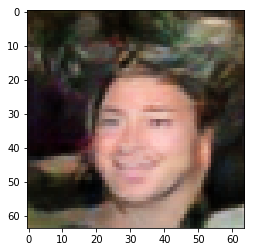

Iteration 750
Decision 3.1152740120887756e-06


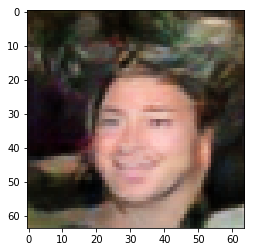

Iteration 1000
Decision 9.583309292793274e-07


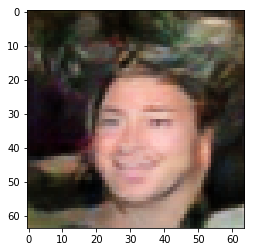

Iteration 1250
Decision -1.7276033759117126e-06


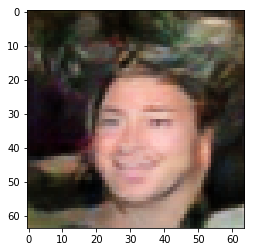

Iteration 1500
Decision 3.4617260098457336e-06


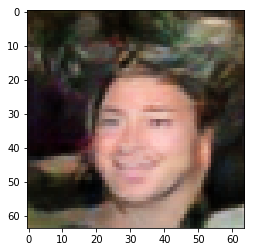

Iteration 1750
Decision 1.8337741494178772e-06


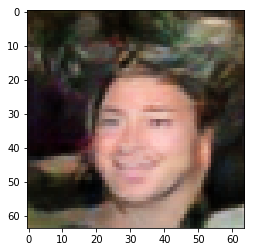

Iteration 2000
Decision 3.5101547837257385e-06


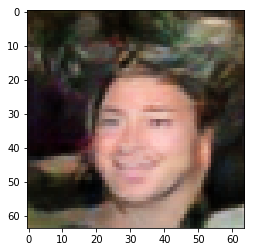

Iteration 0
Decision 9.069643020629883


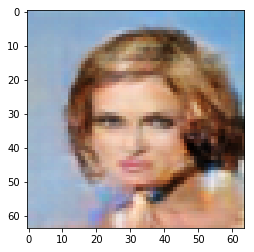

Iteration 250
Decision -2.039596438407898e-07


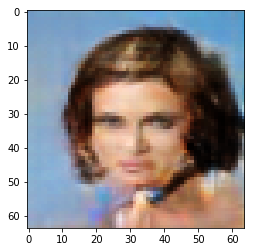

Iteration 500
Decision 2.1327286958694458e-07


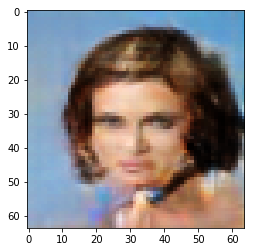

Iteration 750
Decision -3.8277357816696167e-07


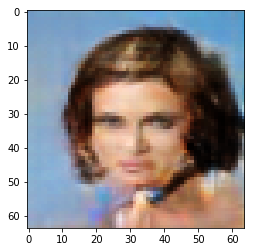

Iteration 1000
Decision 3.3248215913772583e-07


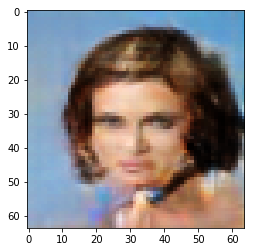

Iteration 1250
Decision -1.5152618288993835e-06


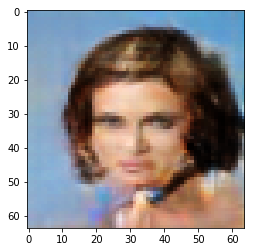

Iteration 1500
Decision -6.211921572685242e-07


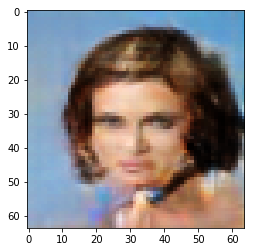

Iteration 1750
Decision 3.4458935260772705e-08


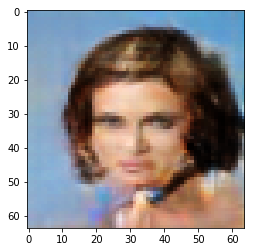

Iteration 2000
Decision 8.093193173408508e-07


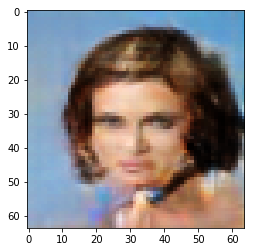

Iteration 0
Decision 5.866253852844238


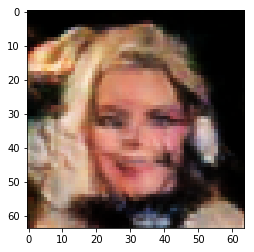

Iteration 250
Decision 2.9550865292549133e-06


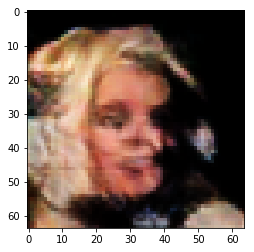

Iteration 500
Decision -3.2316893339157104e-07


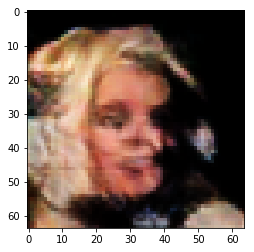

Iteration 750
Decision -1.6791746020317078e-06


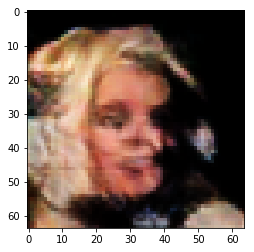

Iteration 1000
Decision -5.019828677177429e-07


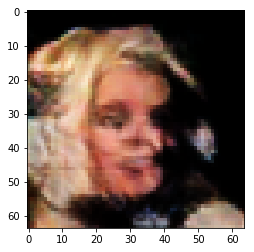

Iteration 1250
Decision -1.1427327990531921e-06


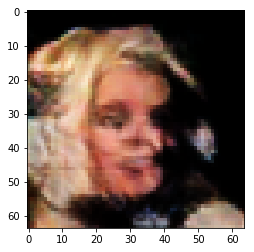

Iteration 1500
Decision -1.7387792468070984e-06


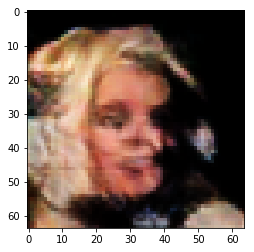

Iteration 1750
Decision 4.2188912630081177e-07


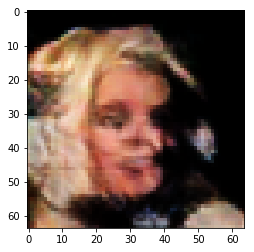

Iteration 2000
Decision 2.0312145352363586e-06


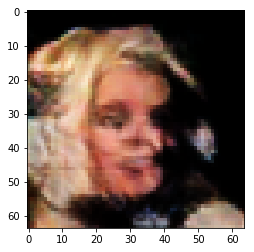

Iteration 0
Decision -7.569040298461914


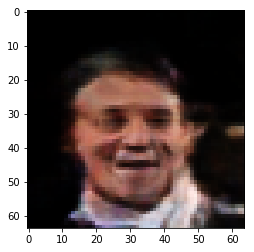

Iteration 250
Decision 2.4335458874702454e-06


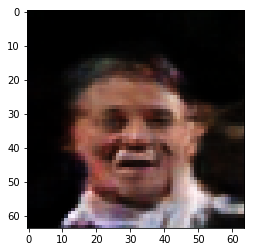

Iteration 500
Decision 1.3131648302078247e-07


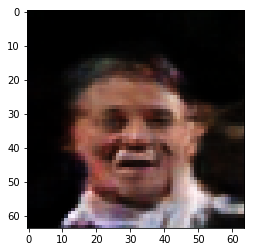

Iteration 750
Decision -7.851049304008484e-07


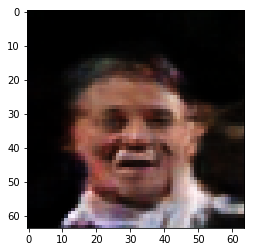

Iteration 1000
Decision -2.535991370677948e-06


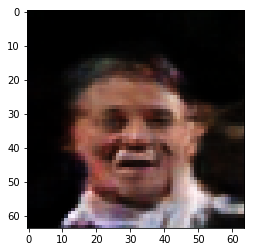

Iteration 1250
Decision 5.709007382392883e-07


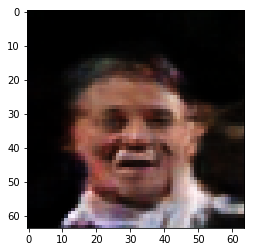

Iteration 1500
Decision 7.944181561470032e-07


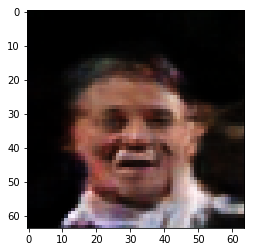

Iteration 1750
Decision -3.082677721977234e-07


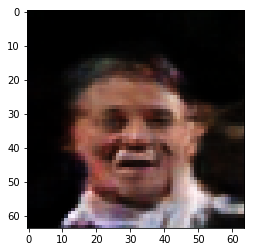

Iteration 2000
Decision -2.5210902094841003e-06


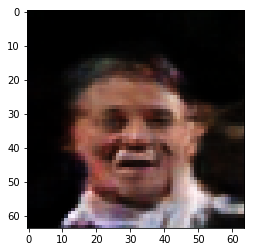

Iteration 0
Decision -6.351502895355225


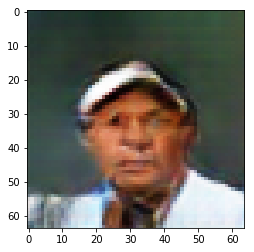

Iteration 250
Decision -3.009103238582611e-06


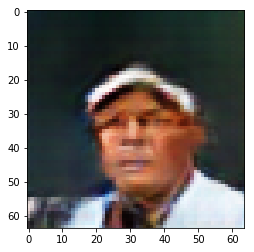

Iteration 500
Decision 1.6437843441963196e-06


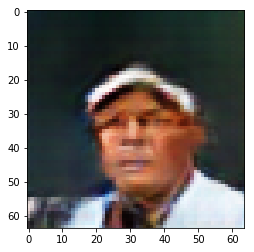

Iteration 750
Decision -4.044733941555023e-06


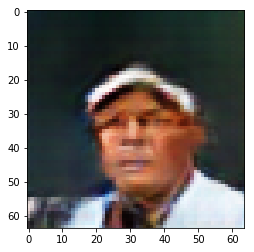

Iteration 1000
Decision 2.802349627017975e-06


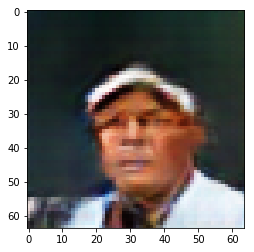

Iteration 1250
Decision 2.430751919746399e-07


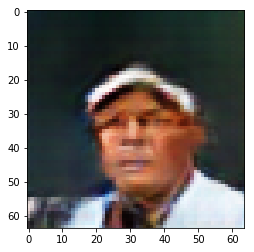

Iteration 1500
Decision -6.3283368945121765e-06


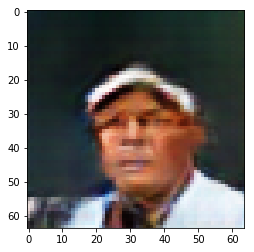

Iteration 1750
Decision -5.019828677177429e-07


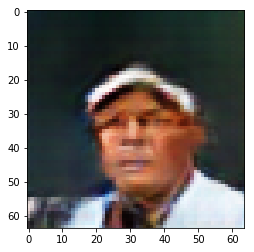

Iteration 2000
Decision -9.297393262386322e-06


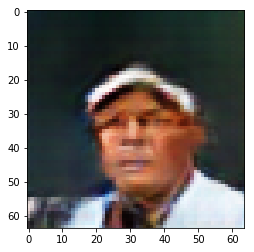

Iteration 0
Decision 0.27115315198898315


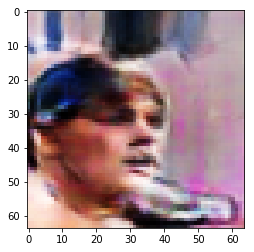

Iteration 250
Decision 5.220063030719757e-06


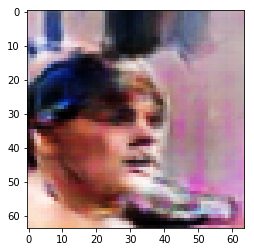

Iteration 500
Decision 1.225341111421585e-05


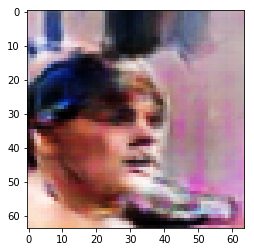

Iteration 750
Decision -6.87967985868454e-06


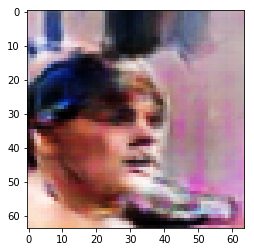

Iteration 1000
Decision 1.2372620403766632e-05


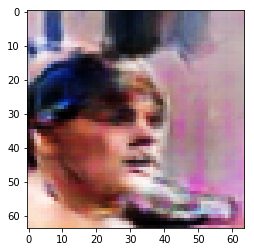

Iteration 1250
Decision 5.339272320270538e-06


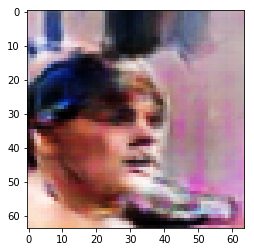

Iteration 1500
Decision 0.00040966738015413284


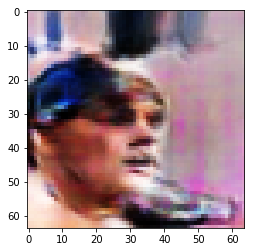

Iteration 1750
Decision -1.2470409274101257e-06


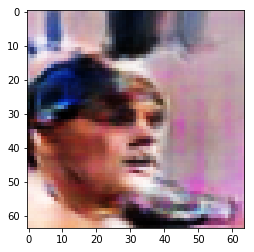

Iteration 2000
Decision 9.541399776935577e-06


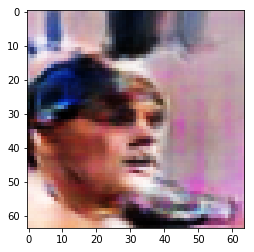

Iteration 0
Decision 4.027060031890869


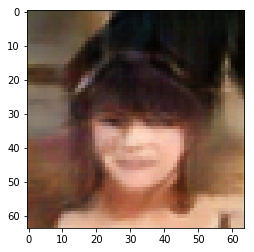

Iteration 250
Decision -3.8277357816696167e-07


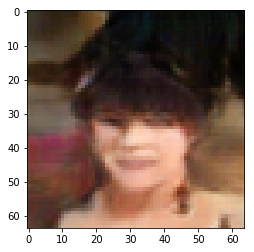

Iteration 500
Decision -5.019828677177429e-07


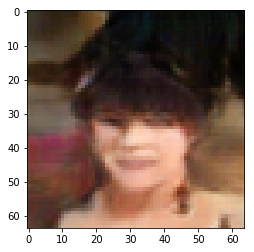

Iteration 500
Decision -1.4435499906539917e-07


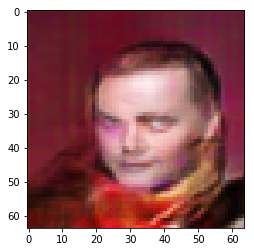

Iteration 750
Decision -1.932494342327118e-06


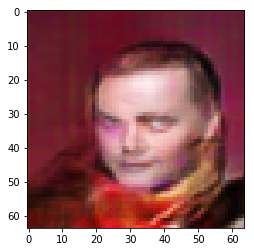

Iteration 1000
Decision -1.9026920199394226e-06


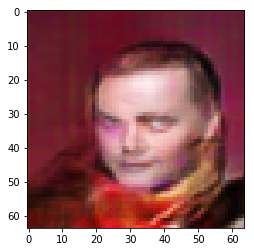

Iteration 1250
Decision 2.65706330537796e-06


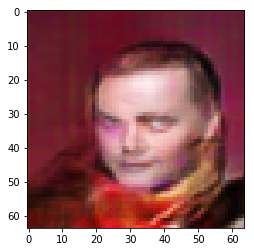

Iteration 1500
Decision -5.615875124931335e-07


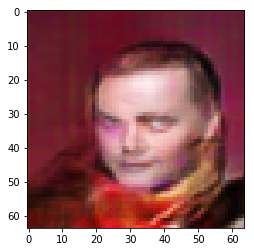

Iteration 1750
Decision -5.494803190231323e-08


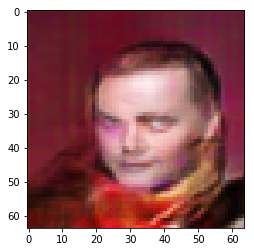

Iteration 2000
Decision 1.4351680874824524e-06


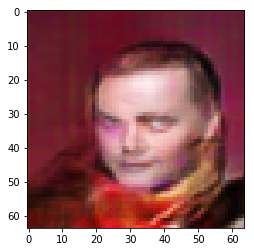

Iteration 0
Decision -5.881824016571045


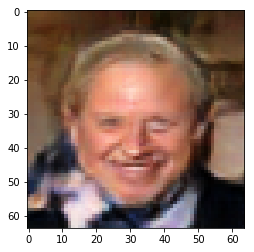

Iteration 250
Decision 1.4621764421463013e-07


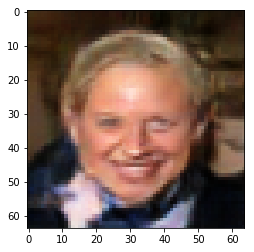

Iteration 500
Decision -1.6642734408378601e-06


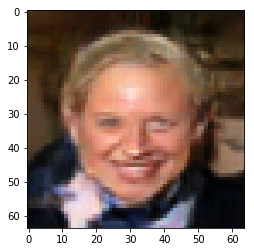

Iteration 750
Decision -3.2316893339157104e-07


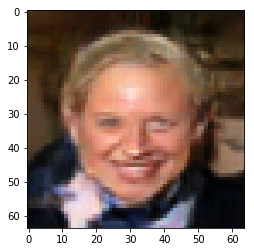

Iteration 1000
Decision 4.6566128730773926e-09


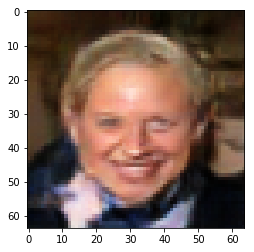

Iteration 1250
Decision 4.6566128730773926e-09


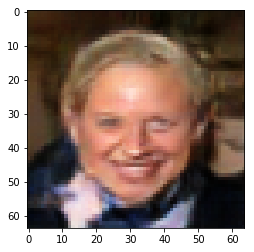

Iteration 1500
Decision 4.6566128730773926e-09


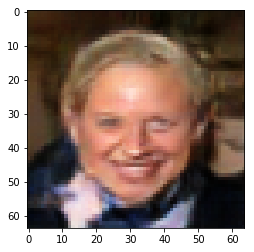

Iteration 1750
Decision 4.6566128730773926e-09


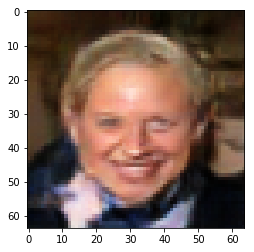

Iteration 2000
Decision 9.434297680854797e-07


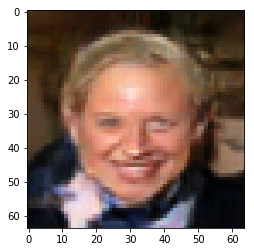

Iteration 0
Decision -6.351395606994629


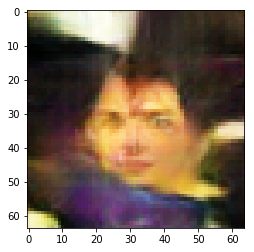

Iteration 250
Decision -4.167668521404266e-06


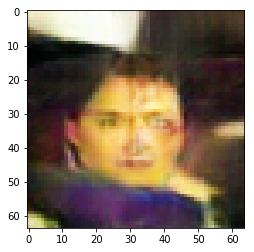

Iteration 500
Decision -7.702037692070007e-07


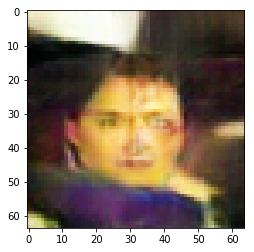

Iteration 750
Decision -6.984919309616089e-08


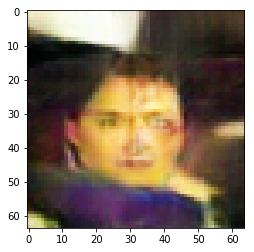

Iteration 1000
Decision 4.814937710762024e-07


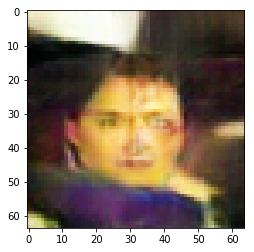

Iteration 1250
Decision 2.4782493710517883e-06


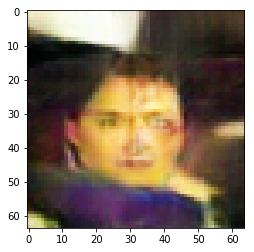

Iteration 1500
Decision -2.11130827665329e-06


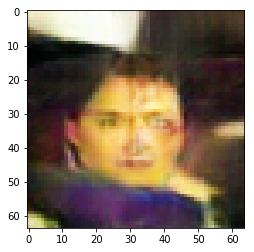

Iteration 1750
Decision 1.6884878277778625e-06


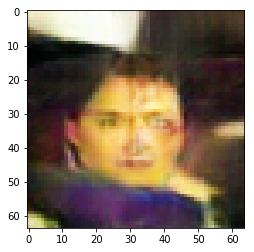

Iteration 2000
Decision 6.603077054023743e-07


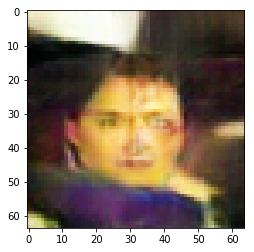

Iteration 0
Decision 12.288317680358887


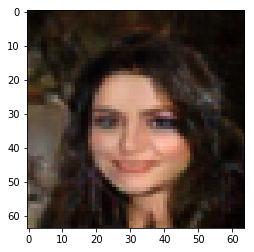

Iteration 250
Decision -2.6899389922618866e-05


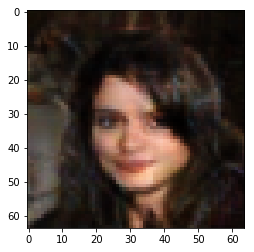

Iteration 500
Decision 4.4424086809158325e-07


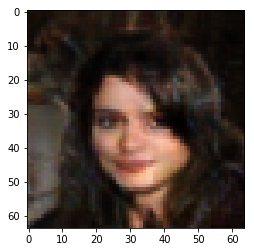

Iteration 750
Decision -5.131587386131287e-07


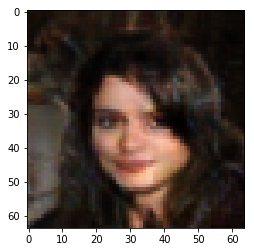

Iteration 1000
Decision 6.05359673500061e-08


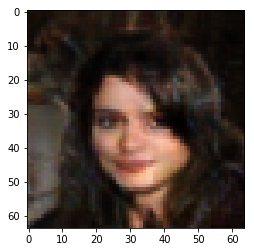

Iteration 1250
Decision -8.707866072654724e-07


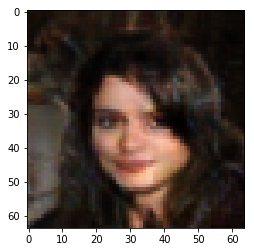

Iteration 1500
Decision 1.0812655091285706e-06


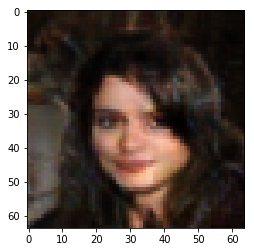

Iteration 1750
Decision -2.784654498100281e-07


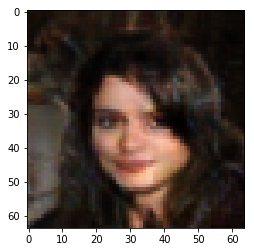

Iteration 2000
Decision -2.2975727915763855e-06


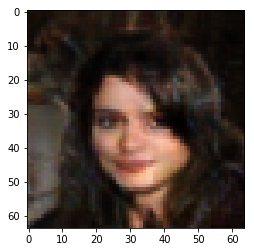

Iteration 0
Decision -5.13139533996582


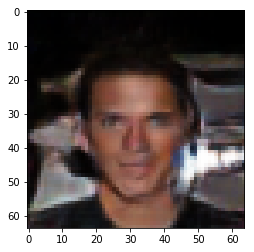

Iteration 250
Decision 3.223307430744171e-06


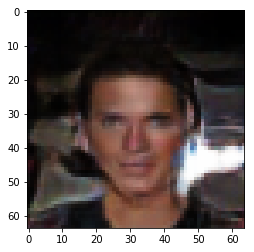

Iteration 500
Decision -9.862706065177917e-07


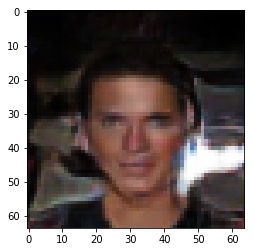

Iteration 750
Decision 3.051944077014923e-06


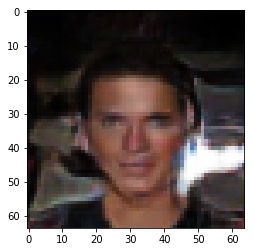

Iteration 1000
Decision -2.8219074010849e-07


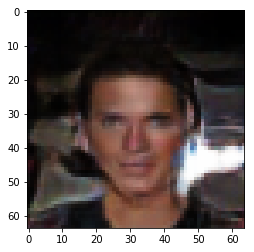

Iteration 1250
Decision 1.1259689927101135e-06


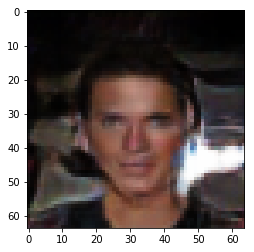

Iteration 1500
Decision 2.0423904061317444e-06


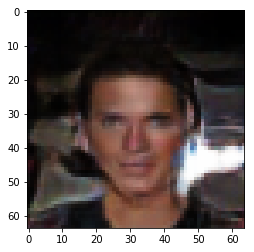

Iteration 1750
Decision -1.3317912817001343e-07


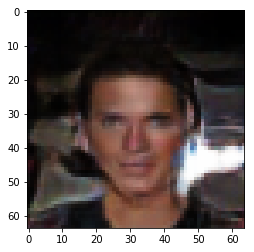

Iteration 2000
Decision -3.053806722164154e-06


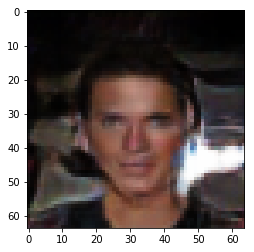

Iteration 0
Decision -3.90370774269104


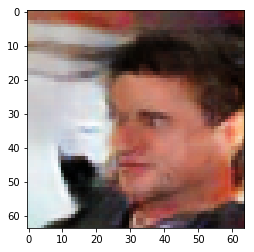

Iteration 250
Decision 1.4649704098701477e-06


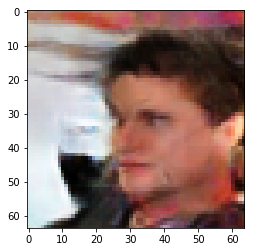

Iteration 500
Decision -3.2316893339157104e-07


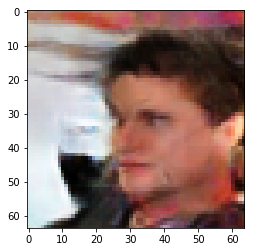

Iteration 750
Decision -2.4689361453056335e-06


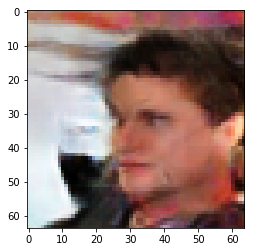

Iteration 1000
Decision -2.707354724407196e-06


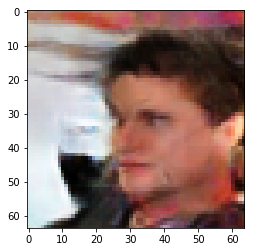

Iteration 1250
Decision -2.707354724407196e-06


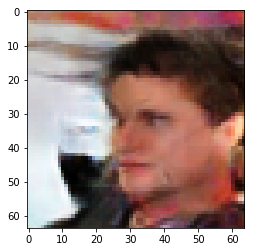

Iteration 1500
Decision 1.7033889889717102e-06


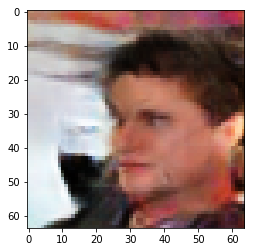

Iteration 1750
Decision 1.6437843441963196e-06


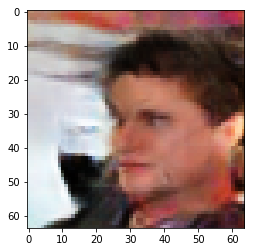

Iteration 2000
Decision -5.615875124931335e-07


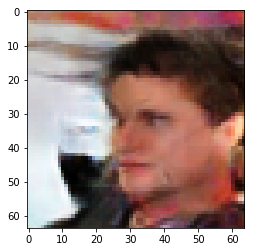

Iteration 0
Decision 13.155217170715332


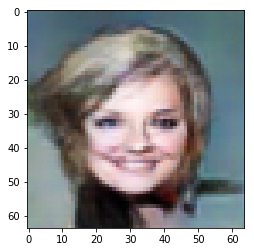

Iteration 250
Decision 1.7182901501655579e-06


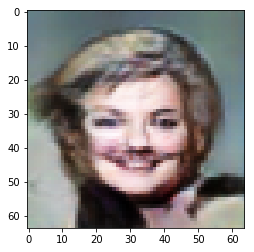

Iteration 500
Decision -6.360933184623718e-07


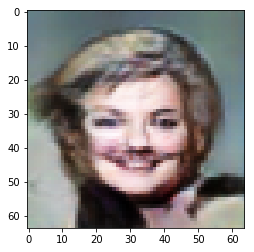

Iteration 750
Decision -2.066604793071747e-06


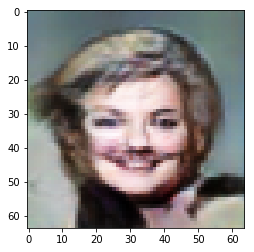

Iteration 1000
Decision 1.5543773770332336e-06


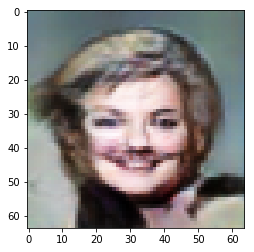

Iteration 1250
Decision 1.387670636177063e-07


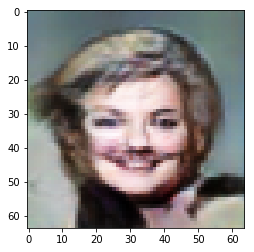

Iteration 1500
Decision 1.0700896382331848e-06


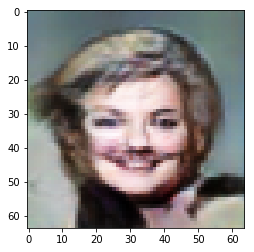

Iteration 1750
Decision -1.0710209608078003e-07


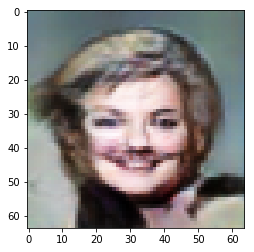

Iteration 2000
Decision 6.081536412239075e-07


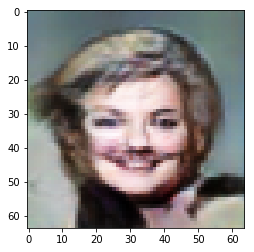

Iteration 0
Decision 2.384242296218872


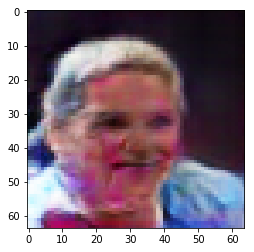

Iteration 250
Decision 3.744848072528839e-06


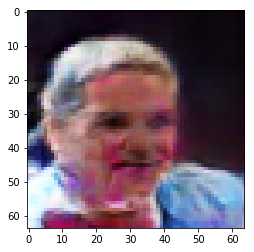

Iteration 500
Decision 4.6659260988235474e-07


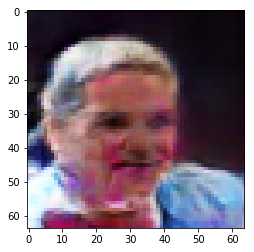

Iteration 750
Decision -2.5583431124687195e-06


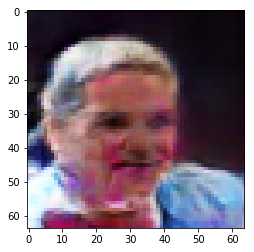

Iteration 1000
Decision -6.062909960746765e-07


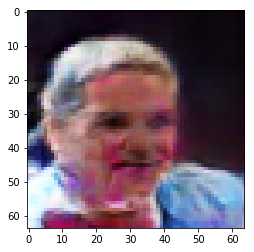

Iteration 1250
Decision 7.380731403827667e-06


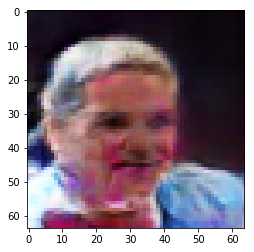

Iteration 1500
Decision 5.041249096393585e-06


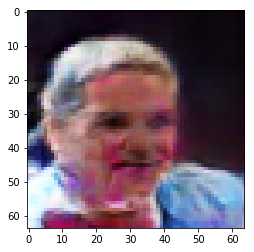

Iteration 1750
Decision -1.977197825908661e-06


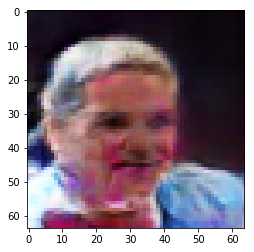

Iteration 2000
Decision 1.2386590242385864e-07


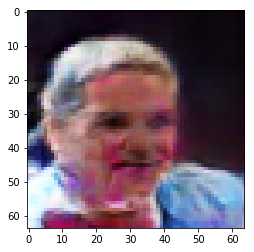

Iteration 0
Decision 14.754046440124512


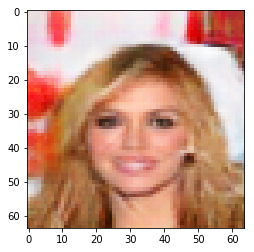

Iteration 250
Decision 4.905927926301956e-05


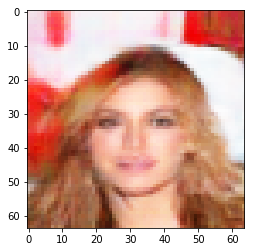

Iteration 500
Decision 7.199123501777649e-07


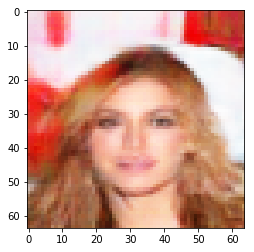

Iteration 750
Decision 4.6566128730773926e-09


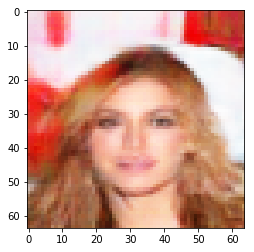

Iteration 1000
Decision 4.6566128730773926e-09


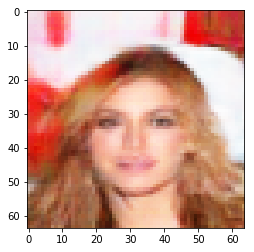

Iteration 1250
Decision 4.6566128730773926e-09


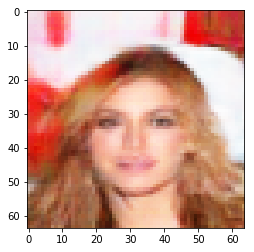

Iteration 1500
Decision 4.6566128730773926e-09


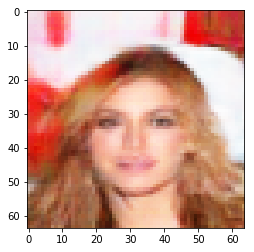

Iteration 1750
Decision 4.6566128730773926e-09


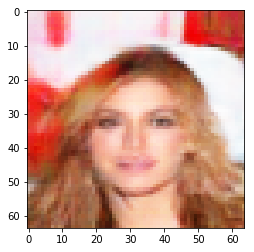

Iteration 2000
Decision 4.6566128730773926e-09


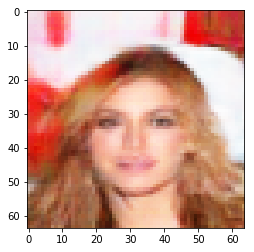

Iteration 0
Decision -10.70400619506836


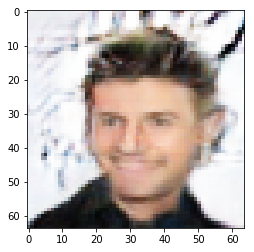

Iteration 250
Decision -6.8498775362968445e-06


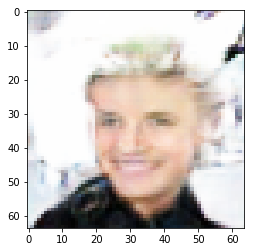

Iteration 500
Decision -1.3066455721855164e-06


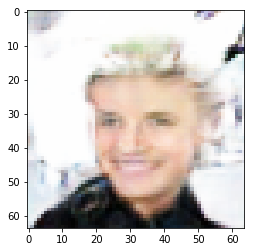

Iteration 750
Decision -4.721805453300476e-07


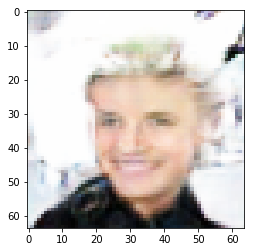

Iteration 1000
Decision -2.514570951461792e-08


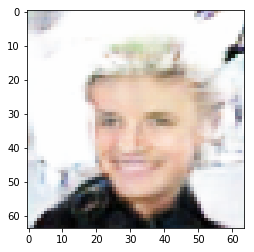

Iteration 1250
Decision -2.514570951461792e-08


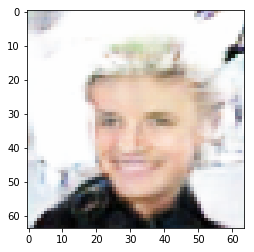

Iteration 1500
Decision -2.514570951461792e-08


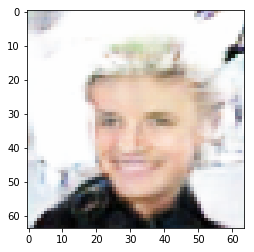

Iteration 1750
Decision -2.514570951461792e-08


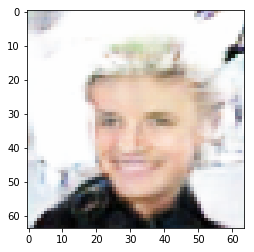

Iteration 2000
Decision -2.514570951461792e-08


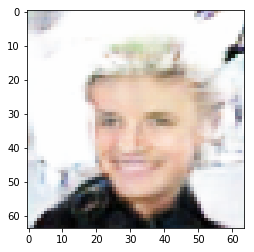

Iteration 0
Decision 5.773187637329102


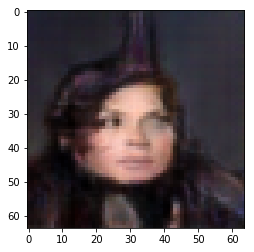

Iteration 250
Decision -1.6344711184501648e-06


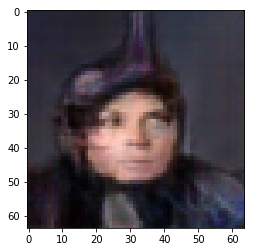

Iteration 500
Decision 1.0775402188301086e-06


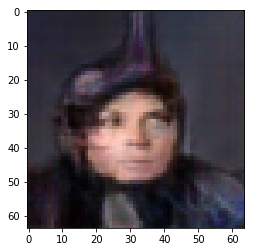

Iteration 750
Decision -2.4493783712387085e-07


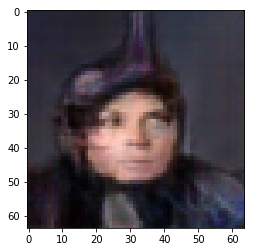

Iteration 1000
Decision -8.111819624900818e-07


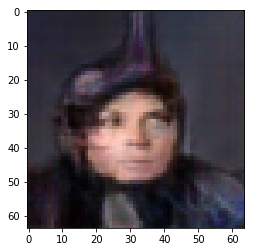

Iteration 1250
Decision 1.5171244740486145e-06


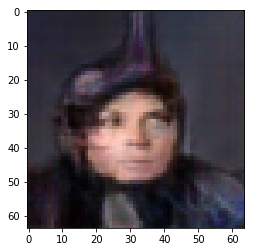

Iteration 1500
Decision -1.9278377294540405e-07


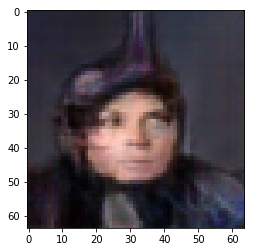

Iteration 1750
Decision 4.293397068977356e-07


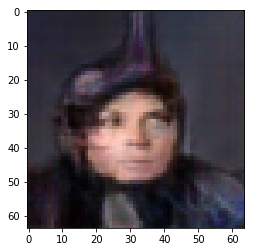

Iteration 2000
Decision 1.014210283756256e-06


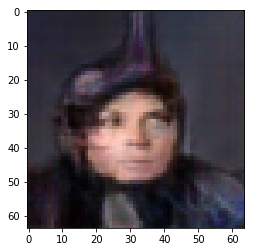

Iteration 0
Decision 3.681164503097534


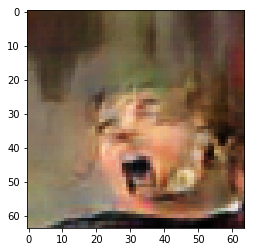

Iteration 250
Decision 4.147179424762726e-06


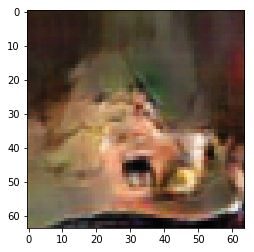

Iteration 500
Decision 1.4351680874824524e-06


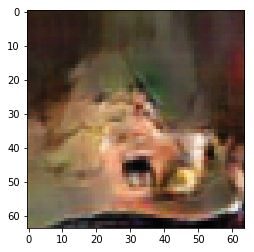

Iteration 750
Decision -3.750436007976532e-06


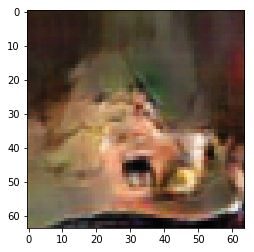

Iteration 1000
Decision -5.180947482585907e-06


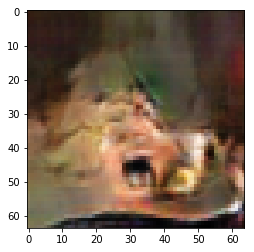

Iteration 1250
Decision 5.1604583859443665e-06


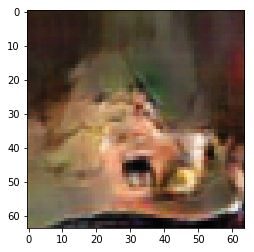

Iteration 1500
Decision -3.7802383303642273e-06


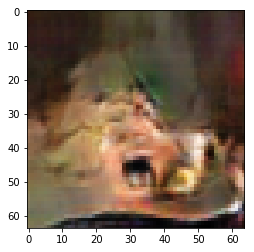

Iteration 1750
Decision 3.312714397907257e-06


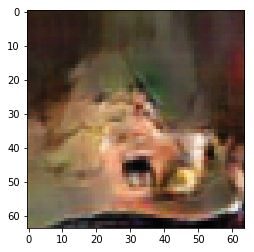

Iteration 2000
Decision -3.0351802706718445e-06


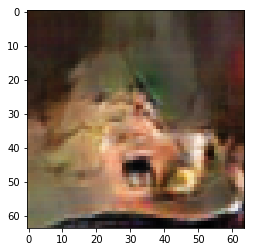

Iteration 0
Decision 13.943580627441406


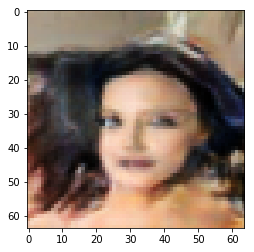

Iteration 250
Decision 1.6187317669391632e-05


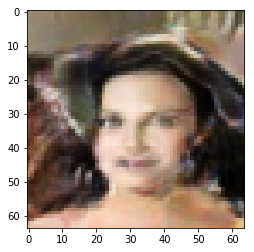

Iteration 500
Decision 4.6566128730773926e-09


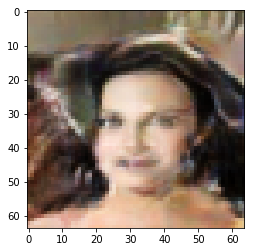

Iteration 750
Decision 4.6566128730773926e-09


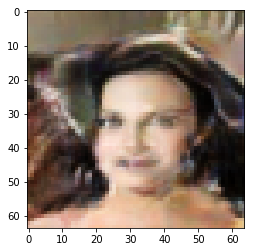

Iteration 1000
Decision 4.6566128730773926e-09


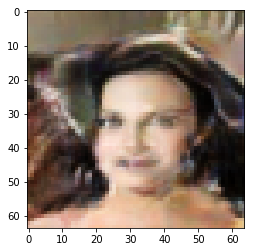

Iteration 1250
Decision 4.6566128730773926e-09


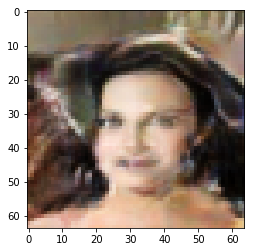

Iteration 1500
Decision 4.6566128730773926e-09


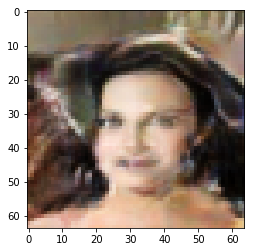

Iteration 1750
Decision 4.6566128730773926e-09


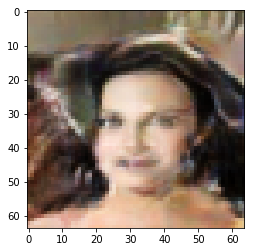

Iteration 2000
Decision 4.6566128730773926e-09


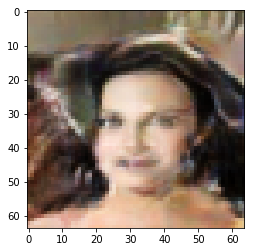

Iteration 0
Decision 11.412008285522461


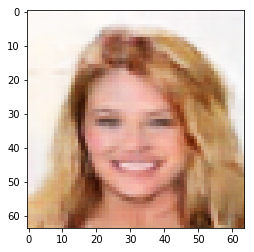

Iteration 250
Decision 0.00011456478387117386


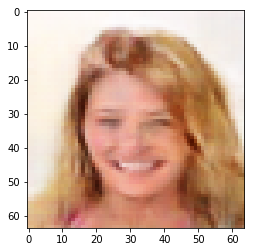

Iteration 500
Decision -4.870817065238953e-07


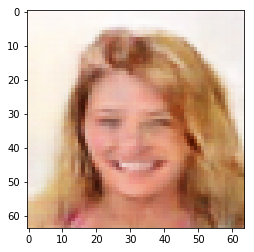

Iteration 750
Decision -1.0458752512931824e-06


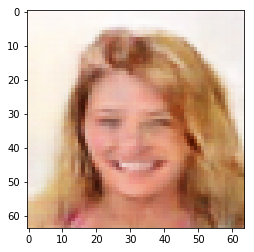

Iteration 1000
Decision 5.336478352546692e-07


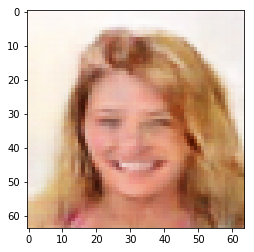

Iteration 1250
Decision 4.6566128730773926e-09


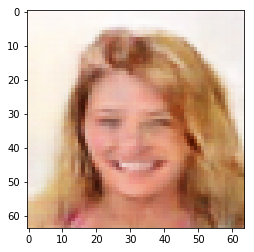

Iteration 1500
Decision 4.6566128730773926e-09


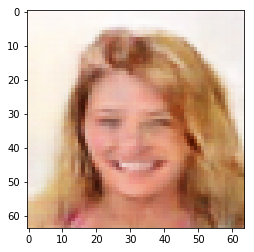

Iteration 1750
Decision 4.6566128730773926e-09


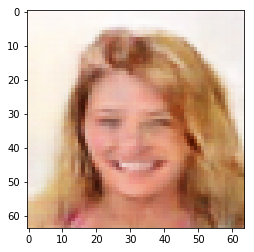

Iteration 2000
Decision 4.6566128730773926e-09


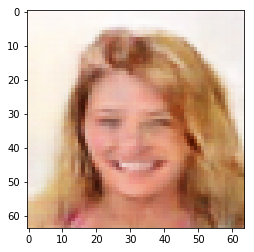

Iteration 0
Decision 2.7777976989746094


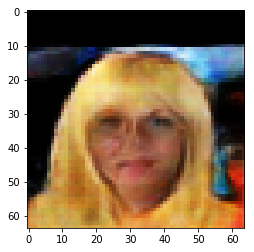

Iteration 250
Decision 1.3755634427070618e-06


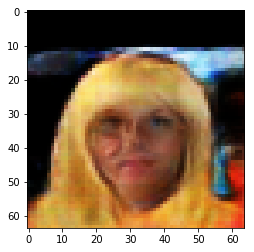

Iteration 500
Decision -2.0815059542655945e-06


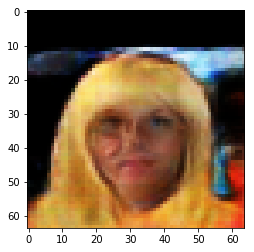

Iteration 750
Decision -1.0244548320770264e-08


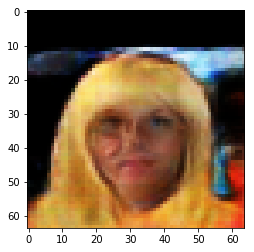

Iteration 1000
Decision -5.392357707023621e-07


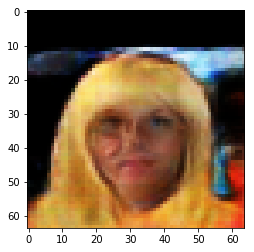

Iteration 1250
Decision -4.945322871208191e-07


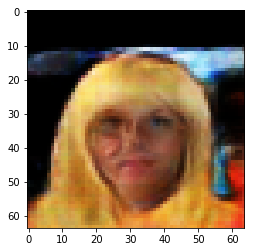

Iteration 1500
Decision -2.5657936930656433e-06


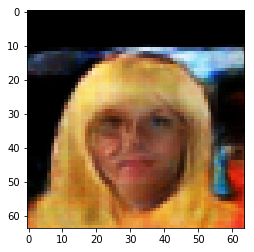

Iteration 1750
Decision -1.6642734408378601e-06


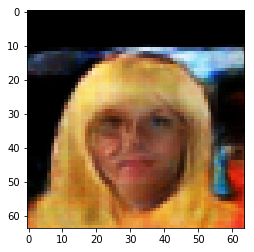

Iteration 2000
Decision -3.094784915447235e-06


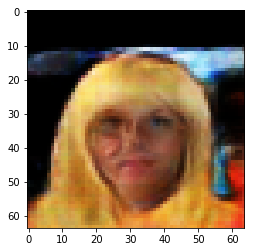

Iteration 0
Decision 11.96391487121582


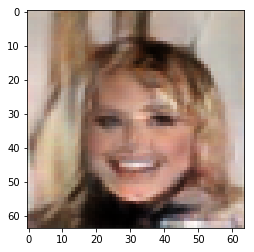

Iteration 250
Decision 4.81773167848587e-06


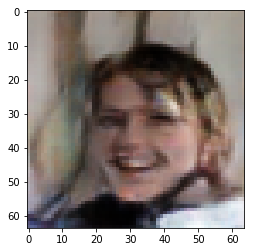

Iteration 500
Decision -4.870817065238953e-07


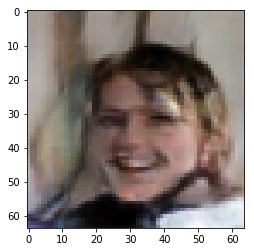

Iteration 750
Decision -1.0244548320770264e-08


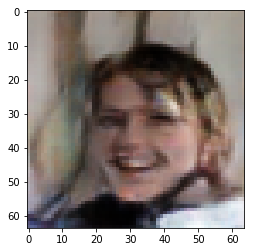

Iteration 1000
Decision -1.0244548320770264e-08


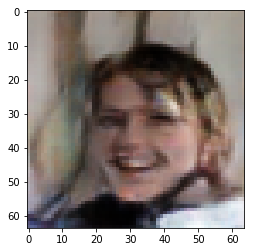

Iteration 1250
Decision -1.0244548320770264e-08


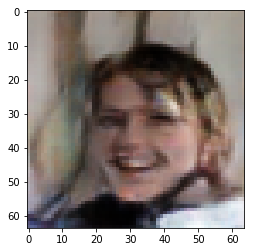

Iteration 1500
Decision -1.0244548320770264e-08


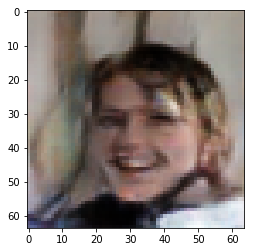

Iteration 1750
Decision -1.0244548320770264e-08


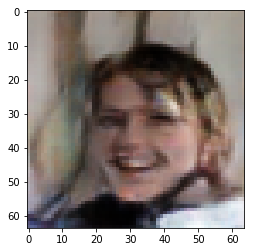

Iteration 2000
Decision -1.0244548320770264e-08


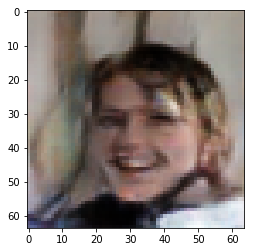

Iteration 0
Decision 15.738652229309082


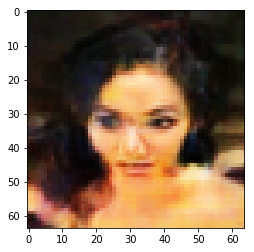

Iteration 250
Decision -1.6364268958568573e-05


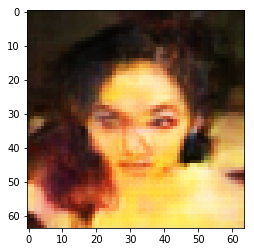

Iteration 500
Decision -1.0244548320770264e-08


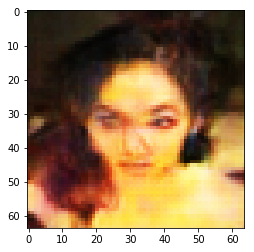

Iteration 750
Decision -1.0244548320770264e-08


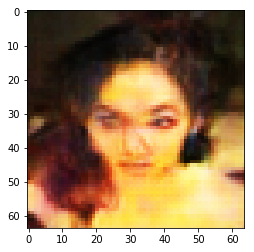

Iteration 1000
Decision -1.0244548320770264e-08


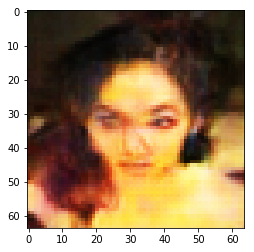

Iteration 1250
Decision -1.0244548320770264e-08


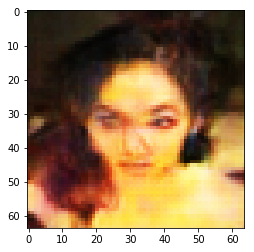

Iteration 1500
Decision -1.0244548320770264e-08


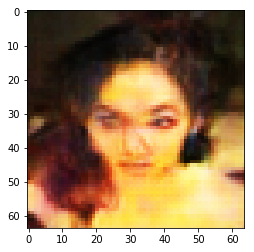

Iteration 1750
Decision -1.0244548320770264e-08


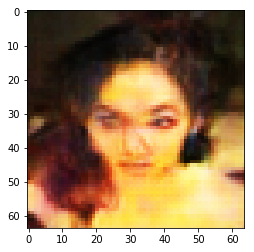

Iteration 2000
Decision -1.0244548320770264e-08


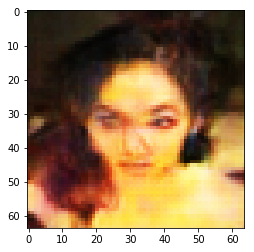

Iteration 0
Decision -2.2573347091674805


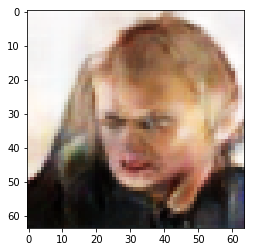

Iteration 250
Decision 5.667097866535187e-06


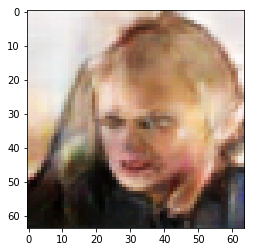

Iteration 500
Decision 4.069879651069641e-07


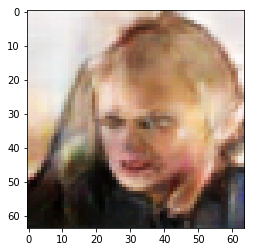

Iteration 750
Decision -2.573244273662567e-06


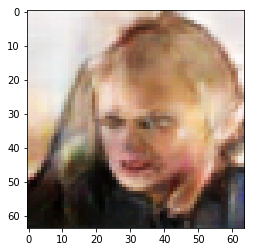

Iteration 1000
Decision -2.1560117602348328e-06


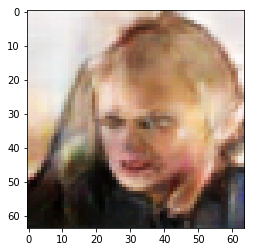

Iteration 1250
Decision -4.423782229423523e-07


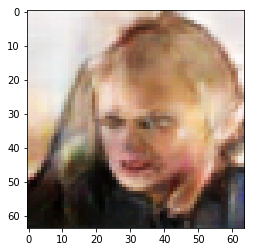

Iteration 1500
Decision -3.1692907214164734e-06


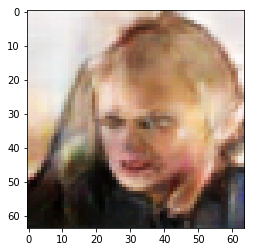

Iteration 1750
Decision -6.956979632377625e-07


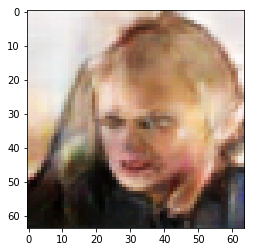

Iteration 2000
Decision -4.435889422893524e-06


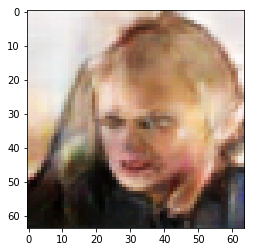

Iteration 0
Decision 6.7957611083984375


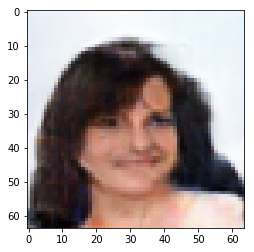

Iteration 250
Decision 4.6566128730773926e-09


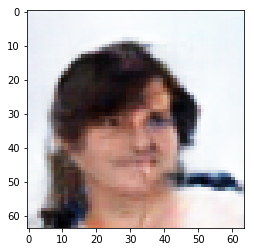

Iteration 500
Decision 1.2386590242385864e-07


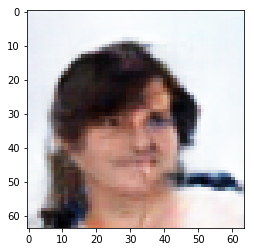

Iteration 750
Decision 1.2386590242385864e-07


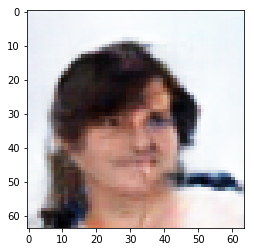

Iteration 1000
Decision 1.2386590242385864e-07


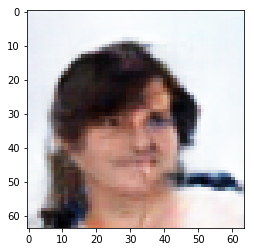

Iteration 1250
Decision 1.2386590242385864e-07


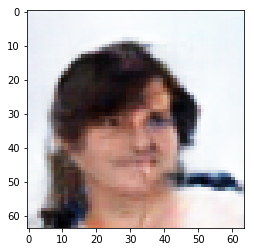

Iteration 1500
Decision -1.1455267667770386e-07


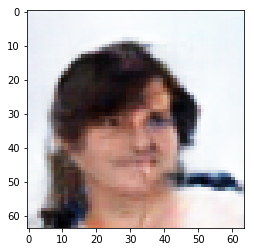

Iteration 1750
Decision 1.2386590242385864e-07


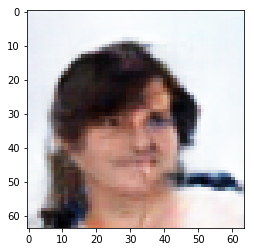

Iteration 2000
Decision -1.1455267667770386e-07


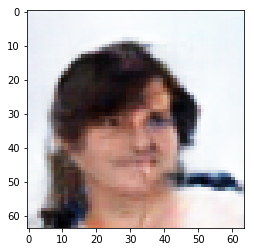

Iteration 0
Decision -10.767641067504883


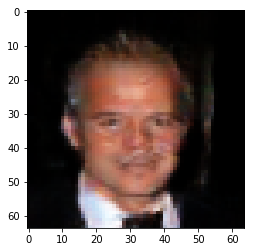

Iteration 250
Decision 3.868807107210159e-05


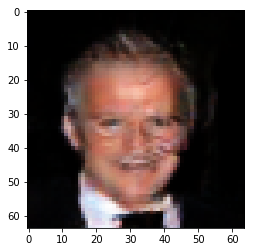

Iteration 500
Decision -3.5297125577926636e-07


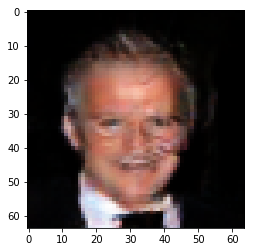

Iteration 750
Decision 2.1327286958694458e-07


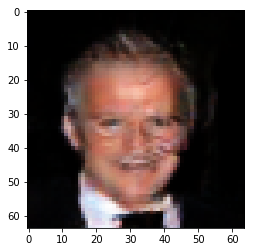

Iteration 1000
Decision 2.1327286958694458e-07


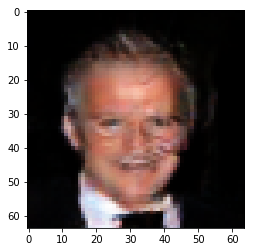

Iteration 1250
Decision 2.1327286958694458e-07


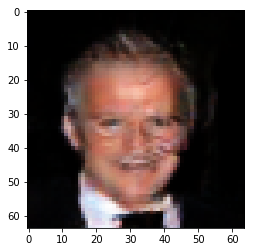

Iteration 1500
Decision 2.1327286958694458e-07


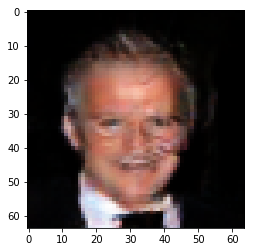

Iteration 1750
Decision 3.4458935260772705e-08


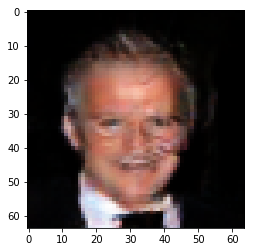

Iteration 2000
Decision -4.12575900554657e-07


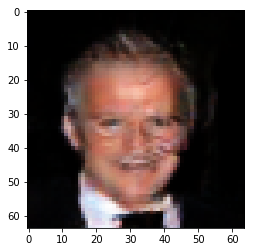

Iteration 0
Decision 10.581146240234375


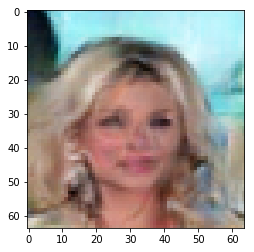

Iteration 250
Decision 2.65706330537796e-06


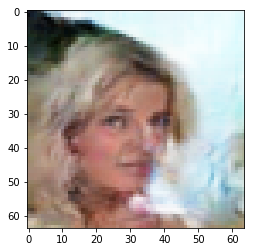

Iteration 500
Decision 5.112960934638977e-07


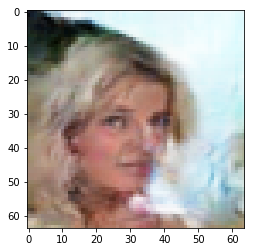

Iteration 750
Decision 5.112960934638977e-07


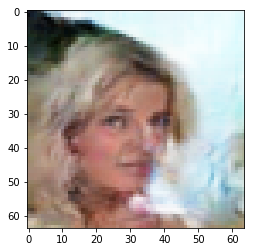

Iteration 1000
Decision 5.112960934638977e-07


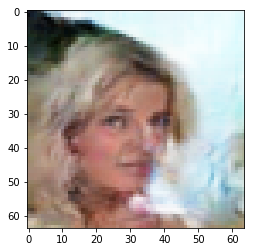

Iteration 1250
Decision 1.2563541531562805e-06


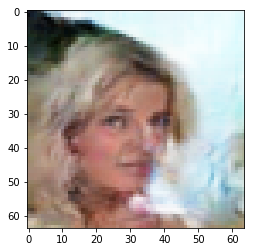

Iteration 1500
Decision 7.916241884231567e-08


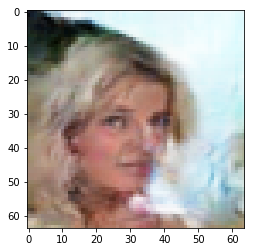

Iteration 1750
Decision 7.916241884231567e-08


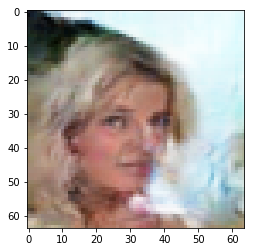

Iteration 2000
Decision -4.0046870708465576e-08


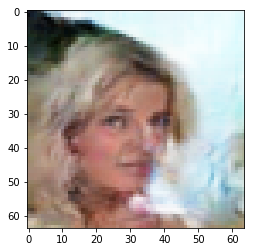

Iteration 0
Decision 8.116934776306152


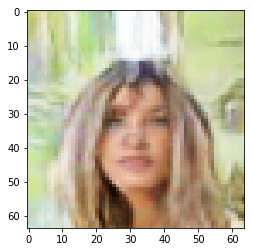

Iteration 250
Decision 6.397254765033722e-06


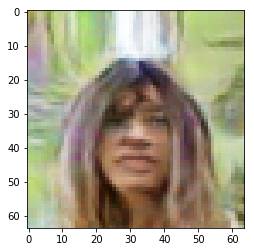

Iteration 500
Decision 3.25031578540802e-07


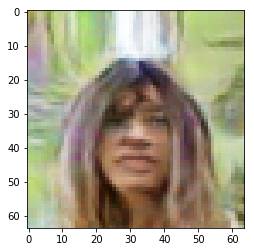

Iteration 750
Decision -5.466863512992859e-07


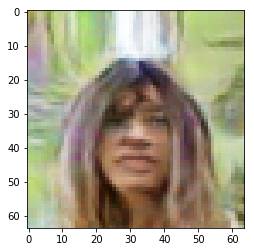

Iteration 1000
Decision -1.7415732145309448e-07


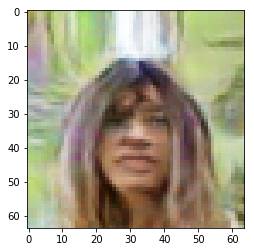

Iteration 1250
Decision -1.8905848264694214e-07


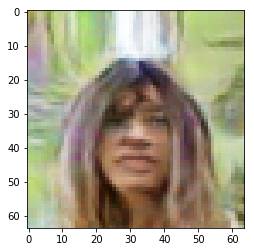

Iteration 1500
Decision -1.7415732145309448e-07


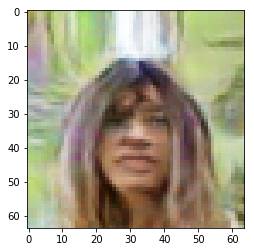

Iteration 1750
Decision 3.4458935260772705e-08


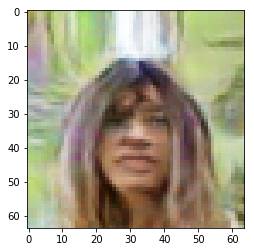

Iteration 2000
Decision 9.285286068916321e-07


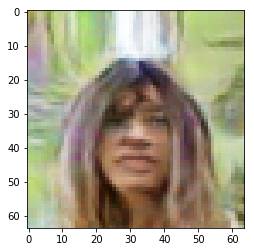

Iteration 0
Decision -5.109334468841553


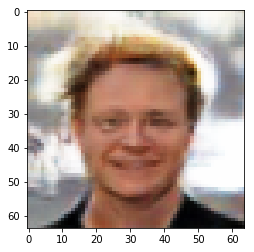

Iteration 250
Decision -2.0815059542655945e-06


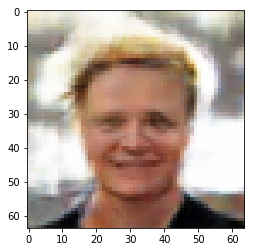

Iteration 500
Decision -9.192153811454773e-07


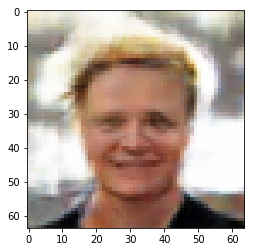

Iteration 750
Decision -8.00006091594696e-07


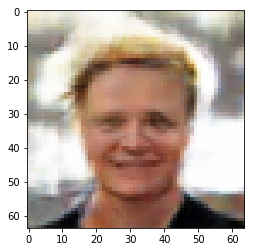

Iteration 1000
Decision 1.882202923297882e-06


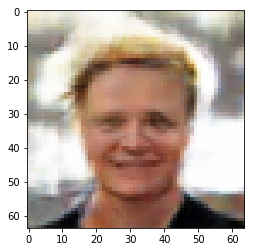

Iteration 1250
Decision 2.2994354367256165e-06


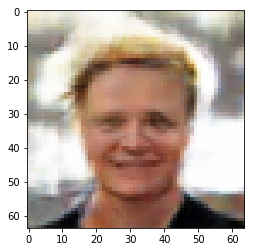

Iteration 1500
Decision 2.728775143623352e-07


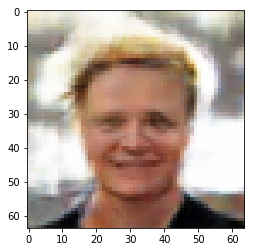

Iteration 1750
Decision -3.5297125577926636e-07


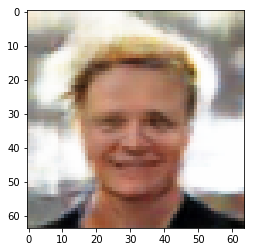

Iteration 2000
Decision -5.615875124931335e-07


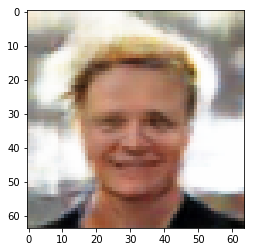

Iteration 0
Decision 15.558035850524902


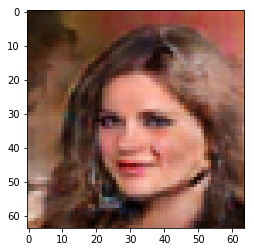

Iteration 250
Decision -3.936421126127243e-05


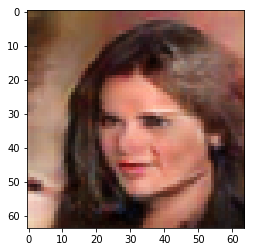

Iteration 500
Decision 3.4458935260772705e-08


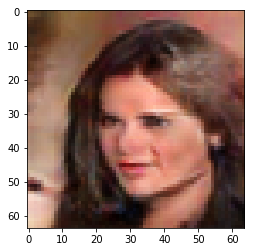

Iteration 750
Decision 3.4458935260772705e-08


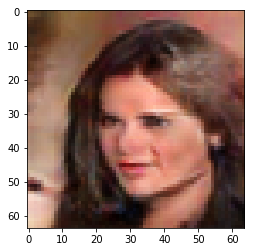

Iteration 1000
Decision 3.4458935260772705e-08


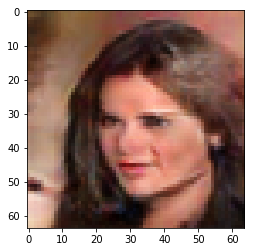

Iteration 1250
Decision 3.4458935260772705e-08


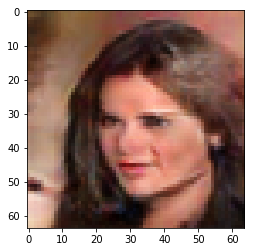

Iteration 1500
Decision 3.4458935260772705e-08


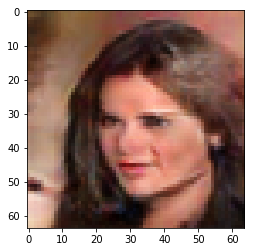

Iteration 1750
Decision 4.2188912630081177e-07


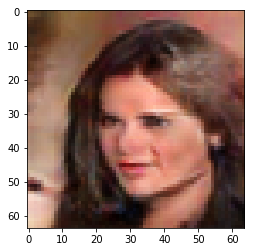

Iteration 2000
Decision -8.298084139823914e-07


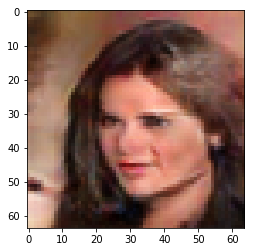

Iteration 0
Decision -3.481318712234497


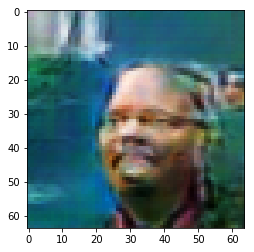

Iteration 250
Decision -1.4742836356163025e-06


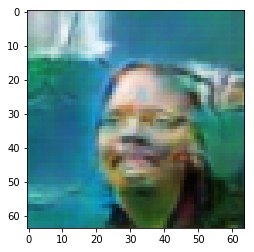

Iteration 500
Decision 8.391216397285461e-07


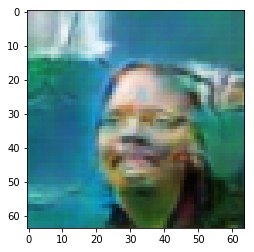

Iteration 750
Decision -2.3311004042625427e-06


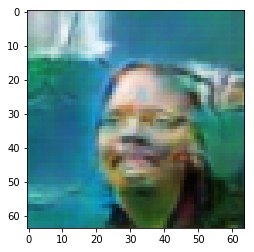

Iteration 1000
Decision 3.6517158150672913e-06


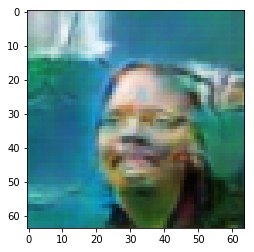

Iteration 1250
Decision -4.353933036327362e-06


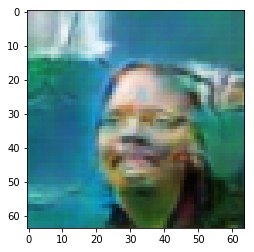

Iteration 1500
Decision -9.13720577955246e-06


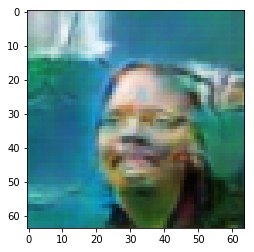

Iteration 1750
Decision -5.471520125865936e-06


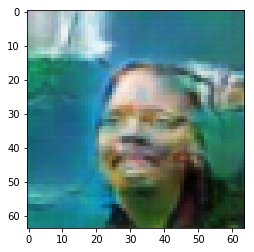

Iteration 2000
Decision -8.484348654747009e-07


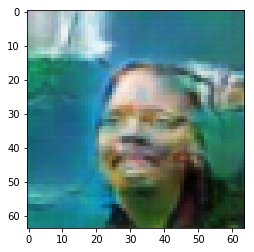

Iteration 0
Decision -1.137549638748169


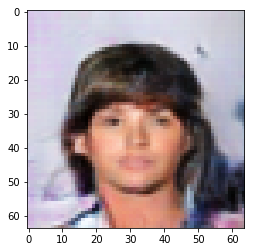

Iteration 250
Decision -6.28642737865448e-07


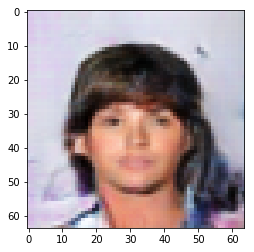

Iteration 500
Decision -5.933456122875214e-06


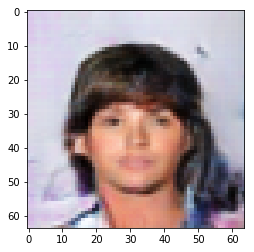

Iteration 750
Decision 4.56441193819046e-06


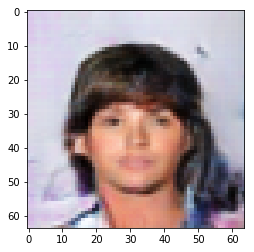

Iteration 1000
Decision 1.5096738934516907e-06


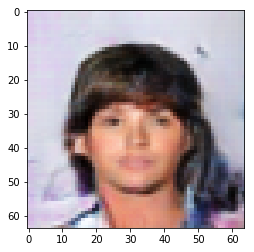

Iteration 1250
Decision -3.363005816936493e-06


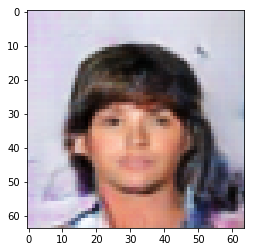

Iteration 1500
Decision -0.006272646598517895


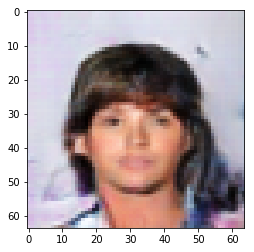

Iteration 1750
Decision -6.80144876241684e-06


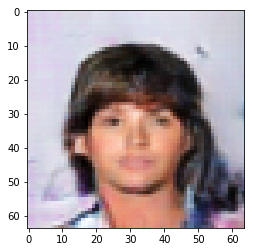

Iteration 2000
Decision -6.615184247493744e-06


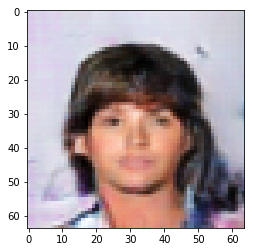

Iteration 0
Decision -7.487728595733643


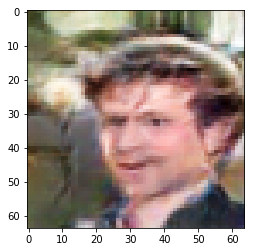

Iteration 250
Decision 5.45848160982132e-06


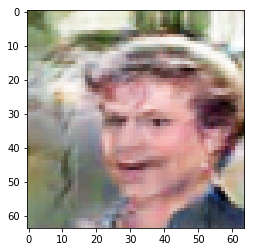

Iteration 500
Decision 1.2386590242385864e-07


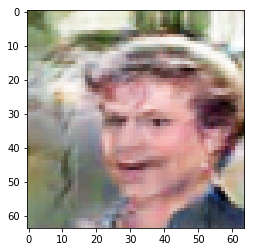

Iteration 750
Decision 6.901100277900696e-07


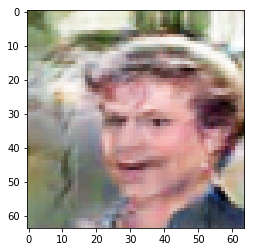

Iteration 1000
Decision -9.78820025920868e-07


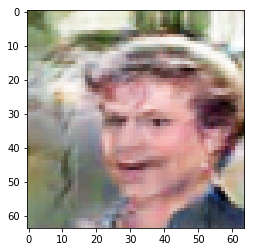

Iteration 1250
Decision 5.709007382392883e-07


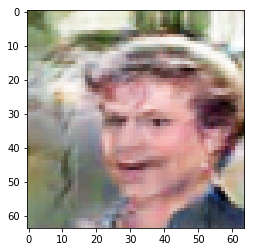

Iteration 1500
Decision -6.807968020439148e-07


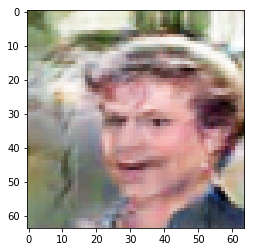

Iteration 1750
Decision -2.039596438407898e-07


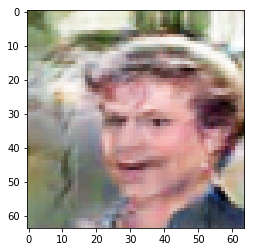

Iteration 2000
Decision 2.9550865292549133e-06


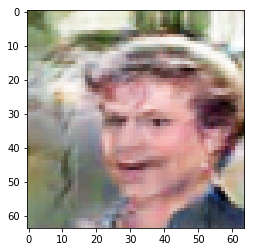

Iteration 0
Decision 10.401265144348145


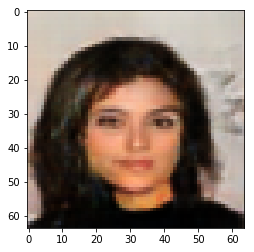

Iteration 250
Decision -5.627982318401337e-06


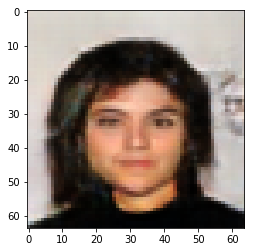

Iteration 500
Decision 4.6566128730773926e-09


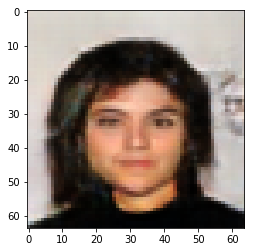

Iteration 750
Decision 4.6566128730773926e-09


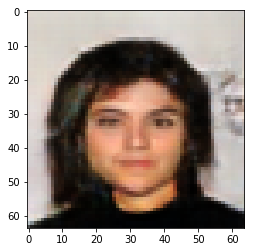

Iteration 1000
Decision 4.6566128730773926e-09


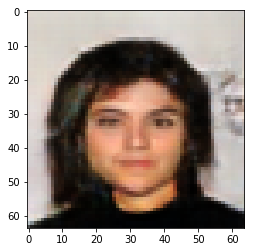

Iteration 1250
Decision 4.6566128730773926e-09


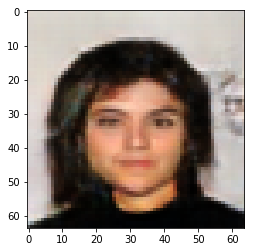

Iteration 1500
Decision 4.6566128730773926e-09


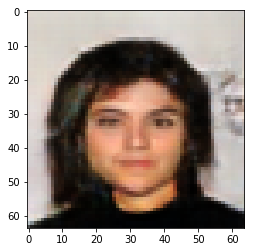

Iteration 1750
Decision 4.6566128730773926e-09


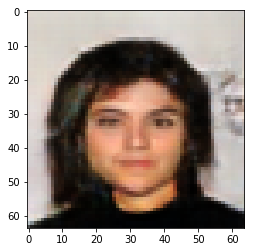

Iteration 2000
Decision 4.6566128730773926e-09


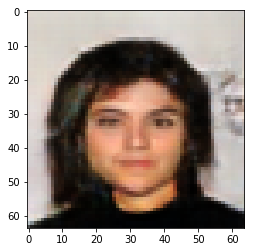

Iteration 0
Decision -4.379155158996582


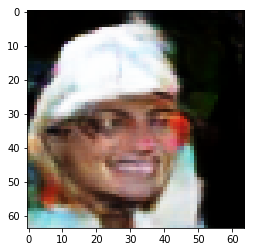

Iteration 250
Decision -6.3283368945121765e-06


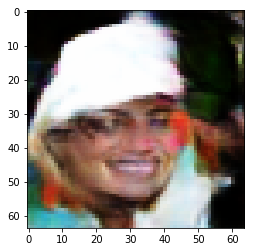

Iteration 500
Decision 2.0461156964302063e-06


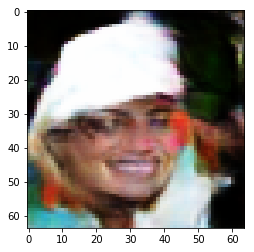

Iteration 750
Decision -4.227273166179657e-06


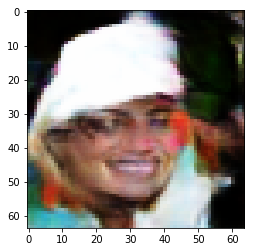

Iteration 1000
Decision 4.7283247113227844e-06


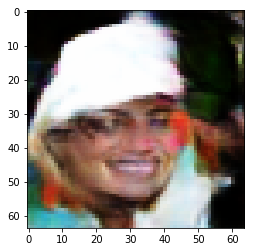

Iteration 1250
Decision -5.791895091533661e-06


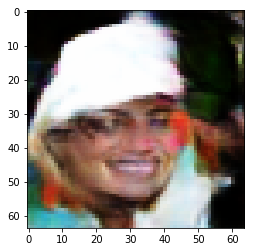

Iteration 1500
Decision -4.361383616924286e-06


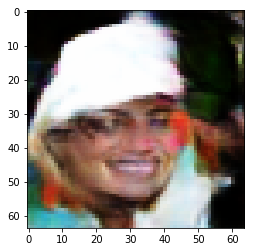

Iteration 1750
Decision -2.662651240825653e-06


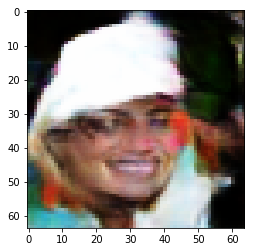

Iteration 2000
Decision -4.301778972148895e-06


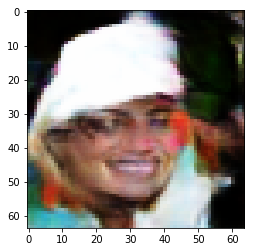

Iteration 0
Decision 8.178935050964355


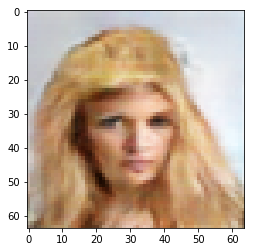

Iteration 250
Decision -1.1874362826347351e-06


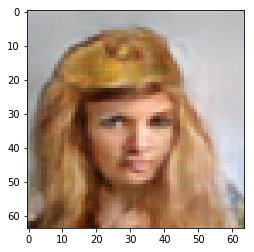

Iteration 500
Decision -1.4854595065116882e-06


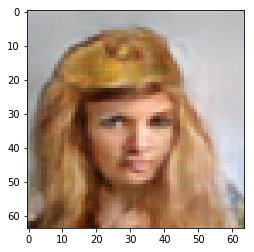

Iteration 750
Decision 8.838251233100891e-07


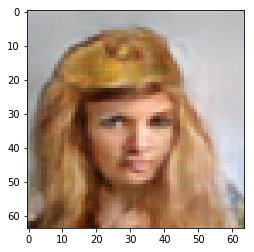

Iteration 1000
Decision -2.275221049785614e-06


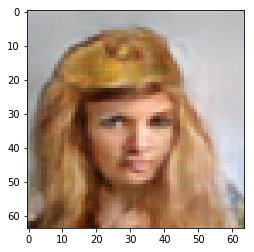

Iteration 1250
Decision 1.7629936337471008e-06


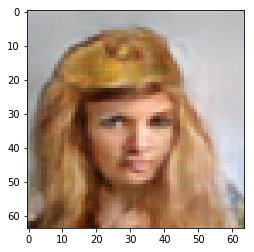

Iteration 1500
Decision 2.016313374042511e-06


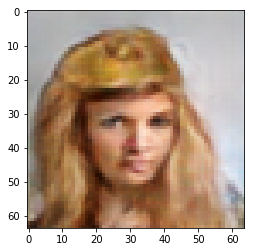

Iteration 1750
Decision 3.7299469113349915e-06


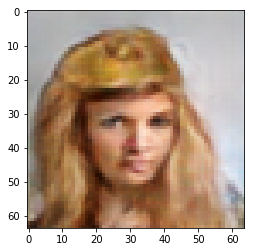

Iteration 2000
Decision 3.026798367500305e-07


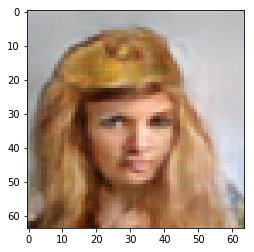

Iteration 0
Decision 0.3326793611049652


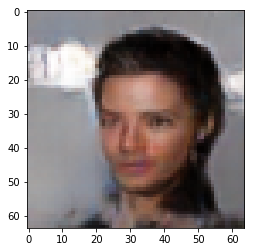

Iteration 250
Decision 1.3159587979316711e-06


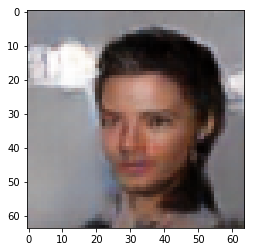

Iteration 500
Decision -5.317851901054382e-07


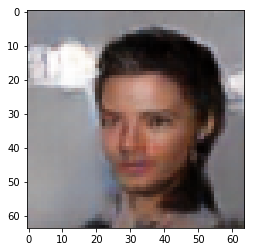

Iteration 750
Decision -1.4854595065116882e-06


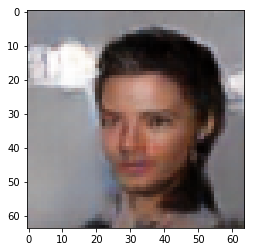

Iteration 1000
Decision 1.405365765094757e-06


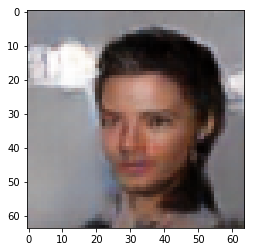

Iteration 1250
Decision -2.498738467693329e-06


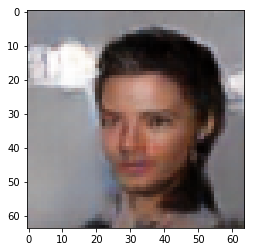

Iteration 1500
Decision -1.4687888324260712e-05


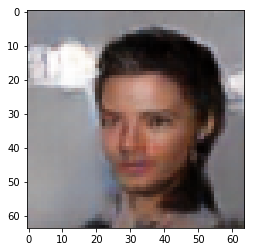

Iteration 1750
Decision -9.114854037761688e-06


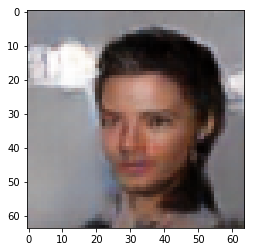

Iteration 2000
Decision -3.273598849773407e-06


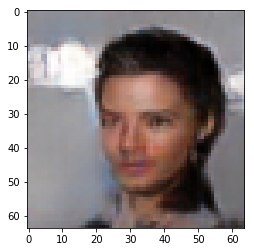

Iteration 0
Decision 3.6799938678741455


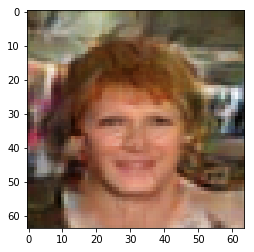

Iteration 250
Decision -4.793517291545868e-06


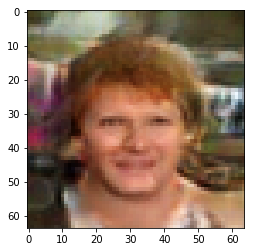

Iteration 500
Decision 2.9848888516426086e-06


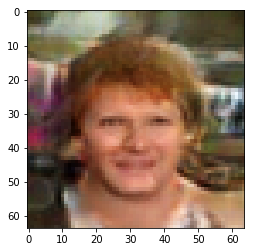

Iteration 750
Decision 4.2188912630081177e-07


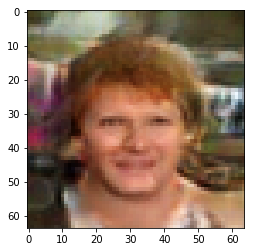

Iteration 1000
Decision 1.7927959561347961e-06


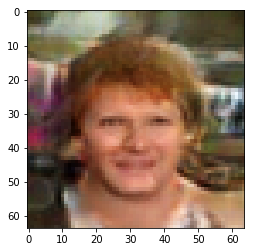

Iteration 1250
Decision 3.6405399441719055e-06


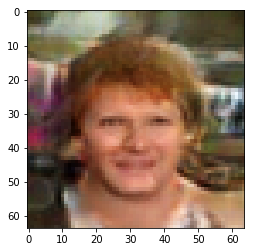

Iteration 1500
Decision 1.7629936337471008e-06


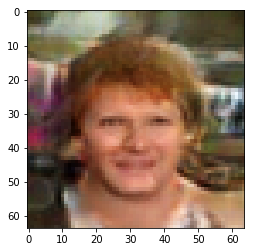

Iteration 1750
Decision 1.8347054719924927e-07


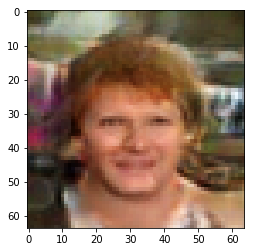

Iteration 2000
Decision 5.130656063556671e-06


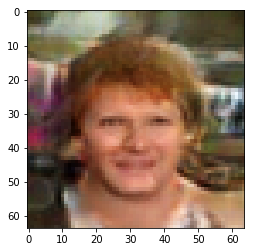

Iteration 0
Decision -4.008413791656494


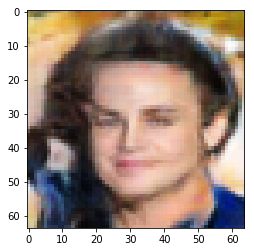

Iteration 250
Decision 3.312714397907257e-06


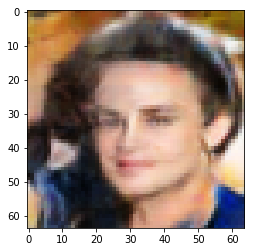

Iteration 500
Decision 7.348135113716125e-07


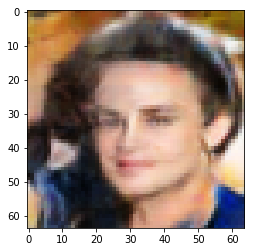

Iteration 750
Decision 2.284534275531769e-06


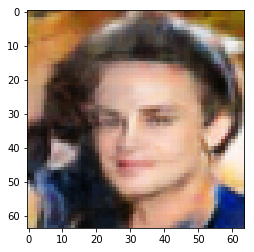

Iteration 1000
Decision -1.843087375164032e-06


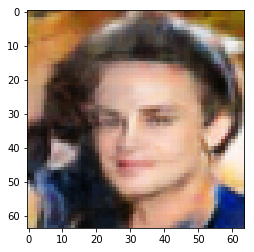

Iteration 1250
Decision -1.7415732145309448e-07


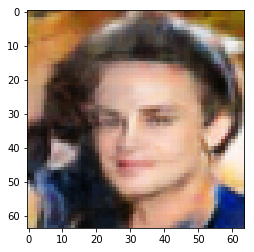

Iteration 1500
Decision 1.9120052456855774e-06


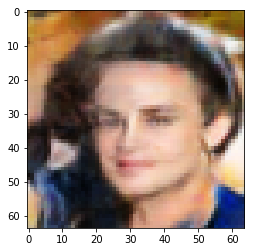

Iteration 1750
Decision -7.255002856254578e-07


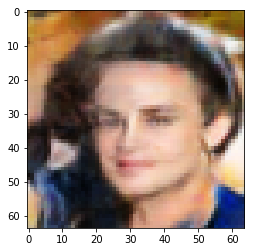

Iteration 2000
Decision -1.2619420886039734e-06


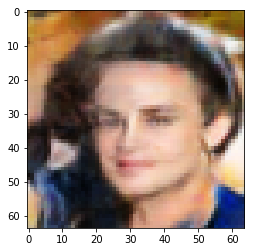

Iteration 0
Decision 9.917448997497559


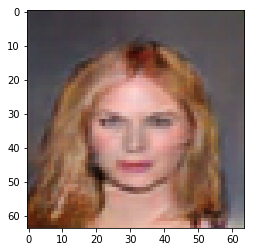

Iteration 250
Decision 2.57883220911026e-06


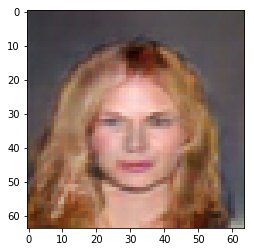

Iteration 500
Decision -7.329508662223816e-07


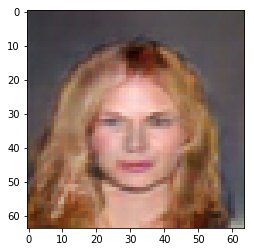

Iteration 750
Decision 6.789341568946838e-07


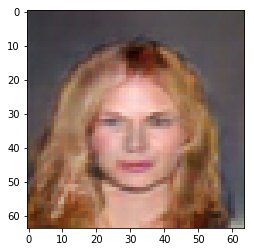

Iteration 1000
Decision -7.404014468193054e-07


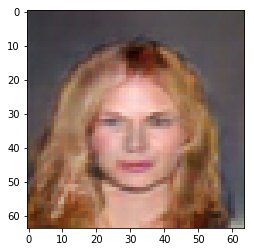

Iteration 1250
Decision 9.778887033462524e-08


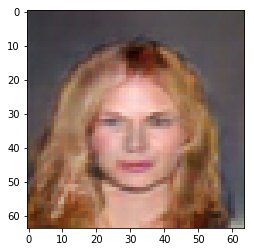

Iteration 1500
Decision -9.96515154838562e-08


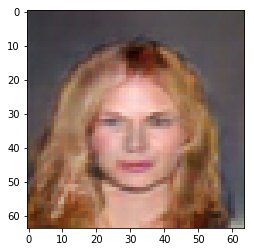

Iteration 1750
Decision 1.0523945093154907e-07


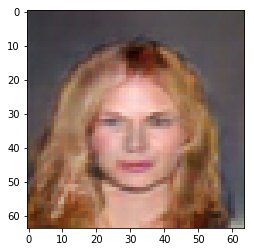

Iteration 2000
Decision 7.543712854385376e-08


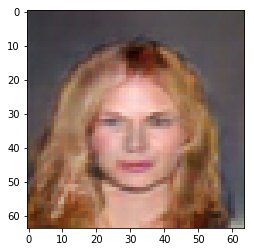

Iteration 0
Decision -8.69464111328125


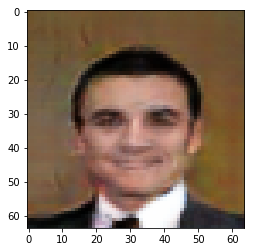

Iteration 250
Decision 4.907138645648956e-06


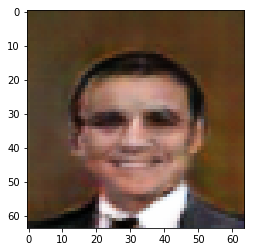

Iteration 500
Decision -1.1427327990531921e-06


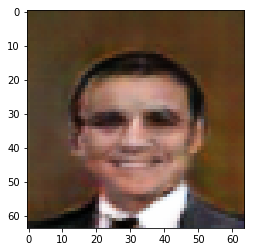

Iteration 750
Decision -1.1427327990531921e-06


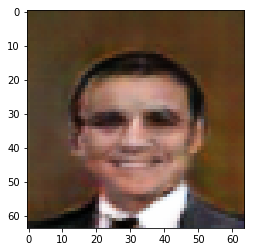

Iteration 1000
Decision -5.615875124931335e-07


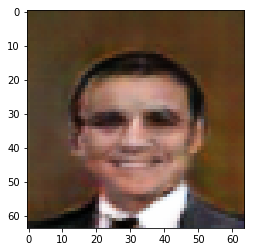

Iteration 1250
Decision -7.553026080131531e-07


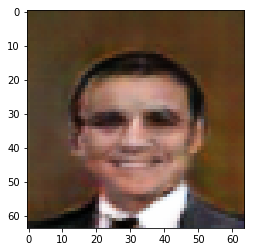

Iteration 1500
Decision 1.107342541217804e-06


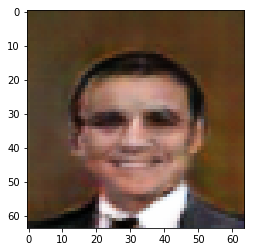

Iteration 1750
Decision -2.2007152438163757e-06


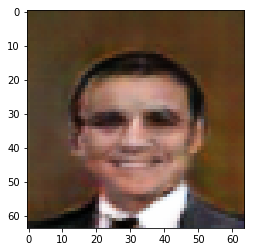

Iteration 2000
Decision 6.426125764846802e-08


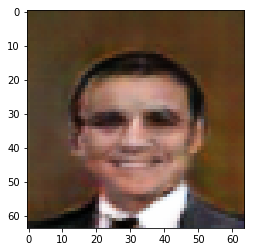

Iteration 0
Decision 7.325794219970703


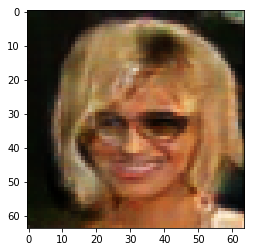

Iteration 250
Decision -6.882473826408386e-07


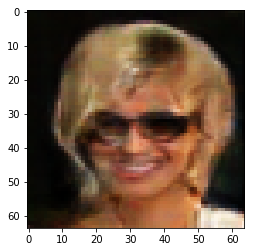

Iteration 500
Decision 6.007030606269836e-07


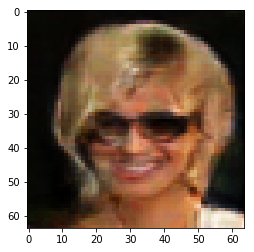

Iteration 750
Decision -1.671724021434784e-06


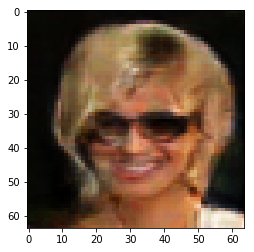

Iteration 1000
Decision 3.9208680391311646e-07


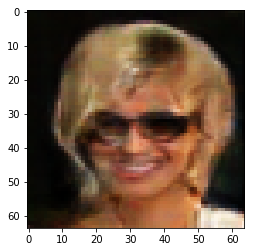

Iteration 1250
Decision 1.5366822481155396e-07


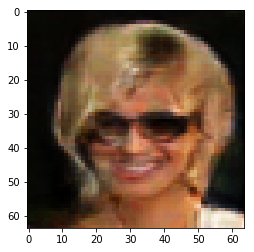

Iteration 1500
Decision 2.728775143623352e-07


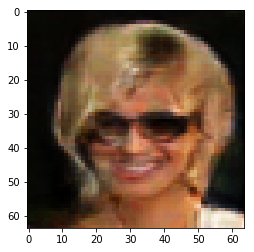

Iteration 1750
Decision 2.1131709218025208e-06


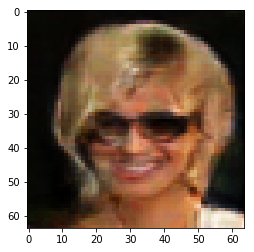

Iteration 2000
Decision 1.934356987476349e-06


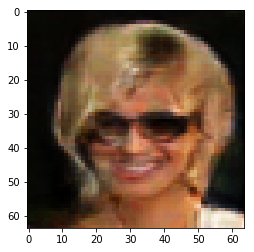

Iteration 0
Decision -0.3193834722042084


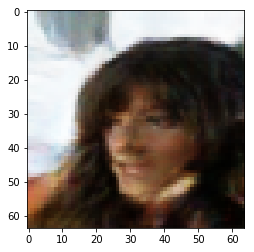

Iteration 250
Decision 2.1578744053840637e-06


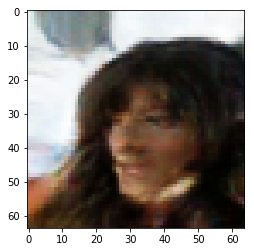

Iteration 500
Decision 3.771856427192688e-07


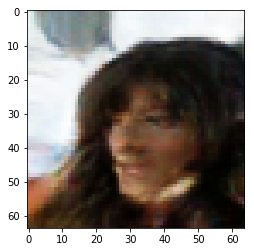

Iteration 750
Decision 8.987262845039368e-07


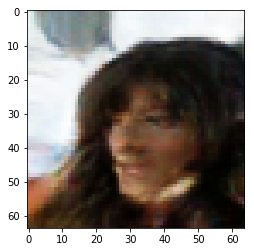

Iteration 1000
Decision 2.5080516934394836e-06


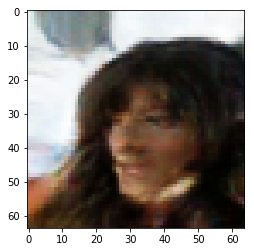

Iteration 1250
Decision 1.2191012501716614e-06


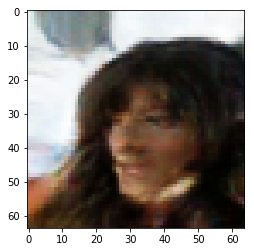

Iteration 1500
Decision 1.3830140233039856e-06


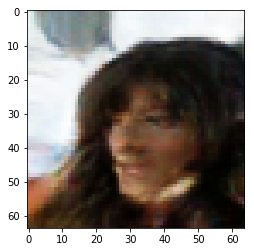

Iteration 1750
Decision -1.2693926692008972e-06


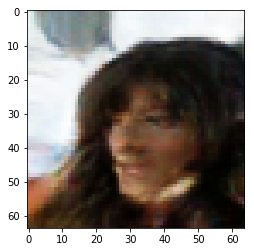

Iteration 2000
Decision 2.269633114337921e-06


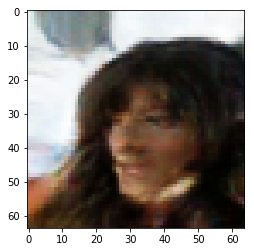

Iteration 0
Decision 11.892407417297363


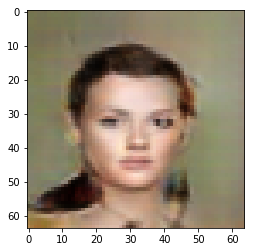

Iteration 250
Decision -2.9383227229118347e-06


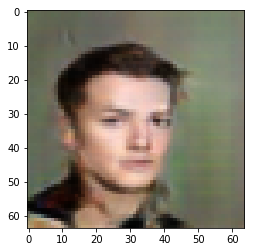

Iteration 500
Decision -2.7008354663848877e-08


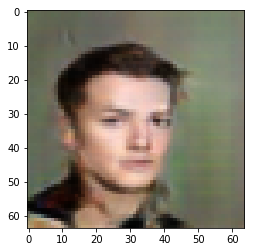

Iteration 750
Decision -2.7008354663848877e-08


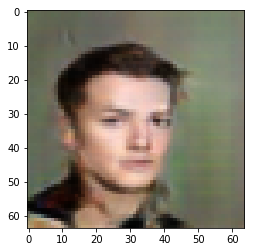

Iteration 1000
Decision -8.651986718177795e-07


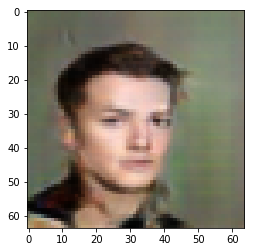

Iteration 1250
Decision 2.3562461137771606e-07


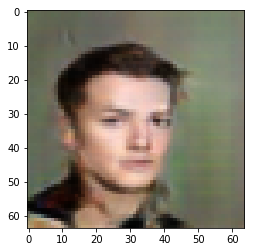

Iteration 1500
Decision 9.313225746154785e-10


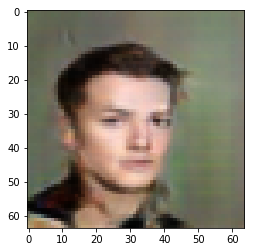

Iteration 1750
Decision 7.441267371177673e-07


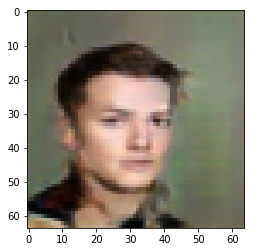

Iteration 2000
Decision 6.863847374916077e-07


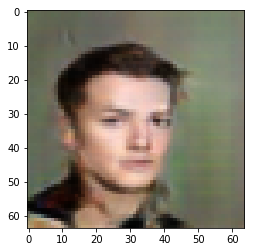

Iteration 0
Decision 5.064620018005371


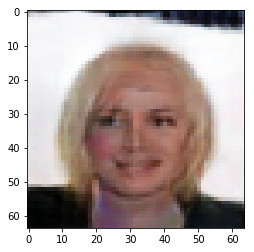

Iteration 250
Decision -4.167668521404266e-06


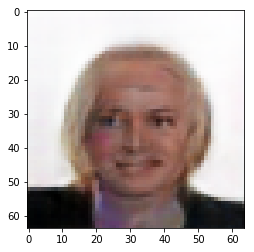

Iteration 500
Decision 1.2861564755439758e-06


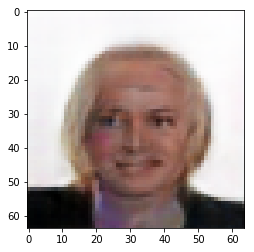

Iteration 750
Decision 1.2861564755439758e-06


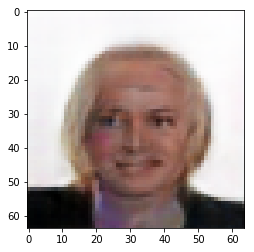

Iteration 1000
Decision 1.5366822481155396e-07


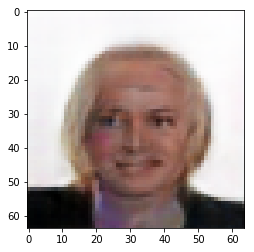

Iteration 1250
Decision -2.514570951461792e-08


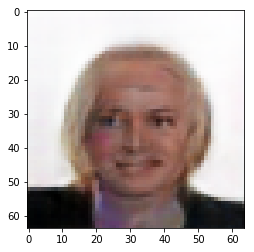

Iteration 1500
Decision -2.337619662284851e-07


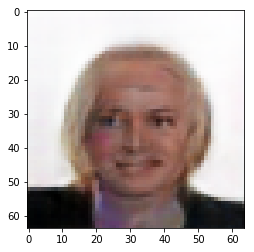

Iteration 1750
Decision -8.475035429000854e-08


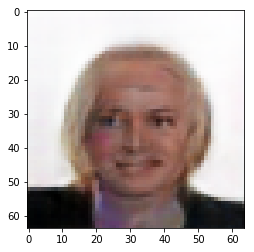

Iteration 2000
Decision -5.317851901054382e-07


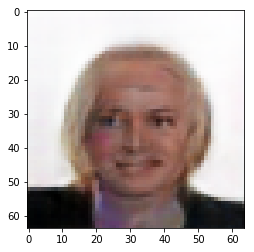

Iteration 0
Decision 3.5540788173675537


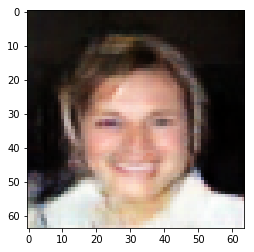

Iteration 250
Decision 1.909211277961731e-07


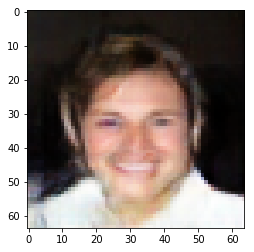

Iteration 500
Decision 3.9208680391311646e-07


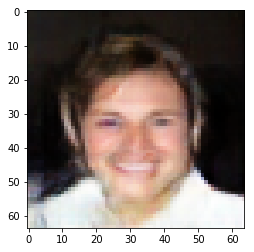

Iteration 750
Decision 5.820766091346741e-07


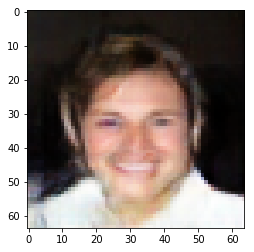

Iteration 1000
Decision -2.934597432613373e-06


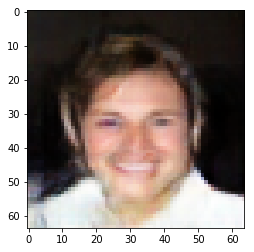

Iteration 1250
Decision -9.899958968162537e-07


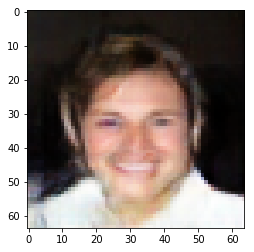

Iteration 1500
Decision -8.633360266685486e-07


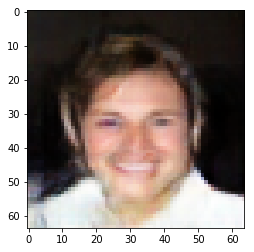

Iteration 1750
Decision -3.489665687084198e-06


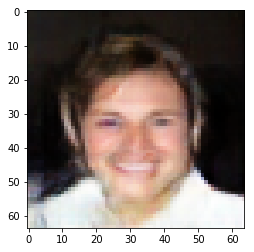

Iteration 2000
Decision -1.8989667296409607e-06


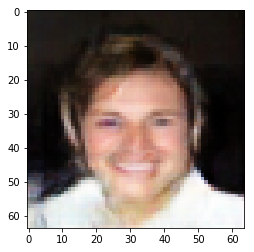

Iteration 0
Decision -2.6561636924743652


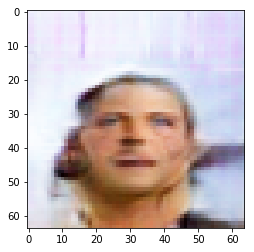

Iteration 250
Decision 3.789551556110382e-06


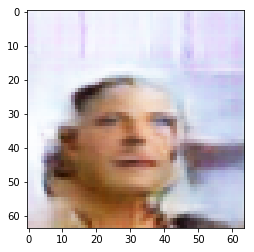

Iteration 500
Decision -3.005377948284149e-06


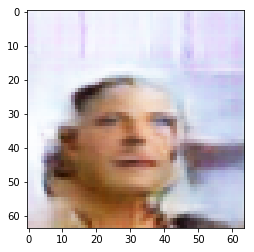

Iteration 750
Decision -2.5583431124687195e-06


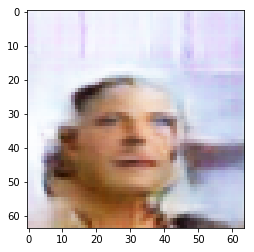

Iteration 1000
Decision 4.296191036701202e-06


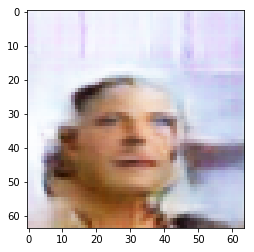

Iteration 1250
Decision 7.127411663532257e-06


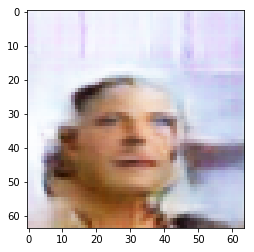

Iteration 1500
Decision -6.253831088542938e-06


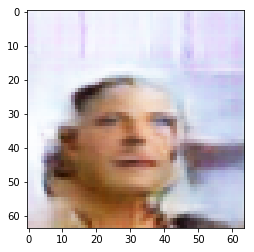

Iteration 1750
Decision -4.555098712444305e-06


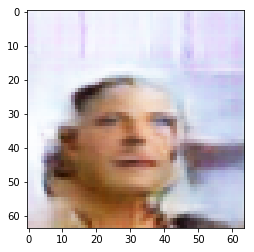

Iteration 2000
Decision -0.3199845254421234


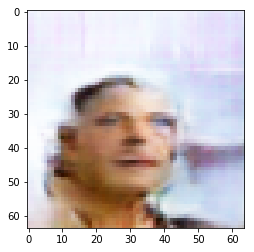

Iteration 0
Decision 6.228307247161865


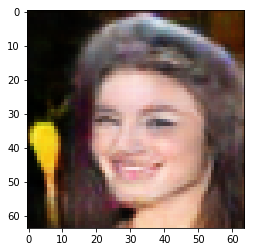

Iteration 250
Decision 4.2067840695381165e-06


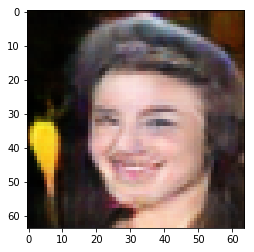

Iteration 500
Decision -1.1455267667770386e-07


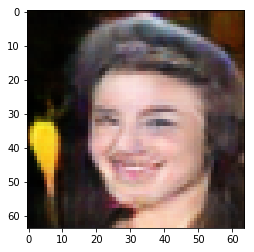

Iteration 750
Decision 1.7033889889717102e-06


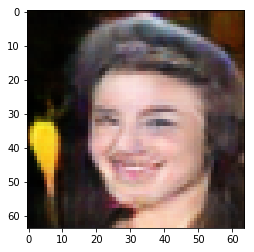

Iteration 1000
Decision -4.2747706174850464e-07


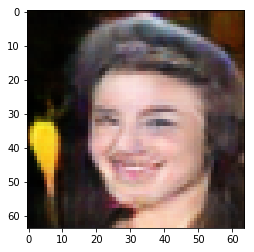

Iteration 1250
Decision -1.3960525393486023e-06


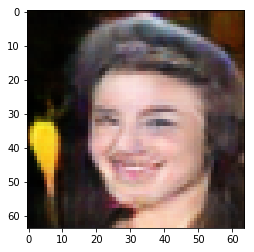

Iteration 1500
Decision -1.7834827303886414e-06


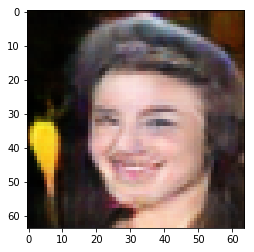

Iteration 1750
Decision 5.85801899433136e-07


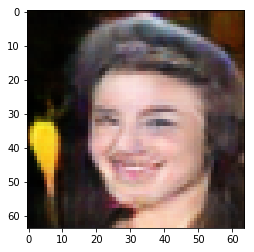

Iteration 2000
Decision -4.721805453300476e-07


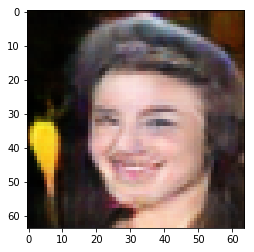

Iteration 0
Decision 8.781858444213867


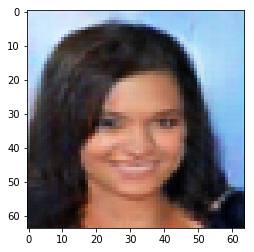

Iteration 250
Decision -1.0235235095024109e-06


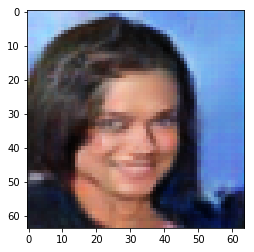

Iteration 500
Decision 6.603077054023743e-07


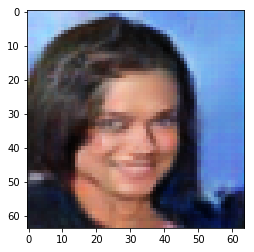

Iteration 750
Decision 1.955777406692505e-08


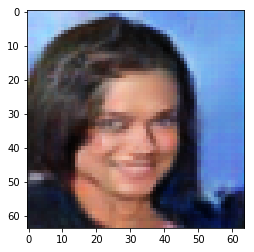

Iteration 1000
Decision 1.955777406692505e-08


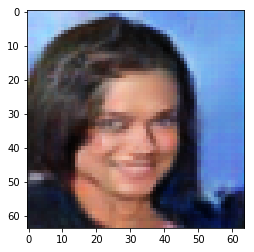

Iteration 1250
Decision 1.955777406692505e-08


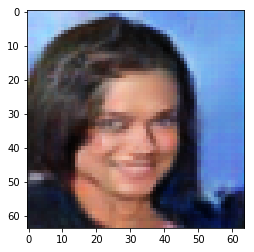

Iteration 1500
Decision 1.955777406692505e-08


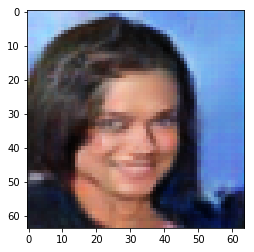

Iteration 1750
Decision -1.2945383787155151e-07


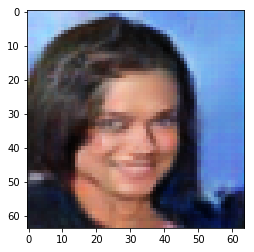

Iteration 2000
Decision 9.583309292793274e-07


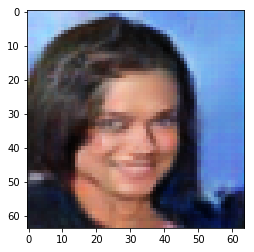

Iteration 0
Decision -0.6073037385940552


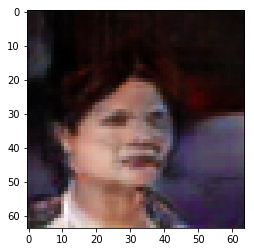

Iteration 250
Decision -3.541819751262665e-06


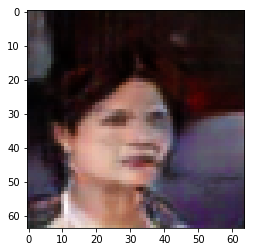

Iteration 500
Decision 1.0018236935138702e-05


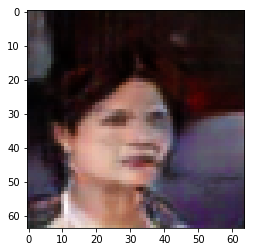

Iteration 750
Decision 4.191882908344269e-06


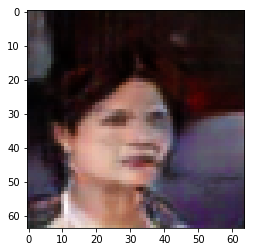

Iteration 1000
Decision 0.03215939179062843


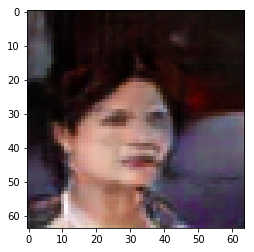

Iteration 1250
Decision -4.435889422893524e-06


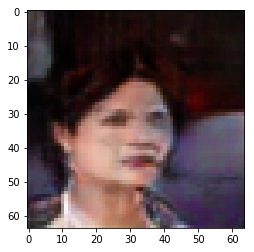

Iteration 1500
Decision 1.9567087292671204e-06


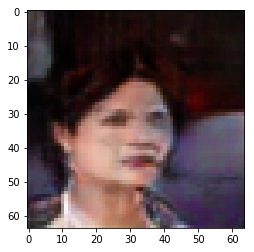

Iteration 1750
Decision -1.1126510798931122e-05


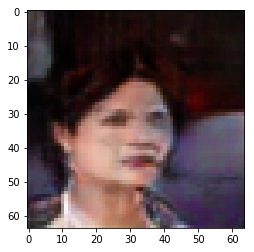

Iteration 2000
Decision 9.526778012514114e-05


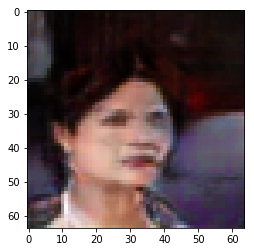

Iteration 0
Decision 10.710836410522461


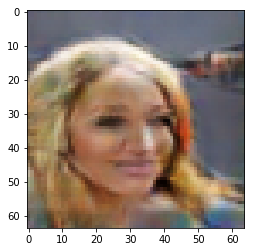

Iteration 250
Decision 0.017982814460992813


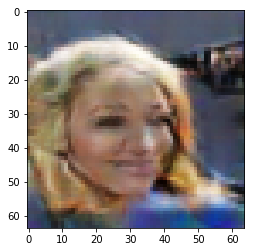

Iteration 500
Decision -1.4435499906539917e-07


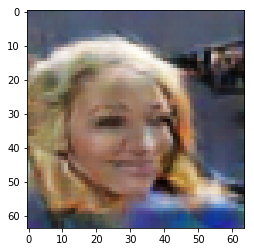

Iteration 750
Decision -1.4435499906539917e-07


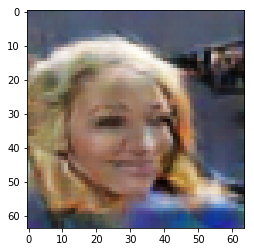

Iteration 1000
Decision -2.514570951461792e-08
Iteration 1000
Decision -8.596107363700867e-07


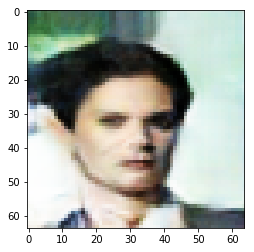

Iteration 1250
Decision 9.406358003616333e-08


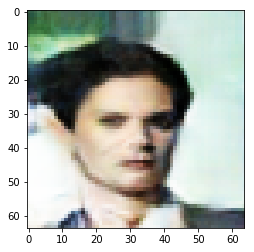

Iteration 1500
Decision -3.2316893339157104e-07


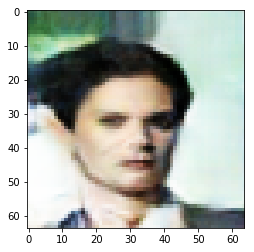

Iteration 1750
Decision 9.406358003616333e-08


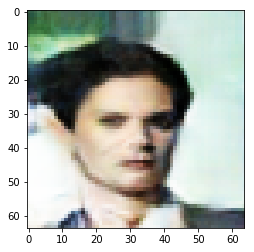

Iteration 2000
Decision 9.406358003616333e-08


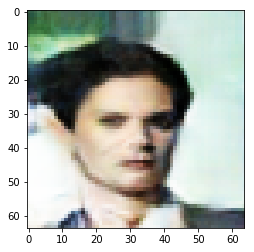

Iteration 0
Decision -1.0702593326568604


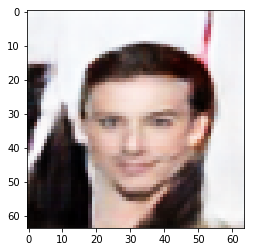

Iteration 250
Decision -7.058493793010712e-06


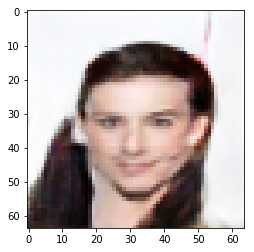

Iteration 500
Decision 2.40253284573555e-05


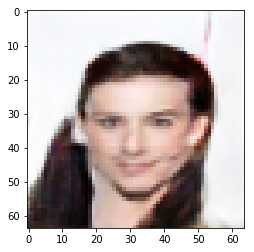

Iteration 750
Decision -3.566872328519821e-05


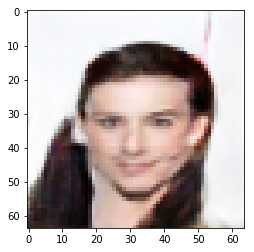

Iteration 1000
Decision 6.735790520906448e-05


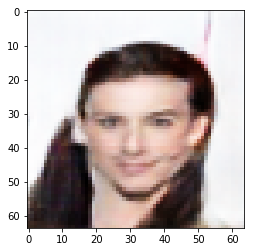

Iteration 1250
Decision 2.560485154390335e-05


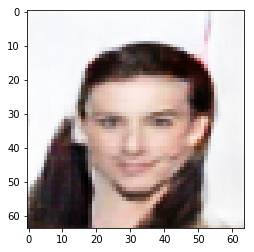

Iteration 1500
Decision -6.730668246746063e-06


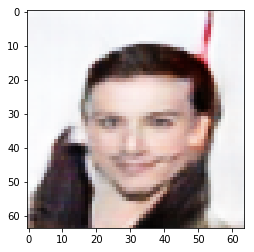

Iteration 1750
Decision 2.2994354367256165e-06


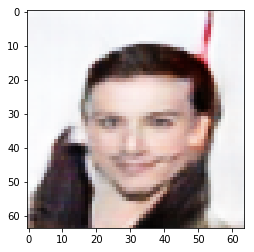

Iteration 2000
Decision -2.796761691570282e-06


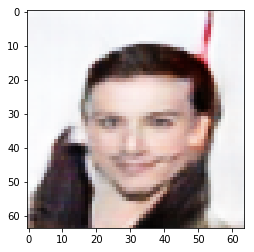

Iteration 0
Decision 1.579721450805664


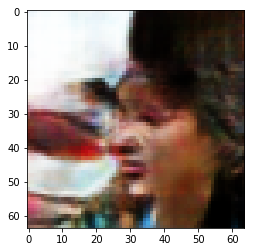

Iteration 250
Decision -5.392357707023621e-07


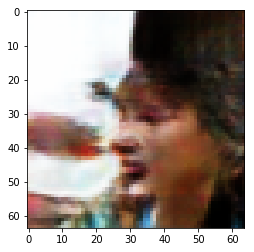

Iteration 500
Decision 4.527159035205841e-06


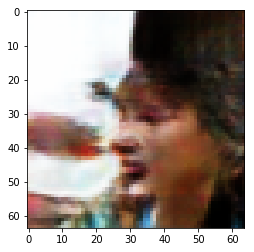

Iteration 750
Decision -1.3480894267559052e-05


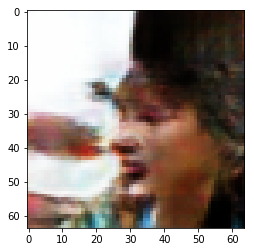

Iteration 1000
Decision 1.062639057636261e-06


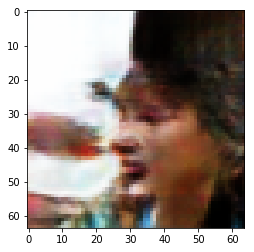

Iteration 1250
Decision 0.00040416140109300613


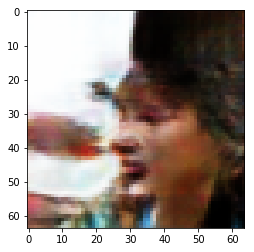

Iteration 1500
Decision -1.1163763701915741e-05


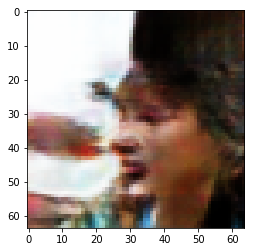

Iteration 1750
Decision -2.3795291781425476e-06


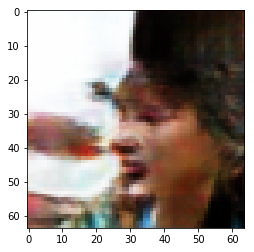

Iteration 2000
Decision -3.5567209124565125e-06


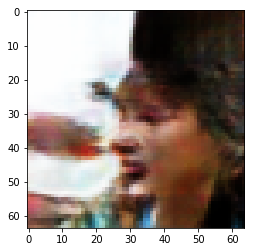

Iteration 0
Decision 1.2004705667495728


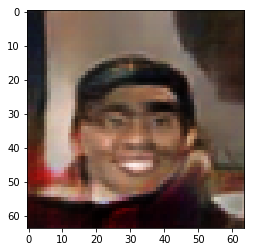

Iteration 250
Decision 8.689239621162415e-07


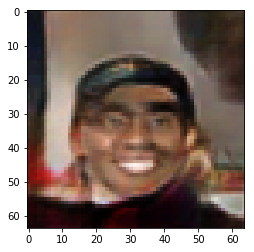

Iteration 500
Decision -2.6030465960502625e-06


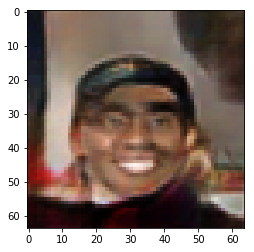

Iteration 750
Decision -1.6940757632255554e-06


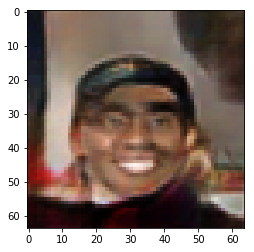

Iteration 1000
Decision -1.1305324733257294e-05


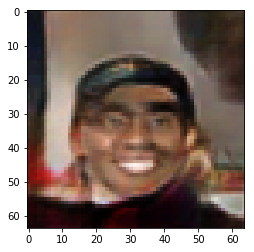

Iteration 1250
Decision -4.01865690946579e-06


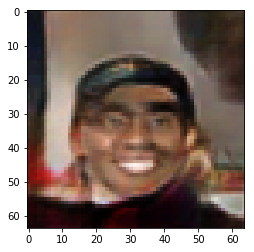

Iteration 1500
Decision -1.0292045772075653e-05


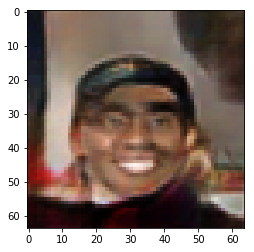

Iteration 1750
Decision 4.415400326251984e-06


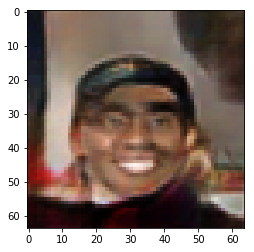

Iteration 2000
Decision -1.0783784091472626e-05


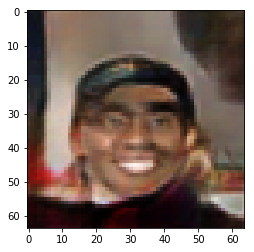

Iteration 0
Decision 4.299501419067383


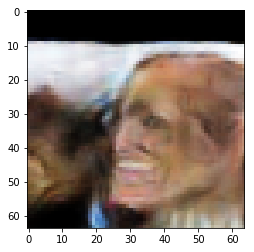

Iteration 250
Decision -1.455657184123993e-06


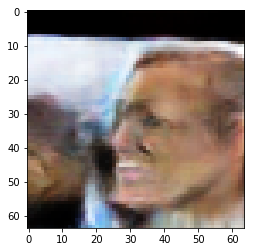

Iteration 500
Decision 7.720664143562317e-07


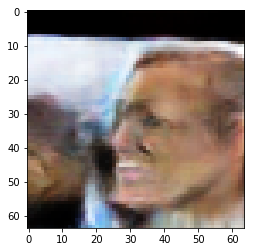

Iteration 750
Decision -2.4121254682540894e-07


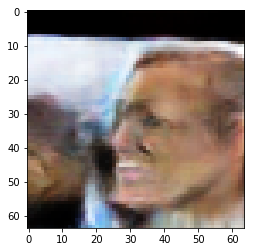

Iteration 1000
Decision -5.466863512992859e-07


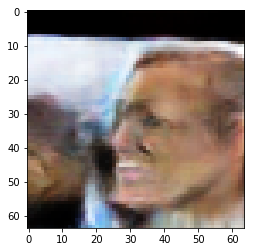

Iteration 1250
Decision 3.148801624774933e-06


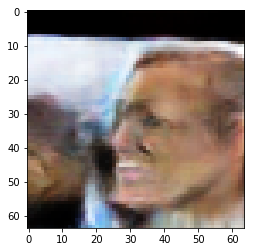

Iteration 1500
Decision -1.4435499906539917e-07


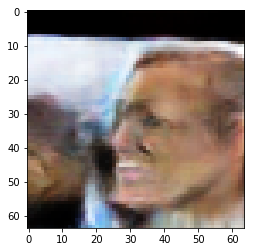

Iteration 1750
Decision 6.233341991901398e-06


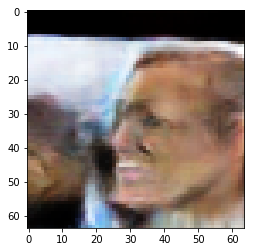

Iteration 2000
Decision -2.4689361453056335e-06


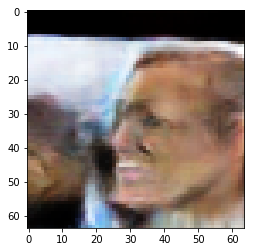

Iteration 0
Decision 11.136835098266602


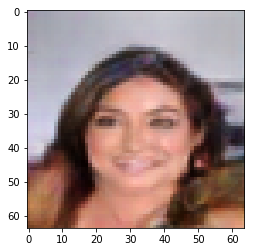

Iteration 250
Decision 1.25812366604805e-05


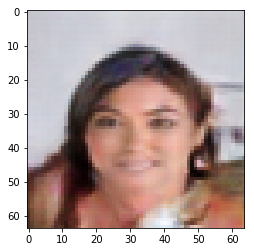

Iteration 500
Decision 3.4458935260772705e-08


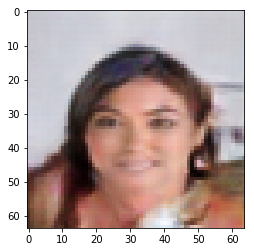

Iteration 750
Decision 3.4458935260772705e-08


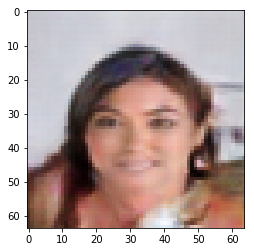

Iteration 1000
Decision 4.6566128730773926e-09


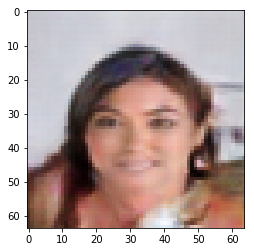

Iteration 1250
Decision 4.6566128730773926e-09


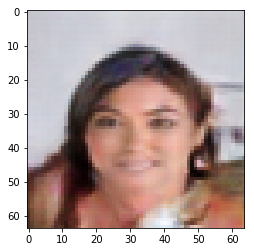

Iteration 1500
Decision 4.6566128730773926e-09


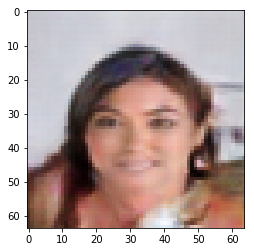

Iteration 1750
Decision 4.6566128730773926e-09


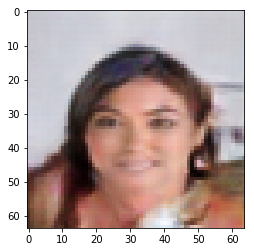

Iteration 2000
Decision 4.6566128730773926e-09


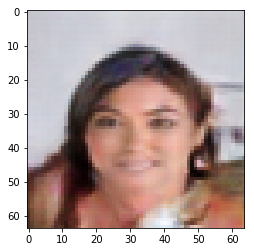

Iteration 0
Decision -19.3669376373291


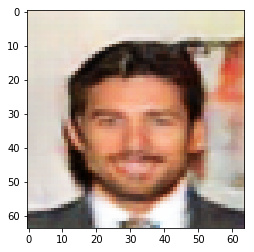

Iteration 250
Decision -2.2615306079387665e-05


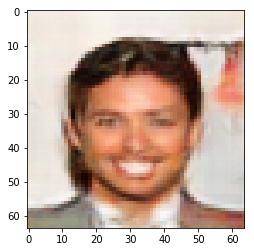

Iteration 500
Decision 6.30505383014679e-07


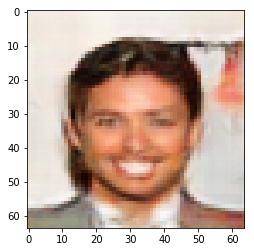

Iteration 750
Decision -8.475035429000854e-08


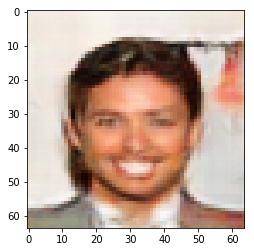

Iteration 1000
Decision 1.5366822481155396e-07


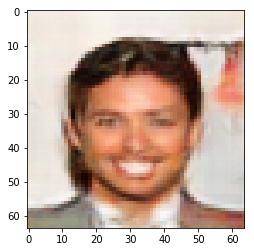

Iteration 1250
Decision -8.475035429000854e-08


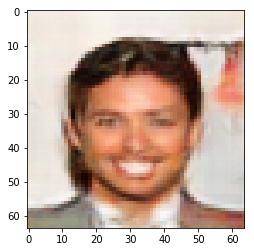

Iteration 1500
Decision -1.5450641512870789e-06


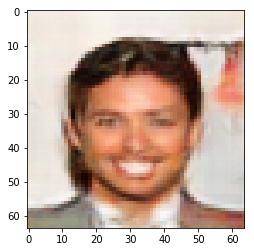

Iteration 1750
Decision -1.1576339602470398e-06


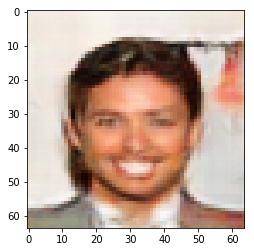

Iteration 2000
Decision 3.026798367500305e-07


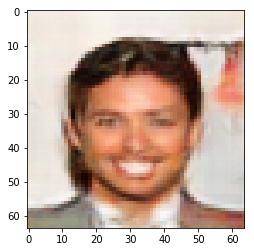

Iteration 0
Decision -8.241904258728027


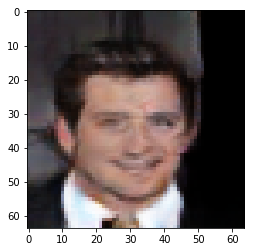

Iteration 250
Decision -8.475035429000854e-08


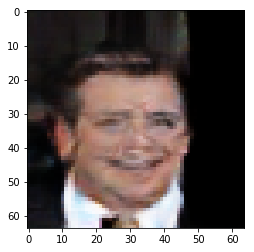

Iteration 500
Decision -2.8265640139579773e-06


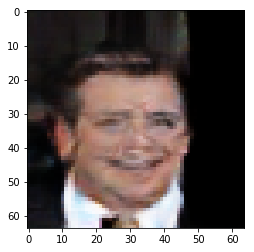

Iteration 750
Decision -1.4435499906539917e-07


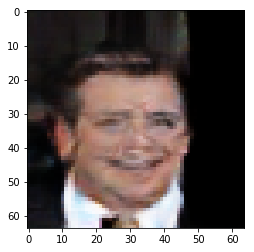

Iteration 1000
Decision 2.1327286958694458e-07


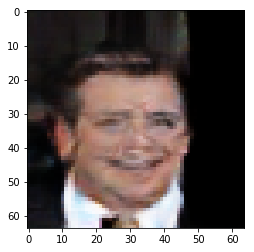

Iteration 1250
Decision -8.475035429000854e-08


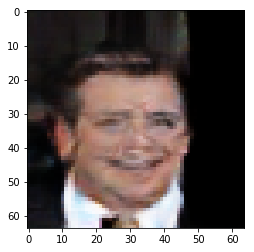

Iteration 1500
Decision -4.721805453300476e-07


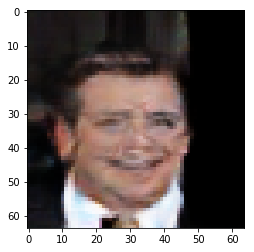

Iteration 1750
Decision -2.514570951461792e-08


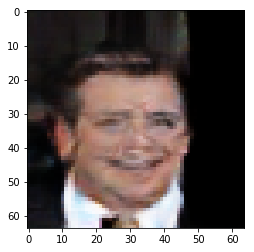

Iteration 2000
Decision 2.3292377591133118e-06


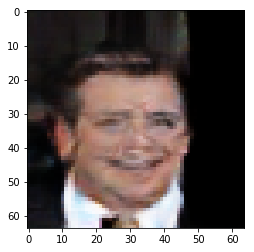

Iteration 0
Decision 1.5854994058609009


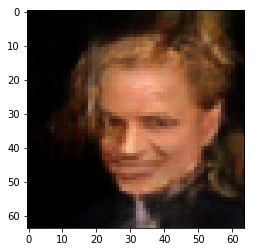

Iteration 250
Decision 1.6065314412117004e-06


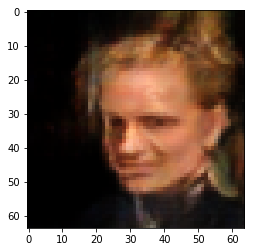

Iteration 500
Decision -4.450790584087372e-06


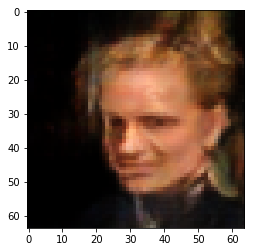

Iteration 750
Decision 2.0014122128486633e-06


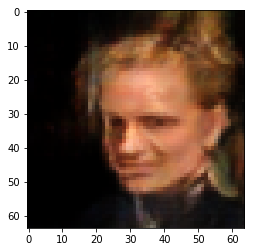

Iteration 1000
Decision -7.423572242259979e-06


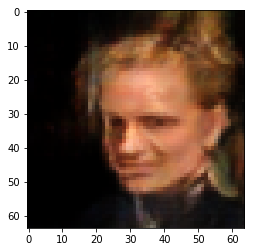

Iteration 1250
Decision 6.960052996873856e-05


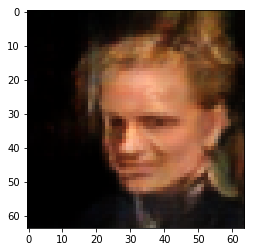

Iteration 1500
Decision -1.091044396162033e-05


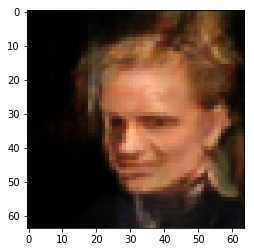

Iteration 1750
Decision -3.713183104991913e-06


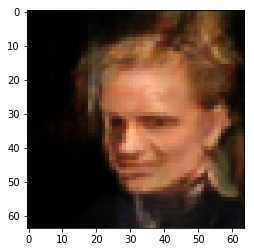

Iteration 2000
Decision -2.491287887096405e-06


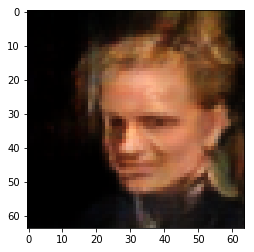

Iteration 0
Decision -4.425381660461426


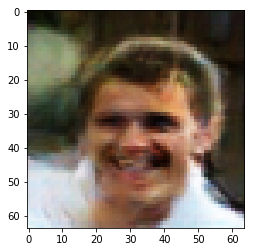

Iteration 250
Decision 5.709007382392883e-07


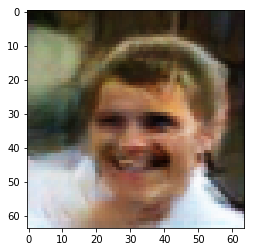

Iteration 500
Decision -1.3364478945732117e-06


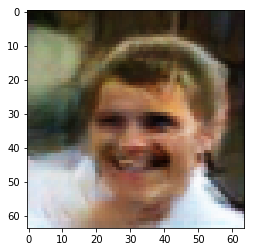

Iteration 750
Decision 1.1818483471870422e-06


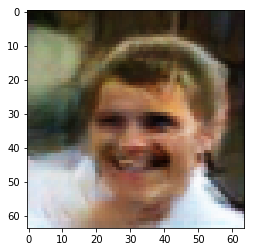

Iteration 1000
Decision -2.2007152438163757e-06


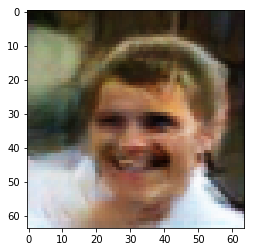

Iteration 1250
Decision -1.4854595065116882e-06


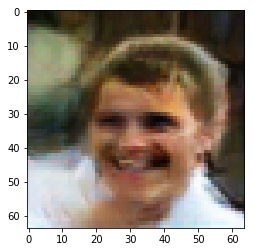

Iteration 1500
Decision 2.5229528546333313e-06


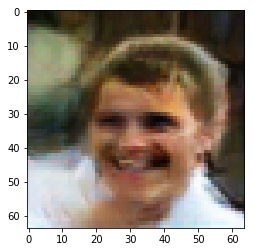

Iteration 1750
Decision 7.916241884231567e-08


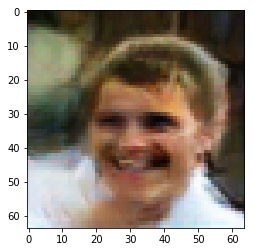

Iteration 2000
Decision -4.793517291545868e-06


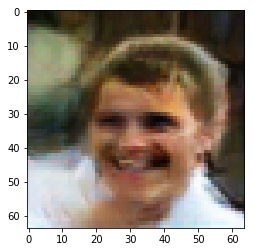

Iteration 0
Decision 10.112332344055176


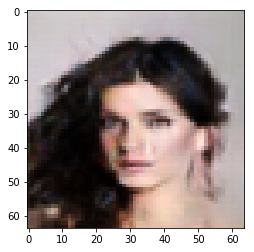

Iteration 250
Decision -7.3267146944999695e-06


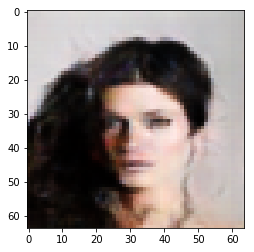

Iteration 500
Decision -2.021901309490204e-06


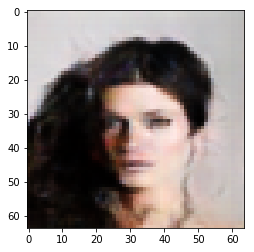

Iteration 750
Decision 6.426125764846802e-08


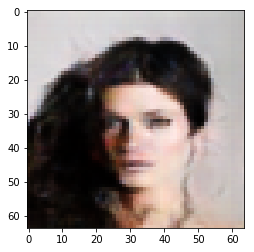

Iteration 1000
Decision -1.1455267667770386e-07


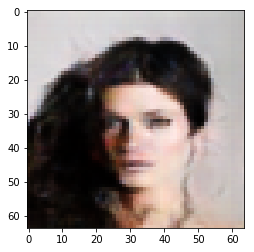

Iteration 1250
Decision 6.426125764846802e-08


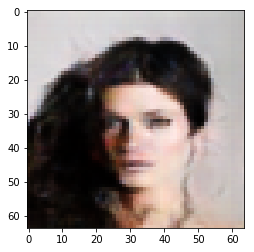

Iteration 1500
Decision -1.1455267667770386e-07


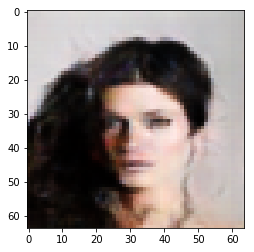

Iteration 1750
Decision 1.3755634427070618e-06


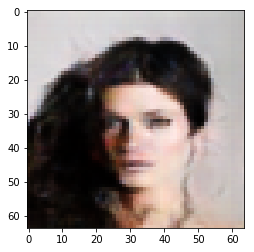

Iteration 2000
Decision 1.2861564755439758e-06


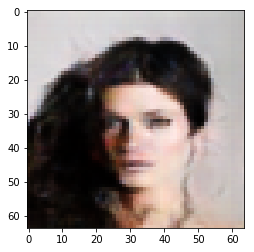

Iteration 0
Decision -1.544516921043396


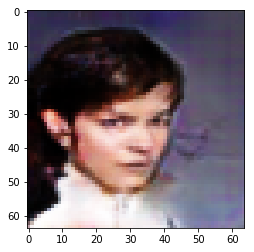

Iteration 250
Decision 2.5425106287002563e-07


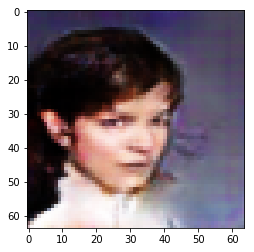

Iteration 500
Decision -4.628673195838928e-07


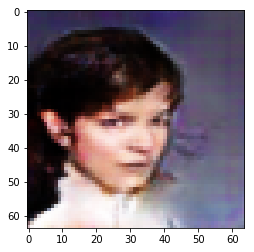

Iteration 750
Decision 3.063119947910309e-06


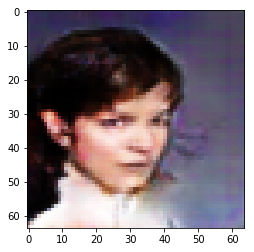

Iteration 1000
Decision 4.75812703371048e-06


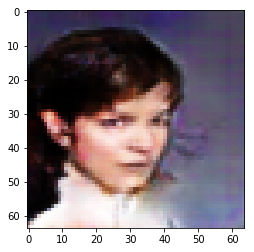

Iteration 1250
Decision -4.32971864938736e-06


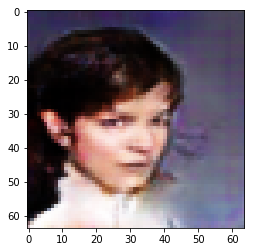

Iteration 1500
Decision -1.4891847968101501e-06


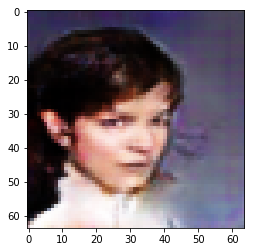

Iteration 1750
Decision 4.7711655497550964e-06


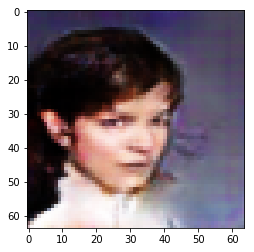

Iteration 2000
Decision -3.5045668482780457e-06


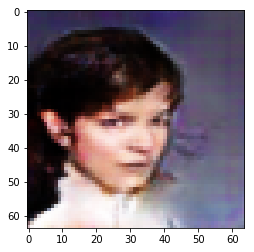

Iteration 0
Decision 7.611960411071777


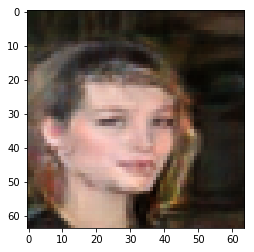

Iteration 250
Decision 7.261522114276886e-06


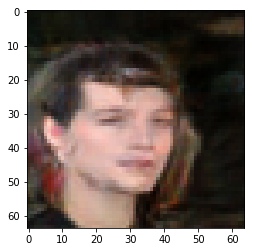

Iteration 500
Decision -3.902241587638855e-07


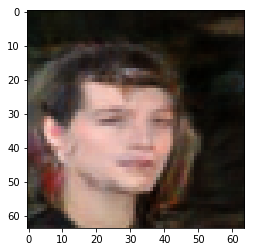

Iteration 750
Decision 7.916241884231567e-08


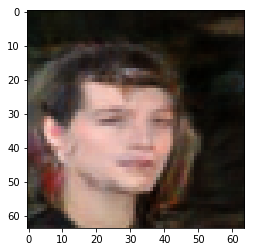

Iteration 1000
Decision -6.984919309616089e-08


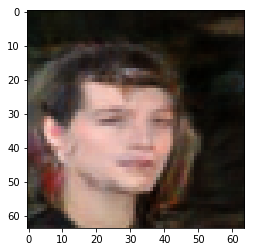

Iteration 1250
Decision -6.984919309616089e-08


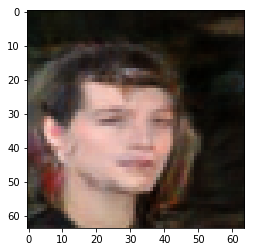

Iteration 1500
Decision -6.984919309616089e-08


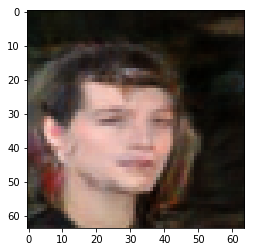

Iteration 1750
Decision -6.984919309616089e-08


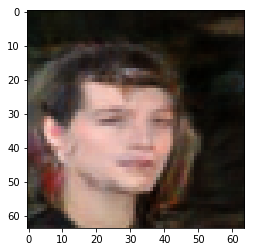

Iteration 2000
Decision 7.916241884231567e-08


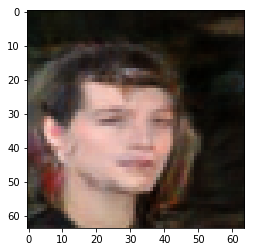

Iteration 0
Decision 2.310293674468994


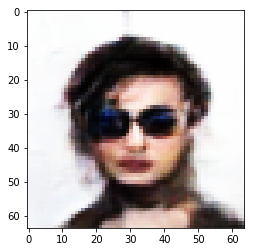

Iteration 250
Decision -1.0086223483085632e-06


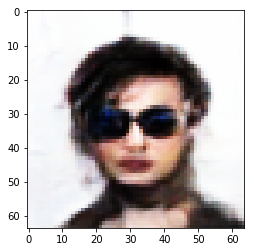

Iteration 500
Decision 5.41098415851593e-07


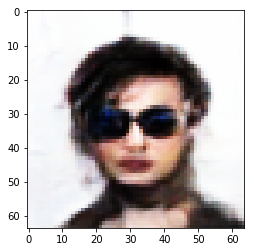

Iteration 750
Decision 1.882202923297882e-06


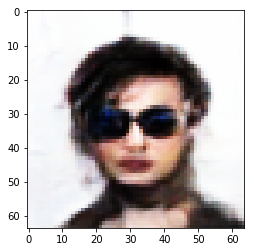

Iteration 1000
Decision -5.359761416912079e-06


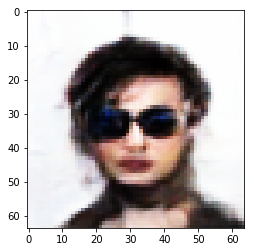

Iteration 1250
Decision -4.346482455730438e-06


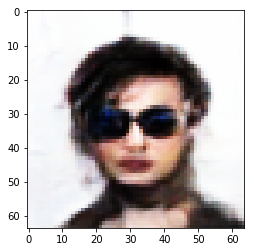

Iteration 1500
Decision -3.273598849773407e-06


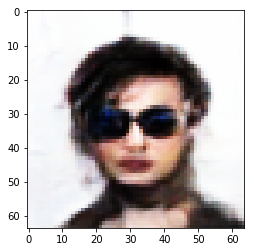

Iteration 1750
Decision 1.2265518307685852e-06


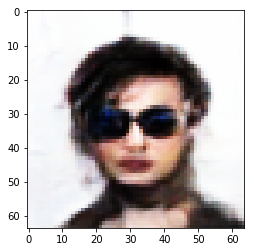

Iteration 2000
Decision -8.459202945232391e-06


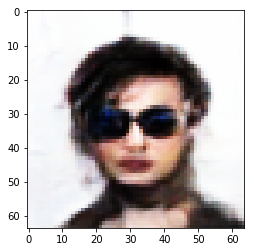

Iteration 0
Decision -4.390113353729248


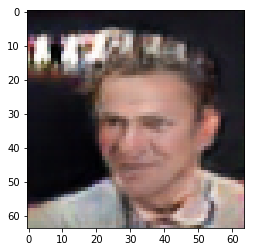

Iteration 250
Decision 1.0477378964424133e-06


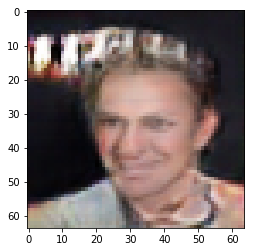

Iteration 500
Decision 1.3159587979316711e-06


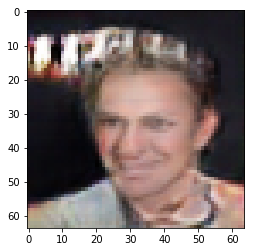

Iteration 750
Decision 9.406358003616333e-08


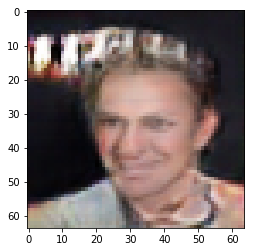

Iteration 1000
Decision -2.514570951461792e-08


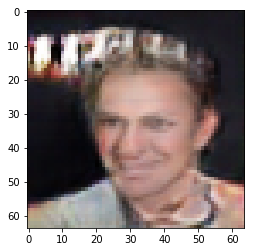

Iteration 1250
Decision -2.514570951461792e-08


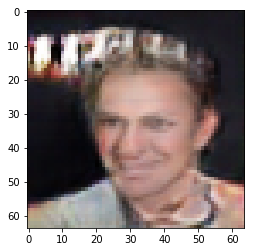

Iteration 1500
Decision -2.514570951461792e-08


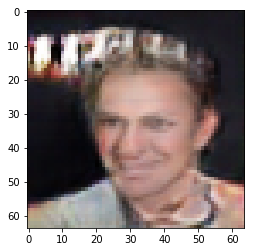

Iteration 1750
Decision -2.514570951461792e-08


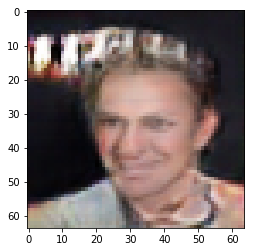

Iteration 2000
Decision -3.4226104617118835e-06


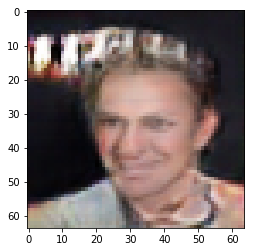

Iteration 0
Decision 9.644937515258789


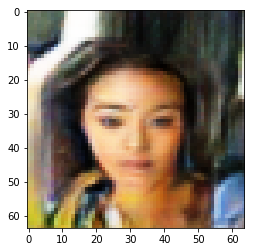

Iteration 250
Decision 5.696900188922882e-06


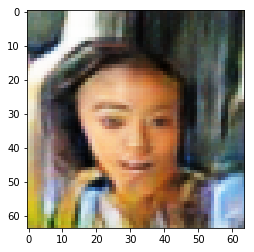

Iteration 500
Decision -7.702037692070007e-07


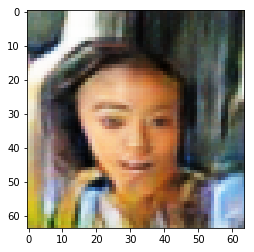

Iteration 750
Decision 6.603077054023743e-07


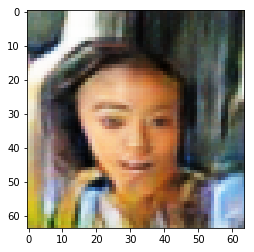

Iteration 1000
Decision -2.337619662284851e-07


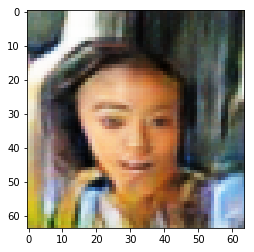

Iteration 1250
Decision 4.814937710762024e-07


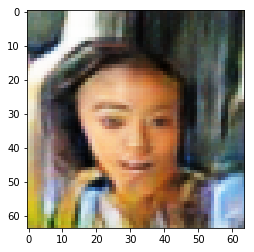

Iteration 1500
Decision -2.337619662284851e-07


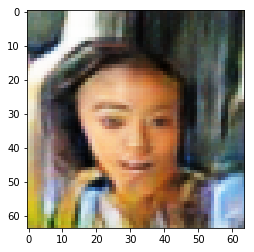

Iteration 1750
Decision -2.337619662284851e-07


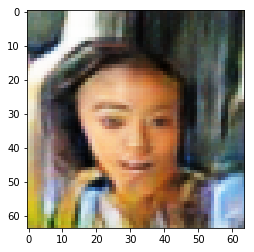

Iteration 2000
Decision 3.9208680391311646e-07


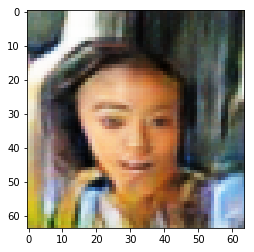

Iteration 0
Decision 8.75550651550293


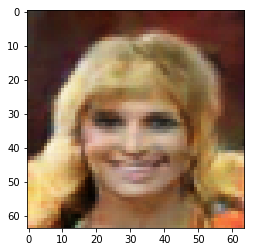

Iteration 250
Decision -4.167668521404266e-06


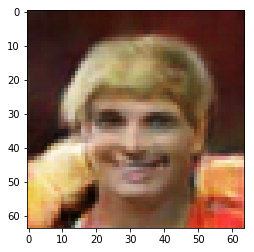

Iteration 500
Decision 3.026798367500305e-07


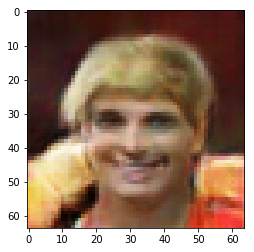

Iteration 750
Decision 2.1327286958694458e-07


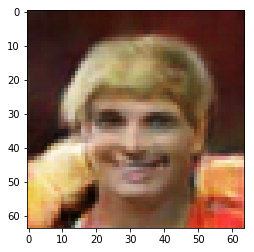

Iteration 1000
Decision 6.007030606269836e-07


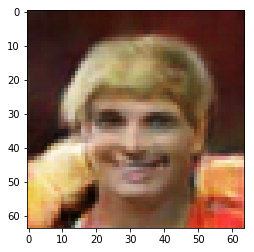

Iteration 1250
Decision 7.497146725654602e-07


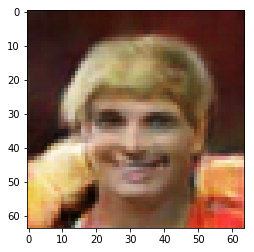

Iteration 1500
Decision -2.230517566204071e-06


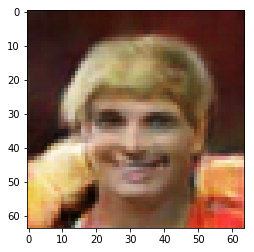

Iteration 1750
Decision 1.1371448636054993e-06


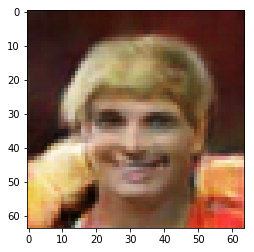

Iteration 2000
Decision -3.06498259305954e-06


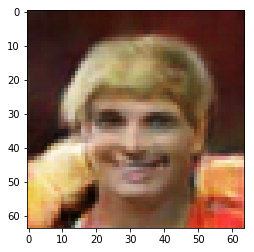

Iteration 0
Decision 12.365144729614258


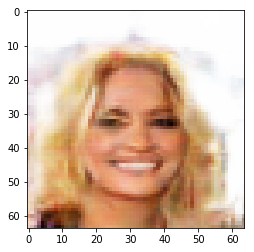

Iteration 250
Decision 1.2432225048542023e-05


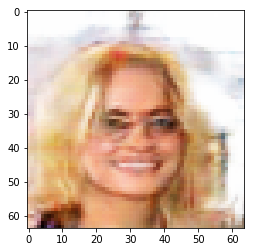

Iteration 500
Decision -2.514570951461792e-08


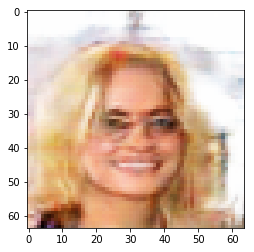

Iteration 750
Decision -2.514570951461792e-08


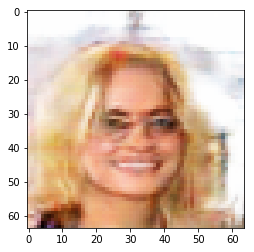

Iteration 1000
Decision -2.514570951461792e-08


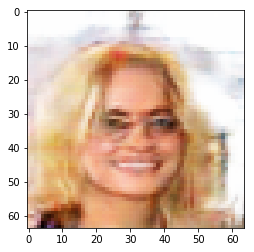

Iteration 1250
Decision -2.514570951461792e-08


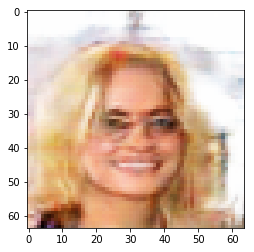

Iteration 1500
Decision -2.514570951461792e-08


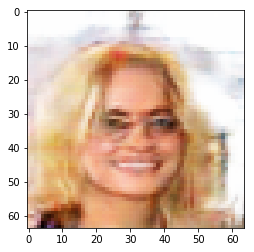

Iteration 1750
Decision -2.514570951461792e-08


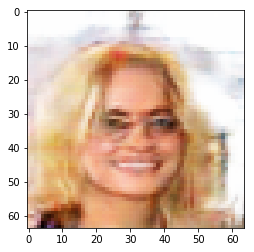

Iteration 2000
Decision -2.514570951461792e-08


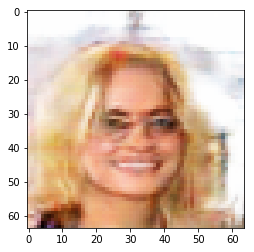

Iteration 0
Decision -6.59184455871582


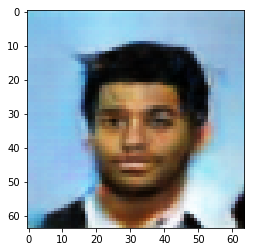

Iteration 250
Decision 2.15042382478714e-06


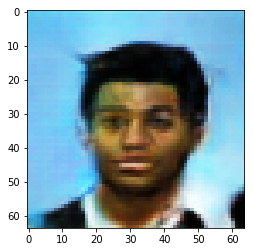

Iteration 500
Decision 5.112960934638977e-07


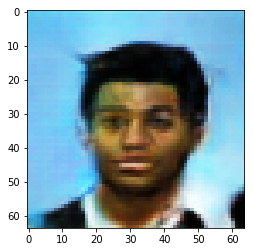

Iteration 750
Decision -2.337619662284851e-07


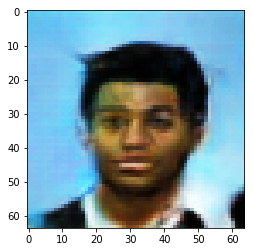

Iteration 1000
Decision 2.728775143623352e-07


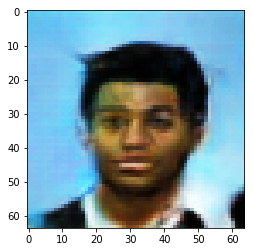

Iteration 1250
Decision -9.78820025920868e-07


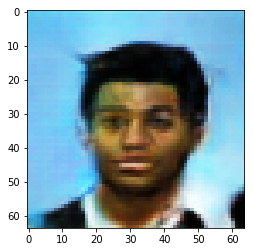

Iteration 1500
Decision -8.298084139823914e-07


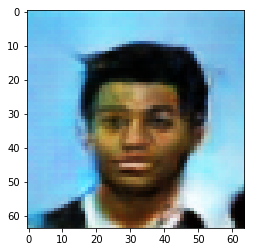

Iteration 1750
Decision -2.796761691570282e-06


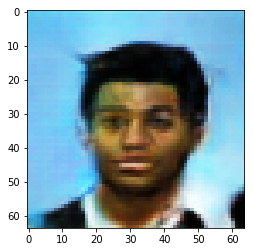

Iteration 2000
Decision -4.423782229423523e-07


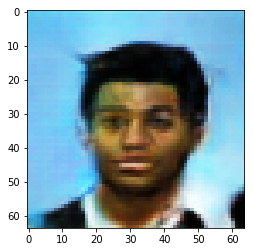

Iteration 0
Decision 9.860645294189453


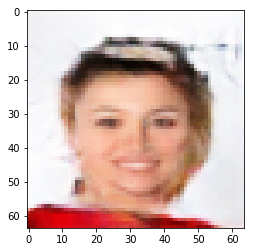

Iteration 250
Decision -2.528540790081024e-06


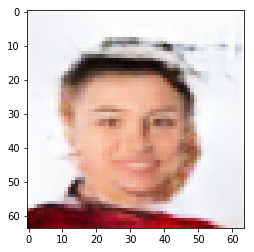

Iteration 500
Decision 3.4458935260772705e-08


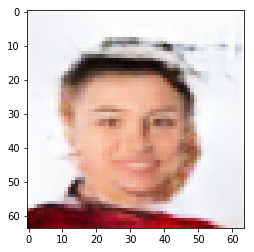

Iteration 750
Decision -1.1874362826347351e-06


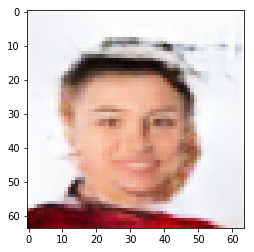

Iteration 1000
Decision 1.017935574054718e-06


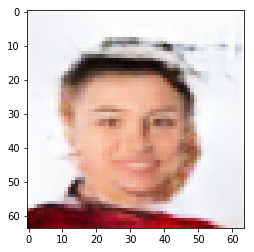

Iteration 1250
Decision 8.093193173408508e-07


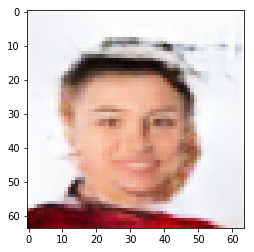

Iteration 1500
Decision -1.1455267667770386e-07


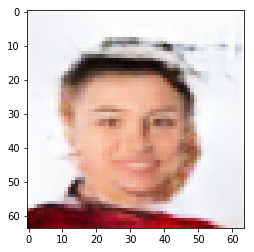

Iteration 1750
Decision 6.007030606269836e-07


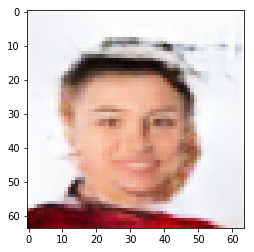

Iteration 2000
Decision -1.0086223483085632e-06


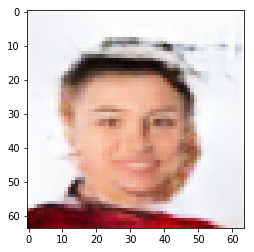

Iteration 0
Decision 13.744237899780273


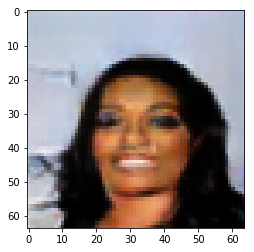

Iteration 250
Decision -2.0357780158519745e-05


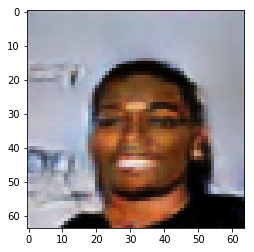

Iteration 500
Decision -9.592622518539429e-08


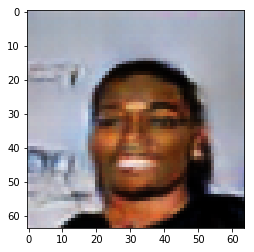

Iteration 750
Decision -1.778826117515564e-07


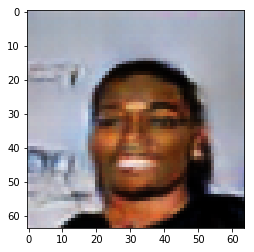

Iteration 1000
Decision -1.778826117515564e-07


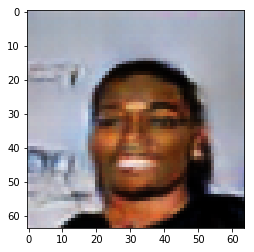

Iteration 1250
Decision 2.989545464515686e-07


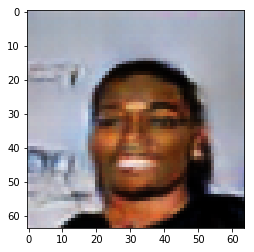

Iteration 1500
Decision -7.851049304008484e-07


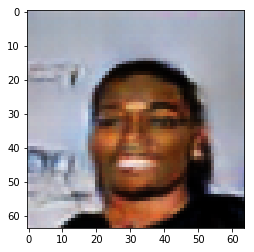

Iteration 1750
Decision -1.2945383787155151e-07


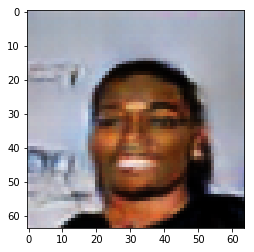

Iteration 2000
Decision -9.490177035331726e-07


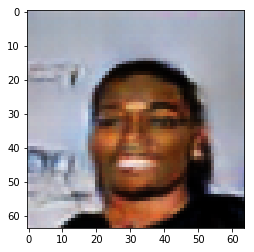

Iteration 0
Decision 4.478677749633789


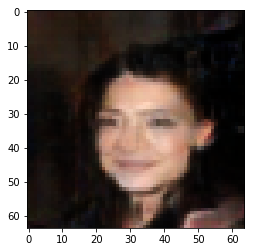

Iteration 250
Decision -4.614703357219696e-06


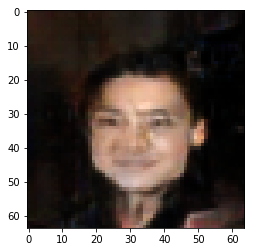

Iteration 500
Decision -1.2945383787155151e-07


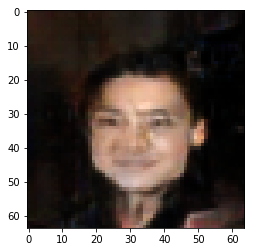

Iteration 750
Decision 4.516914486885071e-07


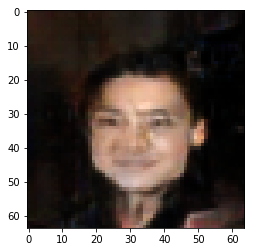

Iteration 1000
Decision 4.516914486885071e-07


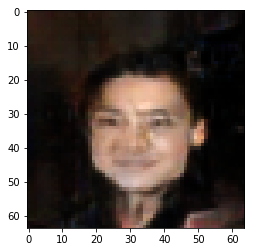

Iteration 1250
Decision -1.843087375164032e-06


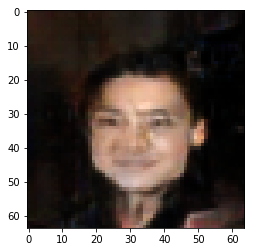

Iteration 1500
Decision -1.1576339602470398e-06


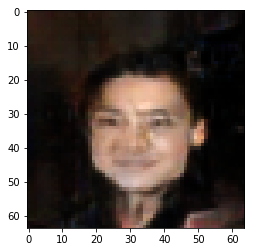

Iteration 1750
Decision 3.473833203315735e-07


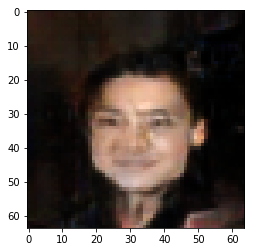

Iteration 2000
Decision 1.955777406692505e-08


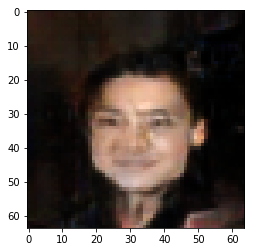

Iteration 0
Decision 8.976218223571777


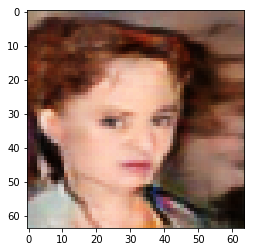

Iteration 250
Decision -7.105991244316101e-07


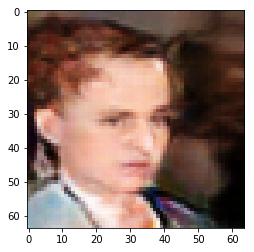

Iteration 500
Decision 4.6566128730773926e-09


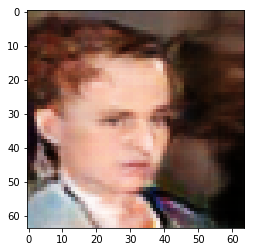

Iteration 750
Decision 4.6566128730773926e-09


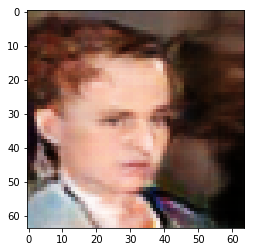

Iteration 1000
Decision 4.6566128730773926e-09


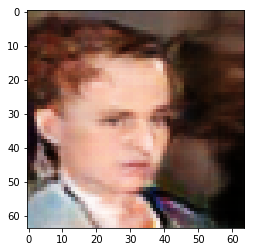

Iteration 1250
Decision 4.6566128730773926e-09


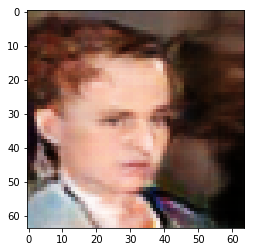

Iteration 1500
Decision 4.6566128730773926e-09


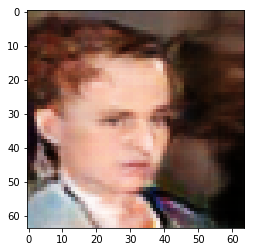

Iteration 1750
Decision 4.6566128730773926e-09


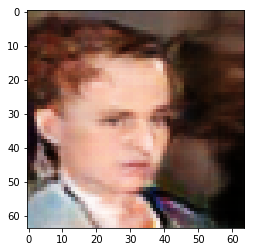

Iteration 2000
Decision 4.6566128730773926e-09


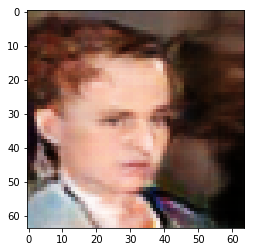

Iteration 0
Decision 2.5520334243774414


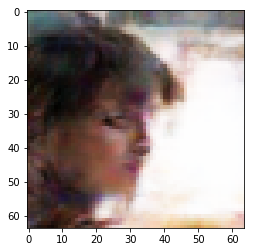

Iteration 250
Decision 4.6836212277412415e-06


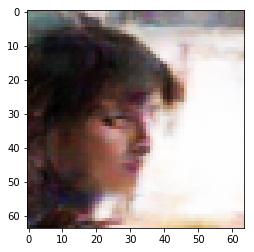

Iteration 500
Decision -1.1278316378593445e-06


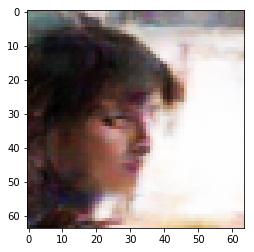

Iteration 750
Decision 7.199123501777649e-07


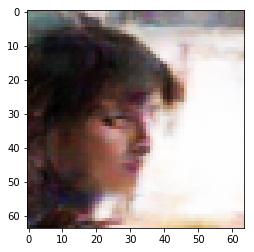

Iteration 1000
Decision 3.9208680391311646e-07


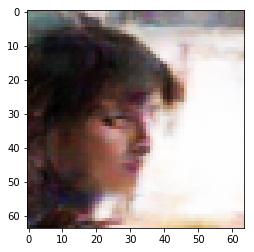

Iteration 1250
Decision 6.30505383014679e-07


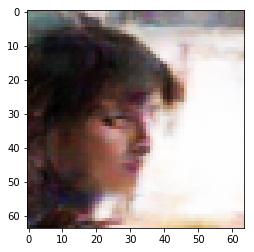

Iteration 1500
Decision 3.059394657611847e-06


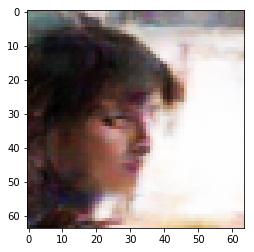

Iteration 1750
Decision -6.807968020439148e-07


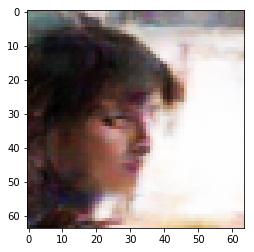

Iteration 2000
Decision -3.228895366191864e-06


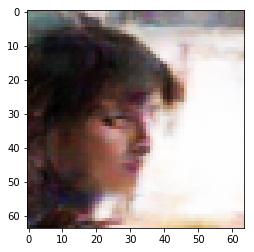

Iteration 0
Decision 6.391272068023682


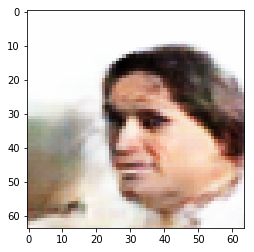

Iteration 250
Decision -2.039596438407898e-07


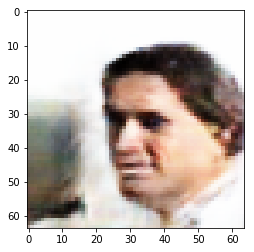

Iteration 500
Decision -2.514570951461792e-08


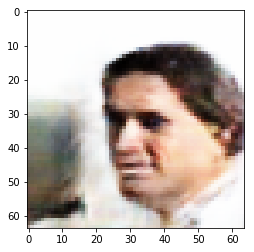

Iteration 750
Decision -2.514570951461792e-08


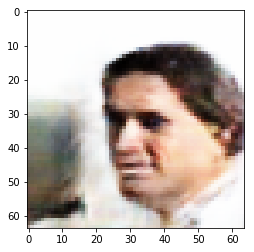

Iteration 1000
Decision -2.514570951461792e-08


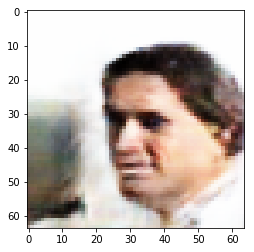

Iteration 1250
Decision -2.514570951461792e-08


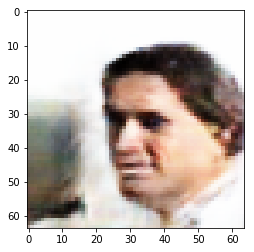

Iteration 1500
Decision 6.901100277900696e-07


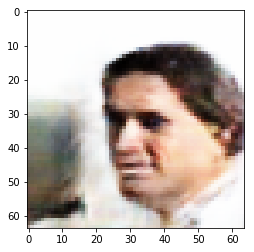

Iteration 1750
Decision -1.4435499906539917e-07


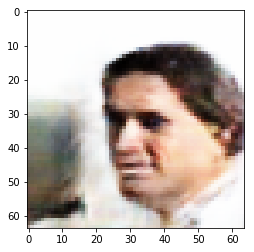

Iteration 2000
Decision 2.180226147174835e-06


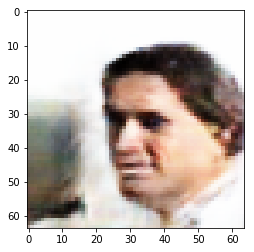

Iteration 0
Decision -9.961710929870605


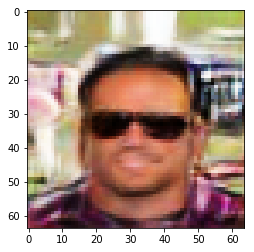

Iteration 250
Decision -5.866400897502899e-06


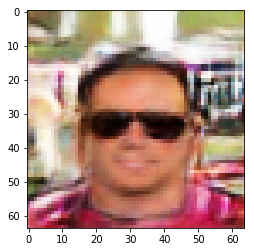

Iteration 500
Decision 2.1327286958694458e-07


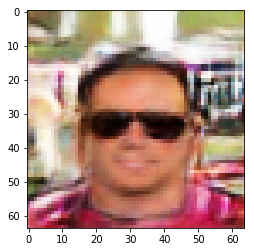

Iteration 750
Decision 5.709007382392883e-07


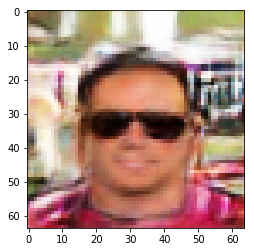

Iteration 1000
Decision -6.211921572685242e-07


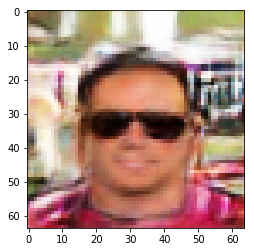

Iteration 1250
Decision -1.4435499906539917e-07


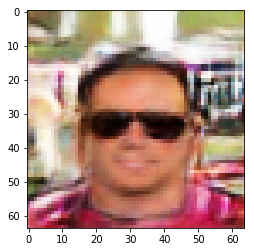

Iteration 1500
Decision 3.3248215913772583e-07


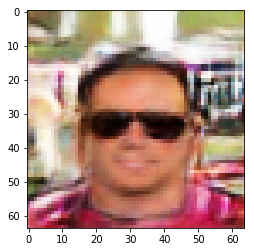

Iteration 1750
Decision -2.2901222109794617e-06


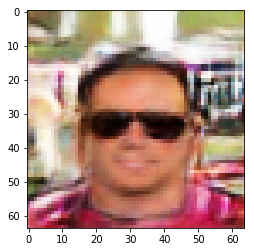

Iteration 2000
Decision 7.008202373981476e-06


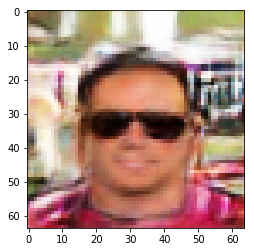

Iteration 0
Decision 6.248237609863281


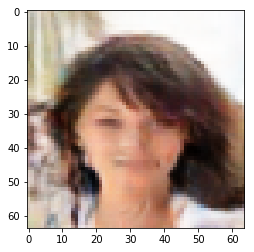

Iteration 250
Decision -8.475035429000854e-08


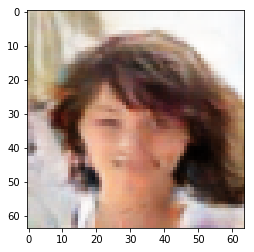

Iteration 500
Decision 1.7629936337471008e-06


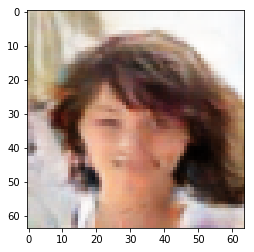

Iteration 750
Decision -1.932494342327118e-06


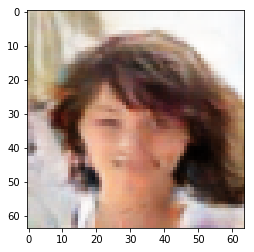

Iteration 1000
Decision 1.9418075680732727e-06


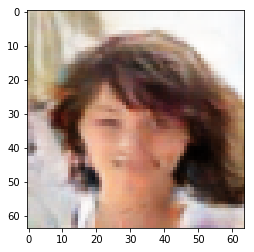

Iteration 1250
Decision -1.2172386050224304e-06


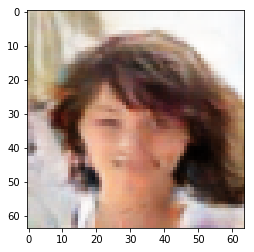

Iteration 1500
Decision 1.4649704098701477e-06


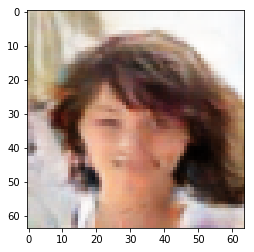

Iteration 1750
Decision -5.019828677177429e-07


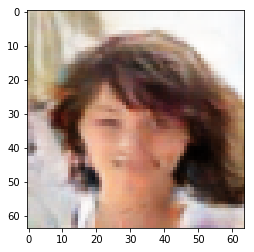

Iteration 2000
Decision 2.716667950153351e-06


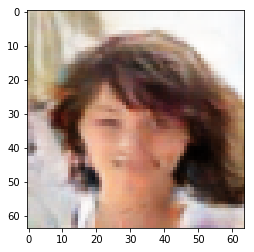

Iteration 0
Decision 6.840982437133789


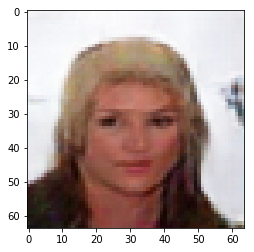

Iteration 250
Decision -1.9622966647148132e-06


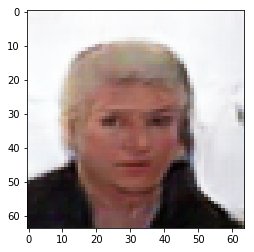

Iteration 500
Decision 6.007030606269836e-07


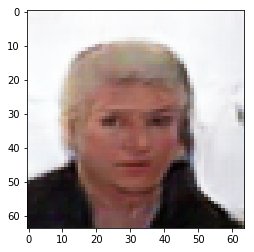

Iteration 750
Decision -3.8277357816696167e-07


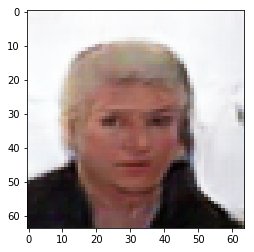

Iteration 1000
Decision 1.4351680874824524e-06


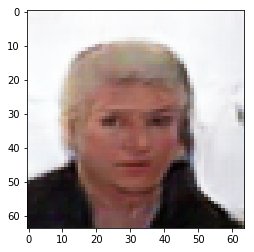

Iteration 1250
Decision -9.490177035331726e-07


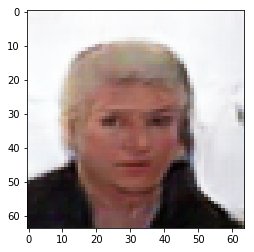

Iteration 1500
Decision -1.9622966647148132e-06


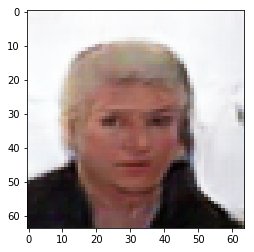

Iteration 1750
Decision -5.913898348808289e-07


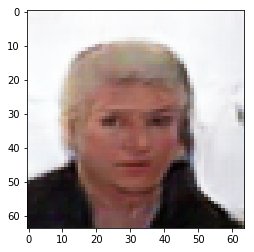

Iteration 2000
Decision 8.391216397285461e-07


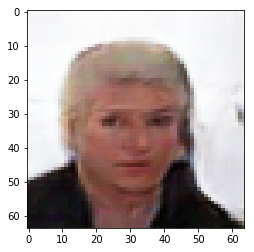

Iteration 0
Decision 11.113240242004395


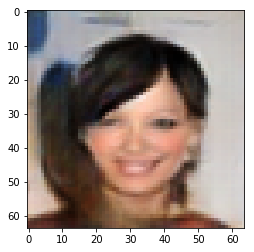

Iteration 250
Decision 1.2116506695747375e-06


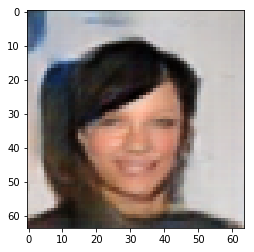

Iteration 500
Decision 5.187466740608215e-07


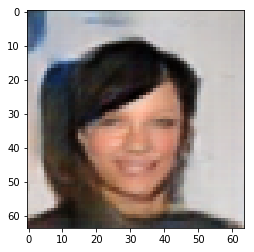

Iteration 750
Decision 6.007030606269836e-07


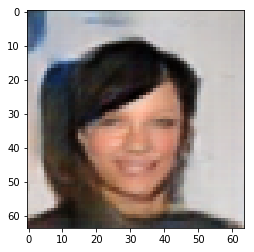

Iteration 1000
Decision -1.0244548320770264e-08


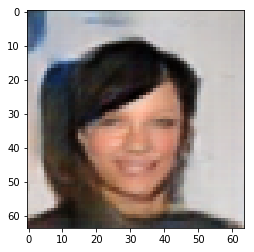

Iteration 1250
Decision 4.190951585769653e-08


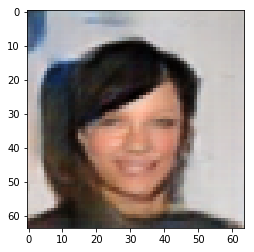

Iteration 1500
Decision -6.73346221446991e-07


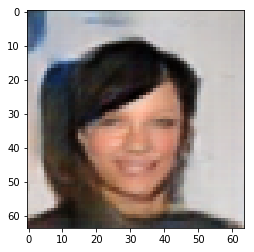

Iteration 1750
Decision 9.406358003616333e-08


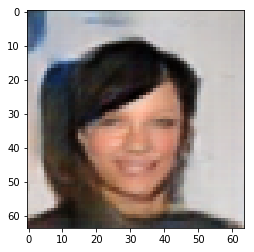

Iteration 2000
Decision 1.8300488591194153e-06


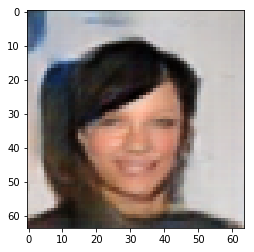

Iteration 0
Decision -6.292384624481201


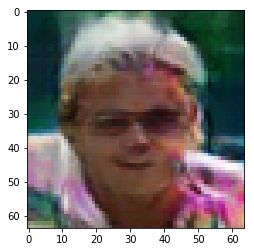

Iteration 250
Decision 2.1327286958694458e-07


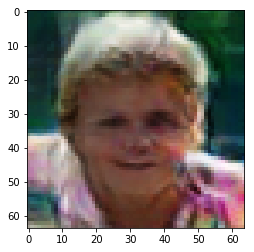

Iteration 500
Decision -1.276843249797821e-06


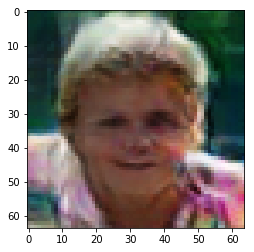

Iteration 750
Decision 3.9208680391311646e-07


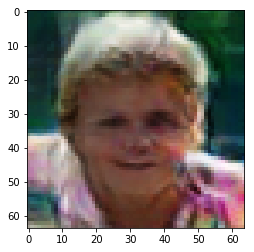

Iteration 1000
Decision 9.406358003616333e-08


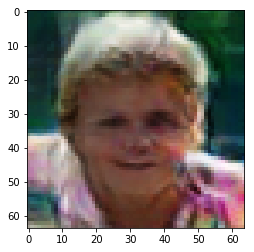

Iteration 1250
Decision -2.635642886161804e-07


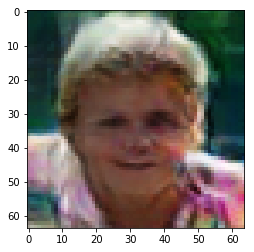

Iteration 1500
Decision -5.019828677177429e-07


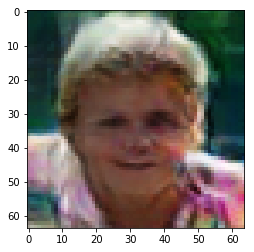

Iteration 1750
Decision 2.061016857624054e-06


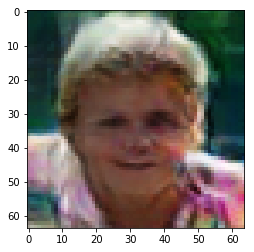

Iteration 2000
Decision 2.1327286958694458e-07


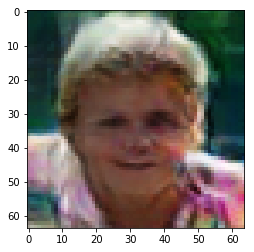

Iteration 0
Decision 14.691720008850098


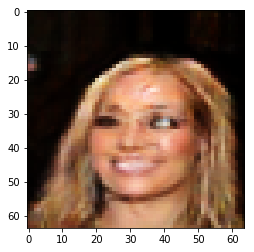

Iteration 250
Decision 0.00013557542115449905


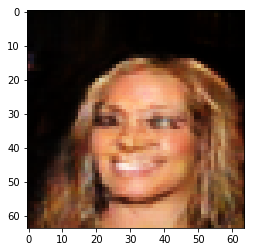

Iteration 500
Decision -8.00006091594696e-07


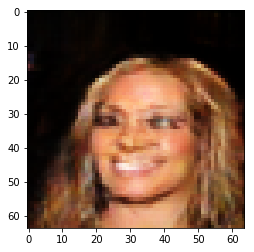

Iteration 750
Decision 4.516914486885071e-07


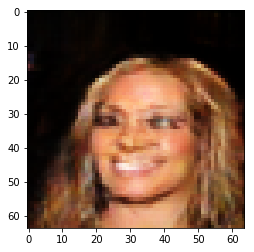

Iteration 1000
Decision 4.516914486885071e-07


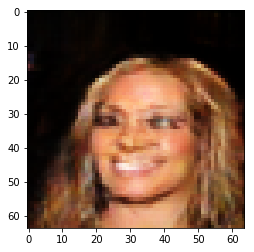

Iteration 1250
Decision 4.516914486885071e-07


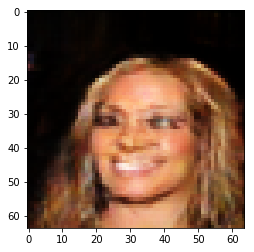

Iteration 1500
Decision -1.0384246706962585e-06


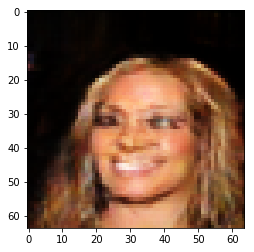

Iteration 1750
Decision -1.0384246706962585e-06


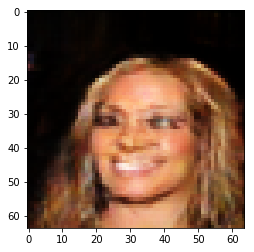

Iteration 2000
Decision -1.0384246706962585e-06


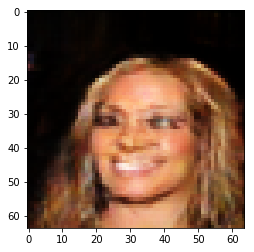

Iteration 0
Decision -12.760452270507812


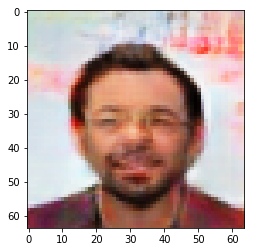

Iteration 250
Decision 1.4756806194782257e-05


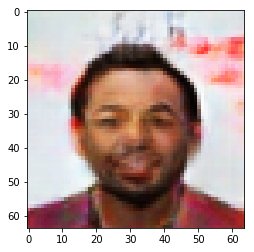

Iteration 500
Decision -1.455657184123993e-06


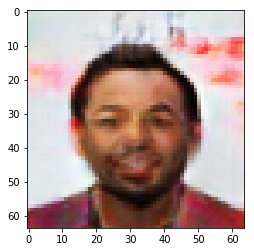

Iteration 750
Decision 9.406358003616333e-08


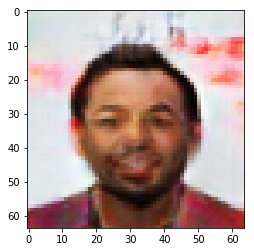

Iteration 1000
Decision 5.709007382392883e-07


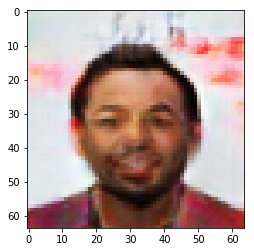

Iteration 1250
Decision 9.406358003616333e-08


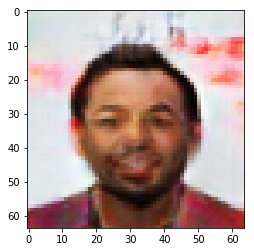

Iteration 1500
Decision -2.514570951461792e-08


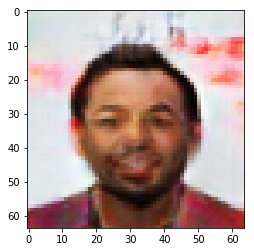

Iteration 1750
Decision -2.514570951461792e-08


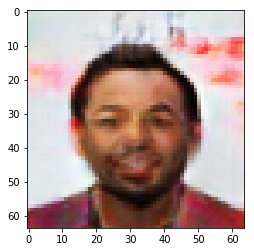

Iteration 2000
Decision -2.514570951461792e-08


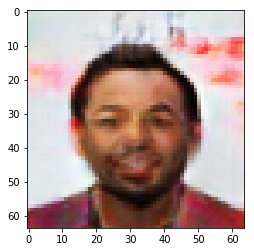

Iteration 0
Decision -8.163705825805664


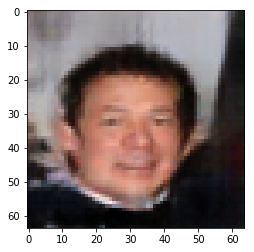

Iteration 250
Decision -1.4407560229301453e-06


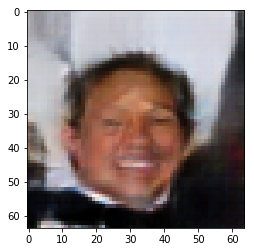

Iteration 500
Decision -4.7497451305389404e-08


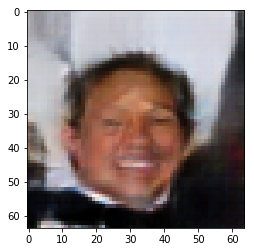

Iteration 750
Decision -4.7497451305389404e-08


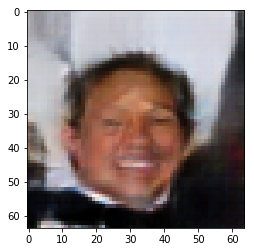

Iteration 1000
Decision -4.7497451305389404e-08


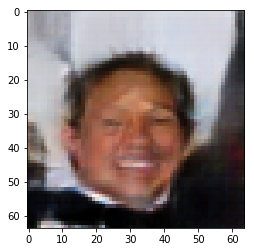

Iteration 1250
Decision -4.7497451305389404e-08


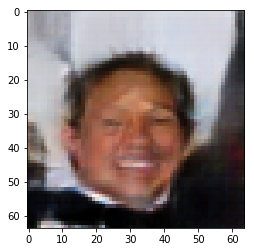

Iteration 1500
Decision -4.7497451305389404e-08


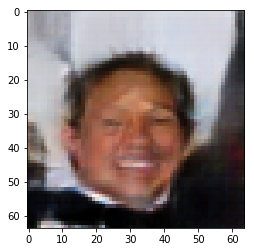

Iteration 1750
Decision 1.909211277961731e-07


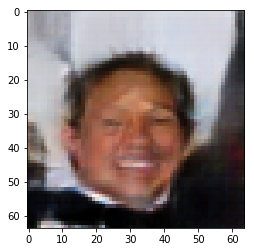

Iteration 2000
Decision -6.984919309616089e-08


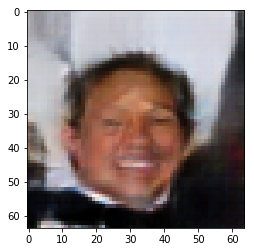

Iteration 0
Decision -15.345515251159668


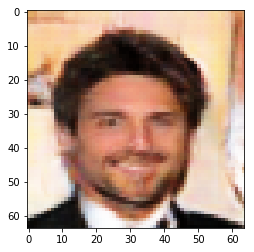

Iteration 250
Decision -7.178913801908493e-05


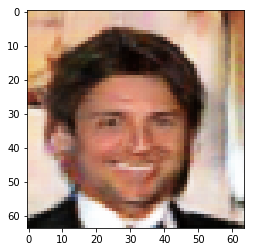

Iteration 500
Decision -2.635642886161804e-07


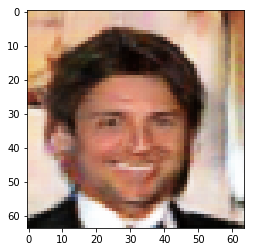

Iteration 750
Decision 4.516914486885071e-07


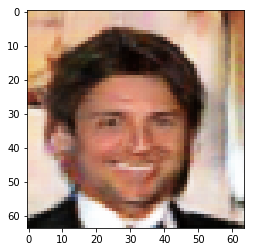

Iteration 1000
Decision 3.9208680391311646e-07


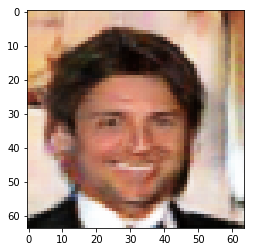

Iteration 1250
Decision -3.8277357816696167e-07


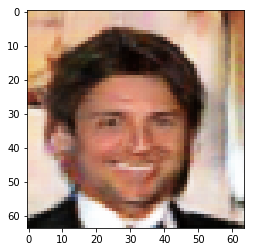

Iteration 1500
Decision 9.406358003616333e-08


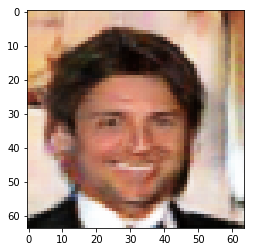

Iteration 1750
Decision 8.093193173408508e-07


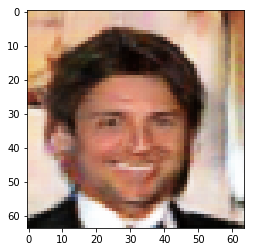

Iteration 2000
Decision 7.497146725654602e-07


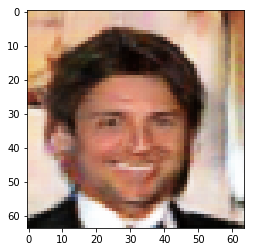

Iteration 0
Decision 6.570705413818359


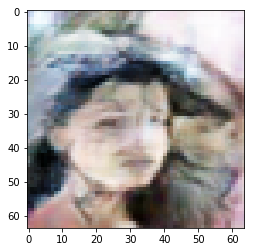

Iteration 250
Decision -3.795139491558075e-06


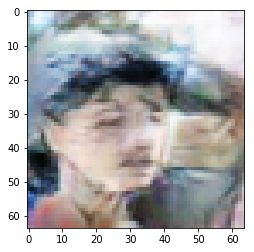

Iteration 500
Decision -7.702037692070007e-07


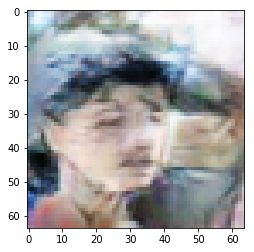

Iteration 750
Decision 5.261972546577454e-07


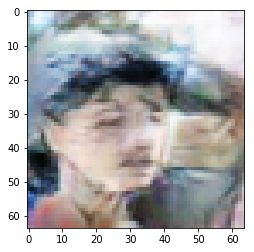

Iteration 1000
Decision 5.261972546577454e-07


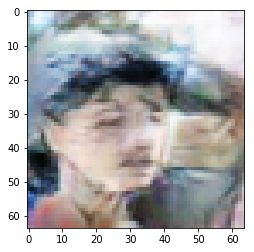

Iteration 1250
Decision 4.6566128730773926e-09


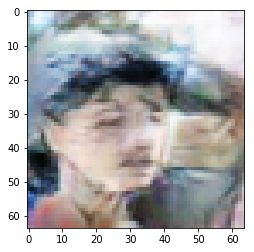

Iteration 1500
Decision 4.6566128730773926e-09


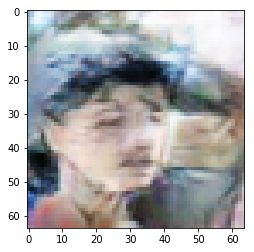

Iteration 1750
Decision 4.6566128730773926e-09


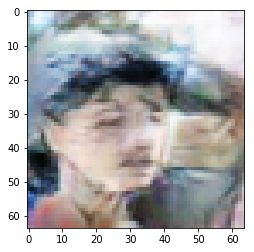

Iteration 2000
Decision 4.6566128730773926e-09


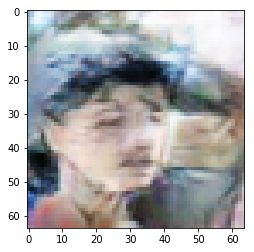

Iteration 0
Decision 2.2347607612609863


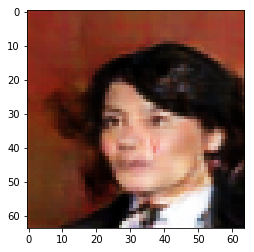

Iteration 250
Decision 8.391216397285461e-07


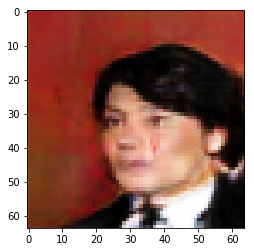

Iteration 500
Decision -1.2470409274101257e-06


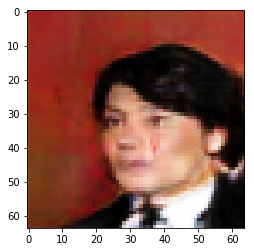

Iteration 750
Decision 2.537854015827179e-06


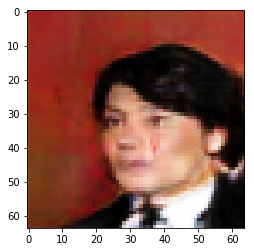

Iteration 1000
Decision -2.6477500796318054e-06


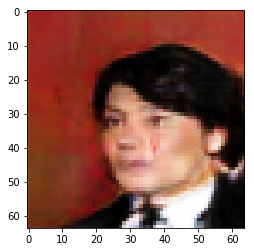

Iteration 1250
Decision -5.615875124931335e-07


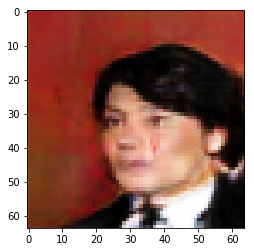

Iteration 1500
Decision 4.2188912630081177e-07


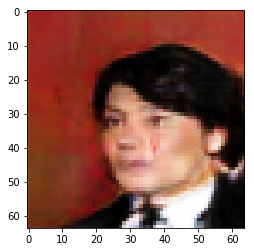

Iteration 1750
Decision -2.409331500530243e-06


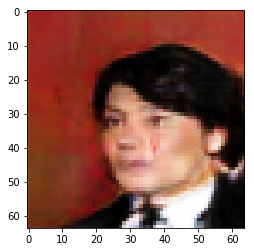

Iteration 2000
Decision 3.6228448152542114e-07


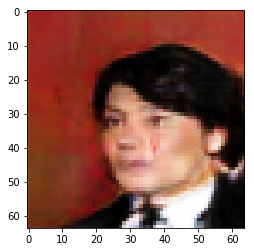

Iteration 0
Decision -11.189766883850098


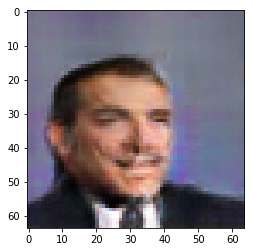

Iteration 250
Decision 1.4500692486763e-06


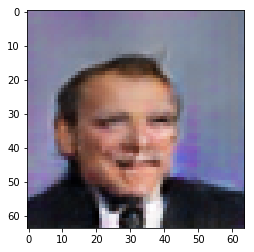

Iteration 500
Decision -5.019828677177429e-07


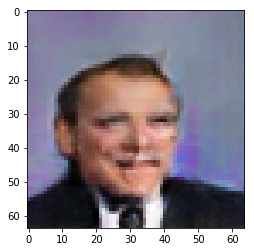

Iteration 750
Decision 5.41098415851593e-07


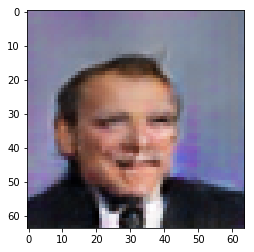

Iteration 1000
Decision -4.0046870708465576e-08


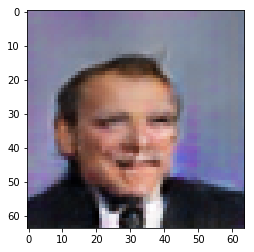

Iteration 1250
Decision -4.0046870708465576e-08


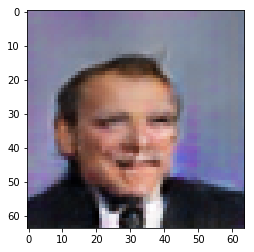

Iteration 1500
Decision -4.0046870708465576e-08


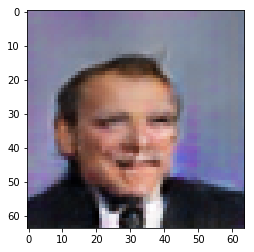

Iteration 1750
Decision -4.0046870708465576e-08


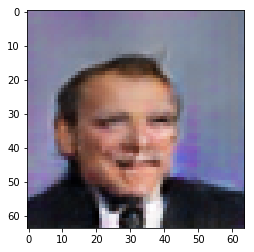

Iteration 2000
Decision -4.0046870708465576e-08


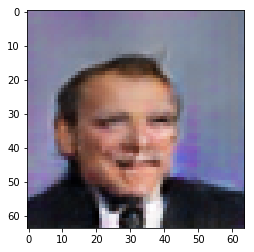

Iteration 0
Decision 10.848904609680176


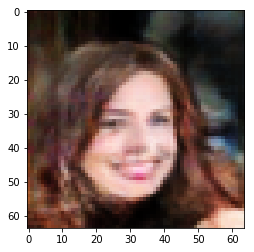

Iteration 250
Decision 6.901100277900696e-07


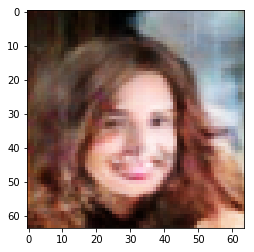

Iteration 500
Decision 1.5366822481155396e-07


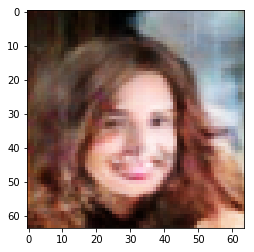

Iteration 750
Decision 1.5366822481155396e-07


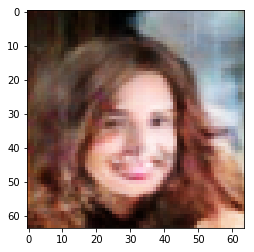

Iteration 1000
Decision -2.039596438407898e-07


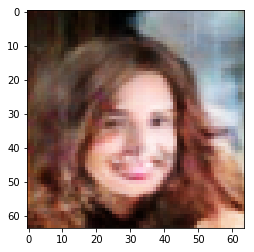

Iteration 1250
Decision -2.039596438407898e-07


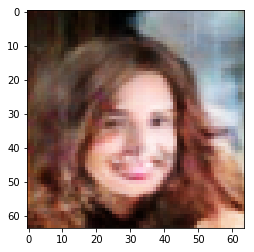

Iteration 1500
Decision 1.5366822481155396e-07


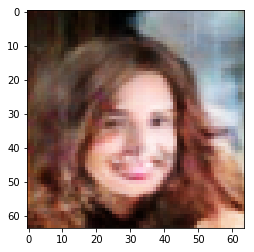

Iteration 1750
Decision 1.5366822481155396e-07


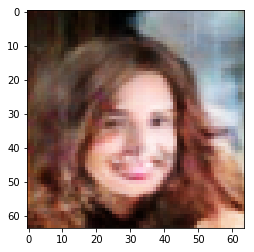

Iteration 2000
Decision 1.5366822481155396e-07


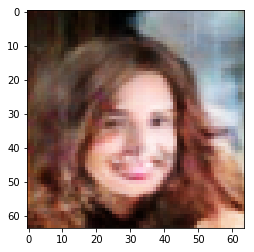

Iteration 0
Decision 8.529513359069824


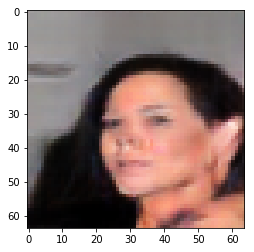

Iteration 250
Decision -1.4435499906539917e-07


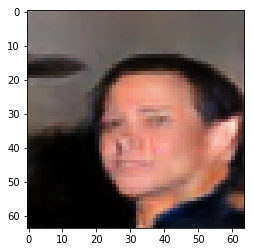

Iteration 500
Decision 5.709007382392883e-07


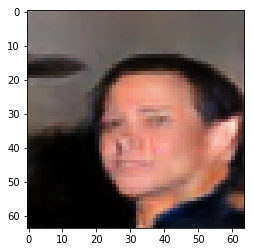

Iteration 750
Decision 3.9208680391311646e-07


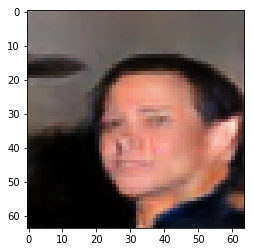

Iteration 1000
Decision -1.9920989871025085e-06


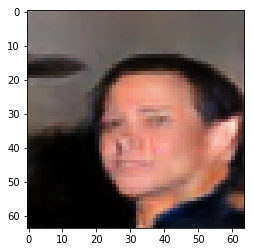

Iteration 1250
Decision 1.5366822481155396e-07


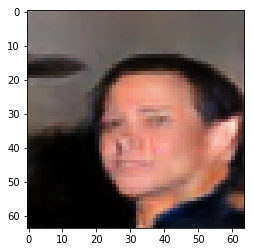

Iteration 1500
Decision 5.709007382392883e-07


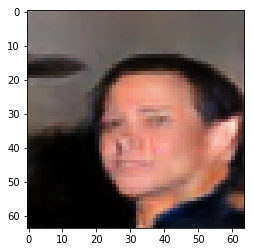

Iteration 1750
Decision 5.709007382392883e-07


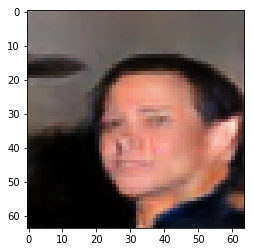

Iteration 2000
Decision 2.728775143623352e-07


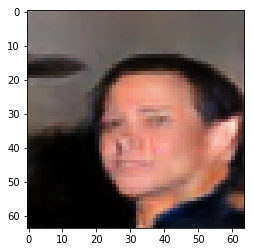

Iteration 0
Decision -5.811531066894531


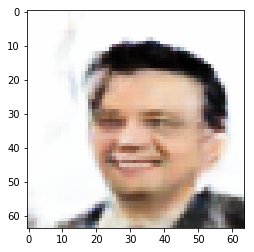

Iteration 250
Decision -1.5152618288993835e-06


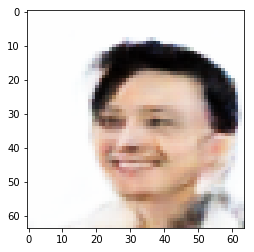

Iteration 500
Decision -1.8728896975517273e-06


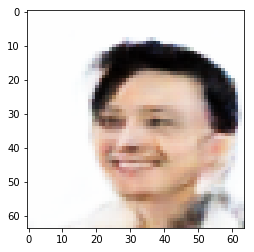

Iteration 750
Decision 7.497146725654602e-07


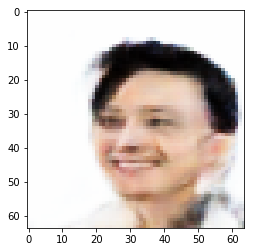

Iteration 1000
Decision 2.2994354367256165e-06


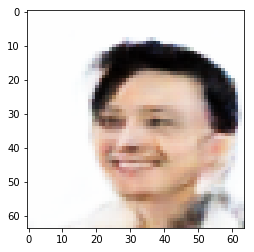

Iteration 1250
Decision 3.908760845661163e-06


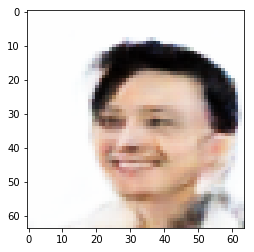

Iteration 1500
Decision 1.4649704098701477e-06


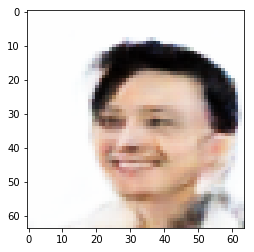

Iteration 1750
Decision 4.862435162067413e-06


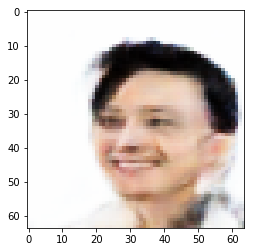

Iteration 2000
Decision 5.1604583859443665e-06


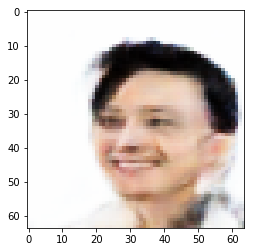

Iteration 0
Decision -1.0238341093063354


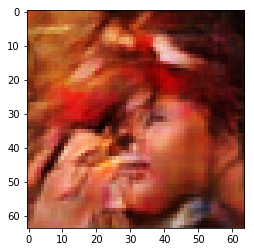

Iteration 250
Decision 6.292946636676788e-06


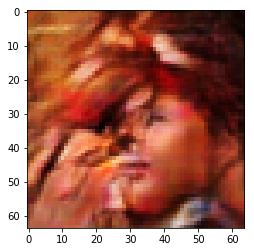

Iteration 500
Decision -1.1290423572063446e-05


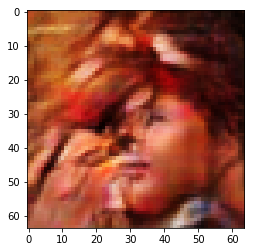

Iteration 750
Decision -3.072153776884079e-05


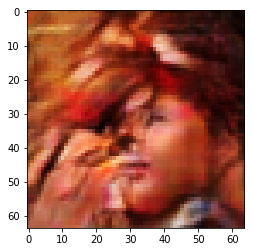

Iteration 1000
Decision -3.9781443774700165e-05


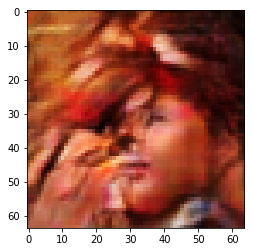

Iteration 1250
Decision 3.2531097531318665e-06


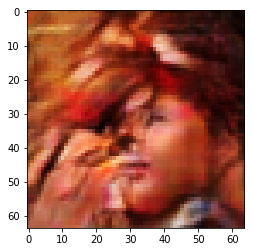

Iteration 1500
Decision 2.420414239168167e-05


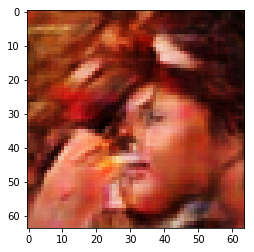

Iteration 1750
Decision -4.423782229423523e-07


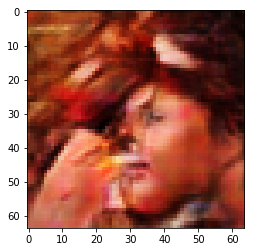

Iteration 2000
Decision -8.608214557170868e-06


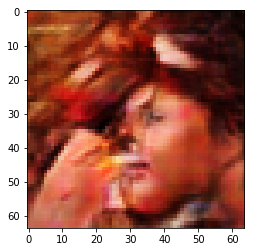

Iteration 0
Decision 2.364475727081299


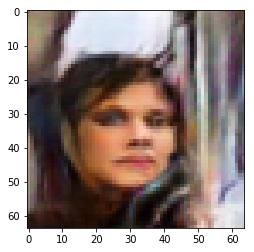

Iteration 250
Decision -6.164424121379852e-06


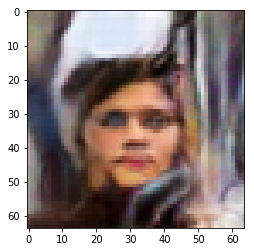

Iteration 500
Decision 2.0374543964862823e-05


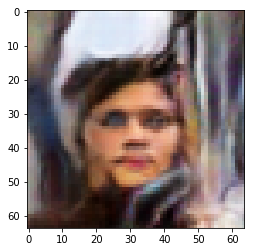

Iteration 750
Decision 8.624978363513947e-06


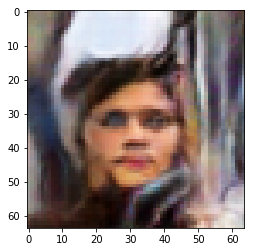

Iteration 1000
Decision 0.000241902656853199


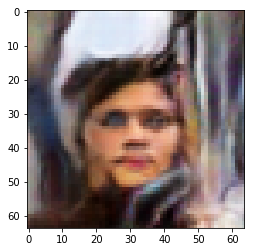

Iteration 1250
Decision 0.005860877223312855


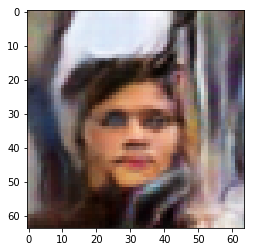

Iteration 1500
Decision 7.924623787403107e-06


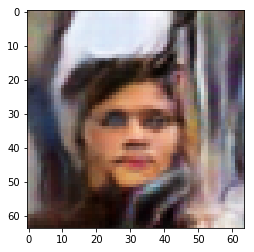

Iteration 1750
Decision -9.167008101940155e-06


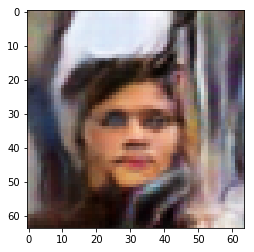

Iteration 2000
Decision -0.0004634065553545952


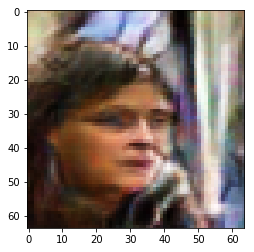

Iteration 0
Decision 5.337123870849609


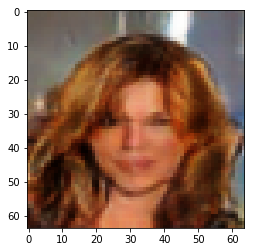

Iteration 250
Decision 6.30505383014679e-07


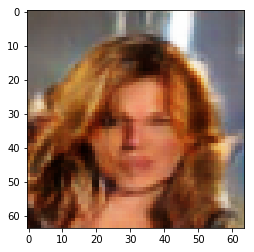

Iteration 500
Decision -2.337619662284851e-07


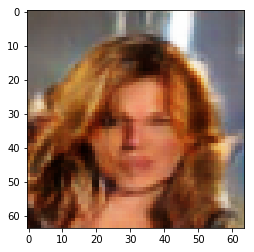

Iteration 750
Decision 4.6566128730773926e-09


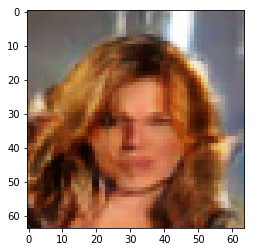

Iteration 1000
Decision 4.6566128730773926e-09


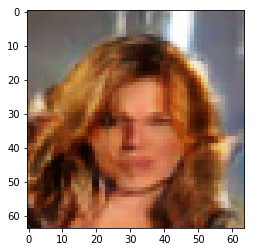

Iteration 1250
Decision 4.6566128730773926e-09


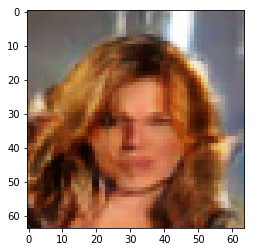

Iteration 1500
Decision 4.6566128730773926e-09


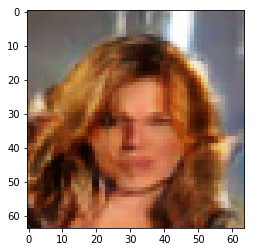

Iteration 1750
Decision 4.6566128730773926e-09


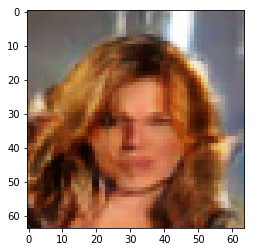

Iteration 2000
Decision 4.6566128730773926e-09


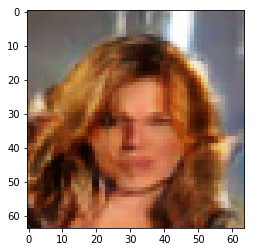

Iteration 0
Decision -0.6468010544776917


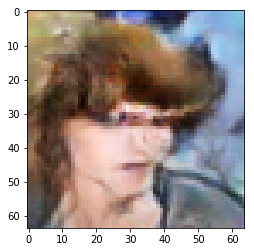

Iteration 250
Decision 2.224929630756378e-06


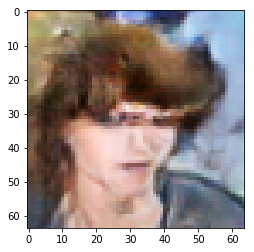

Iteration 500
Decision 3.819353878498077e-06


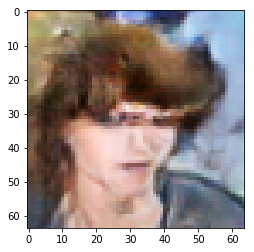

Iteration 750
Decision 2.3739412426948547e-06


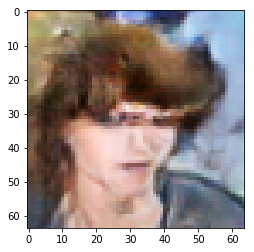

Iteration 1000
Decision -3.6461278796195984e-06


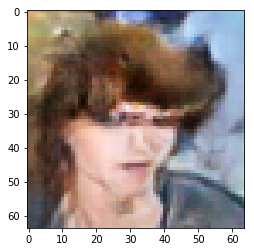

Iteration 1250
Decision -3.884546458721161e-06


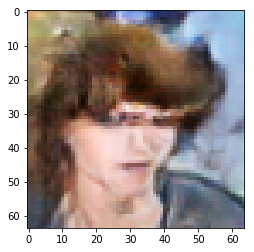

Iteration 1500
Decision 5.670357495546341e-05


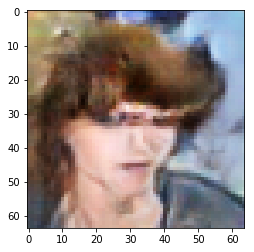

Iteration 1750
Decision -3.526918590068817e-06


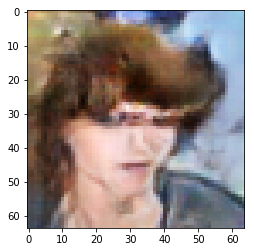

Iteration 2000
Decision 0.00413291621953249


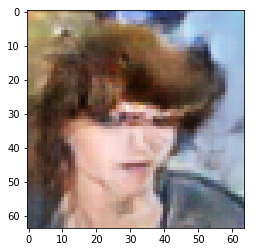

Iteration 0
Decision -6.041661262512207


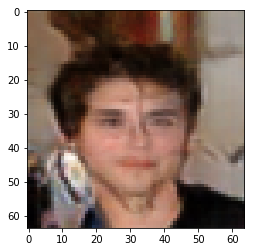

Iteration 250
Decision 3.0668452382087708e-06


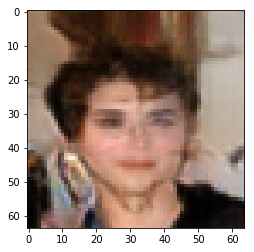

Iteration 500
Decision 9.313225746154785e-10


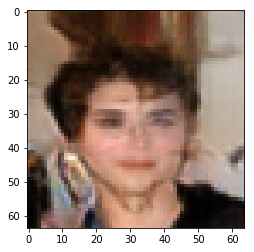

Iteration 750
Decision 9.313225746154785e-10


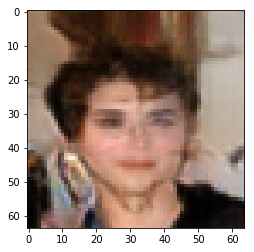

Iteration 1000
Decision 9.313225746154785e-10


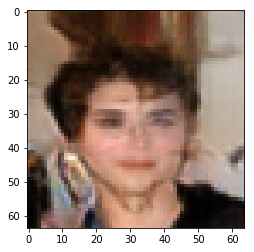

Iteration 1250
Decision 9.313225746154785e-10


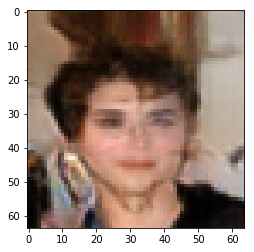

Iteration 1500
Decision 9.313225746154785e-10


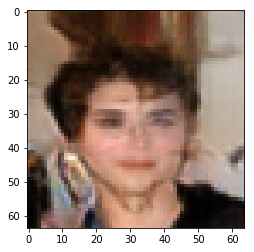

Iteration 1750
Decision 9.313225746154785e-10


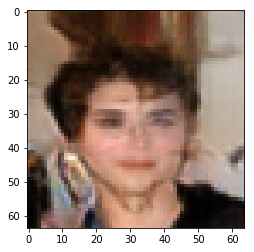

Iteration 2000
Decision 9.313225746154785e-10


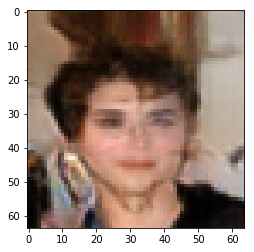

Iteration 0
Decision 2.1206624507904053


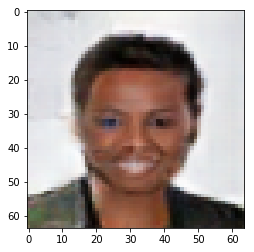

Iteration 250
Decision -2.4391338229179382e-06


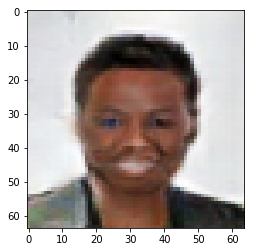

Iteration 500
Decision 1.882202923297882e-06


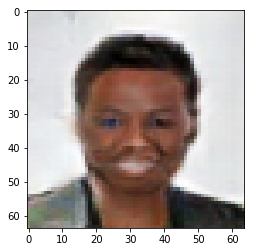

Iteration 750
Decision 2.2100284695625305e-06


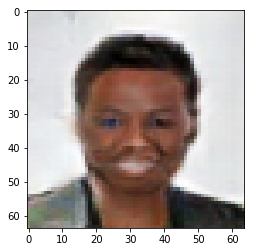

Iteration 1000
Decision 4.355795681476593e-06


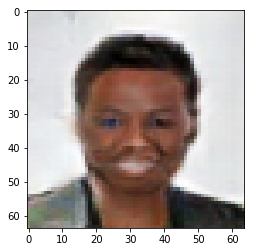

Iteration 1250
Decision 2.7762725949287415e-06


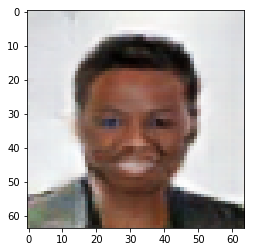

Iteration 1500
Decision -2.039596438407898e-07


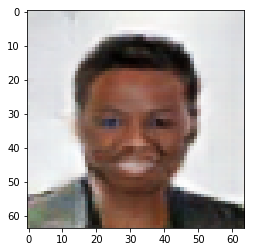

Iteration 1750
Decision -8.00006091594696e-07


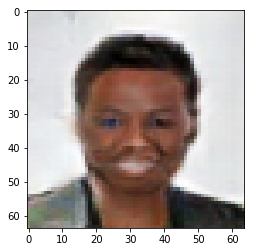

Iteration 2000
Decision -1.4435499906539917e-07


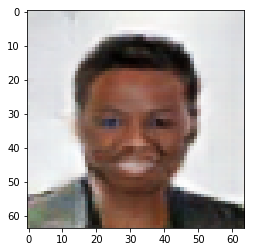

Iteration 0
Decision 1.758915901184082


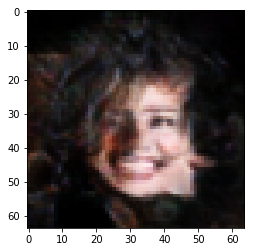

Iteration 250
Decision -1.0682269930839539e-06


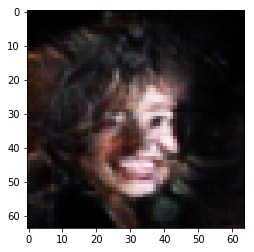

Iteration 500
Decision 6.007030606269836e-07


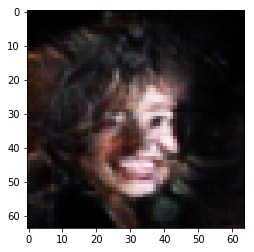

Iteration 750
Decision -2.9159709811210632e-06


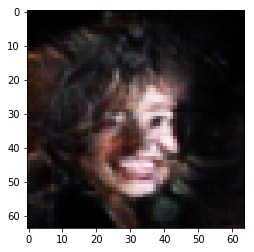

Iteration 1000
Decision -1.5450641512870789e-06


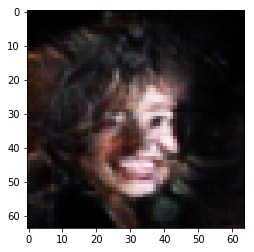

Iteration 1250
Decision 1.5904195606708527e-05


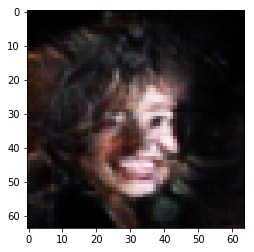

Iteration 1500
Decision 1.816917210817337e-05


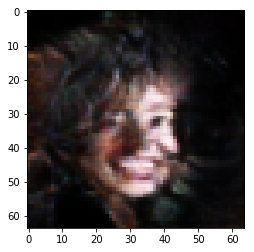

Iteration 1750
Decision -5.009304732084274e-05


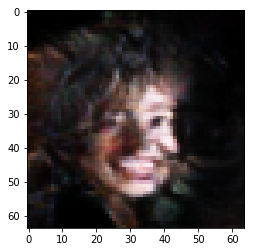

Iteration 2000
Decision -2.9559247195720673e-05


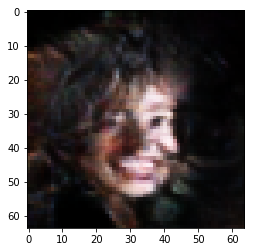

Iteration 0
Decision -14.206276893615723


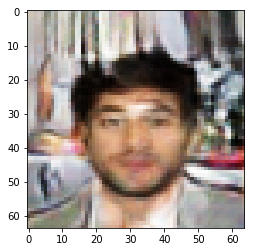

Iteration 250
Decision 5.100853741168976e-06


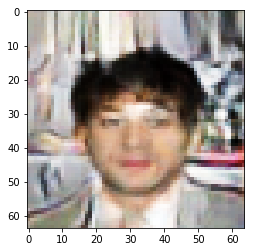

Iteration 500
Decision -2.039596438407898e-07


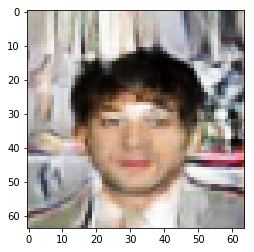

Iteration 750
Decision 5.112960934638977e-07


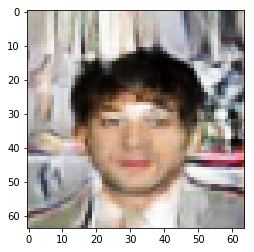

Iteration 1000
Decision -2.039596438407898e-07


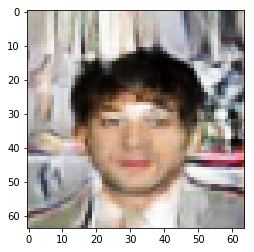

Iteration 1250
Decision -2.039596438407898e-07


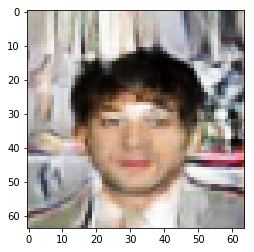

Iteration 1500
Decision 5.112960934638977e-07


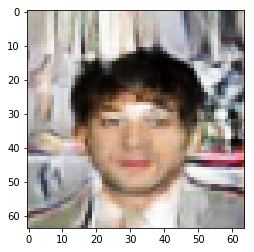

Iteration 1750
Decision -3.8277357816696167e-07


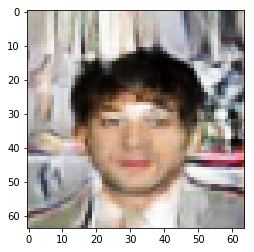

Iteration 2000
Decision -3.8277357816696167e-07


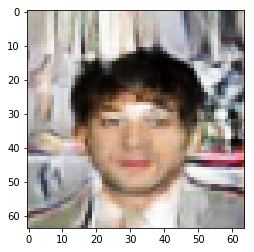

Iteration 0
Decision 3.0170681476593018


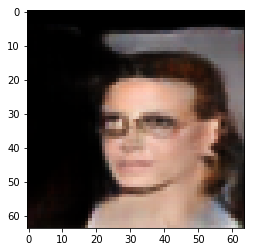

Iteration 250
Decision -2.707354724407196e-06


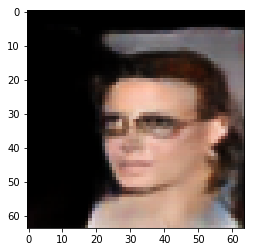

Iteration 500
Decision -3.1543895602226257e-06


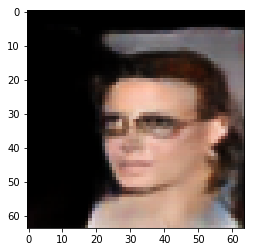

Iteration 750
Decision -2.5583431124687195e-06


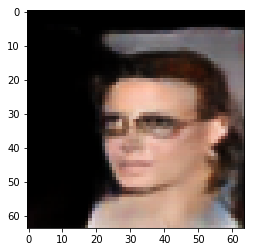

Iteration 1000
Decision 1.5543773770332336e-06


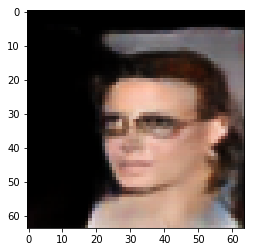

Iteration 1250
Decision 4.892237484455109e-06


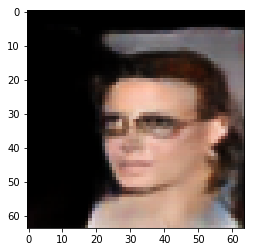

Iteration 1500
Decision 1.3457611203193665e-06


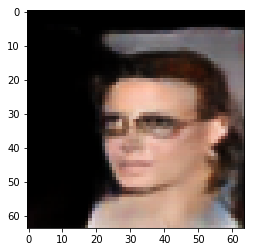

Iteration 1750
Decision -1.5450641512870789e-06


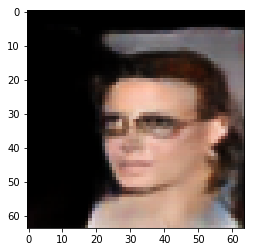

Iteration 2000
Decision -2.0815059542655945e-06


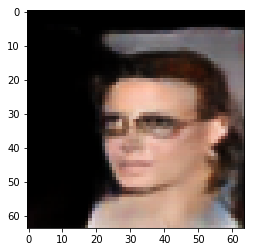

Iteration 0
Decision 7.040425777435303


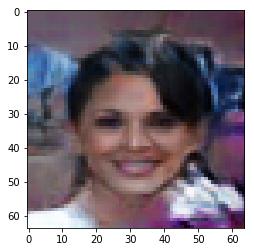

Iteration 250
Decision -5.657784640789032e-06


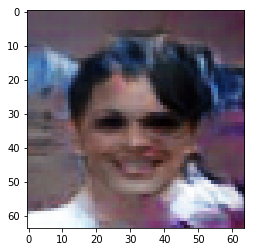

Iteration 500
Decision -3.5297125577926636e-07


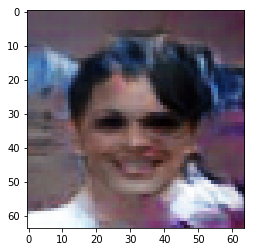

Iteration 750
Decision 9.406358003616333e-08


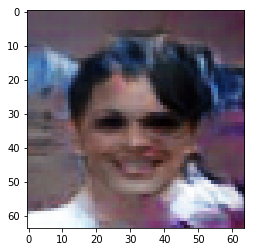

Iteration 1000
Decision 9.406358003616333e-08


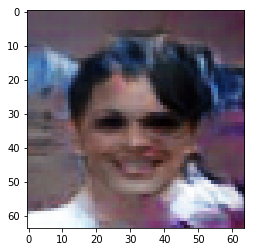

Iteration 1250
Decision -1.9622966647148132e-06


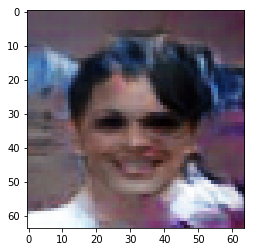

Iteration 1500
Decision -1.3066455721855164e-06


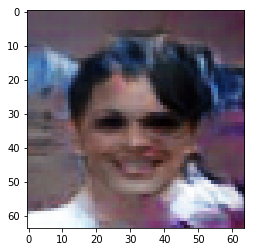

Iteration 1750
Decision -2.6477500796318054e-06


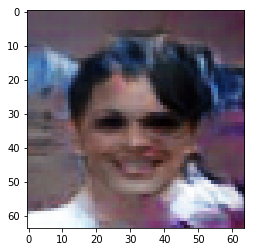

Iteration 2000
Decision -2.039596438407898e-07


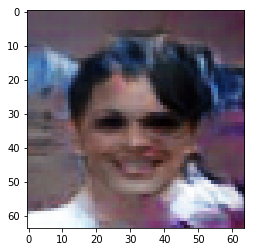

Iteration 0
Decision 5.367910385131836


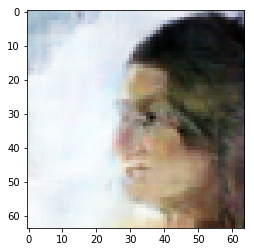

Iteration 250
Decision 5.153007805347443e-06


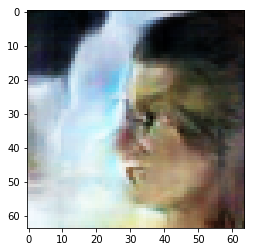

Iteration 500
Decision -4.3492764234542847e-07


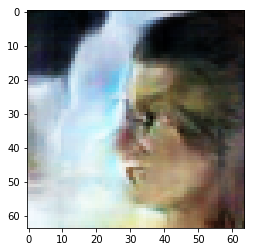

Iteration 750
Decision 7.171183824539185e-08


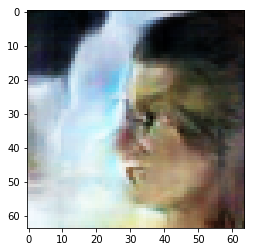

Iteration 1000
Decision 7.171183824539185e-08


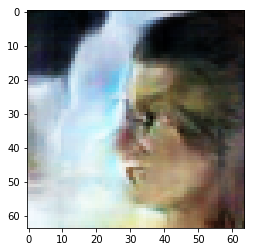

Iteration 1250
Decision -4.12575900554657e-07


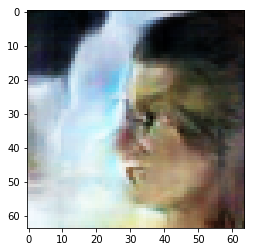

Iteration 1500
Decision -1.2917444109916687e-06


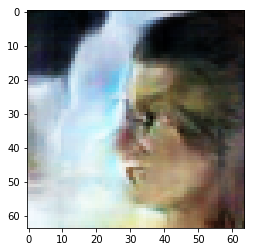

Iteration 1750
Decision -1.2246891856193542e-06


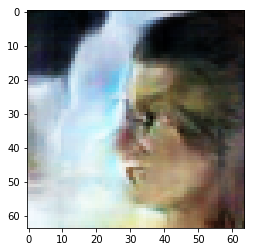

Iteration 2000
Decision -4.12575900554657e-07


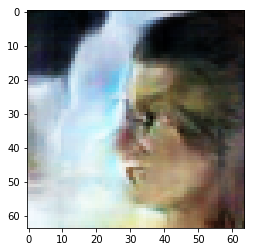

Iteration 0
Decision -2.366132974624634


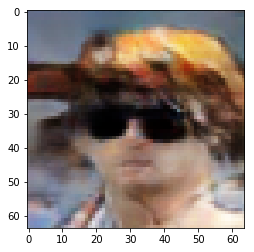

Iteration 250
Decision -7.404014468193054e-07


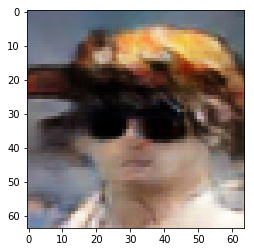

Iteration 500
Decision -2.635642886161804e-07


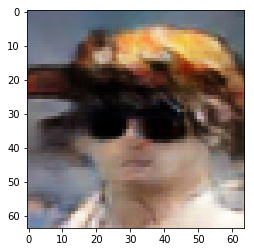

Iteration 750
Decision 5.709007382392883e-07


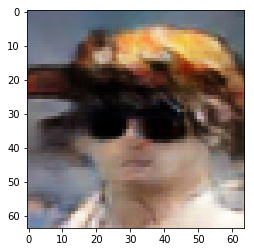

Iteration 1000
Decision -5.615875124931335e-07


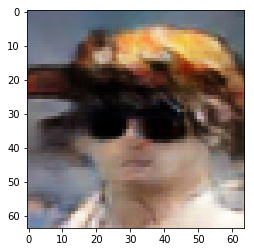

Iteration 1250
Decision 4.516914486885071e-07


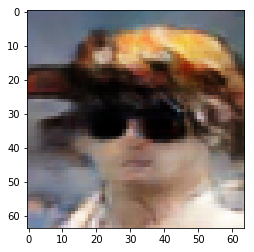

Iteration 1500
Decision -3.363005816936493e-06


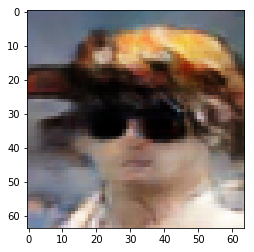

Iteration 1750
Decision 1.405365765094757e-06


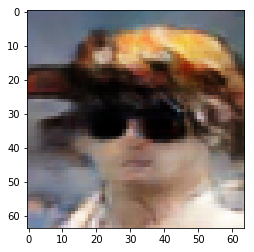

Iteration 2000
Decision -1.1576339602470398e-06


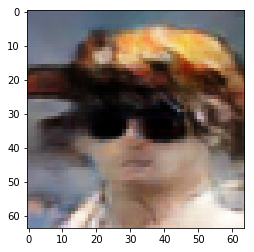

Iteration 0
Decision 9.829742431640625


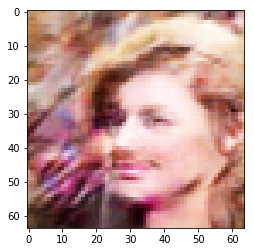

Iteration 250
Decision 9.881332516670227e-07


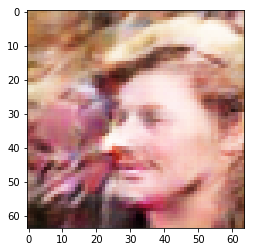

Iteration 500
Decision -1.6344711184501648e-06


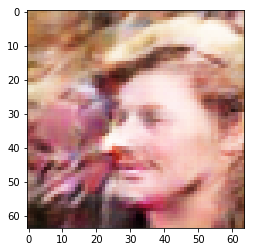

Iteration 750
Decision 1.7033889889717102e-06


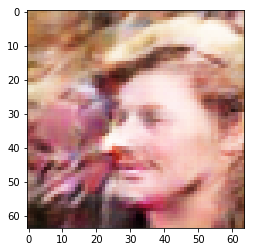

Iteration 1000
Decision -2.514570951461792e-08


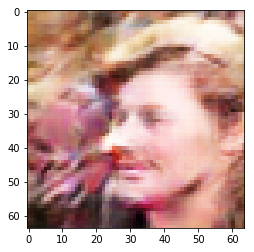

Iteration 1250
Decision -2.514570951461792e-08


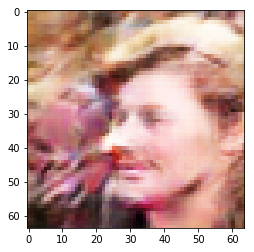

Iteration 1500
Decision -7.404014468193054e-07


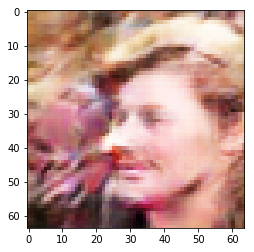

Iteration 1750
Decision 2.728775143623352e-07


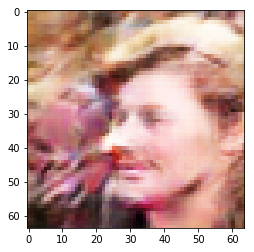

Iteration 2000
Decision 2.728775143623352e-07


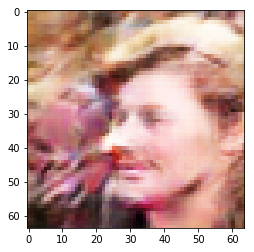

Iteration 0
Decision 12.865554809570312


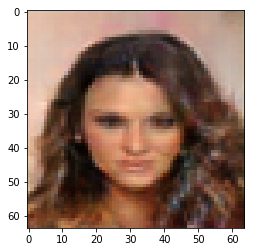

Iteration 250
Decision 0.028781522065401077


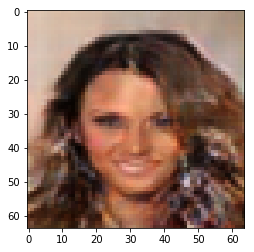

Iteration 500
Decision 1.2685544788837433e-05


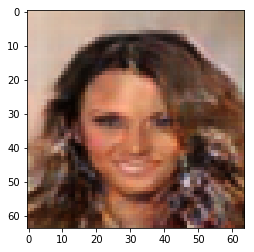

Iteration 750
Decision 1.5767291188240051e-06


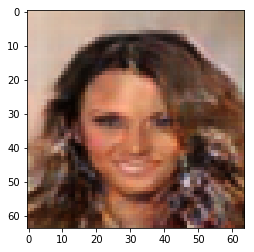

Iteration 1000
Decision -3.082677721977234e-07


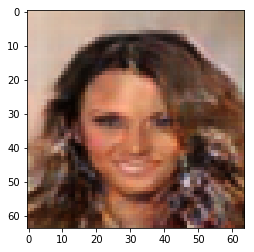

Iteration 1250
Decision 1.685693860054016e-07


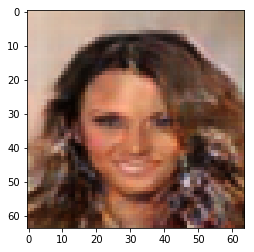

Iteration 1500
Decision -3.082677721977234e-07


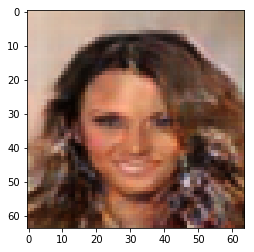

Iteration 1750
Decision -3.082677721977234e-07


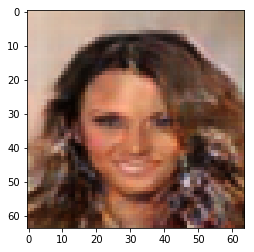

Iteration 2000
Decision 1.685693860054016e-07


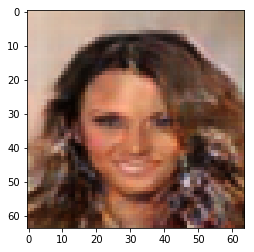

Iteration 0
Decision 1.8181904554367065


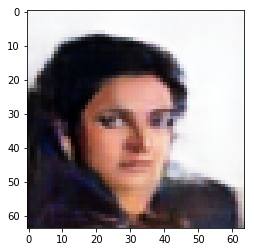

Iteration 250
Decision -1.9622966647148132e-06


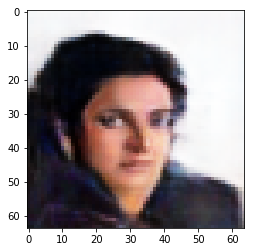

Iteration 500
Decision 3.133900463581085e-06


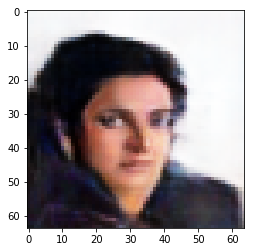

Iteration 750
Decision -2.707354724407196e-06


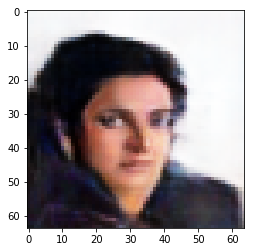

Iteration 1000
Decision 9.583309292793274e-07


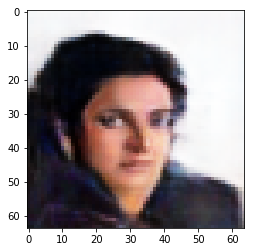

Iteration 1250
Decision -3.5120174288749695e-06


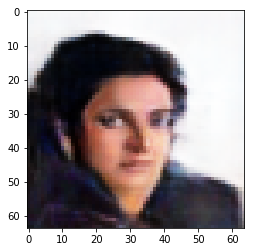

Iteration 1500
Decision -9.490177035331726e-07


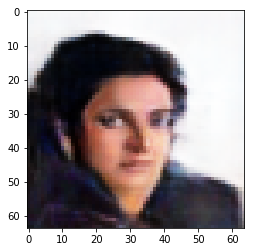

Iteration 1750
Decision -3.7802383303642273e-06


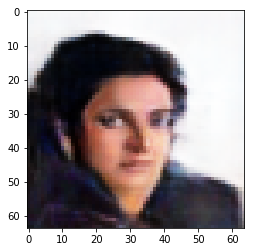

Iteration 2000
Decision -2.528540790081024e-06


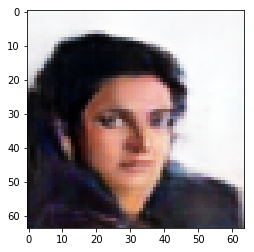

Iteration 0
Decision 10.84095573425293


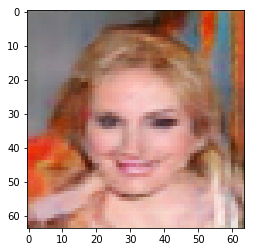

Iteration 250
Decision -3.8277357816696167e-07


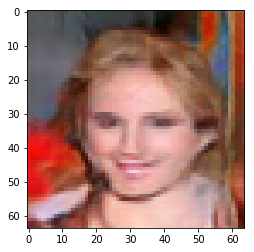

Iteration 500
Decision -4.12575900554657e-07


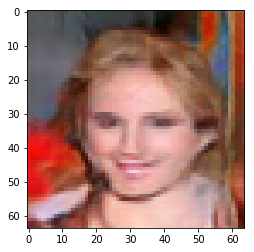

Iteration 750
Decision -4.12575900554657e-07


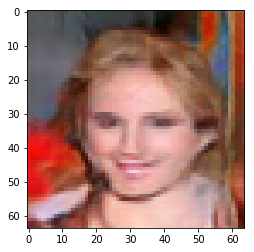

Iteration 1000
Decision 2.430751919746399e-07


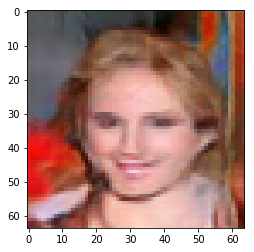

Iteration 1250
Decision -1.4258548617362976e-06


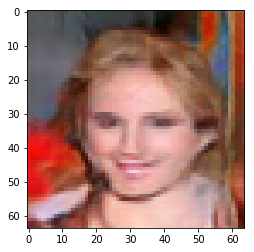

Iteration 1500
Decision -5.913898348808289e-07


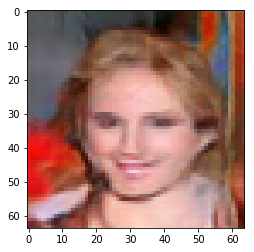

Iteration 1750
Decision -1.6940757632255554e-06


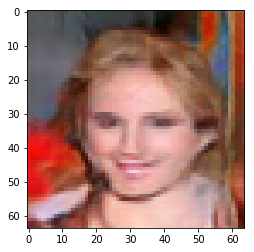

Iteration 2000
Decision 3.026798367500305e-07


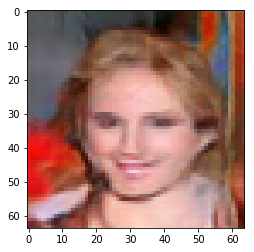

Iteration 0
Decision 6.810417175292969


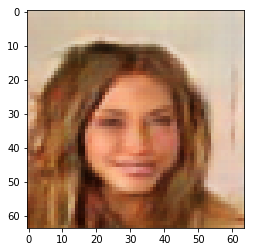

Iteration 250
Decision -1.2945383787155151e-07


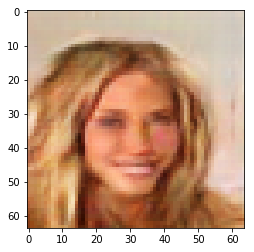

Iteration 500
Decision 6.603077054023743e-07


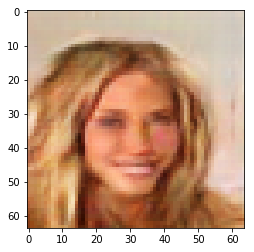

Iteration 750
Decision -3.380700945854187e-07


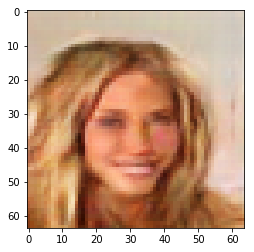

Iteration 1000
Decision 1.387670636177063e-07


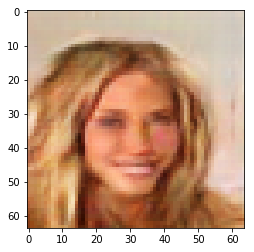

Iteration 1250
Decision 1.0477378964424133e-06


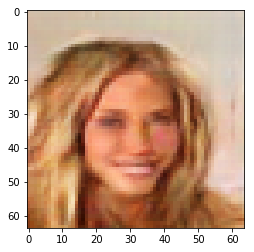

Iteration 1500
Decision -4.12575900554657e-07


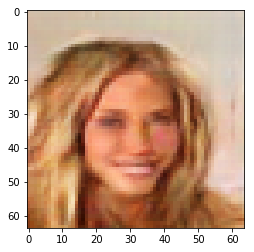

Iteration 1750
Decision 2.3292377591133118e-06


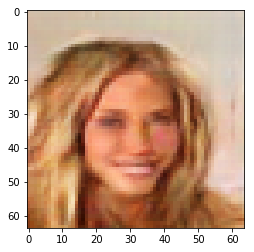

Iteration 2000
Decision -7.255002856254578e-07


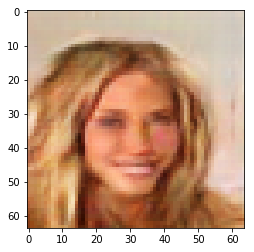

Iteration 0
Decision -2.9003243446350098


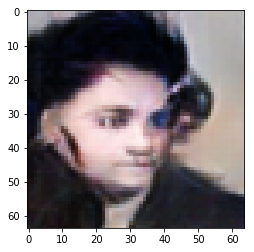

Iteration 250
Decision -2.1150335669517517e-06


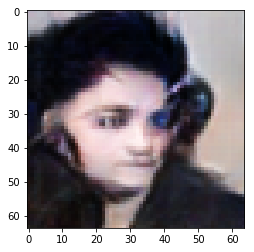

Iteration 500
Decision 4.10713255405426e-07


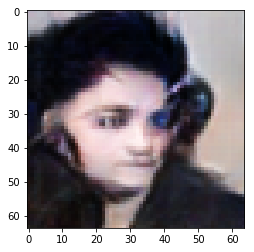

Iteration 750
Decision -1.887790858745575e-06


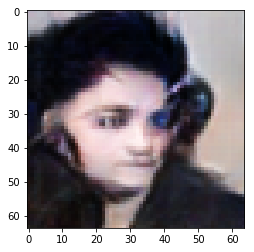

Iteration 1000
Decision -1.671724021434784e-06


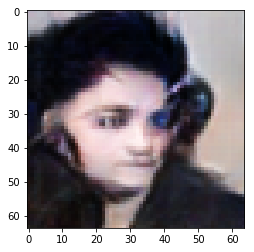

Iteration 1250
Decision 4.48618084192276e-06


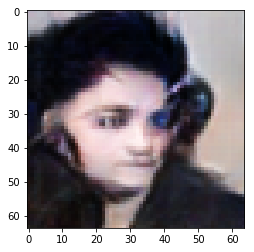

Iteration 1500
Decision -1.1427327990531921e-06


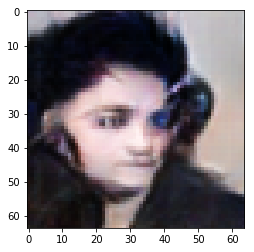

Iteration 1750
Decision -8.847564458847046e-08


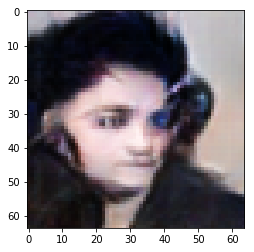

Iteration 2000
Decision -2.495013177394867e-06


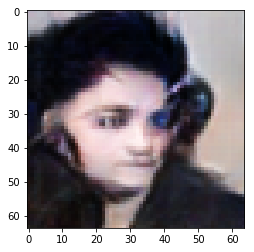

Iteration 0
Decision 0.7162958979606628


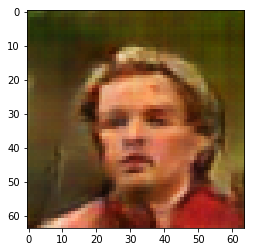

Iteration 250
Decision 1.2116506695747375e-06


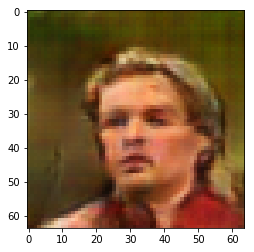

Iteration 500
Decision -8.295290172100067e-06


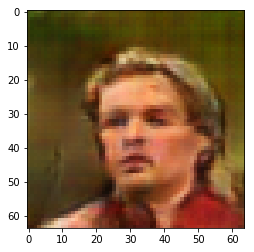

Iteration 750
Decision -3.2437965273857117e-06


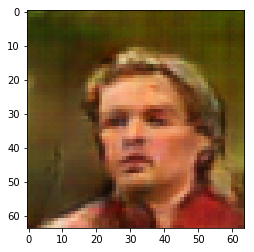

Iteration 1000
Decision -1.2042932212352753e-05


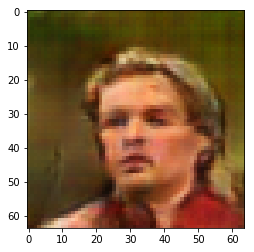

Iteration 1250
Decision 1.3457611203193665e-06


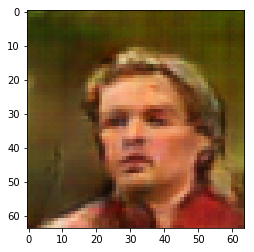

Iteration 1500
Decision 2.1206215023994446e-06


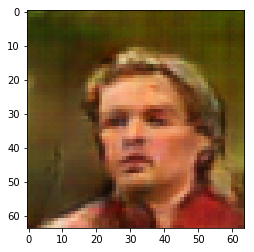

Iteration 1750
Decision 5.6345947086811066e-05


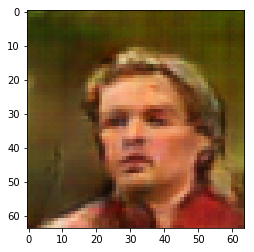

Iteration 2000
Decision 0.025151807814836502


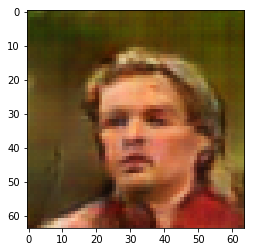

Iteration 0
Decision 0.44982030987739563


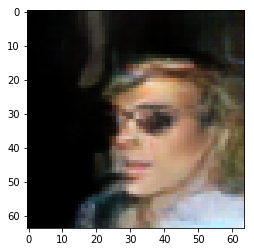

Iteration 250
Decision 6.41215592622757e-06


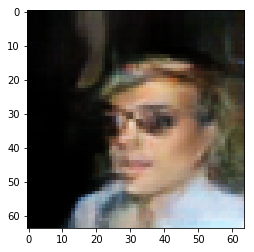

Iteration 500
Decision -2.2156164050102234e-06


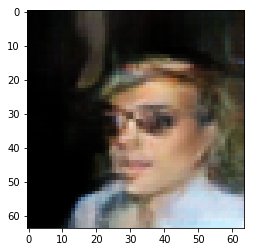

Iteration 750
Decision 1.9865110516548157e-06


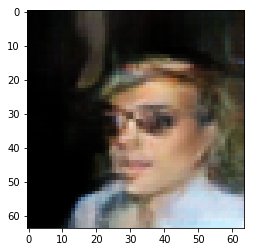

Iteration 1000
Decision -0.0676514282822609


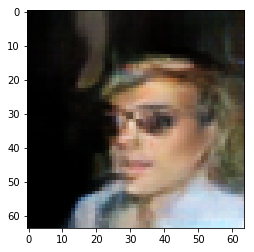

Iteration 1250
Decision -6.360933184623718e-07


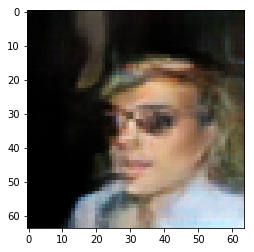

Iteration 1500
Decision 1.685693860054016e-07


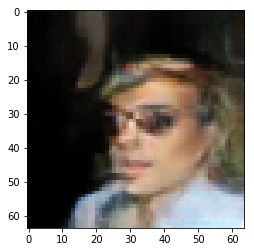

Iteration 1750
Decision -4.480592906475067e-06


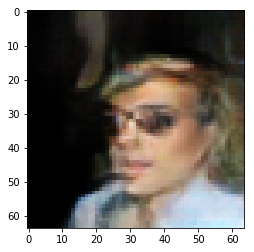

Iteration 2000
Decision 1.4488585293293e-05


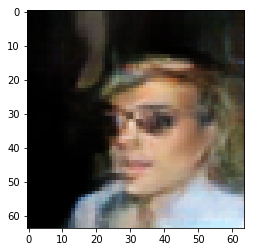

Iteration 0
Decision -11.928598403930664


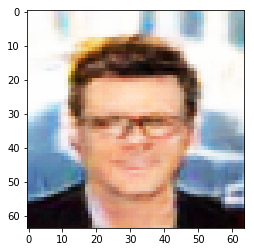

Iteration 250
Decision -1.7906539142131805e-05


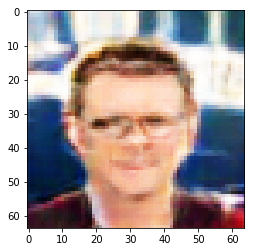

Iteration 500
Decision 7.497146725654602e-07


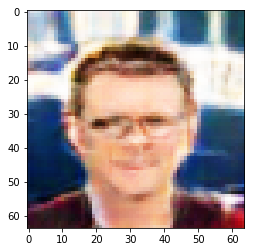

Iteration 750
Decision -5.615875124931335e-07


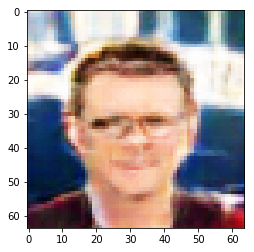

Iteration 1000
Decision -8.475035429000854e-08


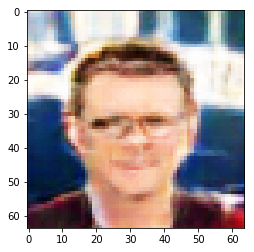

Iteration 1250
Decision 4.516914486885071e-07


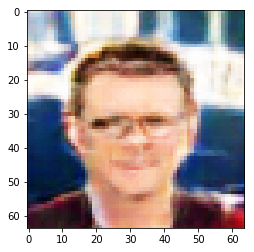

Iteration 1500
Decision 3.3248215913772583e-07


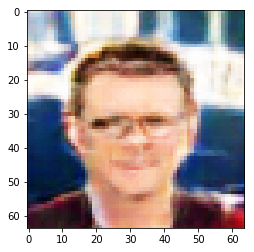

Iteration 1750
Decision -4.423782229423523e-07


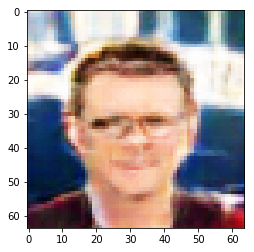

Iteration 2000
Decision 2.728775143623352e-07


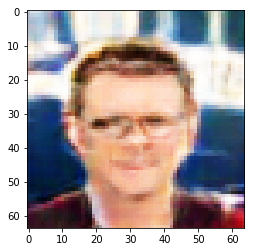

Iteration 0
Decision 10.552313804626465


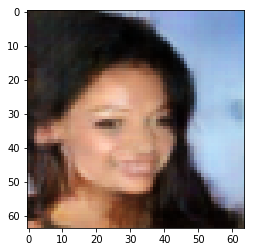

Iteration 250
Decision -3.5390257835388184e-07


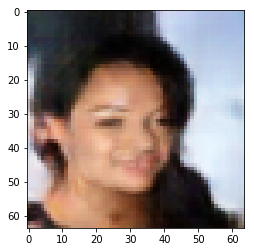

Iteration 500
Decision -4.6566128730773926e-09


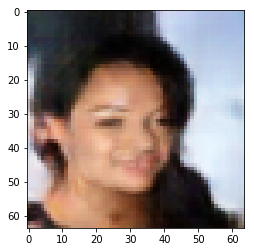

Iteration 750
Decision -4.6566128730773926e-09


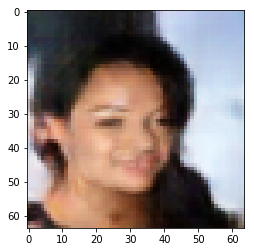

Iteration 1000
Decision -4.6566128730773926e-09


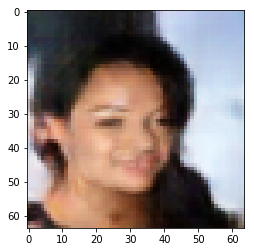

Iteration 1250
Decision -4.6566128730773926e-09


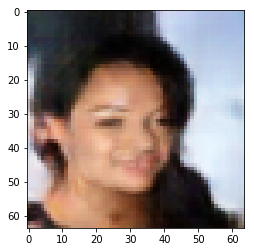

Iteration 1500
Decision -4.6566128730773926e-09


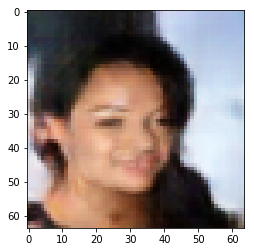

Iteration 1750
Decision -4.6566128730773926e-09


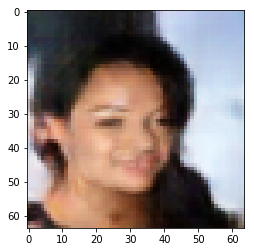

Iteration 2000
Decision -4.6566128730773926e-09


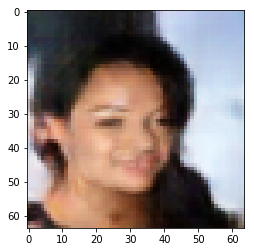

Iteration 0
Decision 3.4201202392578125


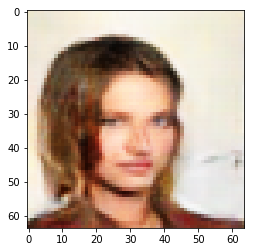

Iteration 250
Decision -2.1141022443771362e-07


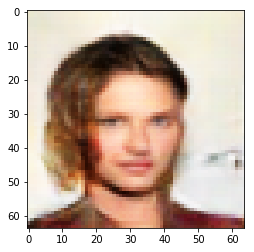

Iteration 500
Decision -3.82494181394577e-06


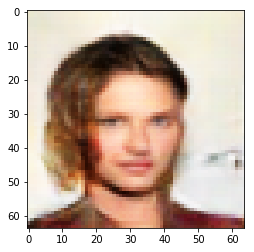

Iteration 750
Decision -1.816079020500183e-07


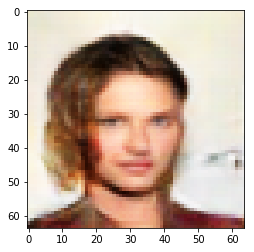

Iteration 1000
Decision 1.539476215839386e-06


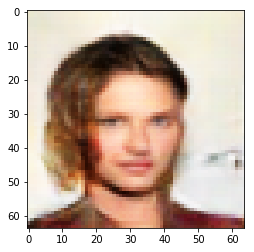

Iteration 1250
Decision -1.0418705642223358e-05


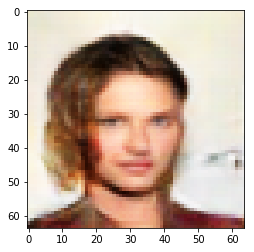

Iteration 1500
Decision -9.862706065177917e-07


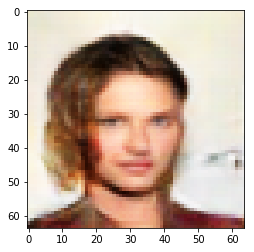

Iteration 1750
Decision -1.275818794965744e-05


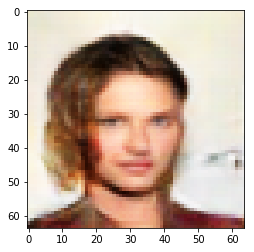

Iteration 2000
Decision 9.764917194843292e-06


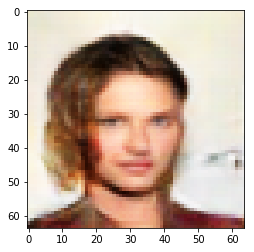

Iteration 0
Decision -4.277565002441406


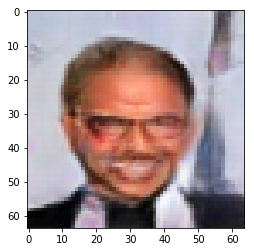

Iteration 250
Decision 2.2100284695625305e-06


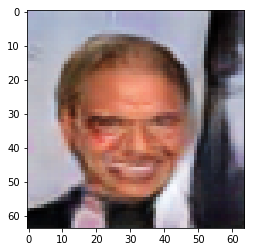

Iteration 500
Decision -3.8277357816696167e-07


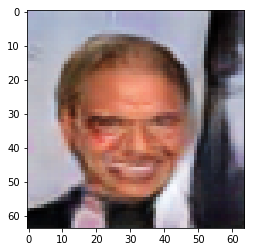

Iteration 750
Decision 4.814937710762024e-07


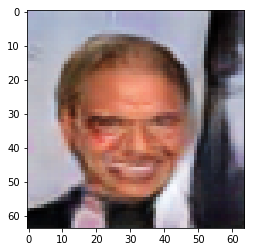

Iteration 1000
Decision -1.7238780856132507e-06


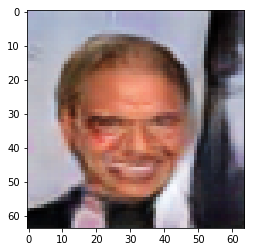

Iteration 1250
Decision -3.661029040813446e-06


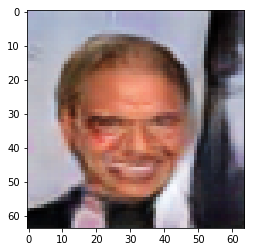

Iteration 1500
Decision -2.514570951461792e-08


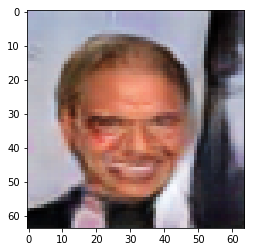

Iteration 1750
Decision 8.093193173408508e-07


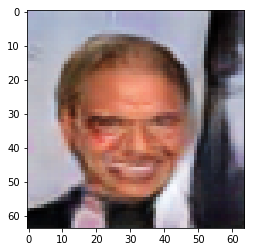

Iteration 2000
Decision 9.583309292793274e-07


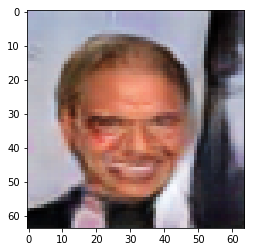

Iteration 0
Decision 0.47057363390922546


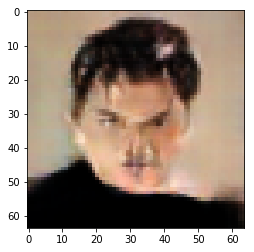

Iteration 250
Decision -8.987262845039368e-07


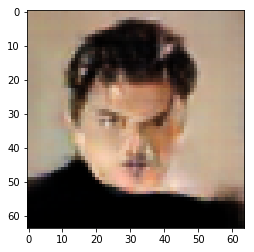

Iteration 500
Decision -3.046635538339615e-05


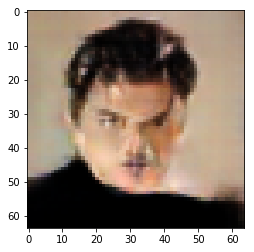

Iteration 750
Decision -5.8970414102077484e-05


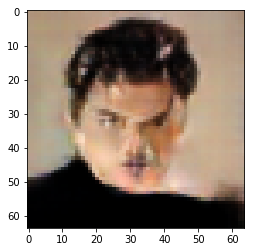

Iteration 1000
Decision -1.0783784091472626e-05


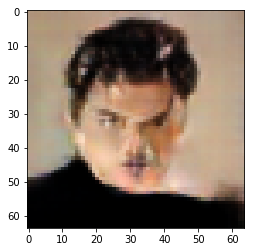

Iteration 1250
Decision -6.205402314662933e-06


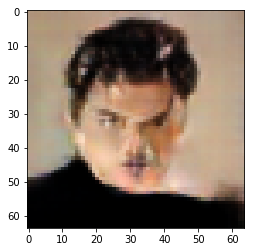

Iteration 1500
Decision 0.0615445114672184


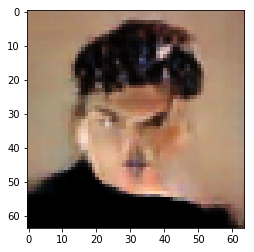

Iteration 1750
Decision -6.313435733318329e-06


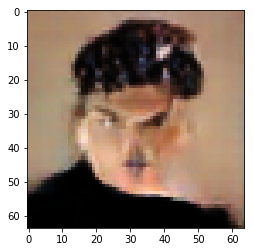

Iteration 2000
Decision 2.3292377591133118e-06


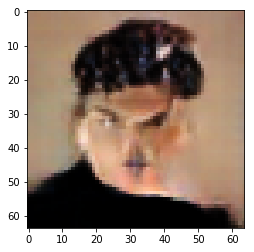

Iteration 0
Decision 7.148810863494873


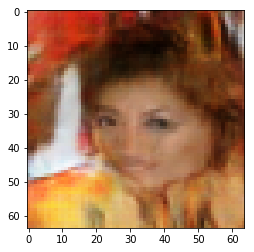

Iteration 250
Decision -4.01865690946579e-06


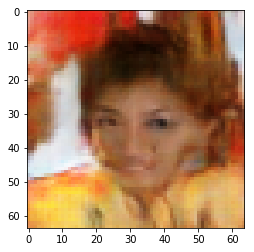

Iteration 500
Decision 1.2386590242385864e-07


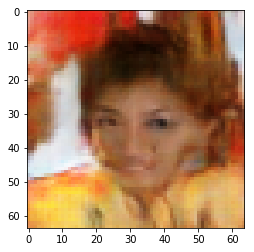

Iteration 750
Decision 3.026798367500305e-07


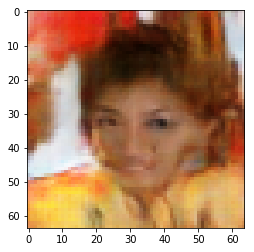

Iteration 1000
Decision -1.1278316378593445e-06


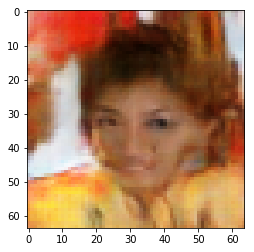

Iteration 1250
Decision -3.8277357816696167e-07


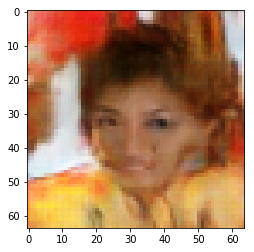

Iteration 1500
Decision -1.932494342327118e-06


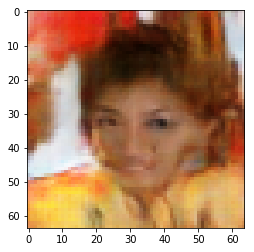

Iteration 1750
Decision 1.6437843441963196e-06


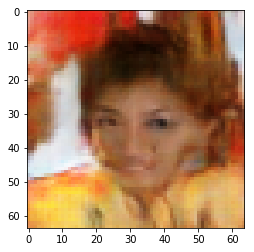

Iteration 2000
Decision -3.1543895602226257e-06


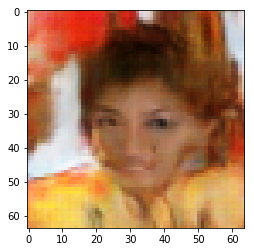

Iteration 0
Decision 4.270944118499756


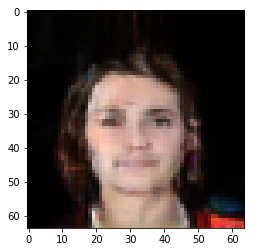

Iteration 250
Decision 4.609115421772003e-06


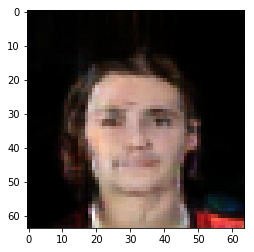

Iteration 500
Decision 4.936009645462036e-08


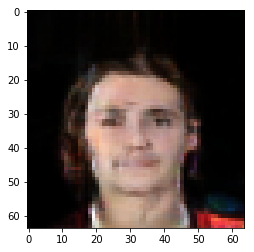

Iteration 750
Decision 4.936009645462036e-08


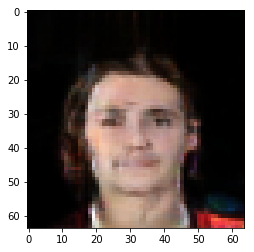

Iteration 1000
Decision -1.8905848264694214e-07


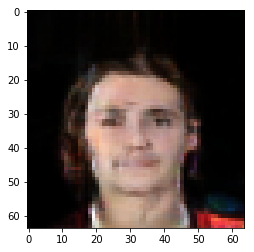

Iteration 1250
Decision 4.936009645462036e-08


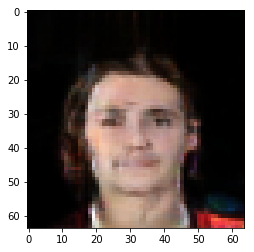

Iteration 1500
Decision 4.936009645462036e-08


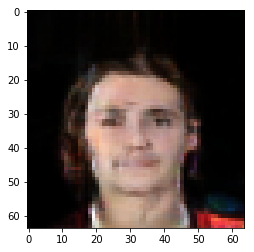

Iteration 1750
Decision -1.8905848264694214e-07


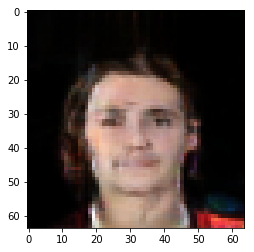

Iteration 2000
Decision 4.936009645462036e-08


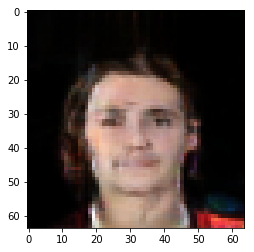

Iteration 0
Decision 12.025888442993164


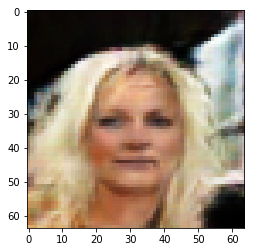

Iteration 250
Decision -1.0336749255657196e-05


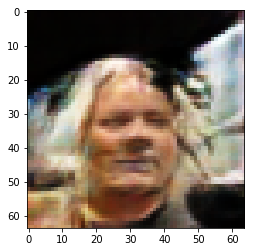

Iteration 500
Decision -9.192153811454773e-07


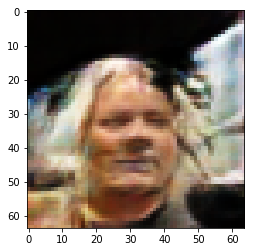

Iteration 750
Decision 3.771856427192688e-07


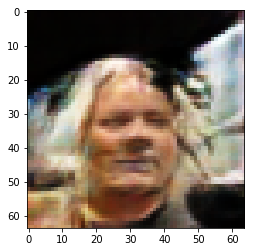

Iteration 1000
Decision 7.646158337593079e-07


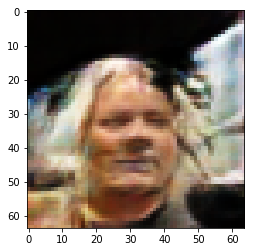

Iteration 1250
Decision 2.4335458874702454e-06


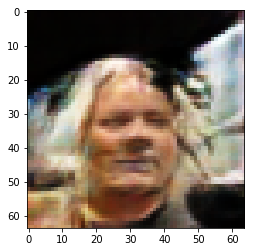

Iteration 1500
Decision -1.2945383787155151e-07


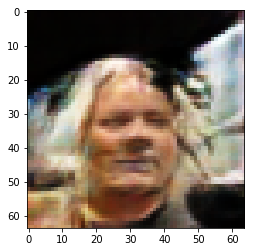

Iteration 1750
Decision 1.685693860054016e-07


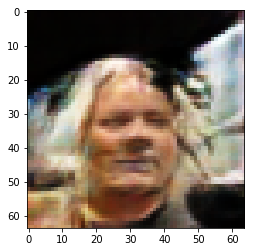

Iteration 2000
Decision -1.2945383787155151e-07


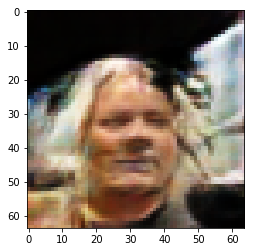

Iteration 0
Decision 9.808134078979492


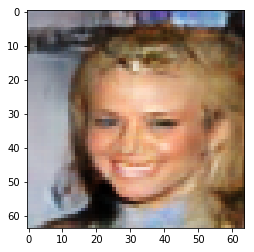

Iteration 250
Decision 1.1836178600788116e-05


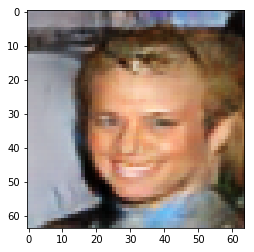

Iteration 500
Decision 6.426125764846802e-08


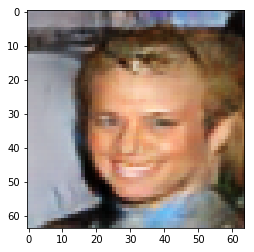

Iteration 750
Decision 6.426125764846802e-08


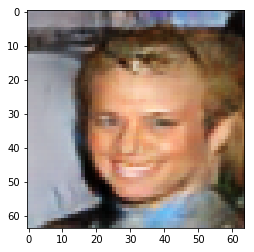

Iteration 1000
Decision 6.426125764846802e-08


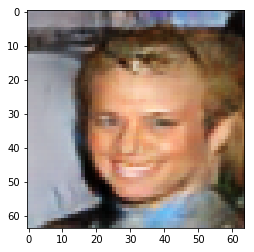

Iteration 1250
Decision 6.426125764846802e-08


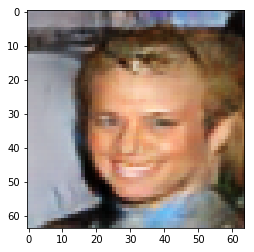

Iteration 1500
Decision -1.7415732145309448e-07


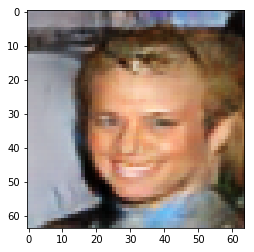

Iteration 1750
Decision 3.4458935260772705e-08


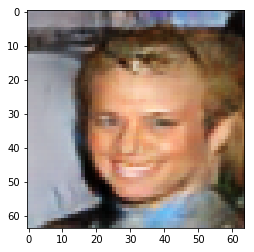

Iteration 2000
Decision 3.4458935260772705e-08


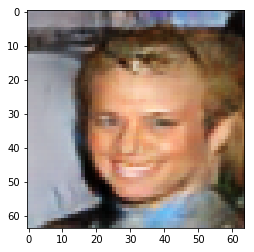

Iteration 0
Decision -0.22259052097797394


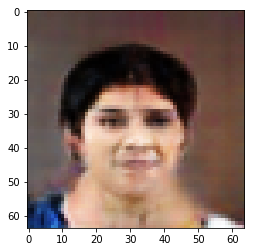

Iteration 250
Decision 1.7182901501655579e-06


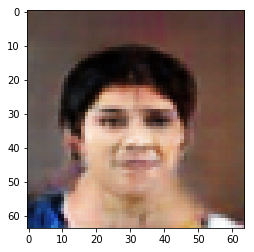

Iteration 500
Decision -2.4866312742233276e-07


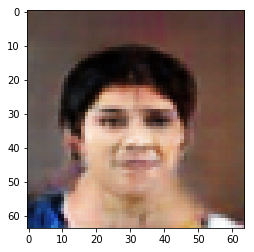

Iteration 750
Decision -6.864778697490692e-06


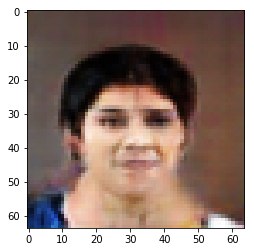

Iteration 1000
Decision 1.6586855053901672e-06


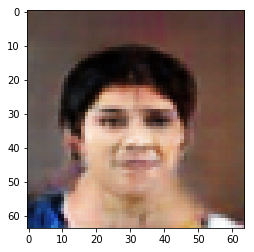

Iteration 1250
Decision -9.889714419841766e-06


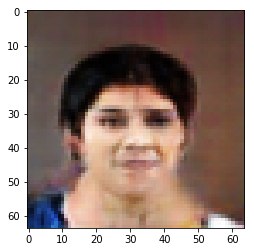

Iteration 1500
Decision 3.148801624774933e-06


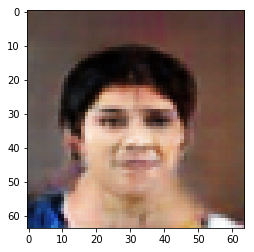

Iteration 1750
Decision 1.0030344128608704e-06


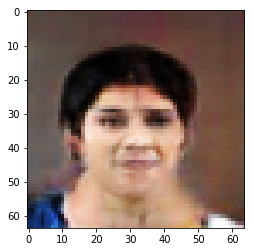

Iteration 2000
Decision 4.516914486885071e-07


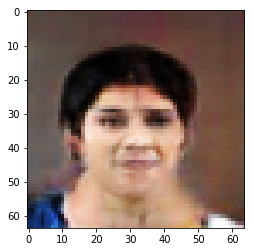

Iteration 0
Decision 14.816093444824219


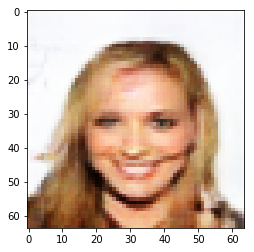

Iteration 250
Decision 1.1895783245563507e-05


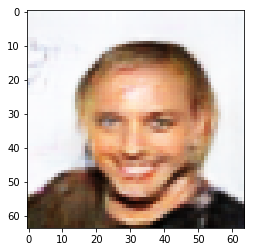

Iteration 500
Decision 3.3248215913772583e-07


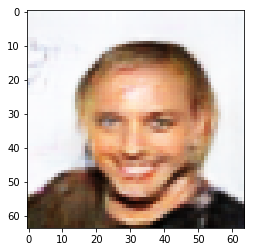

Iteration 750
Decision -7.404014468193054e-07


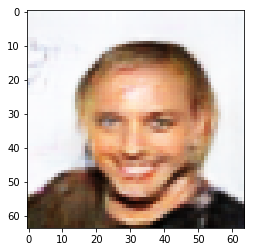

Iteration 1000
Decision 3.3248215913772583e-07


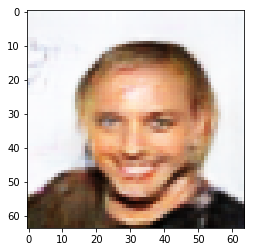

Iteration 1250
Decision 2.1327286958694458e-07


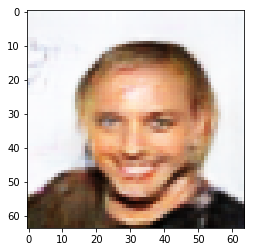

Iteration 1500
Decision -7.404014468193054e-07


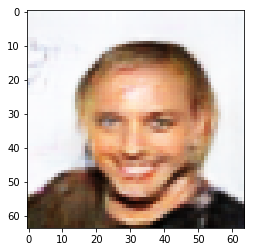

Iteration 1750
Decision 3.3248215913772583e-07


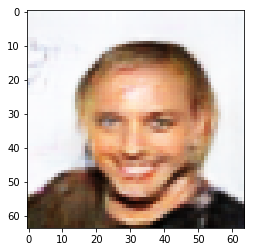

Iteration 2000
Decision -5.019828677177429e-07


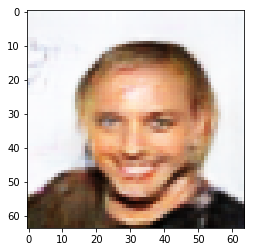

Iteration 0
Decision 17.203556060791016


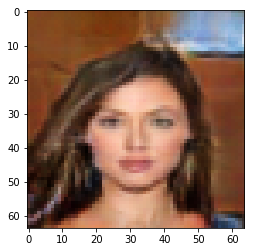

Iteration 250
Decision 0.0001360001042485237


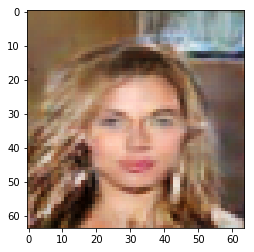

Iteration 500
Decision -7.105991244316101e-07


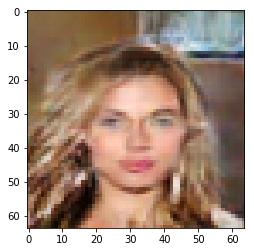

Iteration 750
Decision 7.171183824539185e-08


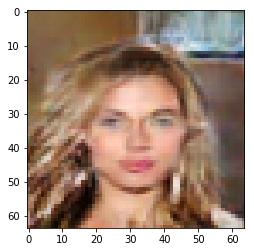

Iteration 1000
Decision 7.171183824539185e-08


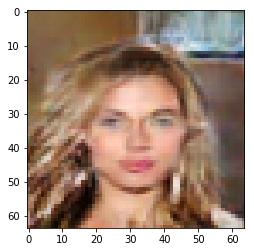

Iteration 1250
Decision 7.171183824539185e-08


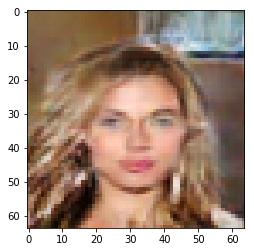

Iteration 1500
Decision 7.171183824539185e-08


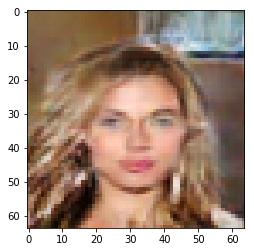

Iteration 1750
Decision 7.171183824539185e-08


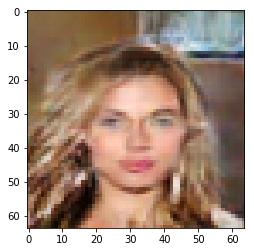

Iteration 2000
Decision -1.7695128917694092e-08


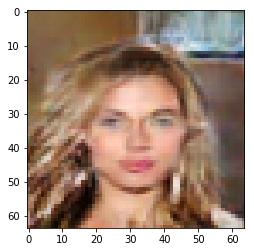

Iteration 0
Decision 11.020384788513184


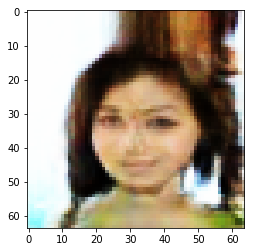

Iteration 250
Decision 1.0644085705280304e-05


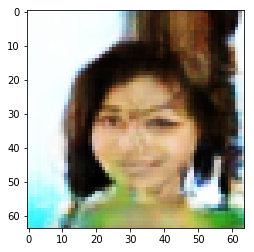

Iteration 500
Decision 1.2386590242385864e-07


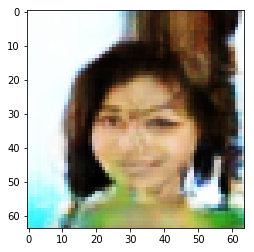

Iteration 750
Decision 6.901100277900696e-07


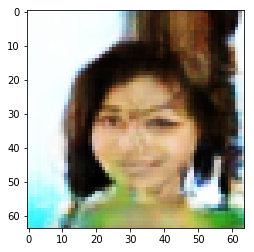

Iteration 1000
Decision 6.901100277900696e-07


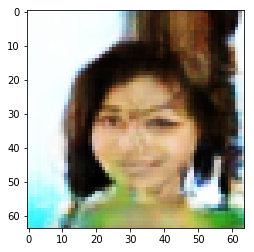

Iteration 1250
Decision -8.475035429000854e-08


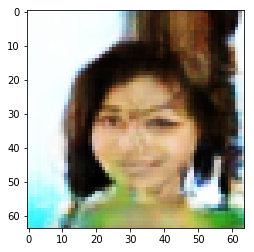

Iteration 1500
Decision 1.8347054719924927e-07


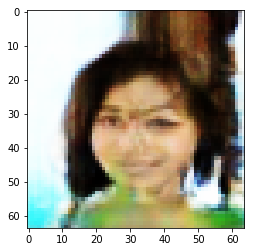

Iteration 1750
Decision 1.8347054719924927e-07


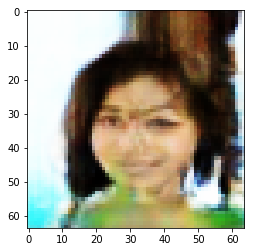

Iteration 2000
Decision 1.8347054719924927e-07


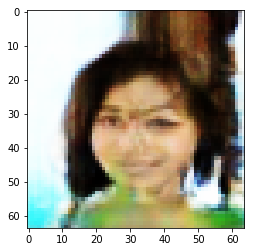

Iteration 0
Decision 5.922521114349365


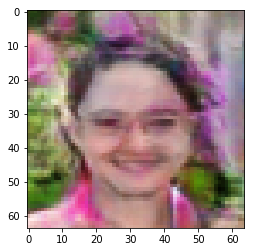

Iteration 250
Decision 3.800727427005768e-06


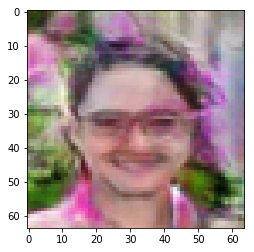

Iteration 500
Decision 4.4424086809158325e-07


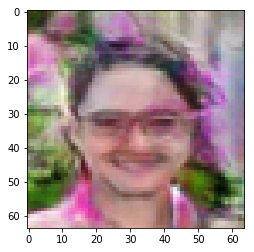

Iteration 750
Decision -5.876645445823669e-07


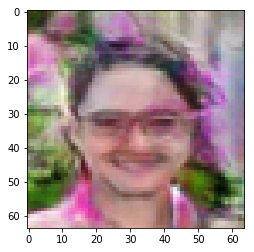

Iteration 1000
Decision -6.51925802230835e-09


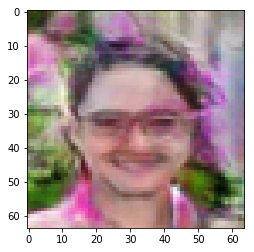

Iteration 1250
Decision -6.51925802230835e-09


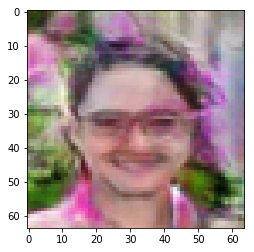

Iteration 1500
Decision -6.51925802230835e-09


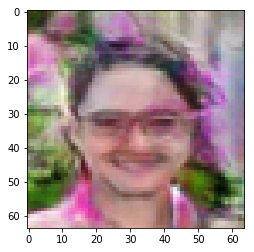

Iteration 1750
Decision -6.51925802230835e-09


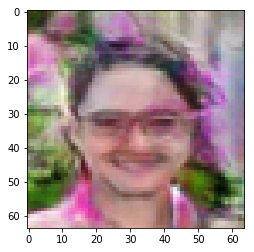

Iteration 2000
Decision -6.51925802230835e-09


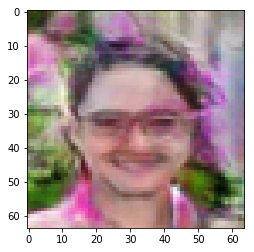

Iteration 0
Decision -7.565869331359863


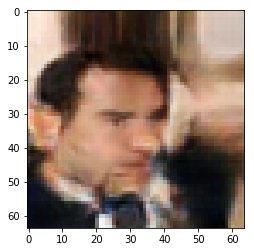

Iteration 250
Decision 5.577690899372101e-06


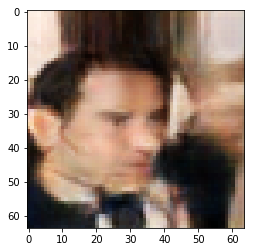

Iteration 500
Decision -8.475035429000854e-08


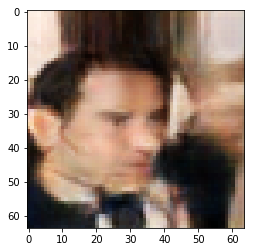

Iteration 750
Decision 9.406358003616333e-08


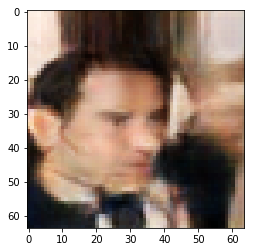

Iteration 1000
Decision 9.406358003616333e-08


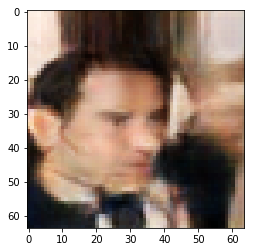

Iteration 1250
Decision 1.1669471859931946e-06


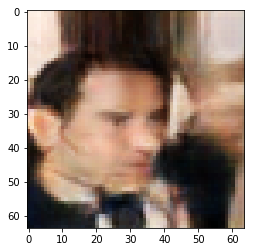

Iteration 1500
Decision 1.7629936337471008e-06


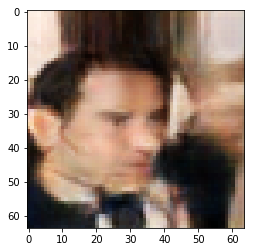

Iteration 1750
Decision 9.881332516670227e-07


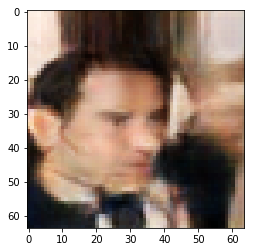

Iteration 2000
Decision -1.455657184123993e-06


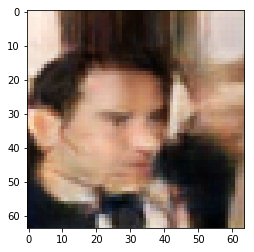

Iteration 0
Decision 1.4613308906555176


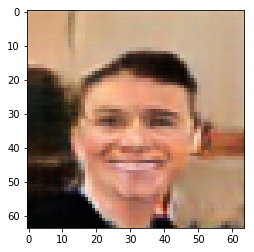

Iteration 250
Decision 2.180226147174835e-06


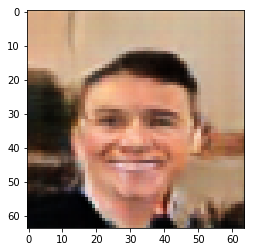

Iteration 500
Decision -2.7371570467948914e-06


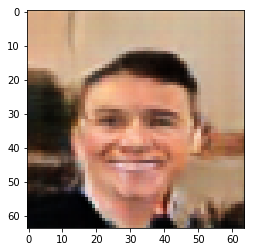

Iteration 750
Decision 5.339272320270538e-06


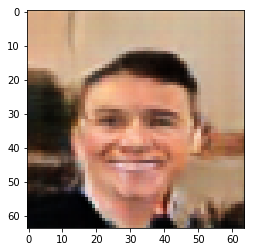

Iteration 1000
Decision 4.6836212277412415e-06


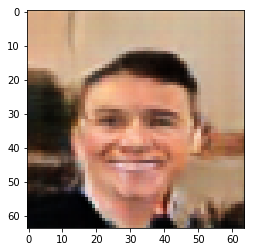

Iteration 1250
Decision -1.0384246706962585e-06


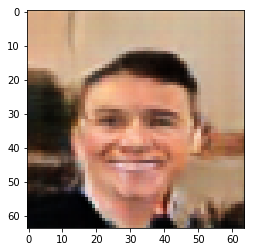

Iteration 1500
Decision 7.246620953083038e-06


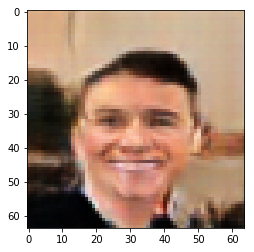

Iteration 1750
Decision -1.753680408000946e-06


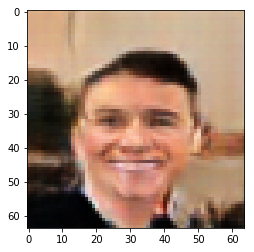

Iteration 2000
Decision 0.0014413641765713692


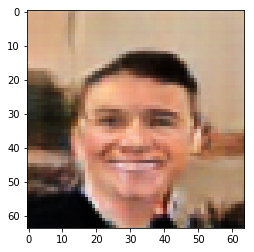

Iteration 0
Decision -8.667011260986328


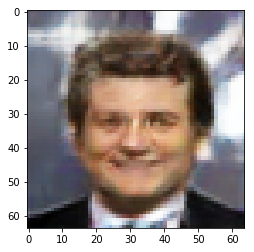

Iteration 250
Decision 2.728775143623352e-07


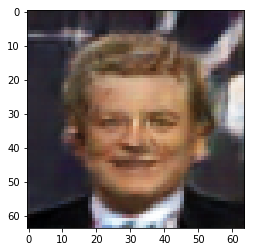

Iteration 500
Decision -2.2901222109794617e-06


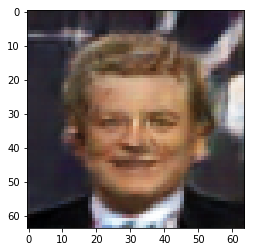

Iteration 750
Decision -1.5748664736747742e-06


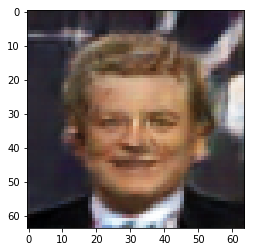

Iteration 1000
Decision -9.490177035331726e-07


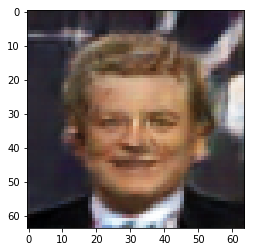

Iteration 1250
Decision -1.6642734408378601e-06


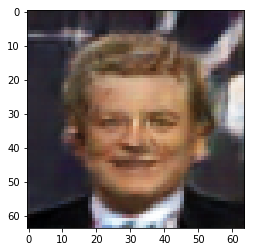

Iteration 1500
Decision 7.199123501777649e-07


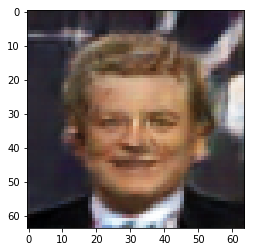

Iteration 1750
Decision 5.369074642658234e-06


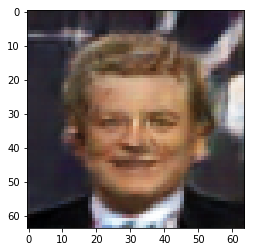

Iteration 2000
Decision -1.1576339602470398e-06


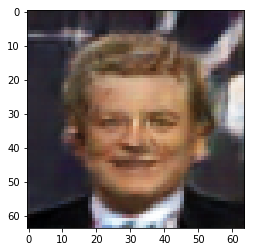

Iteration 0
Decision -0.9994394779205322


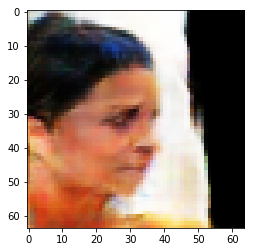

Iteration 250
Decision -1.6940757632255554e-06


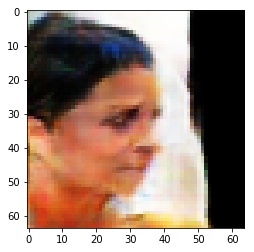

Iteration 500
Decision -3.06498259305954e-06


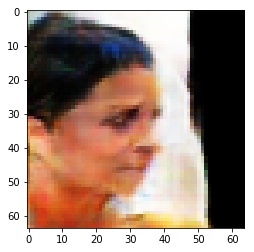

Iteration 750
Decision -3.929249942302704e-06


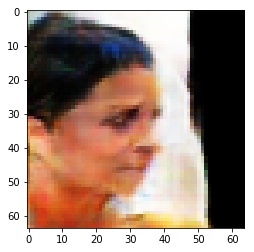

Iteration 1000
Decision -2.707354724407196e-06


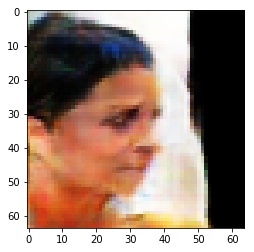

Iteration 1250
Decision 2.9550865292549133e-06


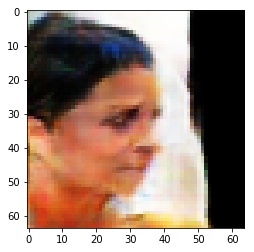

Iteration 1500
Decision 4.951842129230499e-06


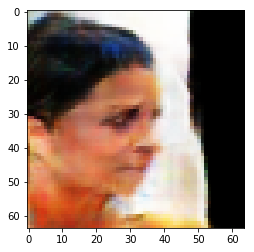

Iteration 1750
Decision -4.423782229423523e-07


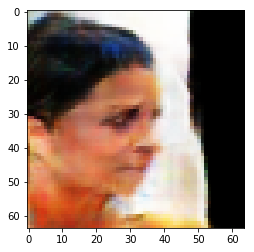

Iteration 2000
Decision 1.314748078584671e-05


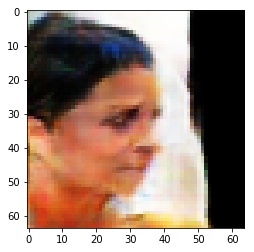

Iteration 0
Decision 11.119507789611816


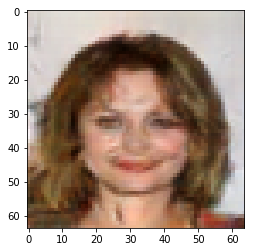

Iteration 250
Decision 0.0168345607817173


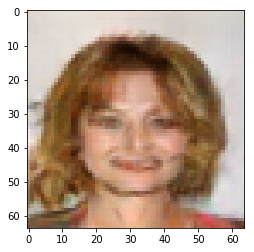

Iteration 500
Decision -5.494803190231323e-08


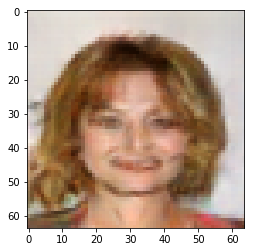

Iteration 750
Decision -4.721805453300476e-07


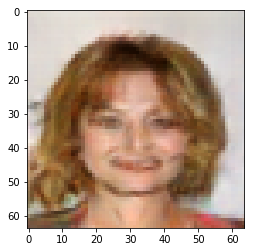

Iteration 1000
Decision 1.8347054719924927e-07


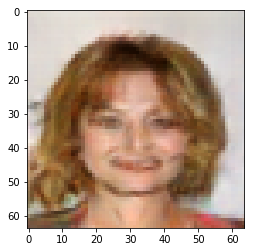

Iteration 1250
Decision -1.0235235095024109e-06


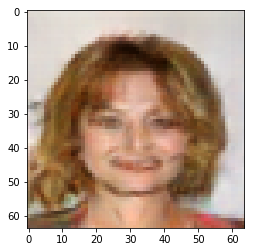

Iteration 1500
Decision 4.6566128730773926e-09


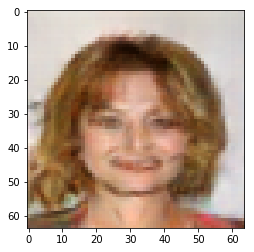

Iteration 1750
Decision -3.976747393608093e-07


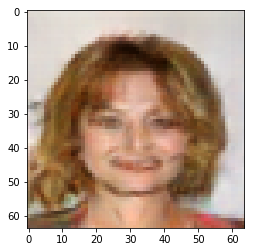

Iteration 2000
Decision 1.5366822481155396e-07


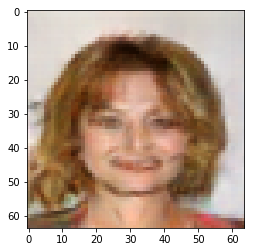

Iteration 0
Decision 8.79708194732666


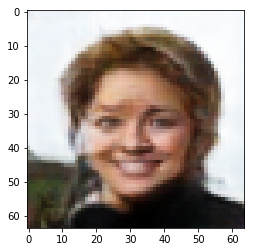

Iteration 250
Decision -6.730668246746063e-06


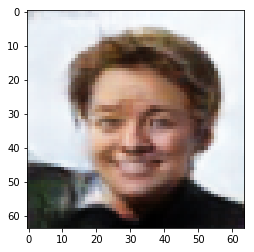

Iteration 500
Decision -2.039596438407898e-07


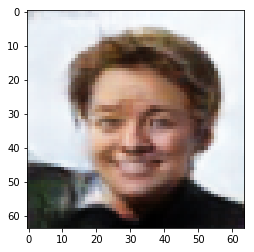

Iteration 750
Decision -2.039596438407898e-07


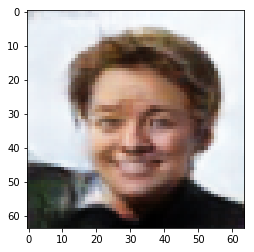

Iteration 1000
Decision -2.514570951461792e-08


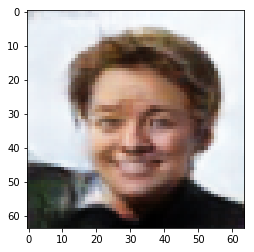

Iteration 1250
Decision -2.514570951461792e-08


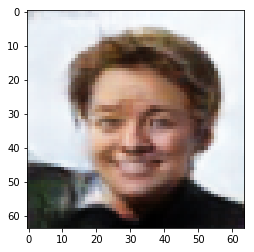

Iteration 1500
Decision 6.007030606269836e-07


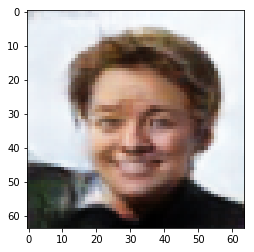

Iteration 1750
Decision -2.514570951461792e-08


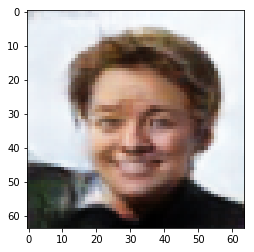

Iteration 2000
Decision -2.514570951461792e-08


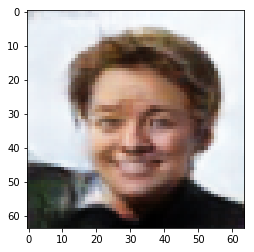

Iteration 0
Decision -1.1680885553359985


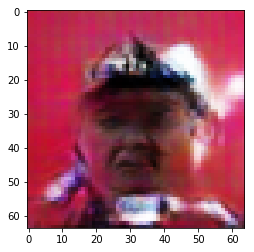

Iteration 250
Decision -1.0980293154716492e-06


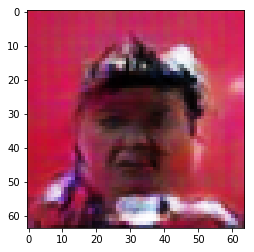

Iteration 500
Decision -1.0384246706962585e-06


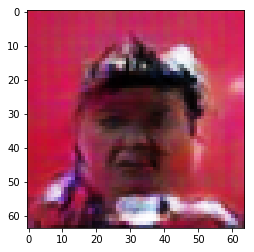

Iteration 750
Decision -3.8277357816696167e-07


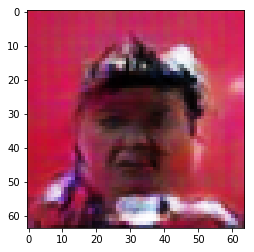

Iteration 1000
Decision 3.61073762178421e-06


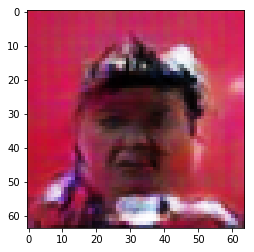

Iteration 1250
Decision -1.0813586413860321e-05


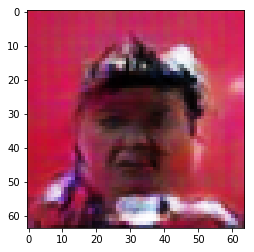

Iteration 1500
Decision -3.2437965273857117e-06


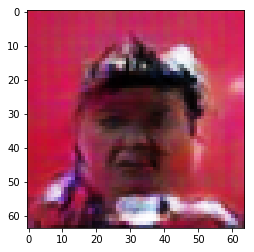

Iteration 1750
Decision -1.3734214007854462e-05


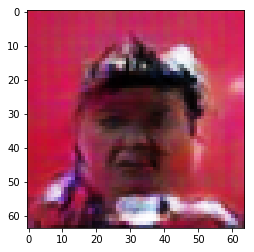

Iteration 2000
Decision -0.00019612442702054977


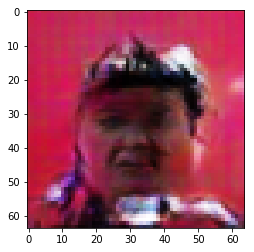

Iteration 0
Decision 11.688531875610352


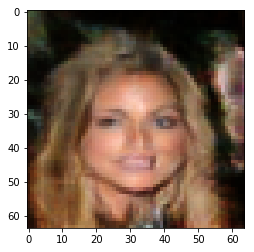

Iteration 250
Decision -1.3696961104869843e-05


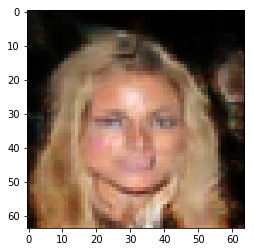

Iteration 500
Decision 1.3131648302078247e-07


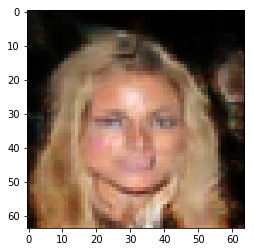

Iteration 750
Decision 1.3131648302078247e-07


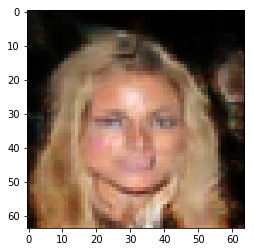

Iteration 1000
Decision 1.0998919606208801e-06


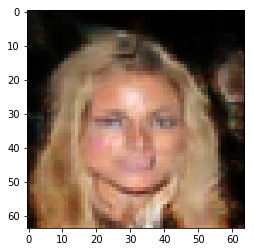

Iteration 1250
Decision 1.017935574054718e-06


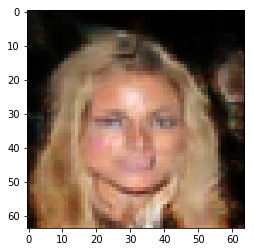

Iteration 1500
Decision -8.00006091594696e-07


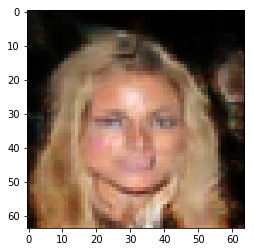

Iteration 1750
Decision -8.00006091594696e-07


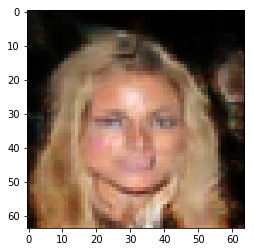

Iteration 2000
Decision -8.00006091594696e-07


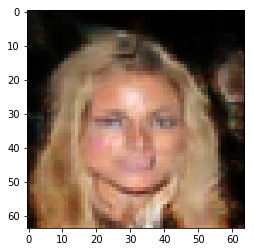

Iteration 0
Decision -6.087734222412109


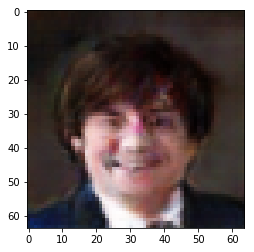

Iteration 250
Decision -2.1262094378471375e-06


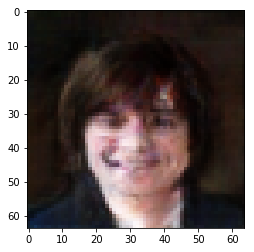

Iteration 500
Decision -1.0244548320770264e-08


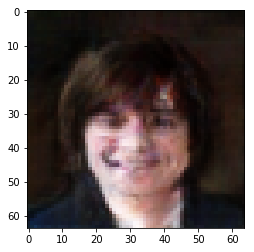

Iteration 750
Decision -1.5925616025924683e-07


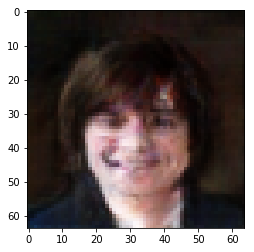

Iteration 1000
Decision -2.514570951461792e-08


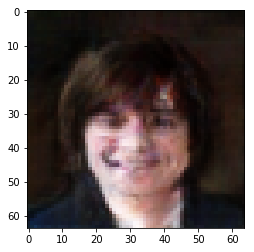

Iteration 1250
Decision -2.514570951461792e-08


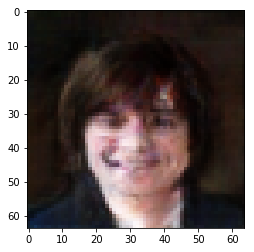

Iteration 1500
Decision -2.514570951461792e-08


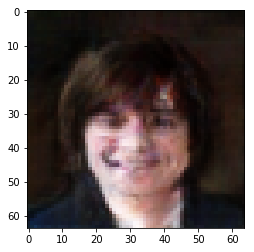

Iteration 1750
Decision 2.537854015827179e-06


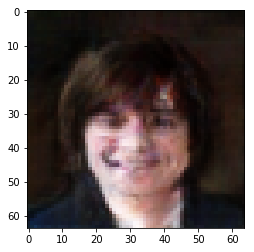

Iteration 2000
Decision 9.285286068916321e-07


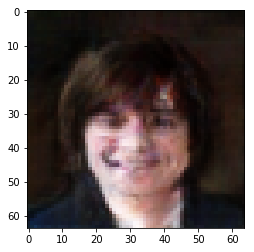

Iteration 0
Decision 12.779085159301758


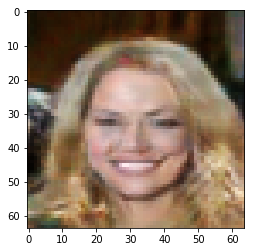

Iteration 250
Decision 7.796753197908401e-05


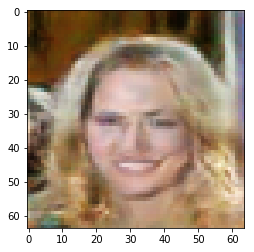

Iteration 500
Decision -5.494803190231323e-08


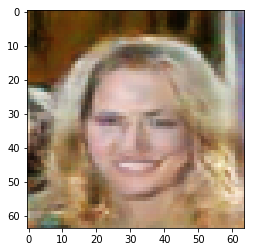

Iteration 750
Decision 6.426125764846802e-08


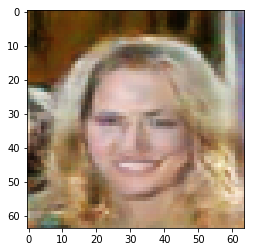

Iteration 1000
Decision 6.426125764846802e-08


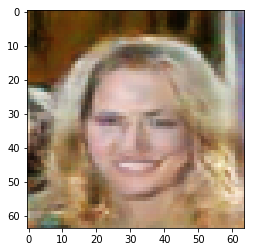

Iteration 1250
Decision 6.426125764846802e-08


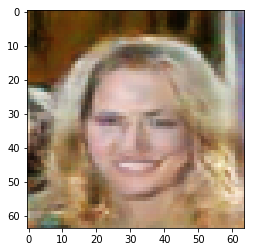

Iteration 1500
Decision 6.426125764846802e-08


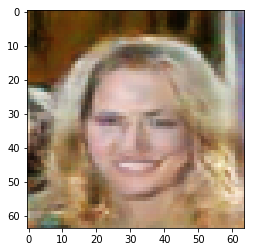

Iteration 1750
Decision 6.426125764846802e-08


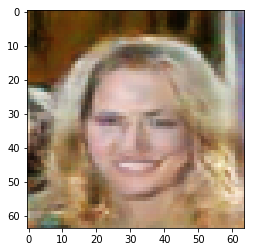

Iteration 2000
Decision -1.7415732145309448e-07


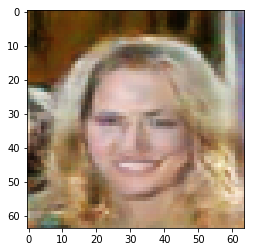

Iteration 0
Decision 12.834003448486328


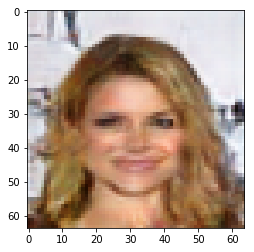

Iteration 250
Decision 0.39897528290748596


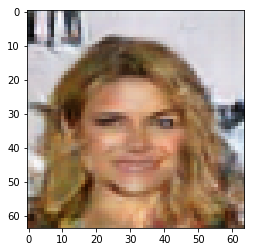

Iteration 500
Decision 0.00957105029374361


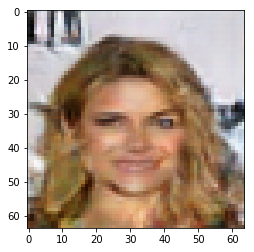

Iteration 750
Decision 2.5527551770210266e-06


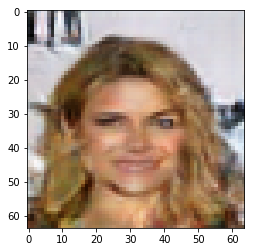

Iteration 1000
Decision 2.728775143623352e-07


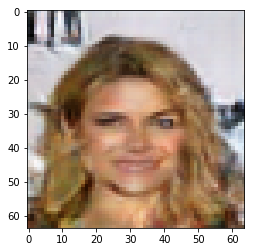

Iteration 1250
Decision 2.728775143623352e-07


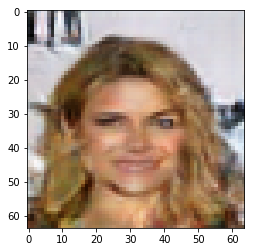

Iteration 1500
Decision 2.728775143623352e-07


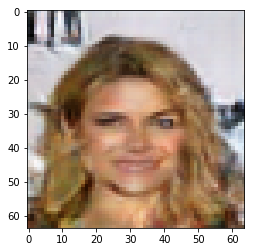

Iteration 1750
Decision -4.12575900554657e-07


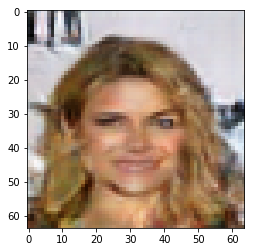

Iteration 2000
Decision 2.728775143623352e-07


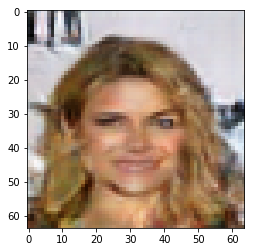

Iteration 0
Decision -0.5090696215629578


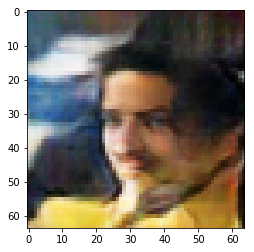

Iteration 250
Decision 1.2116506695747375e-06


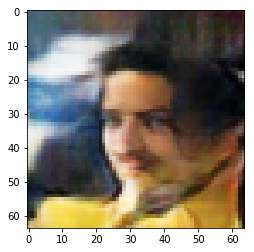

Iteration 500
Decision -3.966502845287323e-06


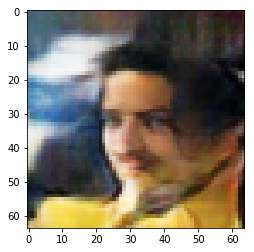

Iteration 750
Decision -1.51805579662323e-07


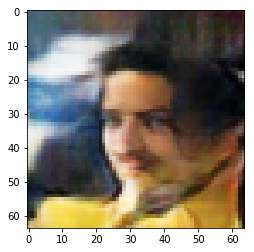

Iteration 1000
Decision -5.38211315870285e-06


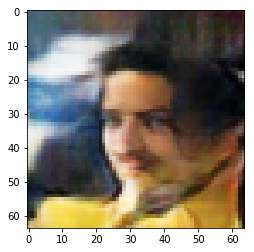

Iteration 1250
Decision -7.490627467632294e-06


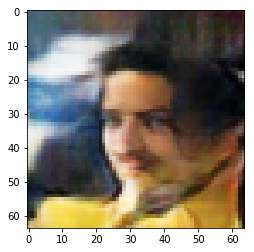

Iteration 1500
Decision -8.670613169670105e-07


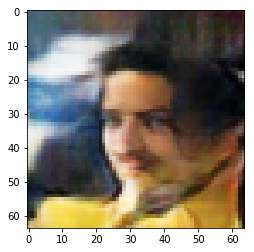

Iteration 1750
Decision 7.634051144123077e-06


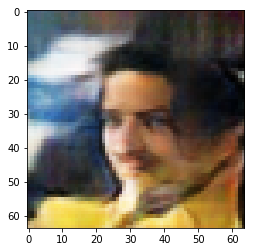

Iteration 2000
Decision -0.05424543097615242


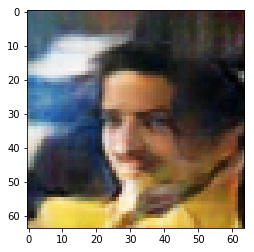

Iteration 0
Decision 14.30555248260498


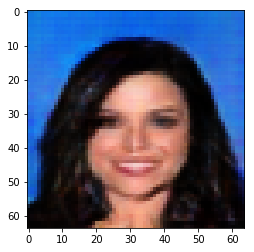

Iteration 250
Decision 0.30311936140060425


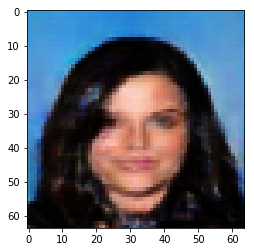

Iteration 500
Decision 2.8032809495925903e-07


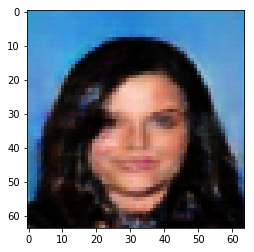

Iteration 750
Decision 4.1816383600234985e-07


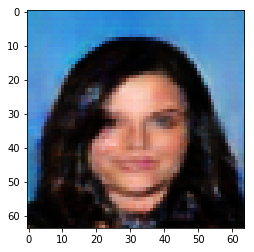

Iteration 1000
Decision 4.1816383600234985e-07


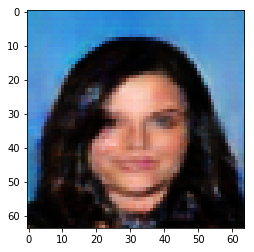

Iteration 1250
Decision 4.1816383600234985e-07


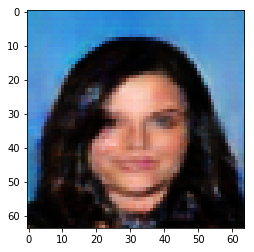

Iteration 1500
Decision 4.1816383600234985e-07


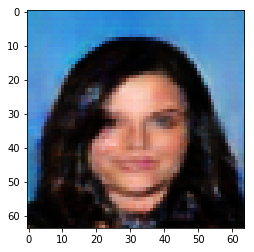

Iteration 1750
Decision 4.1816383600234985e-07


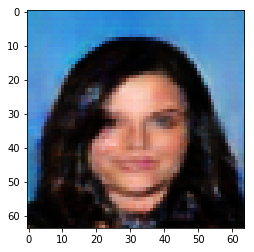

Iteration 2000
Decision 4.1816383600234985e-07


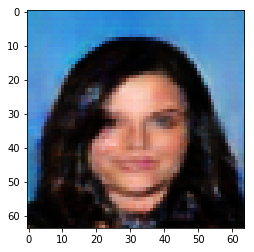

Iteration 0
Decision -9.148824691772461


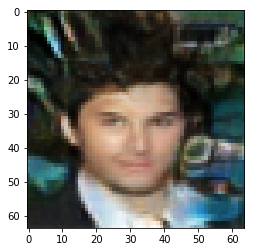

Iteration 250
Decision 6.695277988910675e-06


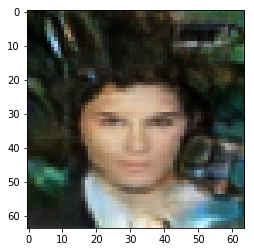

Iteration 500
Decision -1.1455267667770386e-07


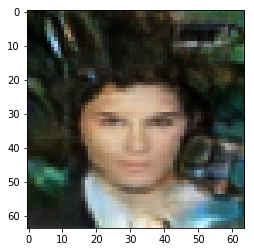

Iteration 750
Decision -1.1455267667770386e-07


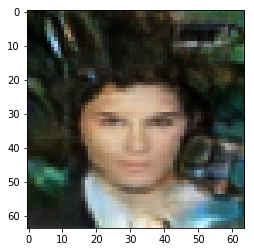

Iteration 1000
Decision -1.1455267667770386e-07


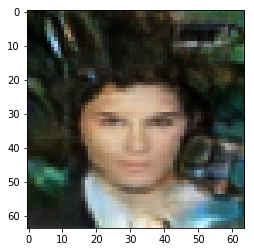

Iteration 1250
Decision -1.1455267667770386e-07


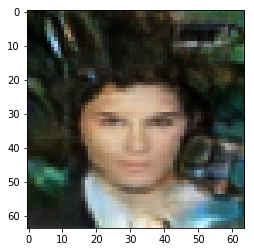

Iteration 1500
Decision -1.1455267667770386e-07


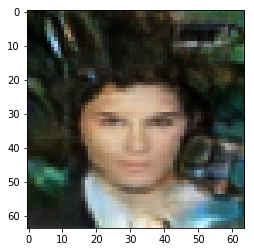

Iteration 1750
Decision -1.4435499906539917e-07


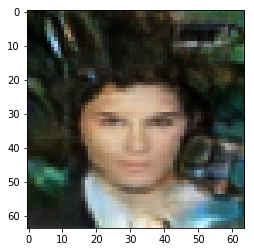

Iteration 2000
Decision 2.2817403078079224e-07


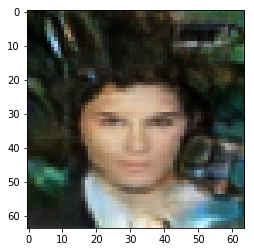

Iteration 0
Decision 13.488283157348633


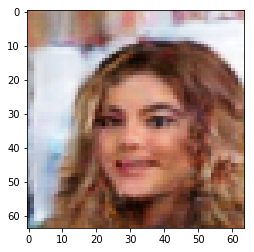

Iteration 250
Decision 0.005203043110668659


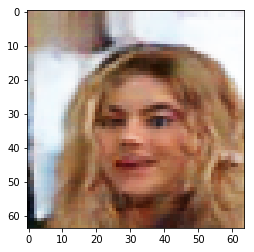

Iteration 500
Decision -2.039596438407898e-07


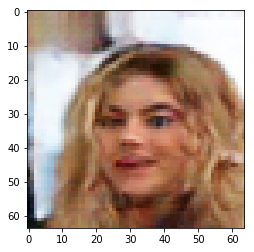

Iteration 750
Decision -2.039596438407898e-07


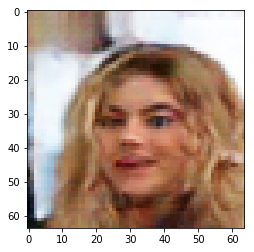

Iteration 1000
Decision -2.039596438407898e-07


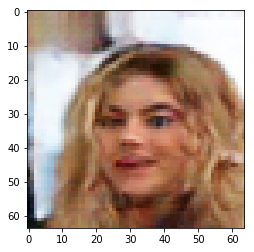

Iteration 1250
Decision -2.039596438407898e-07


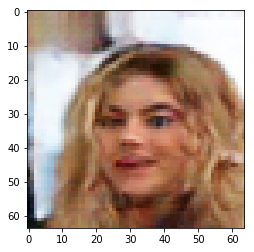

Iteration 1500
Decision -2.039596438407898e-07


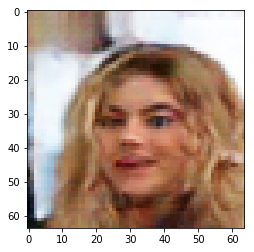

Iteration 1750
Decision -5.615875124931335e-07


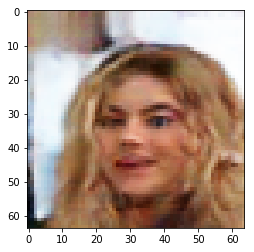

Iteration 2000
Decision 1.2386590242385864e-07


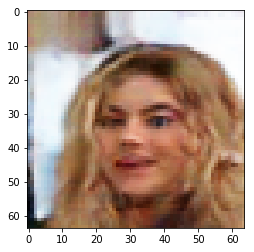

Iteration 0
Decision 4.739939212799072


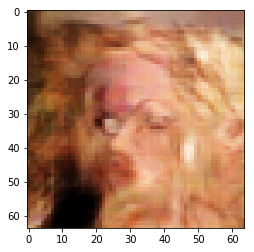

Iteration 250
Decision -2.021901309490204e-06


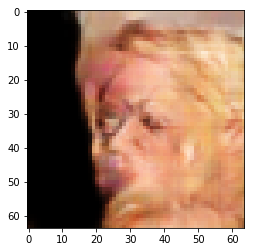

Iteration 500
Decision 3.4458935260772705e-08


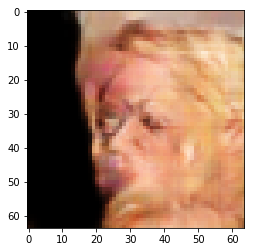

Iteration 750
Decision 3.4458935260772705e-08


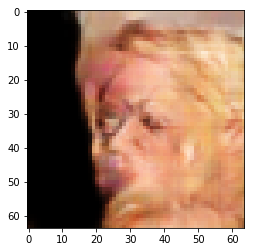

Iteration 1000
Decision 3.4458935260772705e-08


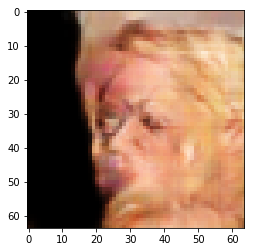

Iteration 1250
Decision 3.3248215913772583e-07


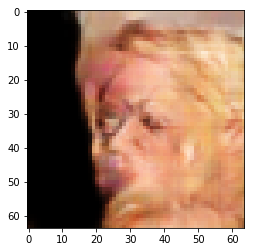

Iteration 1500
Decision -3.5297125577926636e-07


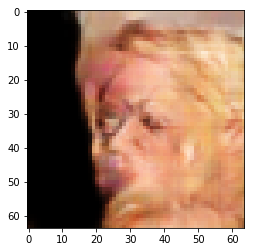

Iteration 1750
Decision 4.743225872516632e-06


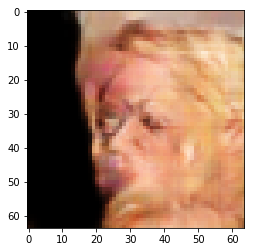

Iteration 2000
Decision 4.266388714313507e-06


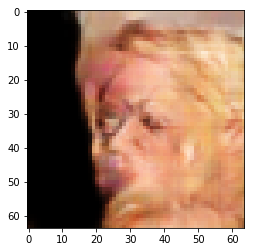

Iteration 0
Decision -3.7620961666107178


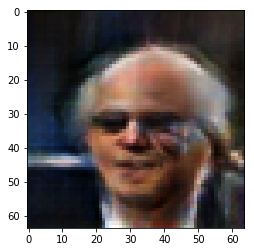

Iteration 250
Decision -1.1576339602470398e-06


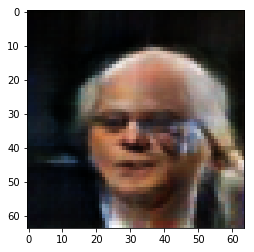

Iteration 500
Decision -1.2470409274101257e-06


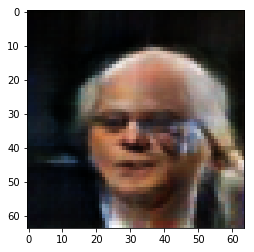

Iteration 750
Decision -1.8905848264694214e-07


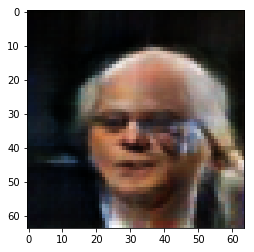

Iteration 1000
Decision 5.112960934638977e-07


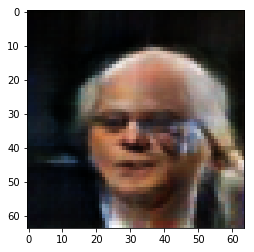

Iteration 1250
Decision 2.2994354367256165e-06


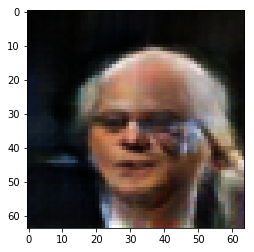

Iteration 1500
Decision -2.4689361453056335e-06


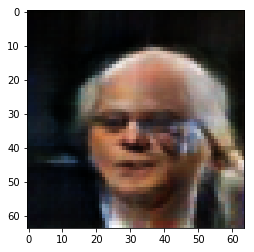

Iteration 1750
Decision -2.0815059542655945e-06


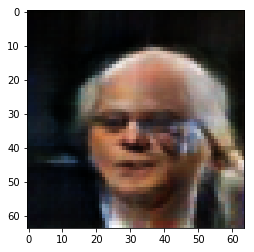

Iteration 2000
Decision 2.7762725949287415e-06


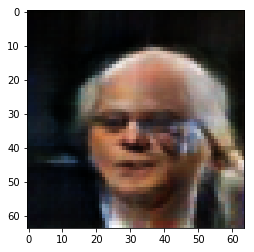

Iteration 0
Decision 1.6244138479232788


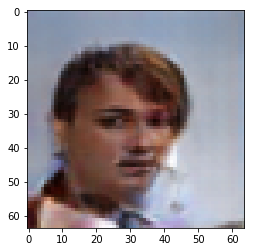

Iteration 250
Decision 3.2531097531318665e-06


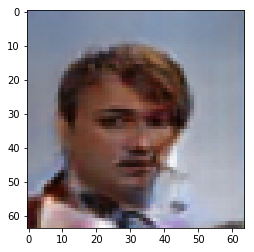

Iteration 500
Decision 1.1641532182693481e-07


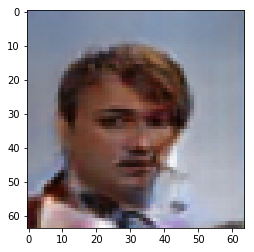

Iteration 750
Decision -2.0815059542655945e-06


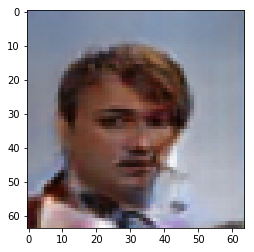

Iteration 1000
Decision -1.0086223483085632e-06


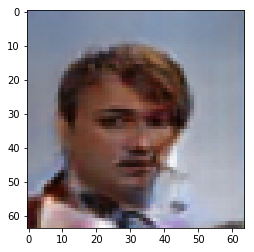

Iteration 1250
Decision 4.452653229236603e-06


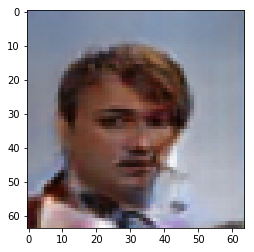

Iteration 1500
Decision -1.41095370054245e-06


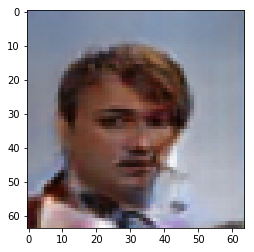

Iteration 1750
Decision 2.0285136997699738e-05


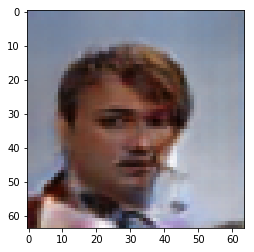

Iteration 2000
Decision 3.409571945667267e-06


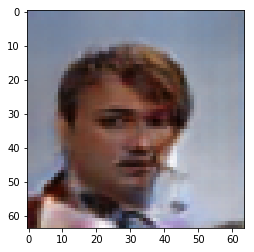

Iteration 0
Decision 8.348822593688965


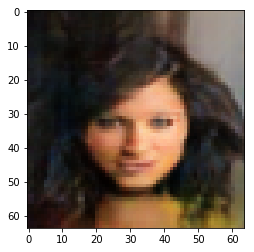

Iteration 250
Decision 7.753260433673859e-06


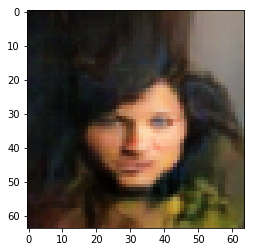

Iteration 500
Decision 8.093193173408508e-07


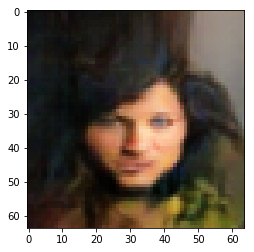

Iteration 750
Decision -2.1709129214286804e-06


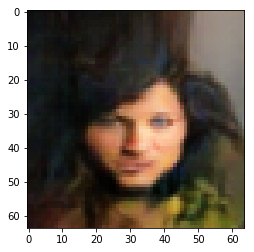

Iteration 1000
Decision -1.2945383787155151e-07


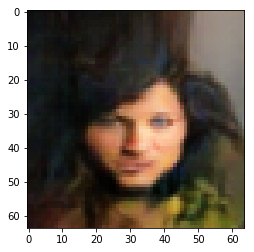

Iteration 1250
Decision -1.0086223483085632e-06


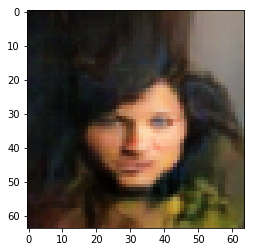

Iteration 1500
Decision -8.298084139823914e-07


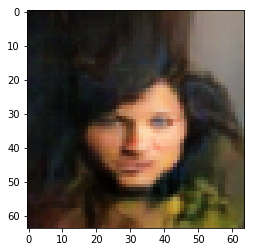

Iteration 1750
Decision 7.944181561470032e-07


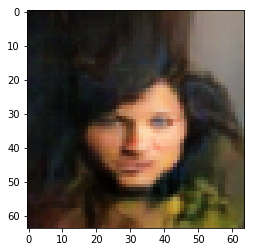

Iteration 2000
Decision -1.5301629900932312e-06


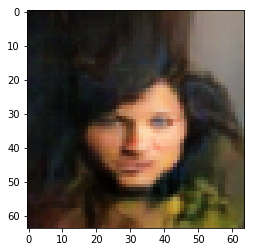

Iteration 0
Decision 0.23362866044044495


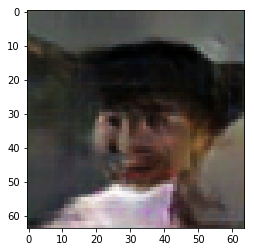

Iteration 250
Decision -1.5925616025924683e-07


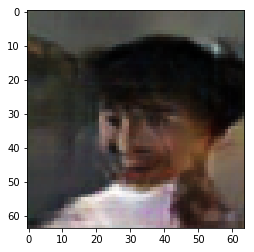

Iteration 500
Decision 5.85801899433136e-07


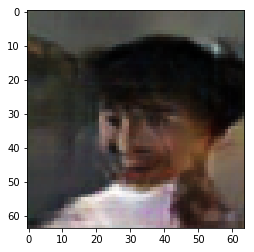

Iteration 750
Decision 2.4186447262763977e-06


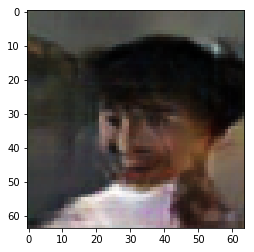

Iteration 1000
Decision 7.497146725654602e-07


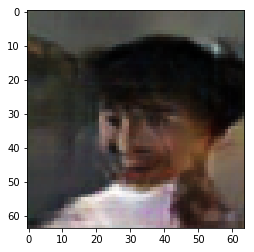

Iteration 1250
Decision -2.337619662284851e-07


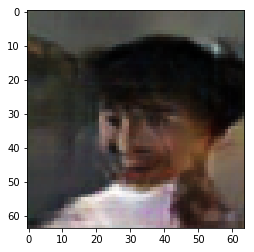

Iteration 1500
Decision -4.093162715435028e-06


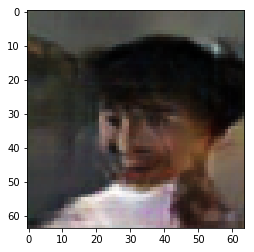

Iteration 1750
Decision 4.814937710762024e-07


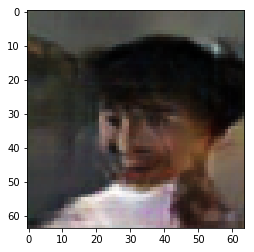

Iteration 2000
Decision -7.654540240764618e-06


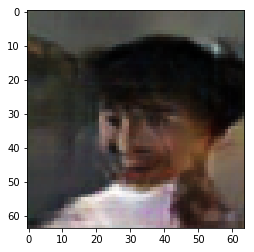

Iteration 0
Decision -3.170886278152466


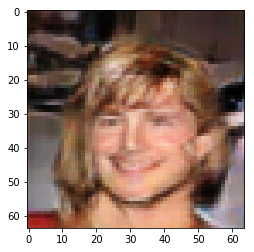

Iteration 250
Decision 2.0908191800117493e-06


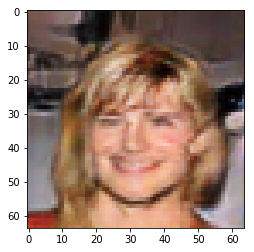

Iteration 500
Decision 8.093193173408508e-07


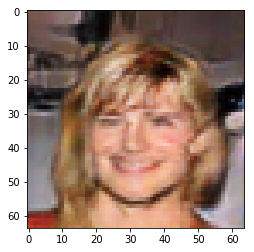

Iteration 750
Decision 2.9848888516426086e-06


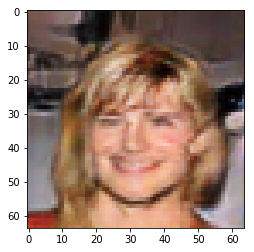

Iteration 1000
Decision 1.2386590242385864e-07


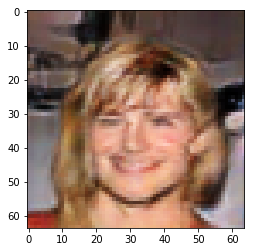

Iteration 1250
Decision 2.3888424038887024e-06


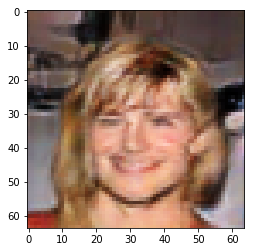

Iteration 1500
Decision 8.796341717243195e-06


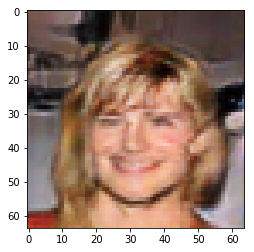

Iteration 1750
Decision -2.4391338229179382e-06


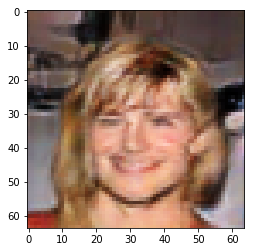

Iteration 2000
Decision -1.3972632586956024e-05


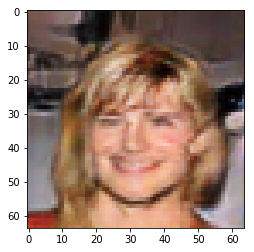

Iteration 0
Decision 11.863290786743164


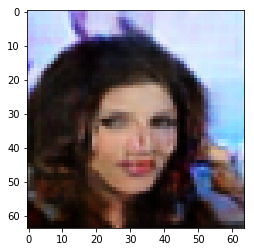

Iteration 250
Decision -6.2389299273490906e-06


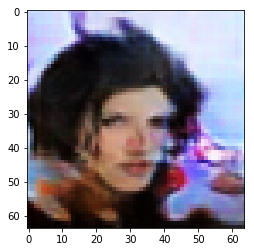

Iteration 500
Decision 1.2386590242385864e-07


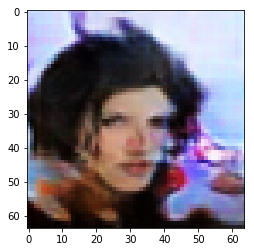

Iteration 750
Decision 2.0014122128486633e-06


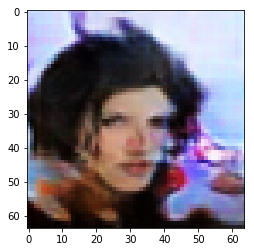

Iteration 1000
Decision 1.017935574054718e-06


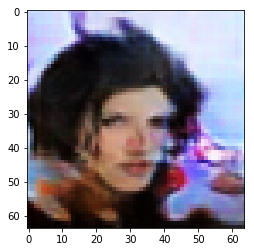

Iteration 1250
Decision 1.2191012501716614e-06


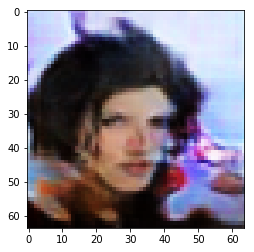

Iteration 1500
Decision 1.6810372471809387e-06


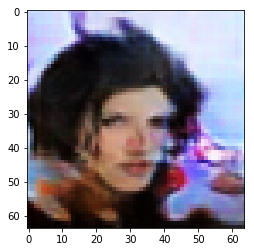

Iteration 1750
Decision -2.3422762751579285e-06


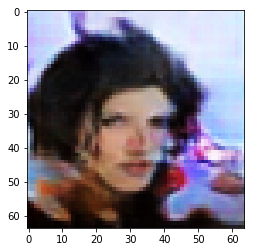

Iteration 2000
Decision -1.8356367945671082e-06


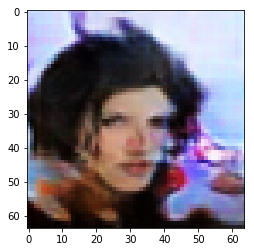

Iteration 0
Decision -3.2841217517852783


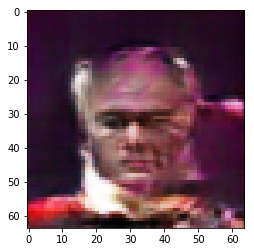

Iteration 250
Decision -5.615875124931335e-07


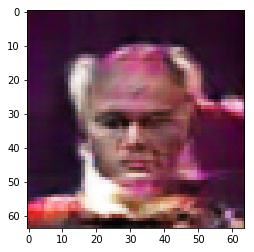

In [ ]:
#Boundary transition for image with gan
for i in range(0,200):
    image=torch.randn(1,z_dim,device=device)
    fooling_image = solve_boundary_gan(classifier,generator,image,0.01,2001)

In [69]:
#Find closest GAN
#num_loss=np.zeros(300)
import random
init_loss=np.zeros(300)
transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.ToPILImage(),
         transforms.ToTensor(),
         transforms.Normalize(mean=[0.5] * 3, std=[0.5] * 3)])

for i in range(0,300):
    image=torch.randn(1,z_dim,device=device)
    a,b=trainset[random.randint(0, 1000)]
    true_image= transform(a)
    true_image=true_image.type('torch.FloatTensor').to(device)
    loss=torch.sum(torch.pow(true_image-generator(image), 2))
    init_loss[i]=loss
    #view_tensor(true_image,False,'f')
    #loss = find_closest_gan(generator,image,true_image,0.5,2000)
    #num_loss[i]=loss
    print('Loop = {}'.format(i))

Loop = 0
Loop = 1
Loop = 2
Loop = 3
Loop = 4
Loop = 5
Loop = 6
Loop = 7
Loop = 8
Loop = 9
Loop = 10
Loop = 11
Loop = 12
Loop = 13
Loop = 14
Loop = 15
Loop = 16
Loop = 17
Loop = 18
Loop = 19
Loop = 20
Loop = 21
Loop = 22
Loop = 23
Loop = 24
Loop = 25
Loop = 26
Loop = 27
Loop = 28
Loop = 29
Loop = 30
Loop = 31
Loop = 32
Loop = 33
Loop = 34
Loop = 35
Loop = 36
Loop = 37
Loop = 38
Loop = 39
Loop = 40
Loop = 41
Loop = 42
Loop = 43
Loop = 44
Loop = 45
Loop = 46
Loop = 47
Loop = 48
Loop = 49
Loop = 50
Loop = 51
Loop = 52
Loop = 53
Loop = 54
Loop = 55
Loop = 56
Loop = 57
Loop = 58
Loop = 59
Loop = 60
Loop = 61
Loop = 62
Loop = 63
Loop = 64
Loop = 65
Loop = 66
Loop = 67
Loop = 68
Loop = 69
Loop = 70
Loop = 71
Loop = 72
Loop = 73
Loop = 74
Loop = 75
Loop = 76
Loop = 77
Loop = 78
Loop = 79
Loop = 80
Loop = 81
Loop = 82
Loop = 83
Loop = 84
Loop = 85
Loop = 86
Loop = 87
Loop = 88
Loop = 89
Loop = 90
Loop = 91
Loop = 92
Loop = 93
Loop = 94
Loop = 95
Loop = 96
Loop = 97
Loop = 98
Loop = 99
Loop = 100

In [70]:
#Mean of nearest
print(np.mean(num_loss),np.std(num_loss))

376.9957482910156 190.3453936353288


In [71]:
print(np.mean(init_loss),np.std(init_loss))

7901.585561523438 3764.2703796246064
